In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:56:16,294] A new study created in memory with name: no-name-c0497b71-d1a8-4e48-8386-de108ef2f3f8
[I 2025-05-18 04:00:35,091] Trial 0 finished with value: 4.413018798828125 and parameters: {'lr': 0.05315779154294531, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2071904068394247}. Best is trial 0 with value: 4.413018798828125.


Cross Validation Accuracies:
[4.727045059204102, 4.6452717781066895, 4.4598236083984375, 3.679464817047119, 4.553488731384277]
Mean Cross Validation Accuracy:
4.413018798828125
Standard Deviation of Cross Validation Accuracy:
0.37751235077213074


[I 2025-05-18 04:06:31,175] Trial 1 finished with value: 0.08507192581892013 and parameters: {'lr': 0.010664937633460277, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16295399386392756}. Best is trial 1 with value: 0.08507192581892013.


Cross Validation Accuracies:
[0.08857652544975281, 0.08653583377599716, 0.08791021257638931, 0.09154071658849716, 0.07079634070396423]
Mean Cross Validation Accuracy:
0.08507192581892013
Standard Deviation of Cross Validation Accuracy:
0.007322823242326231


[I 2025-05-18 04:12:49,634] Trial 2 finished with value: 0.06462724432349205 and parameters: {'lr': 0.02324372942865725, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.29929639200757135}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05514083057641983, 0.063799649477005, 0.07279302179813385, 0.07441608607769012, 0.05698663368821144]
Mean Cross Validation Accuracy:
0.06462724432349205
Standard Deviation of Cross Validation Accuracy:
0.007893759998183817


[I 2025-05-18 04:20:21,530] Trial 3 finished with value: 0.0662565641105175 and parameters: {'lr': 0.005091485759802195, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3780567059848724}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0596231184899807, 0.06301697343587875, 0.07276587933301926, 0.07205548882484436, 0.06382136046886444]
Mean Cross Validation Accuracy:
0.0662565641105175
Standard Deviation of Cross Validation Accuracy:
0.005223532862430742


[I 2025-05-18 04:26:56,715] Trial 4 finished with value: 0.06774470955133438 and parameters: {'lr': 0.1584957583668936, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4682871966879122}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06939957290887833, 0.06432914733886719, 0.07363803684711456, 0.07090069353580475, 0.06045609712600708]
Mean Cross Validation Accuracy:
0.06774470955133438
Standard Deviation of Cross Validation Accuracy:
0.004737510961917284


[I 2025-05-18 04:32:23,216] Trial 5 finished with value: 0.06661310344934464 and parameters: {'lr': 0.12708716279101503, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4841169071859206}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06030577793717384, 0.06317005306482315, 0.07376530766487122, 0.07391951978206635, 0.06190485879778862]
Mean Cross Validation Accuracy:
0.06661310344934464
Standard Deviation of Cross Validation Accuracy:
0.005972307151066473


[I 2025-05-18 04:40:31,726] Trial 6 finished with value: 0.06836911216378212 and parameters: {'lr': 0.13103195045625435, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4062073426969315}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06555116921663284, 0.0655442401766777, 0.0745609924197197, 0.07915934920310974, 0.057029809802770615]
Mean Cross Validation Accuracy:
0.06836911216378212
Standard Deviation of Cross Validation Accuracy:
0.007736524784424904


[I 2025-05-18 04:45:59,931] Trial 7 finished with value: 0.08132620602846145 and parameters: {'lr': 0.006865145749742482, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.40619887885928097}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.07724142074584961, 0.08162721246480942, 0.08575091511011124, 0.08102309703826904, 0.08098838478326797]
Mean Cross Validation Accuracy:
0.08132620602846145
Standard Deviation of Cross Validation Accuracy:
0.0027040756051057015


[I 2025-05-18 04:51:44,705] Trial 8 finished with value: 0.3620112955570221 and parameters: {'lr': 0.003334794792478667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.31324093271040226}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.3494882583618164, 0.3673766851425171, 0.37090808153152466, 0.35714226961135864, 0.3651411831378937]
Mean Cross Validation Accuracy:
0.3620112955570221
Standard Deviation of Cross Validation Accuracy:
0.007723603778045413


[I 2025-05-18 04:57:13,838] Trial 9 finished with value: 0.0674232728779316 and parameters: {'lr': 0.5021996184118926, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2679421272263831}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.059499360620975494, 0.0628589615225792, 0.07426977157592773, 0.07939206808805466, 0.061096202582120895]
Mean Cross Validation Accuracy:
0.0674232728779316
Standard Deviation of Cross Validation Accuracy:
0.007921865251772409


[I 2025-05-18 05:02:59,562] Trial 10 finished with value: 0.08126837611198426 and parameters: {'lr': 0.0015285360101560722, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2830232186406686}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06995400786399841, 0.07822724431753159, 0.08943736553192139, 0.10564884543418884, 0.06307441741228104]
Mean Cross Validation Accuracy:
0.08126837611198426
Standard Deviation of Cross Validation Accuracy:
0.015029459186030424


[I 2025-05-18 05:09:05,906] Trial 11 finished with value: 0.06532835066318513 and parameters: {'lr': 0.017676848580112717, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.36578455053625675}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06108264625072479, 0.06220567598938942, 0.07227830588817596, 0.07231985032558441, 0.05875527486205101]
Mean Cross Validation Accuracy:
0.06532835066318513
Standard Deviation of Cross Validation Accuracy:
0.005799402964487154


[I 2025-05-18 05:13:47,071] Trial 12 finished with value: 0.06609760746359825 and parameters: {'lr': 0.017222893517286907, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.31953082813398376}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06003957614302635, 0.06313738226890564, 0.07332804799079895, 0.07544371485710144, 0.058539316058158875]
Mean Cross Validation Accuracy:
0.06609760746359825
Standard Deviation of Cross Validation Accuracy:
0.006960164355561484


[I 2025-05-18 05:19:52,173] Trial 13 finished with value: 0.06509300619363785 and parameters: {'lr': 0.03348935948256091, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1085709497367377}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05672365054488182, 0.061731163412332535, 0.07312431186437607, 0.0743626058101654, 0.05952329933643341]
Mean Cross Validation Accuracy:
0.06509300619363785
Standard Deviation of Cross Validation Accuracy:
0.007249787350872148


[I 2025-05-18 05:26:56,142] Trial 14 finished with value: 0.07181747704744339 and parameters: {'lr': 0.04579496817692677, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1104988261333722}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06768423318862915, 0.06335992366075516, 0.07712209224700928, 0.08021135628223419, 0.07070977985858917]
Mean Cross Validation Accuracy:
0.07181747704744339
Standard Deviation of Cross Validation Accuracy:
0.006139007381833327


[I 2025-05-18 05:33:25,095] Trial 15 finished with value: 0.06576741188764572 and parameters: {'lr': 0.03299966164061299, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.21298596795045346}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.061296116560697556, 0.06055872142314911, 0.07231001555919647, 0.07412406802177429, 0.06054813787341118]
Mean Cross Validation Accuracy:
0.06576741188764572
Standard Deviation of Cross Validation Accuracy:
0.00611560502384594


[I 2025-05-18 05:40:06,919] Trial 16 finished with value: 0.4167143046855927 and parameters: {'lr': 0.8313032228999301, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10286979652476917}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.42213764786720276, 0.4045621156692505, 0.4222100079059601, 0.41142788529396057, 0.42323386669158936]
Mean Cross Validation Accuracy:
0.4167143046855927
Standard Deviation of Cross Validation Accuracy:
0.007453080192444469


[I 2025-05-18 05:45:25,727] Trial 17 finished with value: 0.06548324301838875 and parameters: {'lr': 0.2586978587237955, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.23014121000542412}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0537540577352047, 0.06378810852766037, 0.07441947609186172, 0.07343558222055435, 0.0620189905166626]
Mean Cross Validation Accuracy:
0.06548324301838875
Standard Deviation of Cross Validation Accuracy:
0.007688228327441457


[I 2025-05-18 05:51:45,719] Trial 18 finished with value: 0.0690012276172638 and parameters: {'lr': 0.06139753050496873, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.153138857244349}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0550350658595562, 0.061623748391866684, 0.0792459100484848, 0.07970072329044342, 0.06940069049596786]
Mean Cross Validation Accuracy:
0.0690012276172638
Standard Deviation of Cross Validation Accuracy:
0.009685795479278309


[I 2025-05-18 05:56:33,950] Trial 19 finished with value: 0.06564617827534676 and parameters: {'lr': 0.01927612147537794, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1575375455294766}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06127094849944115, 0.06157620996236801, 0.07288119941949844, 0.07325490564107895, 0.05924762785434723]
Mean Cross Validation Accuracy:
0.06564617827534676
Standard Deviation of Cross Validation Accuracy:
0.006113705721296361


[I 2025-05-18 06:04:21,063] Trial 20 finished with value: 0.07909534871578217 and parameters: {'lr': 0.0013530322814398331, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25316804569825935}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.08895155042409897, 0.09376105666160583, 0.07396339625120163, 0.07753728330135345, 0.06126345694065094]
Mean Cross Validation Accuracy:
0.07909534871578217
Standard Deviation of Cross Validation Accuracy:
0.011480144336040103


[I 2025-05-18 06:10:46,748] Trial 21 finished with value: 0.06534743309020996 and parameters: {'lr': 0.017047278841973827, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.33974493493845476}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06003551185131073, 0.06227875128388405, 0.0724380761384964, 0.07263094931840897, 0.05935387685894966]
Mean Cross Validation Accuracy:
0.06534743309020996
Standard Deviation of Cross Validation Accuracy:
0.005947820761567629


[I 2025-05-18 06:16:40,868] Trial 22 finished with value: 0.06573363095521927 and parameters: {'lr': 0.025435007614306115, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.35580009434399457}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06029057875275612, 0.06268937140703201, 0.07247718423604965, 0.07439327985048294, 0.05881774052977562]
Mean Cross Validation Accuracy:
0.06573363095521927
Standard Deviation of Cross Validation Accuracy:
0.006437218400720157


[I 2025-05-18 06:21:26,597] Trial 23 finished with value: 0.06636701673269271 and parameters: {'lr': 0.01002131521071721, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.43735015342504807}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.061983998864889145, 0.06310490518808365, 0.07316986471414566, 0.07282568514347076, 0.060750629752874374]
Mean Cross Validation Accuracy:
0.06636701673269271
Standard Deviation of Cross Validation Accuracy:
0.005466061806550869


[I 2025-05-18 06:26:21,540] Trial 24 finished with value: 0.06588374450802803 and parameters: {'lr': 0.0845079938869597, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3757494477809201}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05945798382163048, 0.063899926841259, 0.07376114279031754, 0.07280350476503372, 0.059496164321899414]
Mean Cross Validation Accuracy:
0.06588374450802803
Standard Deviation of Cross Validation Accuracy:
0.006260408920834377


[I 2025-05-18 06:31:30,705] Trial 25 finished with value: 0.06459341868758202 and parameters: {'lr': 0.0315339349834214, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4347183248339192}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05778912082314491, 0.06042762100696564, 0.07231620699167252, 0.07394242286682129, 0.058491721749305725]
Mean Cross Validation Accuracy:
0.06459341868758202
Standard Deviation of Cross Validation Accuracy:
0.00704170978674374


[I 2025-05-18 06:37:55,656] Trial 26 finished with value: 0.06470143049955368 and parameters: {'lr': 0.03423789465165363, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.45093005821405774}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.053746793419122696, 0.06513133645057678, 0.07484744489192963, 0.07173921912908554, 0.05804235860705376]
Mean Cross Validation Accuracy:
0.06470143049955368
Standard Deviation of Cross Validation Accuracy:
0.007962464543147791


[I 2025-05-18 06:43:50,167] Trial 27 finished with value: 0.07368672788143157 and parameters: {'lr': 0.07661684309891893, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.44988591692057783}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05684371292591095, 0.08174429833889008, 0.08539314568042755, 0.07755198329687119, 0.06690049916505814]
Mean Cross Validation Accuracy:
0.07368672788143157
Standard Deviation of Cross Validation Accuracy:
0.01045605003594537


[I 2025-05-18 06:52:53,980] Trial 28 finished with value: 0.2078312784433365 and parameters: {'lr': 0.0032612131848848273, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4975687948078958}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.23152035474777222, 0.21974973380565643, 0.1844959855079651, 0.2177107334136963, 0.1856795847415924]
Mean Cross Validation Accuracy:
0.2078312784433365
Standard Deviation of Cross Validation Accuracy:
0.019162771068547687


[I 2025-05-18 06:59:22,357] Trial 29 finished with value: 0.48613218814134596 and parameters: {'lr': 0.04525701569693451, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4134983277337086}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.21344690024852753, 0.5412799119949341, 0.9356567859649658, 0.6234690546989441, 0.11680828779935837]
Mean Cross Validation Accuracy:
0.48613218814134596
Standard Deviation of Cross Validation Accuracy:
0.2948669055718481


[I 2025-05-18 07:04:34,522] Trial 30 finished with value: 0.6982226133346557 and parameters: {'lr': 0.009504606495190086, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.44023716624366915}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.7032296061515808, 0.7348806262016296, 0.8133338689804077, 0.6155192255973816, 0.624149739742279]
Mean Cross Validation Accuracy:
0.6982226133346557
Standard Deviation of Cross Validation Accuracy:
0.0734113370076036


[I 2025-05-18 07:10:26,945] Trial 31 finished with value: 0.0656414620578289 and parameters: {'lr': 0.03479147343756877, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1778282121453834}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05770683288574219, 0.06058947741985321, 0.07388560473918915, 0.0752577930688858, 0.06076760217547417]
Mean Cross Validation Accuracy:
0.0656414620578289
Standard Deviation of Cross Validation Accuracy:
0.007384783134236768


[I 2025-05-18 07:18:02,957] Trial 32 finished with value: 0.0670952208340168 and parameters: {'lr': 0.026196416133699614, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.19060016076725894}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06494048982858658, 0.06453555822372437, 0.0738765299320221, 0.0699390098452568, 0.062184516340494156]
Mean Cross Validation Accuracy:
0.0670952208340168
Standard Deviation of Cross Validation Accuracy:
0.004228073935733236


[I 2025-05-18 07:23:57,263] Trial 33 finished with value: 0.06467524096369744 and parameters: {'lr': 0.0522545238679099, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.13159823244732052}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05561235919594765, 0.06120981276035309, 0.07253730297088623, 0.07550819963216782, 0.058508530259132385]
Mean Cross Validation Accuracy:
0.06467524096369744
Standard Deviation of Cross Validation Accuracy:
0.007890986655675097


[I 2025-05-18 07:29:36,191] Trial 34 finished with value: 0.07687134593725205 and parameters: {'lr': 0.07718224629326616, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.46152190771884744}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.08230346441268921, 0.06306131184101105, 0.08266789466142654, 0.0889742523431778, 0.06734980642795563]
Mean Cross Validation Accuracy:
0.07687134593725205
Standard Deviation of Cross Validation Accuracy:
0.009909237993710162


[I 2025-05-18 07:34:50,216] Trial 35 finished with value: 0.06573739051818847 and parameters: {'lr': 0.013042159903191528, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1344512379197804}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05903506278991699, 0.062473319470882416, 0.07393461465835571, 0.07297492027282715, 0.060269035398960114]
Mean Cross Validation Accuracy:
0.06573739051818847
Standard Deviation of Cross Validation Accuracy:
0.006403976655835499


[I 2025-05-18 07:40:14,463] Trial 36 finished with value: 0.07093301713466645 and parameters: {'lr': 0.1255757505232016, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.39520215619772925}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06408195197582245, 0.0695449635386467, 0.0743645504117012, 0.07574288547039032, 0.07093073427677155]
Mean Cross Validation Accuracy:
0.07093301713466645
Standard Deviation of Cross Validation Accuracy:
0.004093263877298547


[I 2025-05-18 07:45:54,770] Trial 37 finished with value: 0.3308678209781647 and parameters: {'lr': 0.005806384716578868, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.42989478399129105}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.2892816662788391, 0.2962580919265747, 0.38312825560569763, 0.2935941517353058, 0.39207693934440613]
Mean Cross Validation Accuracy:
0.3308678209781647
Standard Deviation of Cross Validation Accuracy:
0.046463485071952915


[I 2025-05-18 07:53:38,392] Trial 38 finished with value: 0.4403848111629486 and parameters: {'lr': 0.2315278467699658, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47723080238434634}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.34458789229393005, 0.3831840753555298, 0.6940305233001709, 0.3378039598464966, 0.4423176050186157]
Mean Cross Validation Accuracy:
0.4403848111629486
Standard Deviation of Cross Validation Accuracy:
0.1321451382958924


[I 2025-05-18 07:58:00,100] Trial 39 finished with value: 0.06580823734402656 and parameters: {'lr': 0.05276080357164778, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.239882750987681}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05954797565937042, 0.061385150998830795, 0.07288756966590881, 0.07383269816637039, 0.061387792229652405]
Mean Cross Validation Accuracy:
0.06580823734402656
Standard Deviation of Cross Validation Accuracy:
0.00620973142413749


[I 2025-05-18 08:03:12,842] Trial 40 finished with value: 8.190093803405762 and parameters: {'lr': 0.10771925401283561, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.34365147672954416}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[10.694807052612305, 6.3405070304870605, 8.334345817565918, 6.878044605255127, 8.702764511108398]
Mean Cross Validation Accuracy:
8.190093803405762
Standard Deviation of Cross Validation Accuracy:
1.5296844568602979


[I 2025-05-18 08:08:49,426] Trial 41 finished with value: 0.0650165095925331 and parameters: {'lr': 0.03609352993590795, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.13415518874245316}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059069324284791946, 0.061360713094472885, 0.07235614210367203, 0.07373154908418655, 0.058564819395542145]
Mean Cross Validation Accuracy:
0.0650165095925331
Standard Deviation of Cross Validation Accuracy:
0.006635966941711472


[I 2025-05-18 08:15:17,319] Trial 42 finished with value: 0.06569839492440224 and parameters: {'lr': 0.02624444514201677, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2967776224649724}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06079573556780815, 0.06248966231942177, 0.07215798646211624, 0.07380877435207367, 0.059239815920591354]
Mean Cross Validation Accuracy:
0.06569839492440224
Standard Deviation of Cross Validation Accuracy:
0.006058875369908733


[I 2025-05-18 08:22:35,910] Trial 43 finished with value: 0.06515669003129006 and parameters: {'lr': 0.044480228173365714, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.19646668922654273}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05974225699901581, 0.06114411726593971, 0.07356124371290207, 0.07177280634641647, 0.05956302583217621]
Mean Cross Validation Accuracy:
0.06515669003129006
Standard Deviation of Cross Validation Accuracy:
0.006182482060031259


[I 2025-05-18 08:29:46,011] Trial 44 finished with value: 0.06578734964132309 and parameters: {'lr': 0.1979951645453588, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.14068873787420388}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0590934120118618, 0.06179444491863251, 0.07468016445636749, 0.07324305176734924, 0.060125675052404404]
Mean Cross Validation Accuracy:
0.06578734964132309
Standard Deviation of Cross Validation Accuracy:
0.006745017387510788


[I 2025-05-18 08:36:02,692] Trial 45 finished with value: 0.06603529006242752 and parameters: {'lr': 0.023313855618110002, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.12919179331641695}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06076677143573761, 0.06179229915142059, 0.07310043275356293, 0.07456114888191223, 0.05995579808950424]
Mean Cross Validation Accuracy:
0.06603529006242752
Standard Deviation of Cross Validation Accuracy:
0.00640822897367742


[I 2025-05-18 08:42:25,688] Trial 46 finished with value: 0.06491008773446083 and parameters: {'lr': 0.008037402993376104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1767200014725595}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05894983187317848, 0.061251960694789886, 0.07233814895153046, 0.07292236387729645, 0.05908813327550888]
Mean Cross Validation Accuracy:
0.06491008773446083
Standard Deviation of Cross Validation Accuracy:
0.0063588420254952


[I 2025-05-18 08:50:25,800] Trial 47 finished with value: 0.06502263844013215 and parameters: {'lr': 0.013624021279885042, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2755283326209216}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05924965441226959, 0.06150192394852638, 0.0724233016371727, 0.07301312685012817, 0.05892518535256386]
Mean Cross Validation Accuracy:
0.06502263844013215
Standard Deviation of Cross Validation Accuracy:
0.006348534162446735


[I 2025-05-18 08:57:39,089] Trial 48 finished with value: 0.06497481167316436 and parameters: {'lr': 0.008529090609917854, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1740270038387909}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05920068174600601, 0.06130414828658104, 0.07226424664258957, 0.07326104491949081, 0.058843936771154404]
Mean Cross Validation Accuracy:
0.06497481167316436
Standard Deviation of Cross Validation Accuracy:
0.006421829906863145


[I 2025-05-18 09:03:44,858] Trial 49 finished with value: 0.0658532701432705 and parameters: {'lr': 0.004145360626941311, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39074043548664894}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059373851865530014, 0.06162643805146217, 0.07440586388111115, 0.07353665679693222, 0.06032354012131691]
Mean Cross Validation Accuracy:
0.0658532701432705
Standard Deviation of Cross Validation Accuracy:
0.006672453446524317


[I 2025-05-18 09:10:53,863] Trial 50 finished with value: 0.064902862906456 and parameters: {'lr': 0.0073372674111713025, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22096045981892765}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05880393087863922, 0.061455294489860535, 0.0723845362663269, 0.073000967502594, 0.058869585394859314]
Mean Cross Validation Accuracy:
0.064902862906456
Standard Deviation of Cross Validation Accuracy:
0.006434871742509985


[I 2025-05-18 09:17:37,757] Trial 51 finished with value: 0.3131102293729782 and parameters: {'lr': 0.002310597948826717, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21383921719800755}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.3363717496395111, 0.3907986581325531, 0.28385719656944275, 0.3282403349876404, 0.2262832075357437]
Mean Cross Validation Accuracy:
0.3131102293729782
Standard Deviation of Cross Validation Accuracy:
0.05513652515979042


[I 2025-05-18 09:23:23,342] Trial 52 finished with value: 0.06484340876340866 and parameters: {'lr': 0.006548079840247532, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3175232679379089}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05838162079453468, 0.06118407100439072, 0.07238933444023132, 0.07302888482809067, 0.059233132749795914]
Mean Cross Validation Accuracy:
0.06484340876340866
Standard Deviation of Cross Validation Accuracy:
0.006489432429169612


[I 2025-05-18 09:29:08,845] Trial 53 finished with value: 0.06496248319745064 and parameters: {'lr': 0.005549594414975888, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.314777060394738}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05914967879652977, 0.061154577881097794, 0.07246903330087662, 0.07292246073484421, 0.0591166652739048]
Mean Cross Validation Accuracy:
0.06496248319745064
Standard Deviation of Cross Validation Accuracy:
0.006358804320750527


[I 2025-05-18 09:36:13,299] Trial 54 finished with value: 0.06505422443151473 and parameters: {'lr': 0.013555490084997141, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41692242181187145}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05864948406815529, 0.0615985170006752, 0.07250572741031647, 0.07339798659086227, 0.05911940708756447]
Mean Cross Validation Accuracy:
0.06505422443151473
Standard Deviation of Cross Validation Accuracy:
0.006531889979026119


[I 2025-05-18 09:43:04,650] Trial 55 finished with value: 0.3526882827281952 and parameters: {'lr': 0.002168208590933754, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2579374019709994}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.4001377820968628, 0.317548543214798, 0.3403875529766083, 0.3241308033466339, 0.381236732006073]
Mean Cross Validation Accuracy:
0.3526882827281952
Standard Deviation of Cross Validation Accuracy:
0.03245953733690002


[I 2025-05-18 09:48:36,658] Trial 56 finished with value: 0.06525865122675896 and parameters: {'lr': 0.019733014911522975, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.29798260137366345}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05951512232422829, 0.06153744086623192, 0.07231606543064117, 0.07350463420152664, 0.05941999331116676]
Mean Cross Validation Accuracy:
0.06525865122675896
Standard Deviation of Cross Validation Accuracy:
0.006304423645697096


[I 2025-05-18 09:58:02,425] Trial 57 finished with value: 1.208876085281372 and parameters: {'lr': 0.06577414495550228, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.331268095217465}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[1.2245852947235107, 1.1299046277999878, 1.2622170448303223, 1.27339768409729, 1.1542757749557495]
Mean Cross Validation Accuracy:
1.208876085281372
Standard Deviation of Cross Validation Accuracy:
0.05739818625191977


[I 2025-05-18 10:04:33,700] Trial 58 finished with value: 0.4979630410671234 and parameters: {'lr': 0.001054283602624696, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22436368643127946}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.4867461025714874, 0.5021318197250366, 0.5022971034049988, 0.4980185627937317, 0.5006216168403625]
Mean Cross Validation Accuracy:
0.4979630410671234
Standard Deviation of Cross Validation Accuracy:
0.005814699112874586


[I 2025-05-18 10:10:03,826] Trial 59 finished with value: 0.28155528008937836 and parameters: {'lr': 0.004348642988162982, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.36838759092337603}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.31988877058029175, 0.29563000798225403, 0.2890797555446625, 0.298763245344162, 0.20441462099552155]
Mean Cross Validation Accuracy:
0.28155528008937836
Standard Deviation of Cross Validation Accuracy:
0.039927352887455705


[I 2025-05-18 10:15:35,779] Trial 60 finished with value: 0.06946037858724594 and parameters: {'lr': 0.01340612419934659, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2818064272311051}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0626092478632927, 0.06583025306463242, 0.07681697607040405, 0.07649076730012894, 0.0655546486377716]
Mean Cross Validation Accuracy:
0.06946037858724594
Standard Deviation of Cross Validation Accuracy:
0.005981913104154689


[I 2025-05-18 10:23:44,320] Trial 61 finished with value: 0.06502818837761878 and parameters: {'lr': 0.007235772017400767, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11693366432879097}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05902582034468651, 0.06137511879205704, 0.07248934358358383, 0.07314632087945938, 0.05910433828830719]
Mean Cross Validation Accuracy:
0.06502818837761878
Standard Deviation of Cross Validation Accuracy:
0.006419318524661329


[I 2025-05-18 10:31:20,638] Trial 62 finished with value: 0.06491648256778718 and parameters: {'lr': 0.007866495259889372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1617435831659259}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0592656135559082, 0.06128687039017677, 0.07239779829978943, 0.07287688553333282, 0.05875524505972862]
Mean Cross Validation Accuracy:
0.06491648256778718
Standard Deviation of Cross Validation Accuracy:
0.006362473626440454


[I 2025-05-18 10:37:28,523] Trial 63 finished with value: 0.0649599015712738 and parameters: {'lr': 0.011968994466432303, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18539808618429998}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059095337986946106, 0.06150949373841286, 0.07248067110776901, 0.07282935082912445, 0.05888465419411659]
Mean Cross Validation Accuracy:
0.0649599015712738
Standard Deviation of Cross Validation Accuracy:
0.00635133461540654


[I 2025-05-18 10:44:07,923] Trial 64 finished with value: 0.06516696512699127 and parameters: {'lr': 0.0160673302101399, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20685282655533618}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05910484492778778, 0.06128845363855362, 0.0724320113658905, 0.07360852509737015, 0.05940099060535431]
Mean Cross Validation Accuracy:
0.06516696512699127
Standard Deviation of Cross Validation Accuracy:
0.006466520647868485


[I 2025-05-18 10:49:29,896] Trial 65 finished with value: 0.07227163910865783 and parameters: {'lr': 0.002631302070731874, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.153530470512598}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06469684839248657, 0.06082354485988617, 0.08001644909381866, 0.08396874368190765, 0.07185260951519012]
Mean Cross Validation Accuracy:
0.07227163910865783
Standard Deviation of Cross Validation Accuracy:
0.00877970659221074


[I 2025-05-18 10:54:05,853] Trial 66 finished with value: 0.06453501731157303 and parameters: {'lr': 0.04037286375407712, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46264941022106143}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.0572027713060379, 0.06150132045149803, 0.07266350835561752, 0.07302660495042801, 0.058280881494283676]
Mean Cross Validation Accuracy:
0.06453501731157303
Standard Deviation of Cross Validation Accuracy:
0.006931937539059084


[I 2025-05-18 10:59:22,943] Trial 67 finished with value: 0.06476275771856307 and parameters: {'lr': 0.03994561889161077, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.495313809086612}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05918237194418907, 0.060280587524175644, 0.07246866077184677, 0.07320021837949753, 0.058681949973106384]
Mean Cross Validation Accuracy:
0.06476275771856307
Standard Deviation of Cross Validation Accuracy:
0.006614808570940211


[I 2025-05-18 11:04:39,134] Trial 68 finished with value: 0.06556094661355019 and parameters: {'lr': 0.058766286625023346, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.47853243835952225}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05735810846090317, 0.06264056265354156, 0.0744900330901146, 0.07301633805036545, 0.06029969081282616]
Mean Cross Validation Accuracy:
0.06556094661355019
Standard Deviation of Cross Validation Accuracy:
0.006910968899006175


[I 2025-05-18 11:09:29,846] Trial 69 finished with value: 0.06463319286704064 and parameters: {'lr': 0.0385434675527361, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4942955589039754}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05775592103600502, 0.06160156801342964, 0.07206488400697708, 0.07316743582487106, 0.058576155453920364]
Mean Cross Validation Accuracy:
0.06463319286704064
Standard Deviation of Cross Validation Accuracy:
0.006651896802831726


[I 2025-05-18 11:14:32,840] Trial 70 finished with value: 0.06544510126113892 and parameters: {'lr': 0.04004989489459102, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4950577105945202}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.06204511225223541, 0.06069724261760712, 0.07218442857265472, 0.07307262718677521, 0.05922609567642212]
Mean Cross Validation Accuracy:
0.06544510126113892
Standard Deviation of Cross Validation Accuracy:
0.005939289549775454


[I 2025-05-18 11:20:52,711] Trial 71 finished with value: 0.06528978049755096 and parameters: {'lr': 0.027954477978179265, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4608455834228618}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.058778222650289536, 0.06198972836136818, 0.0727401077747345, 0.07308134436607361, 0.059859499335289]
Mean Cross Validation Accuracy:
0.06528978049755096
Standard Deviation of Cross Validation Accuracy:
0.006308637368804553


[I 2025-05-18 11:27:38,128] Trial 72 finished with value: 0.06564377769827842 and parameters: {'lr': 0.05239513345012306, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48798527351976184}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.06239034980535507, 0.061489079147577286, 0.07222192734479904, 0.07348539680242538, 0.05863213539123535]
Mean Cross Validation Accuracy:
0.06564377769827842
Standard Deviation of Cross Validation Accuracy:
0.006029469029526696


[I 2025-05-18 11:32:18,746] Trial 73 finished with value: 0.06582198962569237 and parameters: {'lr': 0.09799459181680686, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45500360891351993}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05970936641097069, 0.06252282112836838, 0.07271687686443329, 0.07485681027173996, 0.059304073452949524]
Mean Cross Validation Accuracy:
0.06582198962569237
Standard Deviation of Cross Validation Accuracy:
0.0066317322128534775


[I 2025-05-18 11:37:00,902] Trial 74 finished with value: 0.06504132598638535 and parameters: {'lr': 0.02044241081545478, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4709264862734899}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05904466286301613, 0.06161670386791229, 0.07287023961544037, 0.07267257571220398, 0.05900244787335396]
Mean Cross Validation Accuracy:
0.06504132598638535
Standard Deviation of Cross Validation Accuracy:
0.006382537350028923


[I 2025-05-18 11:41:39,675] Trial 75 finished with value: 0.06521517559885978 and parameters: {'lr': 0.035989401651963134, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4250177030361268}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05873201787471771, 0.062284696847200394, 0.07269454002380371, 0.07376248389482498, 0.058602139353752136]
Mean Cross Validation Accuracy:
0.06521517559885978
Standard Deviation of Cross Validation Accuracy:
0.006683541867550916


[I 2025-05-18 11:46:36,273] Trial 76 finished with value: 0.06547868326306343 and parameters: {'lr': 0.03178192555992314, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44425617562125974}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.0592535175383091, 0.06285928934812546, 0.0735475942492485, 0.0728265568614006, 0.05890645831823349]
Mean Cross Validation Accuracy:
0.06547868326306343
Standard Deviation of Cross Validation Accuracy:
0.006448358309334769


[I 2025-05-18 11:51:38,267] Trial 77 finished with value: 0.06517060846090317 and parameters: {'lr': 0.04527725562073807, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49946807272730115}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05959722027182579, 0.06096242368221283, 0.07245932519435883, 0.07430257648229599, 0.0585314966738224]
Mean Cross Validation Accuracy:
0.06517060846090317
Standard Deviation of Cross Validation Accuracy:
0.006772998035189449


[I 2025-05-18 11:57:00,089] Trial 78 finished with value: 0.06513633206486702 and parameters: {'lr': 0.06469429933655636, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49129406033858886}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05806687846779823, 0.06089646741747856, 0.07379113882780075, 0.07413368672132492, 0.05879348888993263]
Mean Cross Validation Accuracy:
0.06513633206486702
Standard Deviation of Cross Validation Accuracy:
0.007266957504332925


[I 2025-05-18 12:02:50,115] Trial 79 finished with value: 0.06571221724152565 and parameters: {'lr': 0.08492799932016562, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.46895882737666184}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.059142306447029114, 0.06153111159801483, 0.07243694365024567, 0.07353872805833817, 0.06191199645400047]
Mean Cross Validation Accuracy:
0.06571221724152565
Standard Deviation of Cross Validation Accuracy:
0.0060259981268101686


[I 2025-05-18 12:07:59,643] Trial 80 finished with value: 0.0660019725561142 and parameters: {'lr': 0.027623142521944685, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4821696885463508}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05910308659076691, 0.06532672047615051, 0.07243092358112335, 0.07520124316215515, 0.05794788897037506]
Mean Cross Validation Accuracy:
0.0660019725561142
Standard Deviation of Cross Validation Accuracy:
0.006911972892099173


[I 2025-05-18 12:15:01,195] Trial 81 finished with value: 0.06526006534695625 and parameters: {'lr': 0.022579969092327182, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4341934666838554}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.059861425310373306, 0.06105080619454384, 0.0725206509232521, 0.07365336269140244, 0.05921408161520958]
Mean Cross Validation Accuracy:
0.06526006534695625
Standard Deviation of Cross Validation Accuracy:
0.006427762275696141


[I 2025-05-18 12:20:19,622] Trial 82 finished with value: 0.06416662335395813 and parameters: {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05725911632180214, 0.05964706838130951, 0.07230478525161743, 0.07220066338777542, 0.05942148342728615]
Mean Cross Validation Accuracy:
0.06416662335395813
Standard Deviation of Cross Validation Accuracy:
0.006654800700415701


[I 2025-05-18 12:25:47,830] Trial 83 finished with value: 0.06530578583478927 and parameters: {'lr': 0.040081206073411466, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4029531804121069}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05876660719513893, 0.06074424833059311, 0.07242640852928162, 0.07456642389297485, 0.06002524122595787]
Mean Cross Validation Accuracy:
0.06530578583478927
Standard Deviation of Cross Validation Accuracy:
0.006751523055597759


[I 2025-05-18 12:31:05,850] Trial 84 finished with value: 0.0657244674861431 and parameters: {'lr': 0.15382848838182242, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45216256271759947}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.058531537652015686, 0.06379330903291702, 0.07331909239292145, 0.07291027903556824, 0.06006811931729317]
Mean Cross Validation Accuracy:
0.0657244674861431
Standard Deviation of Cross Validation Accuracy:
0.0062733739291693505


[I 2025-05-18 12:36:58,790] Trial 85 finished with value: 0.0658416599035263 and parameters: {'lr': 0.05279995012458631, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46028402865818036}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06082218512892723, 0.06213448941707611, 0.0724932923913002, 0.07286220043897629, 0.0608961321413517]
Mean Cross Validation Accuracy:
0.0658416599035263
Standard Deviation of Cross Validation Accuracy:
0.0056022975472066645


[I 2025-05-18 12:43:16,747] Trial 86 finished with value: 0.06530159041285515 and parameters: {'lr': 0.03065729535009268, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.47175381379467657}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059573110193014145, 0.061708226799964905, 0.0724787637591362, 0.07360120862722397, 0.05914664268493652]
Mean Cross Validation Accuracy:
0.06530159041285515
Standard Deviation of Cross Validation Accuracy:
0.00638759123557251


[I 2025-05-18 12:49:20,218] Trial 87 finished with value: 0.08470897078514099 and parameters: {'lr': 0.09885052780638212, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4204741212994242}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.0896584615111351, 0.07733874022960663, 0.09623336046934128, 0.0877741277217865, 0.07254016399383545]
Mean Cross Validation Accuracy:
0.08470897078514099
Standard Deviation of Cross Validation Accuracy:
0.008591907358114681


[I 2025-05-18 12:55:20,853] Trial 88 finished with value: 0.37584161162376406 and parameters: {'lr': 0.07054845747054161, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.4445168336312954}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.2878951132297516, 0.34333673119544983, 0.4189446270465851, 0.543376088142395, 0.28565549850463867]
Mean Cross Validation Accuracy:
0.37584161162376406
Standard Deviation of Cross Validation Accuracy:
0.0967991318058942


[I 2025-05-18 13:00:37,464] Trial 89 finished with value: 0.10120277851819992 and parameters: {'lr': 0.37880611841143724, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38535521574986364}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06597953289747238, 0.19810795783996582, 0.0802619680762291, 0.09301628917455673, 0.06864814460277557]
Mean Cross Validation Accuracy:
0.10120277851819992
Standard Deviation of Cross Validation Accuracy:
0.04938953563367273


[I 2025-05-18 13:06:14,237] Trial 90 finished with value: 0.06589877456426621 and parameters: {'lr': 0.015977342815235954, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4824705678857236}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.0583769716322422, 0.06311238557100296, 0.07461465150117874, 0.07434126734733582, 0.059048596769571304]
Mean Cross Validation Accuracy:
0.06589877456426621
Standard Deviation of Cross Validation Accuracy:
0.007190391004117938


[I 2025-05-18 13:11:52,707] Trial 91 finished with value: 0.06468823179602623 and parameters: {'lr': 0.04225602179489284, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23820320034658976}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05513651296496391, 0.062907874584198, 0.07248122990131378, 0.07362153381109238, 0.05929400771856308]
Mean Cross Validation Accuracy:
0.06468823179602623
Standard Deviation of Cross Validation Accuracy:
0.007266875011841922


[I 2025-05-18 13:19:02,358] Trial 92 finished with value: 0.06521799638867379 and parameters: {'lr': 0.039965500080999174, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2541306597504813}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059337034821510315, 0.06158534064888954, 0.07205372303724289, 0.07410470396280289, 0.05900917947292328]
Mean Cross Validation Accuracy:
0.06521799638867379
Standard Deviation of Cross Validation Accuracy:
0.006512020185681125


[I 2025-05-18 13:24:27,854] Trial 93 finished with value: 0.06461265459656715 and parameters: {'lr': 0.05308246078984123, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23766417690271996}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05795173719525337, 0.06030179187655449, 0.07212808728218079, 0.07373195141553879, 0.058949705213308334]
Mean Cross Validation Accuracy:
0.06461265459656715
Standard Deviation of Cross Validation Accuracy:
0.006850746771845637


[I 2025-05-18 13:28:04,675] Trial 94 finished with value: 0.0647747553884983 and parameters: {'lr': 0.047981022461578496, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2634946616018093}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05872216075658798, 0.061135485768318176, 0.07268022000789642, 0.07274825125932693, 0.058587659150362015]
Mean Cross Validation Accuracy:
0.0647747553884983
Standard Deviation of Cross Validation Accuracy:
0.00654570626070606


[I 2025-05-18 13:33:20,251] Trial 95 finished with value: 0.06477837190032006 and parameters: {'lr': 0.024278578195915716, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30733035322798624}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05864692106842995, 0.06124934181571007, 0.07215170562267303, 0.07276316732168198, 0.05908072367310524]
Mean Cross Validation Accuracy:
0.06477837190032006
Standard Deviation of Cross Validation Accuracy:
0.006334586743667535


[I 2025-05-18 13:38:38,887] Trial 96 finished with value: 0.0652307040989399 and parameters: {'lr': 0.055318415398670995, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46583176830088535}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05954980477690697, 0.06116433069109917, 0.07253419607877731, 0.07343198359012604, 0.05947320535778999]
Mean Cross Validation Accuracy:
0.0652307040989399
Standard Deviation of Cross Validation Accuracy:
0.006364884632819531


[I 2025-05-18 13:43:13,949] Trial 97 finished with value: 0.06550476774573326 and parameters: {'lr': 0.031878090419163965, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23624629221130083}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06020209565758705, 0.06223668158054352, 0.072346992790699, 0.07347748428583145, 0.05926058441400528]
Mean Cross Validation Accuracy:
0.06550476774573326
Standard Deviation of Cross Validation Accuracy:
0.006134636037002534


[I 2025-05-18 13:47:50,590] Trial 98 finished with value: 0.06480519324541092 and parameters: {'lr': 0.0816139140528275, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.29168502559610454}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059982337057590485, 0.06074007973074913, 0.07265258580446243, 0.07203873246908188, 0.05861223116517067]
Mean Cross Validation Accuracy:
0.06480519324541092
Standard Deviation of Cross Validation Accuracy:
0.006197475755483369


[I 2025-05-18 13:53:33,320] Trial 99 finished with value: 0.0651502326130867 and parameters: {'lr': 0.04418809894810271, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.32575942845677613}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06071189418435097, 0.06037958711385727, 0.07239513099193573, 0.07313259690999985, 0.05913195386528969]
Mean Cross Validation Accuracy:
0.0651502326130867
Standard Deviation of Cross Validation Accuracy:
0.006243144686165435
Number of finished trials: 100
Best trial: {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}
Best hyperparameters:  {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}
Fold 1:
Epoch 1/100
84/84 [==============================] - 29s 198ms/step - loss: 0.4513 - val_loss: 0.1989
Epoch 2/100
84/84 [==============================] - 12s 149ms/step - loss: 0.0699 - val_loss: 0.1943
Epoch 3/100
84/84 [==============================] - 20s 237ms/step - loss: 0.0692 - val_loss: 0.1917
Epoch 4/100
84/84 [==============================] - 11s 130ms/step - loss: 0.0655 - val_los

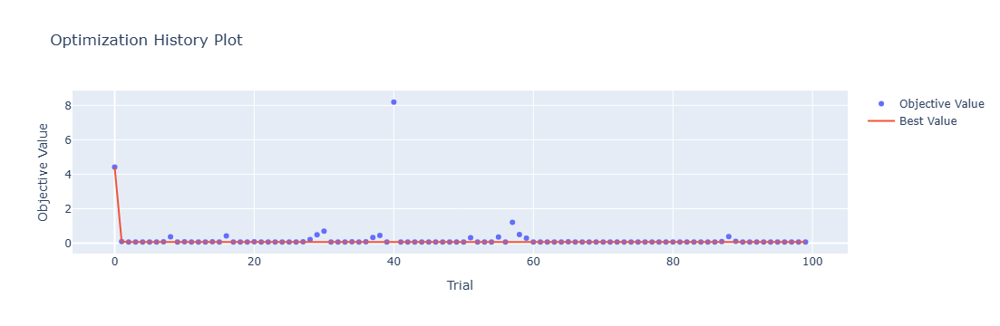

In [4]:
optuna.visualization.plot_optimization_history(study)

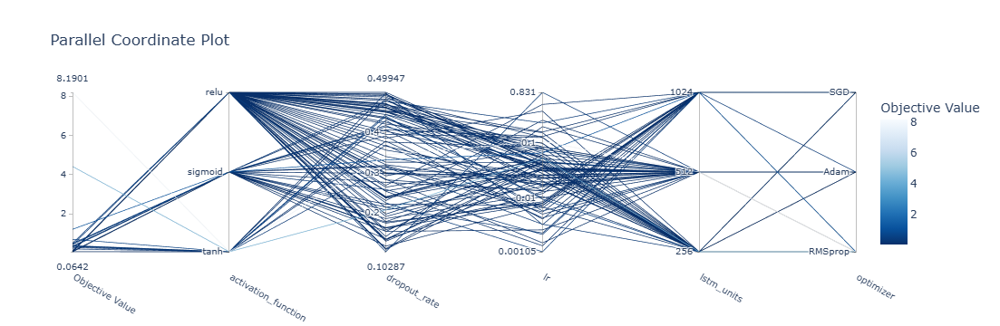

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

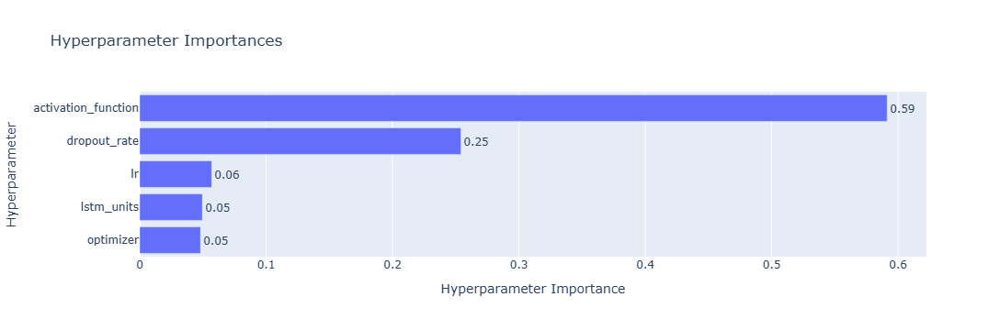

In [6]:
optuna.visualization.plot_param_importances(study)

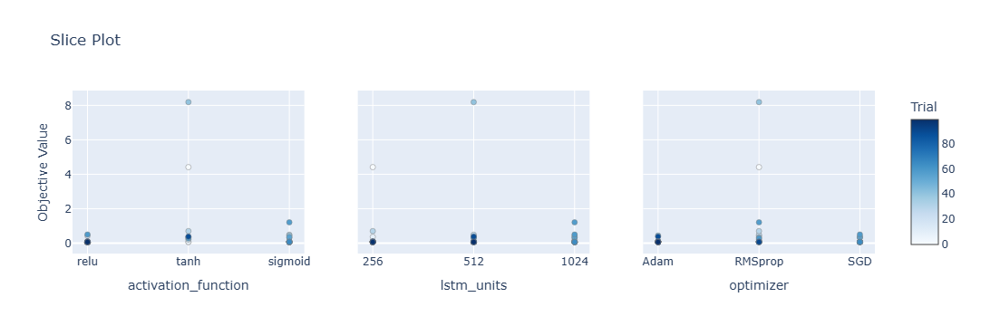

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

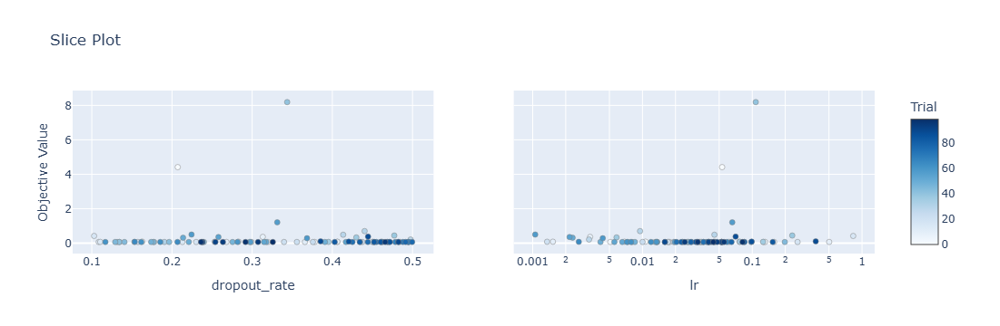

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 42s 214ms/step - loss: 0.4643 - accuracy: 0.2500 - mae: 0.4177 - rmse: 0.4643 - mape: 93.1704 - pearson: 0.5994 - val_loss: 0.0579 - val_accuracy: 0.0000e+00 - val_mae: 0.0452 - val_rmse: 0.0579 - val_mape: 9.6908 - val_pearson: 0.7949
Epoch 2/100
84/84 [==============================] - 12s 142ms/step - loss: 0.0681 - accuracy: 0.4286 - mae: 0.0539 - rmse: 0.0681 - mape: 12.2274 - pearson: 0.7691 - val_loss: 0.0701 - val_accuracy: 0.7000 - val_mae: 0.0562 - val_rmse: 0.0701 - val_mape: 12.5515 - val_pearson: 0.7064
Epoch 3/100
84/84 [==============================] - 12s 141ms/step - loss: 0.0703 - accuracy: 0.4405 - mae: 0.0557 - rmse: 0.0703 - mape: 12.5712 - pearson: 0.7

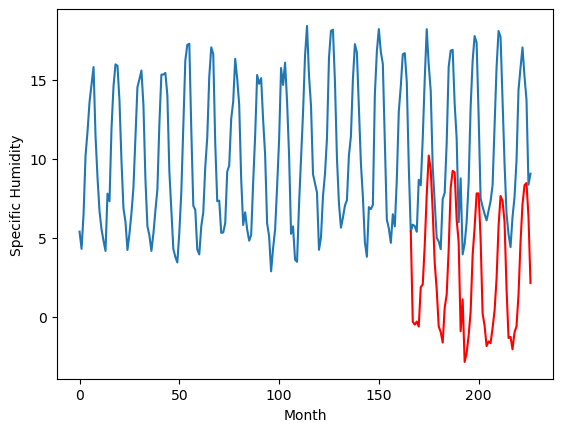

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		0.95		1.81
-0.53		0.76		1.29
-0.97		0.96		1.93
-0.24		0.64		0.88
3.64		3.13		-0.51
1.85		3.30		1.45
4.17		5.78		1.61
7.85		8.98		1.13
9.51		11.45		1.94
9.45		10.56		1.11
7.35		7.90		0.55
4.79		4.66		-0.13
1.46		2.98		1.52
-2.06		0.66		2.72
-1.71		0.29		2.00
-1.00		-0.37		0.63
1.21		1.82		0.61
1.43		2.67		1.24
3.92		5.51		1.59
8.67		9.40		0.73
9.47		10.48		1.01
9.63		10.38		0.75
7.47		7.40		-0.07
4.39		5.98		1.59
-1.27		0.35		1.62
2.37		2.36		-0.01
-2.39		-1.59		0.80
-1.17		-1.03		0.14
0.74		0.08		-0.66
2.04		1.56		-0.48
6.28		5.15		-1.13
8.89		6.90		-1.99
9.79		9.05		-0.74
9.22		9.06		-0.16
6.16		6.20		0.04
1.02		1.47		0.45
0.82		0.69		-0.13
-0.38		-0.59		-0.21
-0.29		-0.30		-0.01
1.40		-0.41		-1.81
1.78		0.54		-1.24
2.57		1.65		-0.92
4.76		3.67		-1.09
8.09		6.98		-1.11
9.76		8.89		-0.87
10.54		8.57		-1.97
6.52		7.26		0.74
1.82		3.02		1.20
-0.36		-0.08		0.28
-1.80		-0.02		1.78
-2.58		-

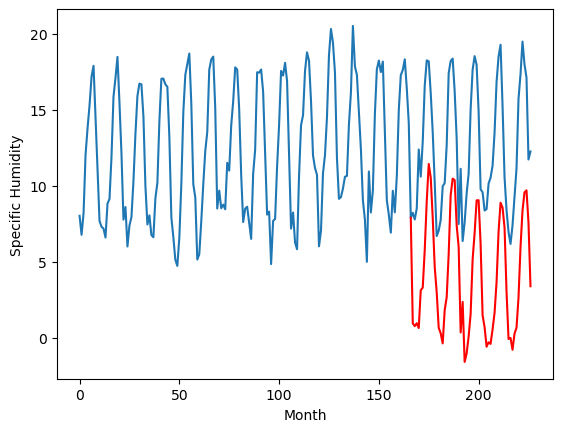

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		3.59		1.36
2.48		3.40		0.92
2.31		3.60		1.29
2.86		3.28		0.42
5.46		5.77		0.31
4.21		5.94		1.73
7.07		8.42		1.35
10.98		11.62		0.64
13.38		14.09		0.71
13.47		13.20		-0.27
10.38		10.54		0.16
7.63		7.30		-0.33
4.30		5.62		1.32
1.14		3.30		2.16
1.52		2.93		1.41
1.67		2.27		0.60
3.52		4.46		0.94
3.76		5.31		1.55
6.52		8.15		1.63
11.14		12.04		0.90
13.05		13.12		0.07
13.25		13.02		-0.23
10.25		10.04		-0.21
7.53		8.62		1.09
1.66		2.99		1.33
4.06		5.00		0.94
0.65		1.05		0.40
1.86		1.61		-0.25
2.57		2.72		0.15
4.02		4.20		0.18
8.16		7.79		-0.37
10.94		9.54		-1.40
13.14		11.69		-1.45
12.44		11.70		-0.74
8.71		8.84		0.13
3.71		4.11		0.40
3.39		3.33		-0.06
2.06		2.05		-0.01
2.43		2.34		-0.09
3.54		2.23		-1.31
2.90		3.18		0.28
4.34		4.29		-0.05
7.12		6.31		-0.81
9.70		9.62		-0.08
12.56		11.53		-1.03
12.65		11.21		-1.44
9.07		9.90		0.83
5.16		5.66		0.50
2.63		2.56		-0.07
1.82		2.62		0.80
1.02		1.85	

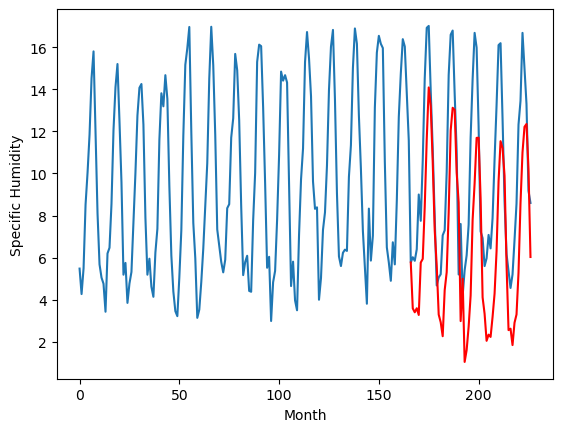

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		1.04		1.52
0.06		0.85		0.79
0.30		1.05		0.75
0.44		0.73		0.29
4.75		3.22		-1.53
3.60		3.39		-0.21
5.75		5.87		0.12
8.24		9.07		0.83
10.99		11.54		0.55
9.74		10.65		0.91
8.39		7.99		-0.40
4.58		4.75		0.17
1.53		3.07		1.54
-1.54		0.75		2.29
-1.47		0.38		1.85
-1.56		-0.28		1.28
1.89		1.91		0.02
2.46		2.76		0.30
5.97		5.60		-0.37
9.87		9.49		-0.38
10.71		10.57		-0.14
10.33		10.47		0.14
8.02		7.49		-0.53
5.59		6.07		0.48
-0.62		0.44		1.06
2.43		2.45		0.02
-2.69		-1.50		1.19
-1.48		-0.94		0.54
-0.39		0.17		0.56
2.53		1.65		-0.88
6.77		5.24		-1.53
8.78		6.99		-1.79
9.99		9.14		-0.85
9.27		9.15		-0.12
5.89		6.29		0.40
0.79		1.56		0.77
0.27		0.78		0.51
-0.23		-0.50		-0.27
-0.04		-0.21		-0.17
0.63		-0.32		-0.95
1.71		0.63		-1.08
2.11		1.74		-0.37
4.96		3.76		-1.20
9.11		7.07		-2.04
10.14		8.98		-1.16
9.89		8.66		-1.23
7.71		7.35		-0.36
3.14		3.11		-0.03
0.15		0.01		-0.14
-1.25		0.07		1.32
-2.17	

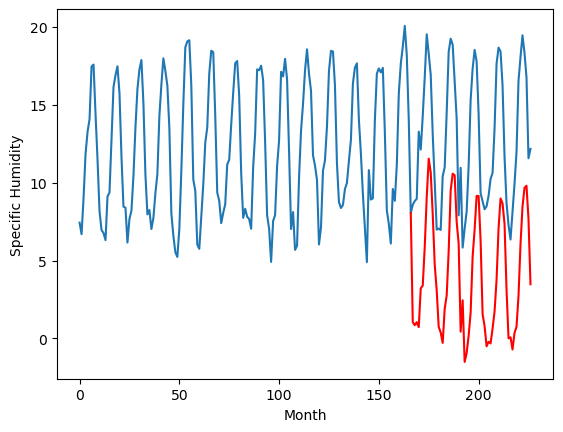

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		2.99		-1.30
3.04		2.80		-0.24
3.83		3.00		-0.83
3.22		2.68		-0.54
7.67		5.17		-2.50
7.39		5.34		-2.05
9.97		7.82		-2.15
12.33		11.02		-1.31
15.19		13.49		-1.70
12.92		12.60		-0.32
11.61		9.94		-1.67
7.33		6.70		-0.63
5.48		5.02		-0.46
2.70		2.70		-0.00
2.63		2.33		-0.30
2.23		1.67		-0.56
5.07		3.86		-1.21
6.47		4.71		-1.76
10.48		7.55		-2.93
14.17		11.44		-2.73
14.88		12.52		-2.36
14.80		12.42		-2.38
10.57		9.44		-1.13
8.48		8.02		-0.46
4.26		2.39		-1.87
7.02		4.40		-2.62
1.52		0.45		-1.07
1.78		1.01		-0.77
3.33		2.12		-1.21
7.25		3.60		-3.65
10.95		7.19		-3.76
11.92		8.94		-2.98
11.68		11.09		-0.59
12.77		11.10		-1.67
9.94		8.24		-1.70
5.14		3.51		-1.63
5.13		2.73		-2.40
4.05		1.45		-2.60
3.29		1.74		-1.55
3.63		1.63		-2.00
5.82		2.58		-3.24
6.58		3.69		-2.89
10.52		5.71		-4.81
14.64		9.02		-5.62
13.22		10.93		-2.29
11.40		10.61		-0.79
11.36		9.30		-2.06
7.61		5.06		-2.55
4.81		1.96		-

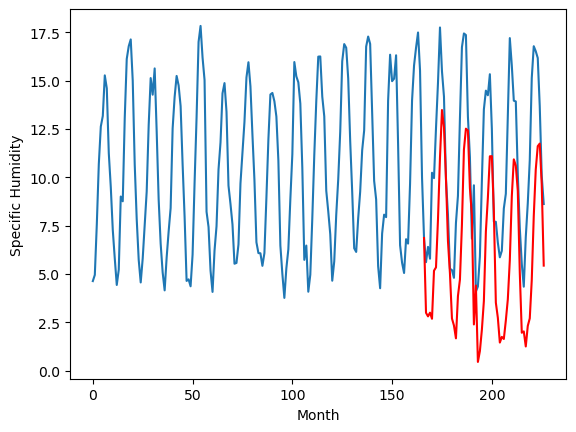

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		0.19		1.00
-0.85		0.00		0.85
-1.33		0.20		1.53
-1.44		-0.12		1.32
0.32		2.37		2.05
0.66		2.54		1.88
3.79		5.02		1.23
7.52		8.22		0.70
11.00		10.69		-0.31
11.03		9.80		-1.23
8.13		7.14		-0.99
4.43		3.90		-0.53
1.48		2.22		0.74
-2.28		-0.10		2.18
-2.89		-0.47		2.42
-2.30		-1.13		1.17
-0.73		1.06		1.79
0.28		1.91		1.63
2.78		4.75		1.97
8.04		8.64		0.60
9.16		9.72		0.56
10.32		9.62		-0.70
6.23		6.64		0.41
3.91		5.22		1.31
-1.35		-0.41		0.94
0.07		1.60		1.53
-3.04		-2.35		0.69
-1.66		-1.79		-0.13
-0.33		-0.68		-0.35
0.80		0.80		0.00
5.58		4.39		-1.19
6.67		6.14		-0.53
11.00		8.29		-2.71
9.21		8.30		-0.91
6.51		5.44		-1.07
1.87		0.71		-1.16
1.21		-0.07		-1.28
-2.14		-1.35		0.79
-1.39		-1.06		0.33
-0.46		-1.17		-0.71
-0.68		-0.22		0.46
2.00		0.89		-1.11
2.76		2.91		0.15
6.66		6.22		-0.44
11.01		8.13		-2.88
10.12		7.81		-2.31
7.00		6.50		-0.50
2.60		2.26		-0.34
-0.42		-0.84		-0.42
-1.24		-0.78

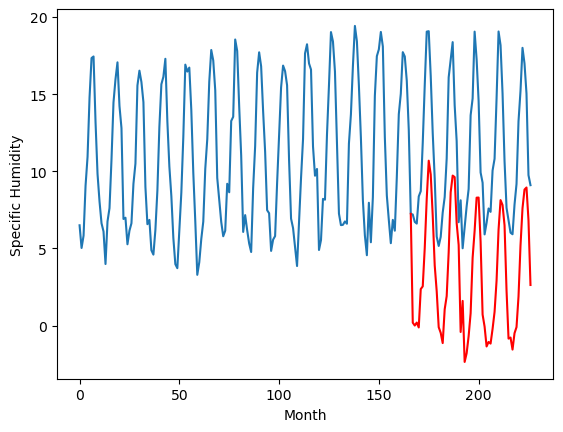

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		2.06		0.68
1.50		1.87		0.37
1.42		2.07		0.65
1.78		1.75		-0.03
3.41		4.24		0.83
3.19		4.41		1.22
6.29		6.89		0.60
10.01		10.09		0.08
12.80		12.56		-0.24
12.74		11.67		-1.07
9.21		9.01		-0.20
6.49		5.77		-0.72
3.64		4.09		0.45
0.77		1.77		1.00
0.62		1.40		0.78
0.67		0.74		0.07
2.26		2.93		0.67
2.86		3.78		0.92
5.86		6.62		0.76
10.24		10.51		0.27
11.68		11.59		-0.09
12.21		11.49		-0.72
8.89		8.51		-0.38
6.78		7.09		0.31
1.03		1.46		0.43
2.87		3.47		0.60
0.09		-0.48		-0.57
1.37		0.08		-1.29
2.38		1.19		-1.19
3.38		2.67		-0.71
7.74		6.26		-1.48
9.62		8.01		-1.61
13.24		10.16		-3.08
11.89		10.17		-1.72
8.45		7.31		-1.14
3.89		2.58		-1.31
3.29		1.80		-1.49
1.11		0.52		-0.59
1.97		0.81		-1.16
2.65		0.70		-1.95
2.24		1.65		-0.59
4.45		2.76		-1.69
6.04		4.78		-1.26
8.77		8.09		-0.68
12.51		10.00		-2.51
12.14		9.68		-2.46
9.20		8.37		-0.83
4.94		4.13		-0.81
1.61		1.03		-0.58
1.54		1.09		-0.45
0.8

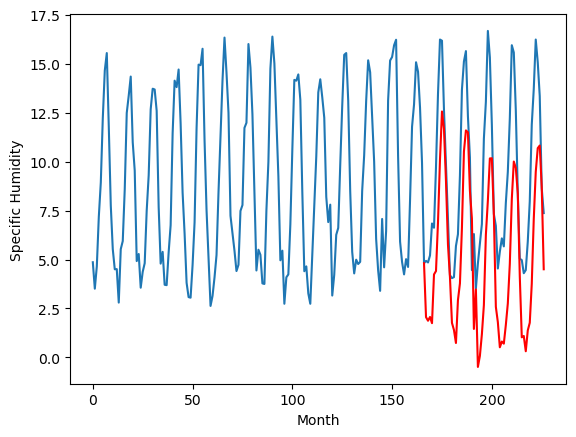

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		0.42		0.47
0.20		0.23		0.03
0.23		0.43		0.20
0.45		0.11		-0.34
1.75		2.60		0.85
1.69		2.77		1.08
3.68		5.25		1.57
8.35		8.45		0.10
11.16		10.92		-0.24
11.40		10.03		-1.37
7.50		7.37		-0.13
4.79		4.13		-0.66
2.25		2.45		0.20
-0.62		0.13		0.75
-0.93		-0.24		0.69
-0.90		-0.90		-0.00
0.72		1.29		0.57
1.42		2.14		0.72
4.44		4.98		0.54
8.71		8.87		0.16
10.21		9.95		-0.26
10.49		9.85		-0.64
7.00		6.87		-0.13
5.12		5.45		0.33
-0.67		-0.18		0.49
1.10		1.83		0.73
-1.41		-2.12		-0.71
-0.18		-1.56		-1.38
0.81		-0.45		-1.26
1.71		1.03		-0.68
6.00		4.62		-1.38
7.45		6.37		-1.08
10.82		8.52		-2.30
9.75		8.53		-1.22
6.96		5.67		-1.29
2.54		0.94		-1.60
1.84		0.16		-1.68
-0.50		-1.12		-0.62
0.43		-0.83		-1.26
0.79		-0.94		-1.73
0.71		0.01		-0.70
2.99		1.12		-1.87
4.31		3.14		-1.17
6.93		6.45		-0.48
11.28		8.36		-2.92
10.22		8.04		-2.18
7.42		6.73		-0.69
3.67		2.49		-1.18
0.15		-0.61		-0.76
0.35		-0.55		

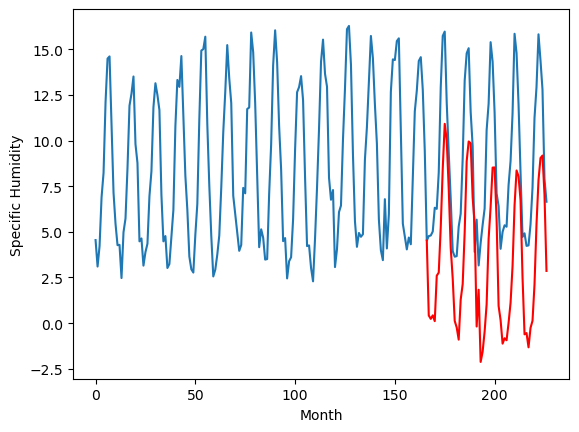

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		0.11		-1.16
1.36		-0.08		-1.44
0.96		0.12		-0.84
0.95		-0.20		-1.15
3.21		2.29		-0.92
3.45		2.46		-0.99
6.67		4.94		-1.73
10.32		8.14		-2.18
13.41		10.61		-2.80
11.38		9.72		-1.66
8.66		7.06		-1.60
4.21		3.82		-0.39
2.45		2.14		-0.31
0.54		-0.18		-0.72
0.31		-0.55		-0.86
-0.37		-1.21		-0.84
2.69		0.98		-1.71
3.42		1.83		-1.59
6.33		4.67		-1.66
11.31		8.56		-2.75
12.81		9.64		-3.17
13.00		9.54		-3.46
9.19		6.56		-2.63
6.77		5.14		-1.63
1.48		-0.49		-1.97
3.07		1.52		-1.55
-0.21		-2.43		-2.22
0.38		-1.87		-2.25
2.06		-0.76		-2.82
3.64		0.72		-2.92
7.83		4.31		-3.52
10.01		6.06		-3.95
13.67		8.21		-5.46
12.70		8.22		-4.48
8.25		5.36		-2.89
3.02		0.63		-2.39
2.02		-0.15		-2.17
1.09		-1.43		-2.52
1.69		-1.14		-2.83
1.76		-1.25		-3.01
2.20		-0.30		-2.50
3.42		0.81		-2.61
6.91		2.83		-4.08
9.19		6.14		-3.05
12.74		8.05		-4.69
12.74		7.73		-5.01
8.67		6.42		-2.25
4.61		2.18		-2.43
1.95		-0.92		

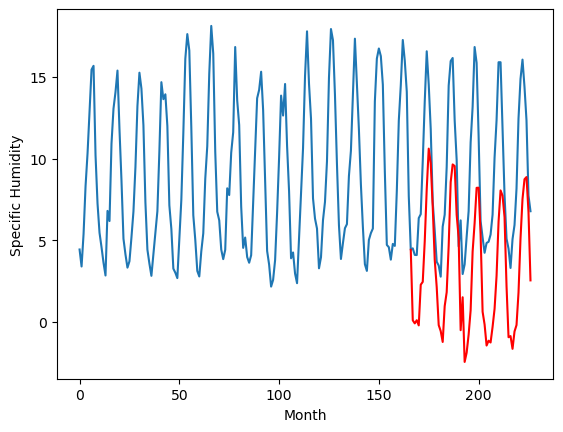

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		-0.00		-0.78
1.19		-0.19		-1.38
0.69		0.01		-0.68
0.37		-0.31		-0.68
2.33		2.18		-0.15
2.39		2.35		-0.04
5.53		4.83		-0.70
8.22		8.03		-0.19
11.36		10.50		-0.86
10.14		9.61		-0.53
7.35		6.95		-0.40
4.01		3.71		-0.30
1.96		2.03		0.07
0.30		-0.29		-0.59
-0.03		-0.66		-0.63
-0.48		-1.32		-0.84
1.32		0.87		-0.45
2.64		1.72		-0.92
4.73		4.56		-0.17
9.50		8.45		-1.05
10.43		9.53		-0.90
10.85		9.43		-1.42
7.68		6.45		-1.23
6.37		5.03		-1.34
0.85		-0.60		-1.45
1.69		1.41		-0.28
-0.60		-2.54		-1.94
0.14		-1.98		-2.12
1.42		-0.87		-2.29
3.04		0.61		-2.43
7.65		4.20		-3.45
9.33		5.95		-3.38
12.91		8.10		-4.81
11.37		8.11		-3.26
8.31		5.25		-3.06
2.52		0.52		-2.00
1.80		-0.26		-2.06
0.87		-1.54		-2.41
1.48		-1.25		-2.73
1.25		-1.36		-2.61
1.35		-0.41		-1.76
3.08		0.70		-2.38
5.52		2.72		-2.80
8.14		6.03		-2.11
11.96		7.94		-4.02
10.66		7.62		-3.04
7.94		6.31		-1.63
4.70		2.07		-2.63
1.35		-1.03		-

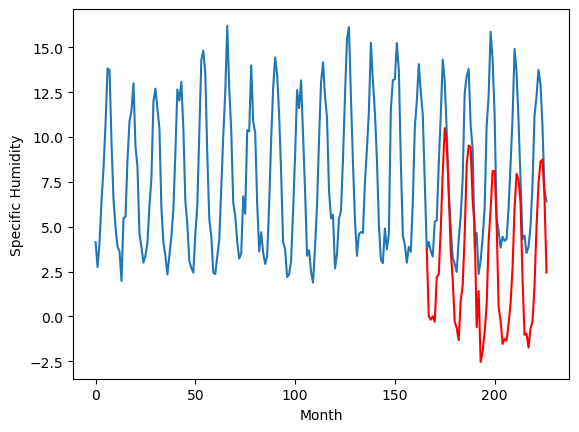

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		-0.30		-0.79
0.61		-0.49		-1.10
0.23		-0.29		-0.52
-0.28		-0.61		-0.33
1.32		1.88		0.56
1.68		2.05		0.37
4.58		4.53		-0.05
7.68		7.73		0.05
10.73		10.20		-0.53
9.16		9.31		0.15
6.50		6.65		0.15
3.05		3.41		0.36
1.64		1.73		0.09
0.11		-0.59		-0.70
-0.27		-0.96		-0.69
-1.01		-1.62		-0.61
0.61		0.57		-0.04
2.21		1.42		-0.79
3.73		4.26		0.53
8.86		8.15		-0.71
9.93		9.23		-0.70
10.42		9.13		-1.29
6.80		6.15		-0.65
5.81		4.73		-1.08
0.96		-0.90		-1.86
0.96		1.11		0.15
-1.11		-2.84		-1.73
-0.51		-2.28		-1.77
0.74		-1.17		-1.91
1.68		0.31		-1.37
5.40		3.90		-1.50
6.67		5.65		-1.02
9.16		7.80		-1.36
10.15		7.81		-2.34
7.55		4.95		-2.60
2.53		0.22		-2.31
1.39		-0.56		-1.95
0.22		-1.84		-2.06
0.62		-1.55		-2.17
0.06		-1.66		-1.72
0.52		-0.71		-1.23
2.16		0.40		-1.76
3.37		2.42		-0.95
6.38		5.73		-0.65
10.21		7.64		-2.57
9.46		7.32		-2.14
8.15		6.01		-2.14
4.39		1.77		-2.62
0.98		-1.33		-2.31
1.51

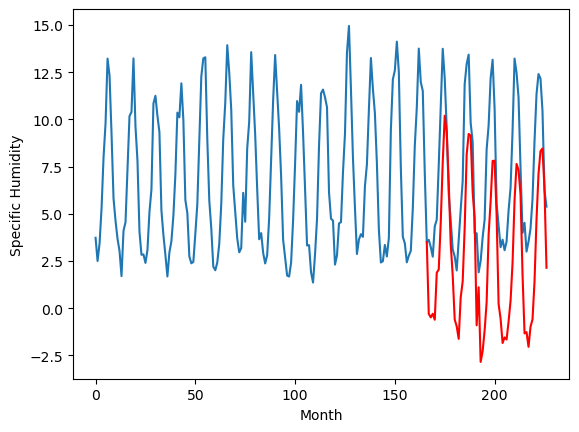

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03  -0.301521
1                 1   -0.86   0.948479
2                 2    2.23   3.588479
3                 3   -0.48   1.038479
4                 4    4.29   2.988479
5                 5   -0.81   0.188479
6                 6    1.38   2.058479
7                 7   -0.05   0.418479
8                 8    1.27   0.108479
9                 9    0.78  -0.001521
10               10    0.49  -0.301521


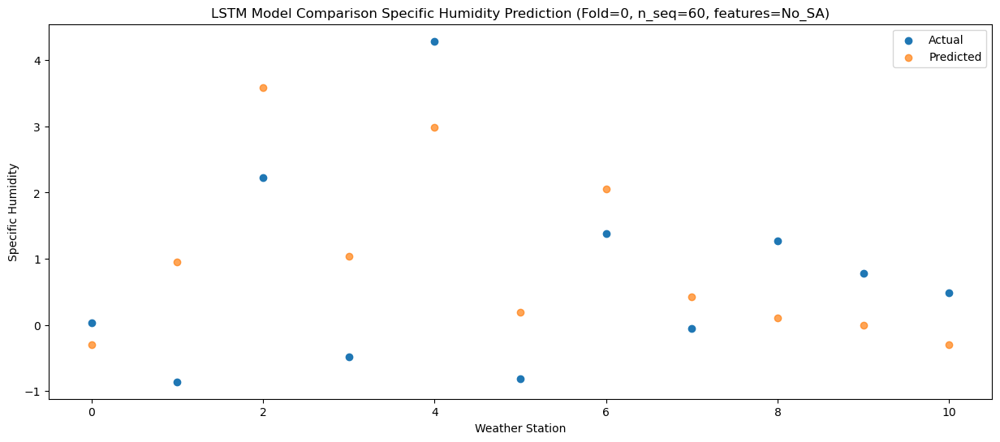

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46  -0.486378
1                 1   -0.53   0.763622
2                 2    2.48   3.403622
3                 3    0.06   0.853622
4                 4    3.04   2.803622
5                 5   -0.85   0.003622
6                 6    1.50   1.873622
7                 7    0.20   0.233622
8                 8    1.36  -0.076378
9                 9    1.19  -0.186378
10               10    0.61  -0.486378


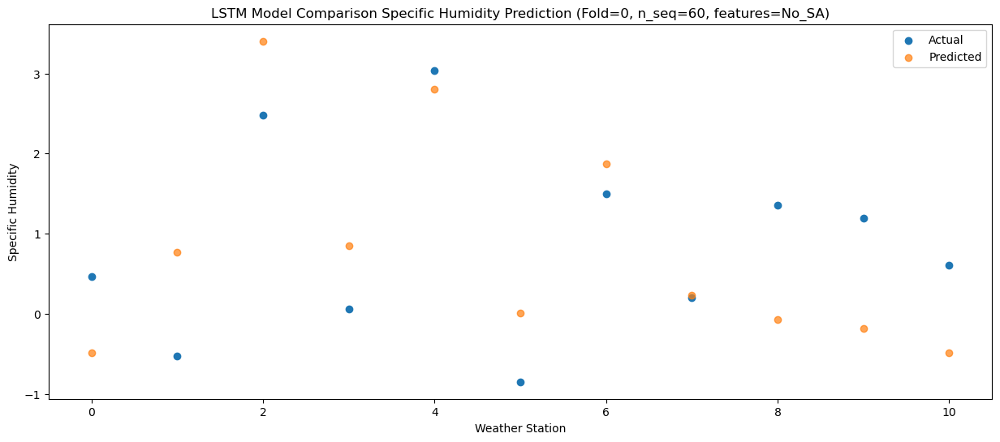

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37  -0.293762
1                 1   -0.97   0.956238
2                 2    2.31   3.596238
3                 3    0.30   1.046238
4                 4    3.83   2.996238
5                 5   -1.33   0.196238
6                 6    1.42   2.066238
7                 7    0.23   0.426238
8                 8    0.96   0.116238
9                 9    0.69   0.006238
10               10    0.23  -0.293762


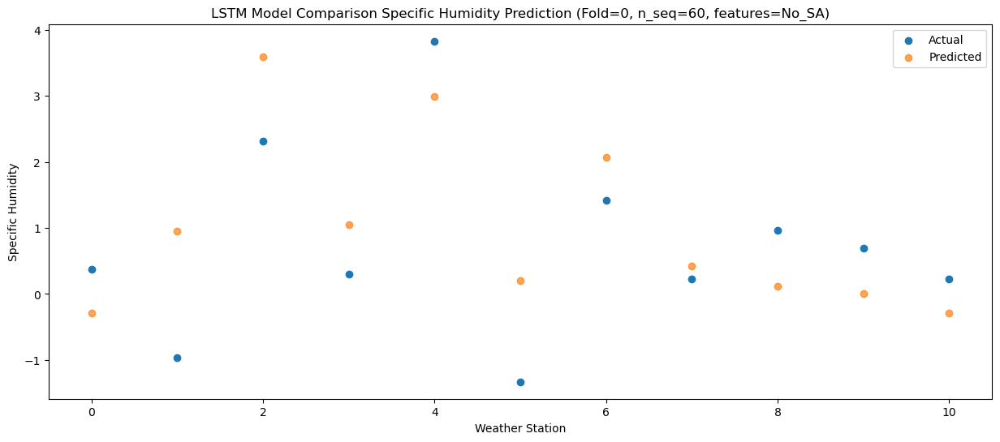

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01   -0.61159
1                 1   -0.24    0.63841
2                 2    2.86    3.27841
3                 3    0.44    0.72841
4                 4    3.22    2.67841
5                 5   -1.44   -0.12159
6                 6    1.78    1.74841
7                 7    0.45    0.10841
8                 8    0.95   -0.20159
9                 9    0.37   -0.31159
10               10   -0.28   -0.61159


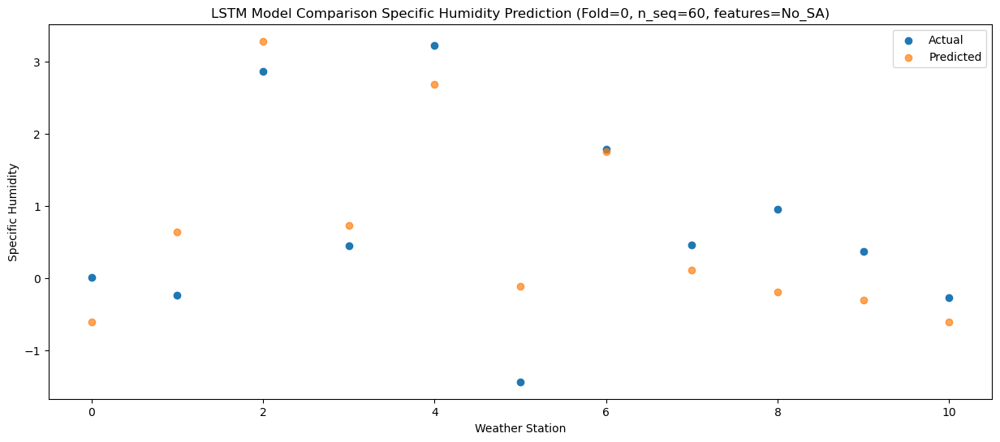

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   1.877059
1                 1    3.64   3.127059
2                 2    5.46   5.767059
3                 3    4.75   3.217059
4                 4    7.67   5.167059
5                 5    0.32   2.367059
6                 6    3.41   4.237059
7                 7    1.75   2.597059
8                 8    3.21   2.287059
9                 9    2.33   2.177059
10               10    1.32   1.877059


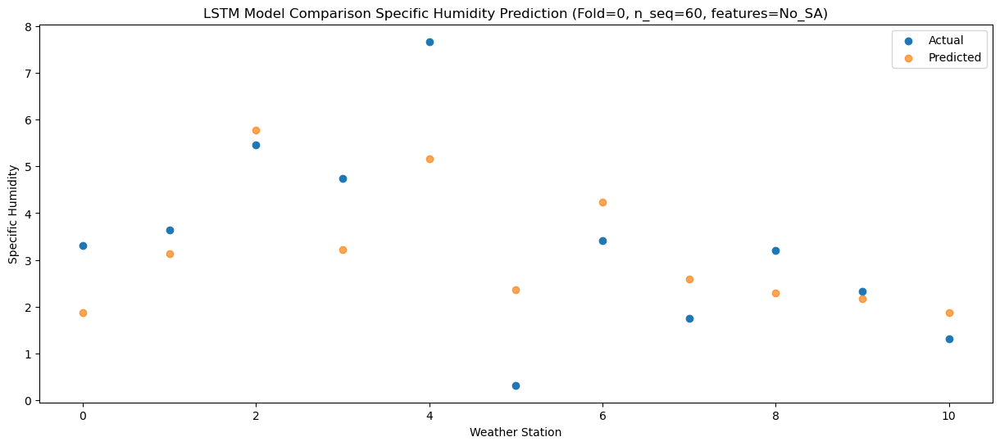

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   2.051102
1                 1    1.85   3.301102
2                 2    4.21   5.941102
3                 3    3.60   3.391102
4                 4    7.39   5.341102
5                 5    0.66   2.541102
6                 6    3.19   4.411102
7                 7    1.69   2.771102
8                 8    3.45   2.461102
9                 9    2.39   2.351102
10               10    1.68   2.051102


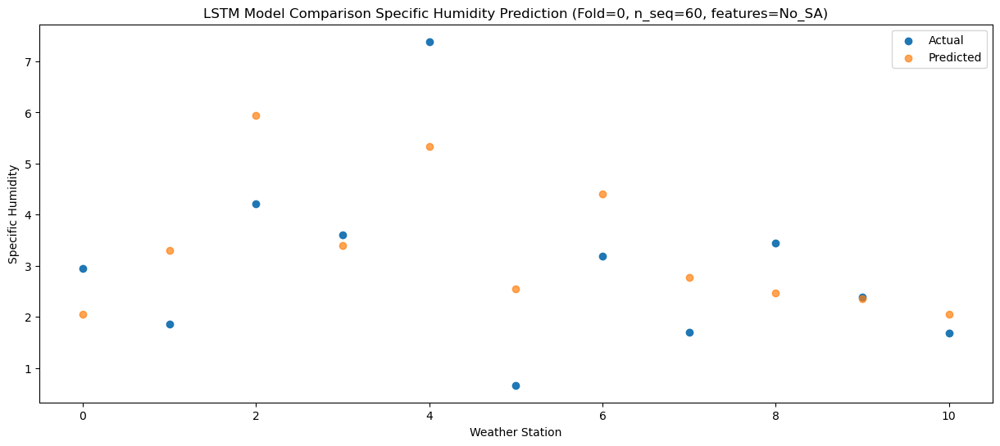

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.532365
1                 1    4.17   5.782365
2                 2    7.07   8.422365
3                 3    5.75   5.872365
4                 4    9.97   7.822365
5                 5    3.79   5.022365
6                 6    6.29   6.892365
7                 7    3.68   5.252365
8                 8    6.67   4.942365
9                 9    5.53   4.832365
10               10    4.58   4.532365


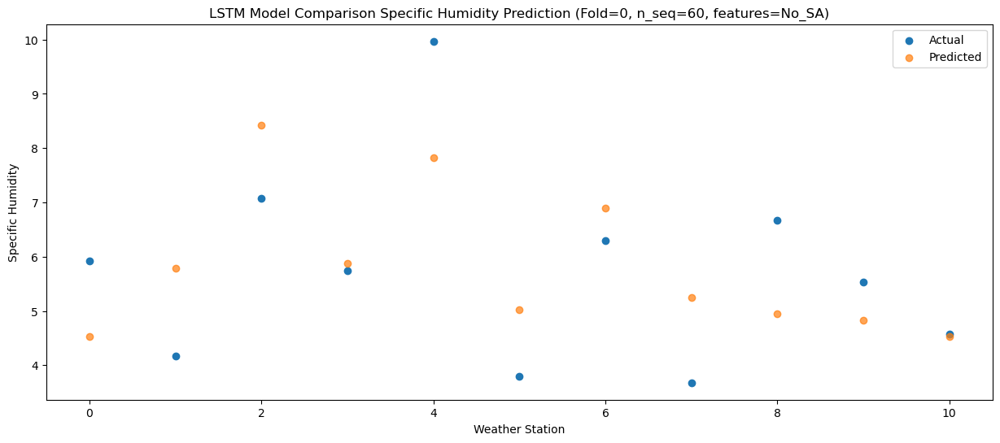

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   7.733073
1                 1    7.85   8.983073
2                 2   10.98  11.623073
3                 3    8.24   9.073073
4                 4   12.33  11.023073
5                 5    7.52   8.223073
6                 6   10.01  10.093073
7                 7    8.35   8.453073
8                 8   10.32   8.143073
9                 9    8.22   8.033073
10               10    7.68   7.733073


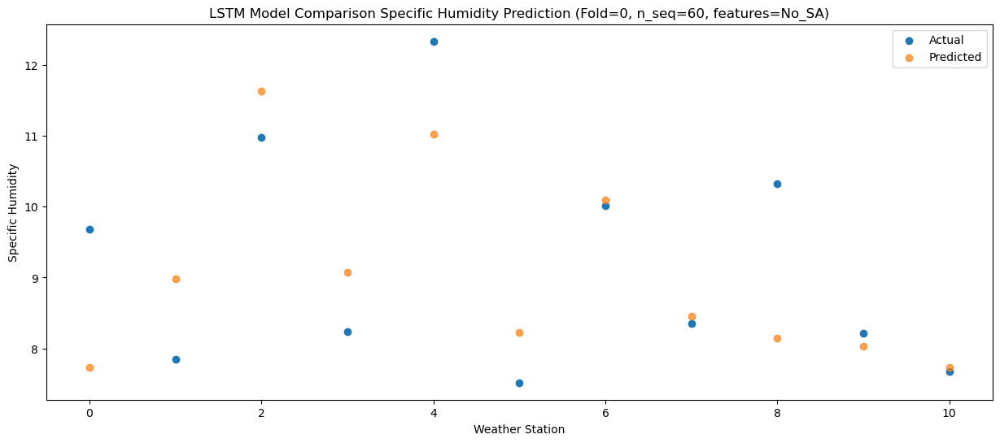

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81   10.19689
1                 1    9.51   11.44689
2                 2   13.38   14.08689
3                 3   10.99   11.53689
4                 4   15.19   13.48689
5                 5   11.00   10.68689
6                 6   12.80   12.55689
7                 7   11.16   10.91689
8                 8   13.41   10.60689
9                 9   11.36   10.49689
10               10   10.73   10.19689


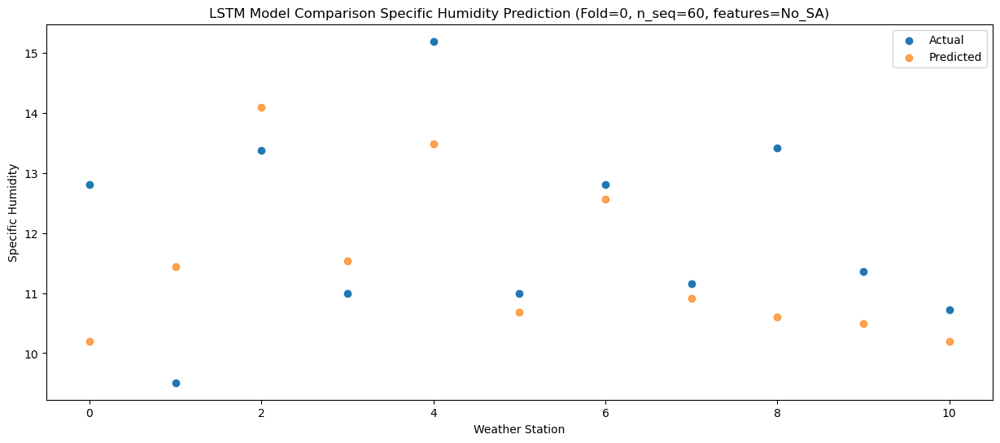

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   9.308155
1                 1    9.45  10.558155
2                 2   13.47  13.198155
3                 3    9.74  10.648155
4                 4   12.92  12.598155
5                 5   11.03   9.798155
6                 6   12.74  11.668155
7                 7   11.40  10.028155
8                 8   11.38   9.718155
9                 9   10.14   9.608155
10               10    9.16   9.308155


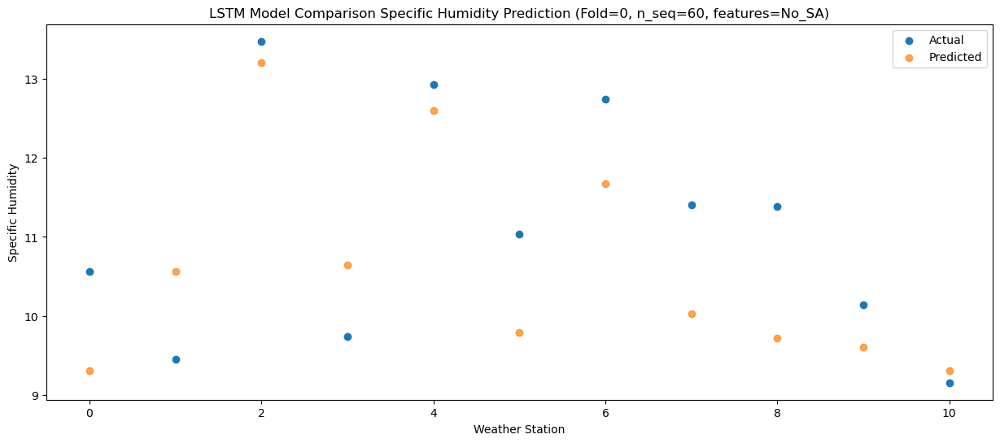

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   6.652191
1                 1    7.35   7.902191
2                 2   10.38  10.542191
3                 3    8.39   7.992191
4                 4   11.61   9.942191
5                 5    8.13   7.142191
6                 6    9.21   9.012191
7                 7    7.50   7.372191
8                 8    8.66   7.062191
9                 9    7.35   6.952191
10               10    6.50   6.652191


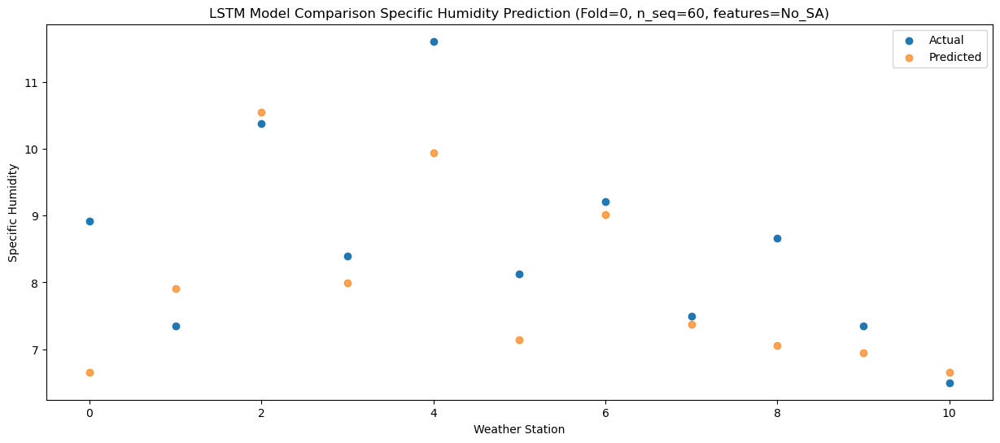

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   3.410943
1                 1    4.79   4.660943
2                 2    7.63   7.300943
3                 3    4.58   4.750943
4                 4    7.33   6.700943
5                 5    4.43   3.900943
6                 6    6.49   5.770943
7                 7    4.79   4.130943
8                 8    4.21   3.820943
9                 9    4.01   3.710943
10               10    3.05   3.410943


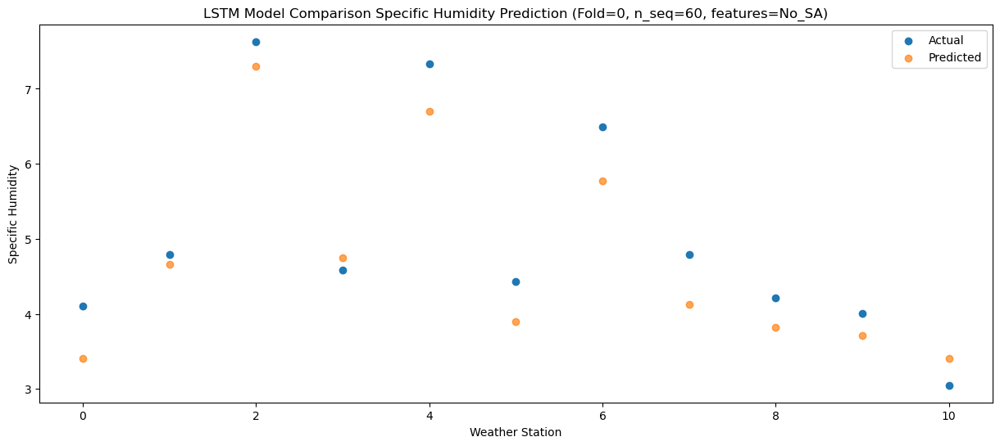

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87   1.730496
1                 1    1.46   2.980496
2                 2    4.30   5.620496
3                 3    1.53   3.070496
4                 4    5.48   5.020496
5                 5    1.48   2.220496
6                 6    3.64   4.090496
7                 7    2.25   2.450496
8                 8    2.45   2.140496
9                 9    1.96   2.030496
10               10    1.64   1.730496


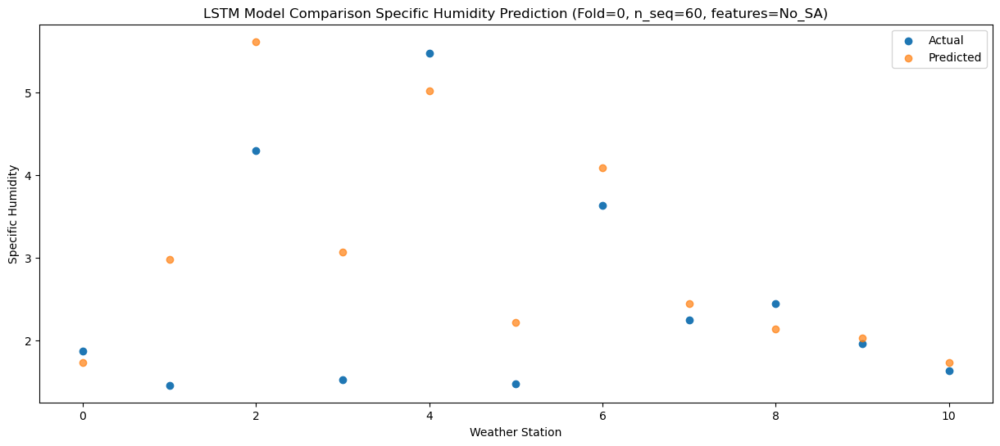

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36  -0.594719
1                 1   -2.06   0.655281
2                 2    1.14   3.295281
3                 3   -1.54   0.745281
4                 4    2.70   2.695281
5                 5   -2.28  -0.104719
6                 6    0.77   1.765281
7                 7   -0.62   0.125281
8                 8    0.54  -0.184719
9                 9    0.30  -0.294719
10               10    0.11  -0.594719


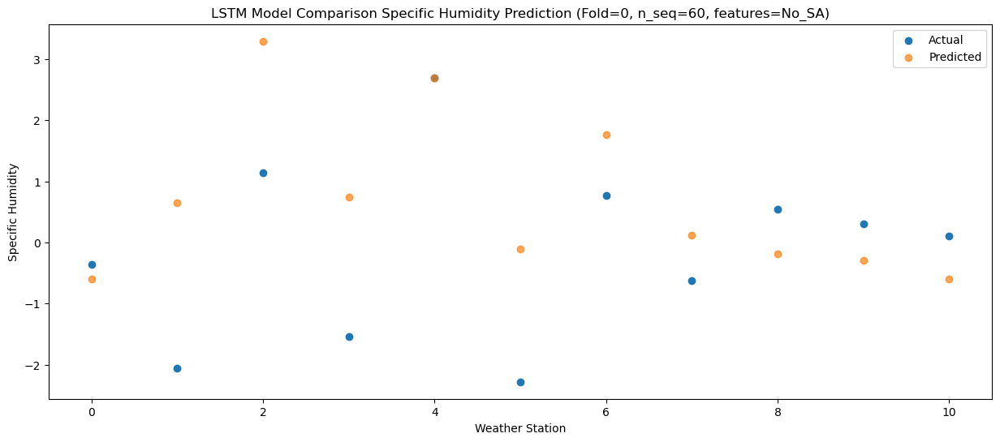

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60  -0.957904
1                 1   -1.71   0.292096
2                 2    1.52   2.932096
3                 3   -1.47   0.382096
4                 4    2.63   2.332096
5                 5   -2.89  -0.467904
6                 6    0.62   1.402096
7                 7   -0.93  -0.237904
8                 8    0.31  -0.547904
9                 9   -0.03  -0.657904
10               10   -0.27  -0.957904


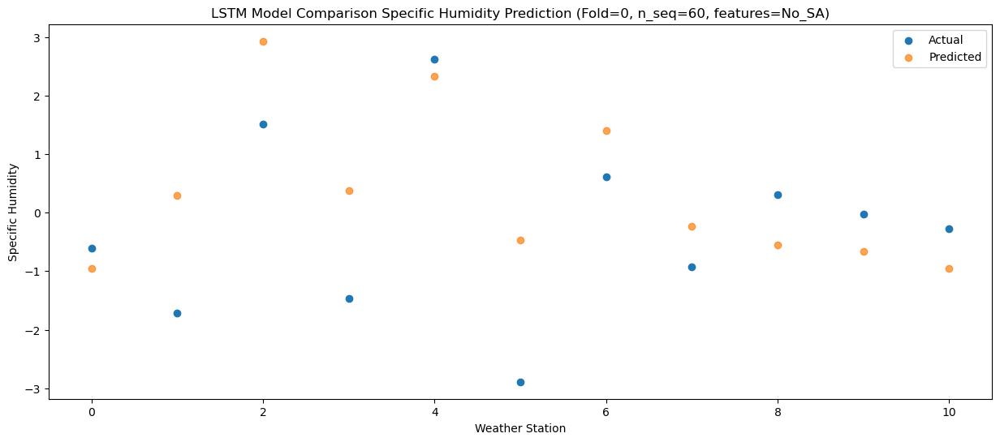

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -1.622969
1                 1   -1.00  -0.372969
2                 2    1.67   2.267031
3                 3   -1.56  -0.282969
4                 4    2.23   1.667031
5                 5   -2.30  -1.132969
6                 6    0.67   0.737031
7                 7   -0.90  -0.902969
8                 8   -0.37  -1.212969
9                 9   -0.48  -1.322969
10               10   -1.01  -1.622969


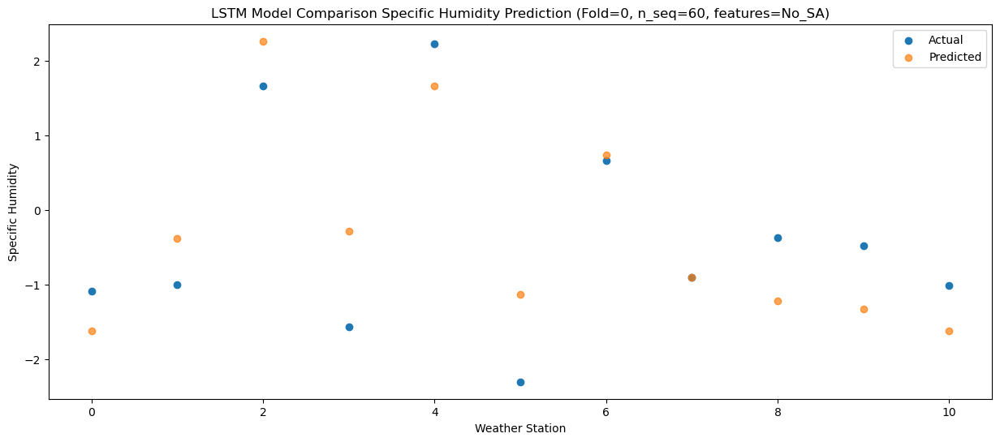

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08   0.566732
1                 1    1.21   1.816732
2                 2    3.52   4.456732
3                 3    1.89   1.906732
4                 4    5.07   3.856732
5                 5   -0.73   1.056732
6                 6    2.26   2.926732
7                 7    0.72   1.286732
8                 8    2.69   0.976732
9                 9    1.32   0.866732
10               10    0.61   0.566732


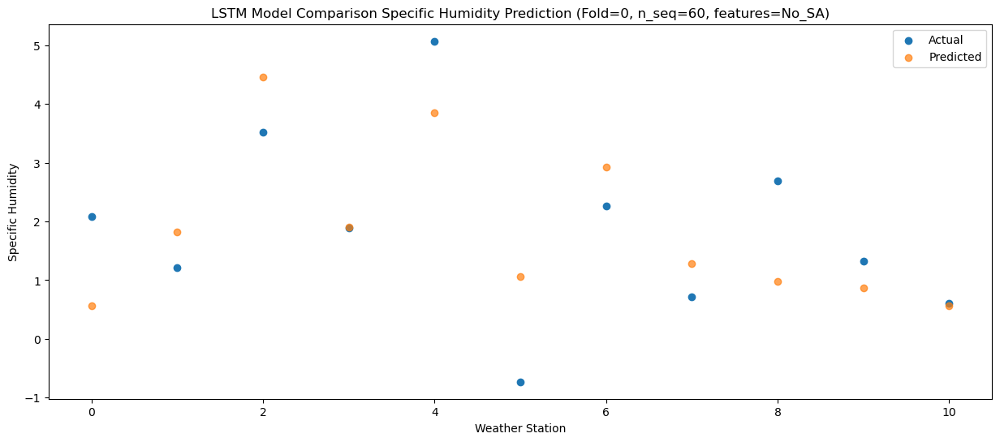

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   1.418422
1                 1    1.43   2.668422
2                 2    3.76   5.308422
3                 3    2.46   2.758422
4                 4    6.47   4.708422
5                 5    0.28   1.908422
6                 6    2.86   3.778422
7                 7    1.42   2.138422
8                 8    3.42   1.828422
9                 9    2.64   1.718422
10               10    2.21   1.418422


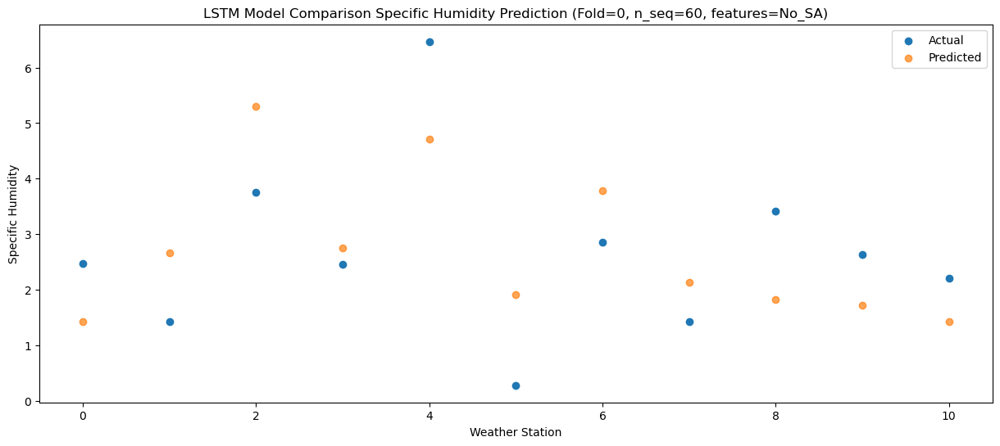

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   4.262408
1                 1    3.92   5.512408
2                 2    6.52   8.152408
3                 3    5.97   5.602408
4                 4   10.48   7.552408
5                 5    2.78   4.752408
6                 6    5.86   6.622408
7                 7    4.44   4.982408
8                 8    6.33   4.672408
9                 9    4.73   4.562408
10               10    3.73   4.262408


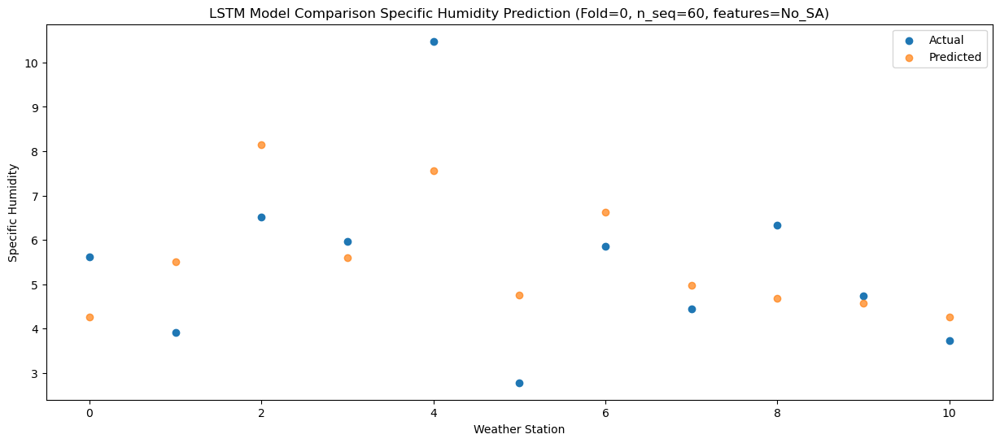

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43    8.14953
1                 1    8.67    9.39953
2                 2   11.14   12.03953
3                 3    9.87    9.48953
4                 4   14.17   11.43953
5                 5    8.04    8.63953
6                 6   10.24   10.50953
7                 7    8.71    8.86953
8                 8   11.31    8.55953
9                 9    9.50    8.44953
10               10    8.86    8.14953


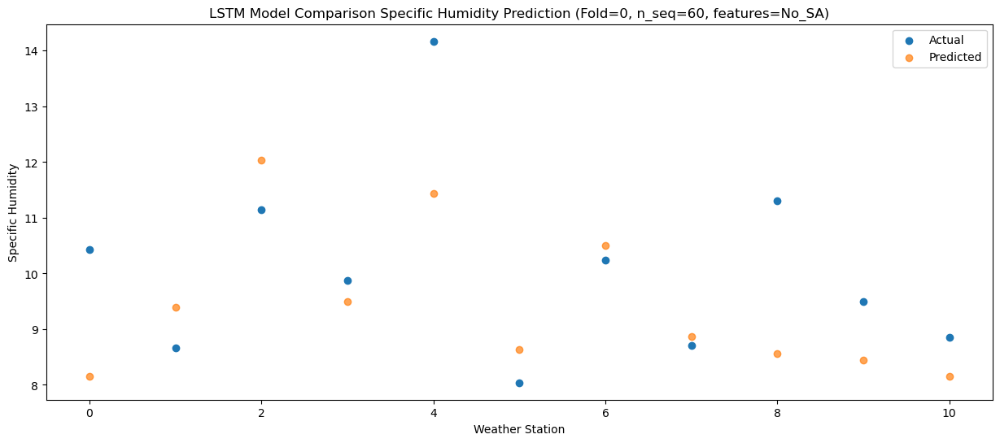

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46   9.230679
1                 1    9.47  10.480679
2                 2   13.05  13.120679
3                 3   10.71  10.570679
4                 4   14.88  12.520679
5                 5    9.16   9.720679
6                 6   11.68  11.590679
7                 7   10.21   9.950679
8                 8   12.81   9.640679
9                 9   10.43   9.530679
10               10    9.93   9.230679


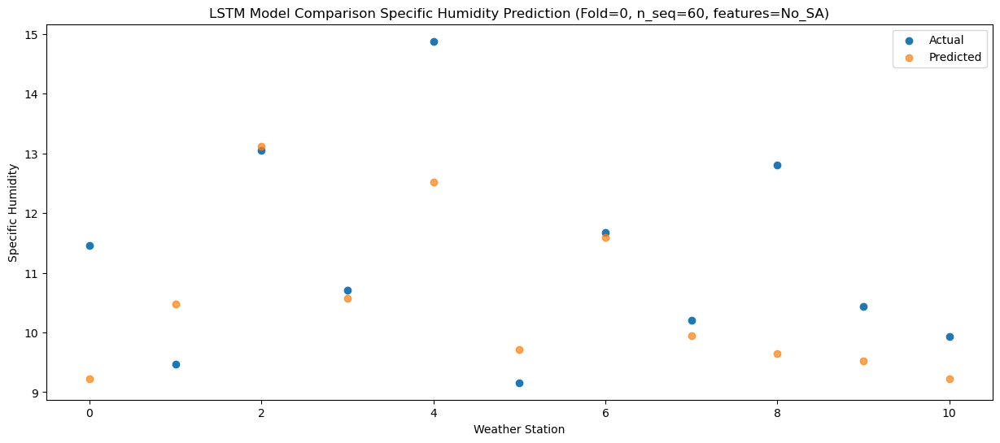

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51   9.133953
1                 1    9.63  10.383953
2                 2   13.25  13.023953
3                 3   10.33  10.473953
4                 4   14.80  12.423953
5                 5   10.32   9.623953
6                 6   12.21  11.493953
7                 7   10.49   9.853953
8                 8   13.00   9.543953
9                 9   10.85   9.433953
10               10   10.42   9.133953


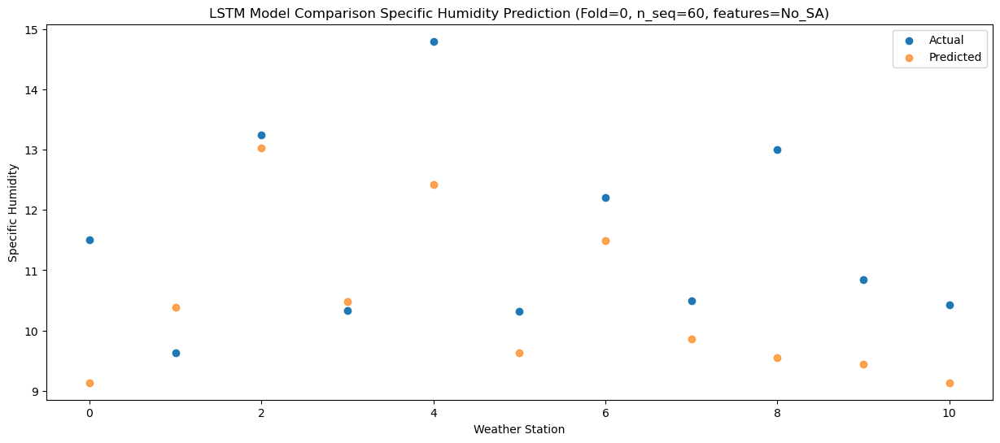

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   6.150653
1                 1    7.47   7.400653
2                 2   10.25  10.040653
3                 3    8.02   7.490653
4                 4   10.57   9.440653
5                 5    6.23   6.640653
6                 6    8.89   8.510653
7                 7    7.00   6.870653
8                 8    9.19   6.560653
9                 9    7.68   6.450653
10               10    6.80   6.150653


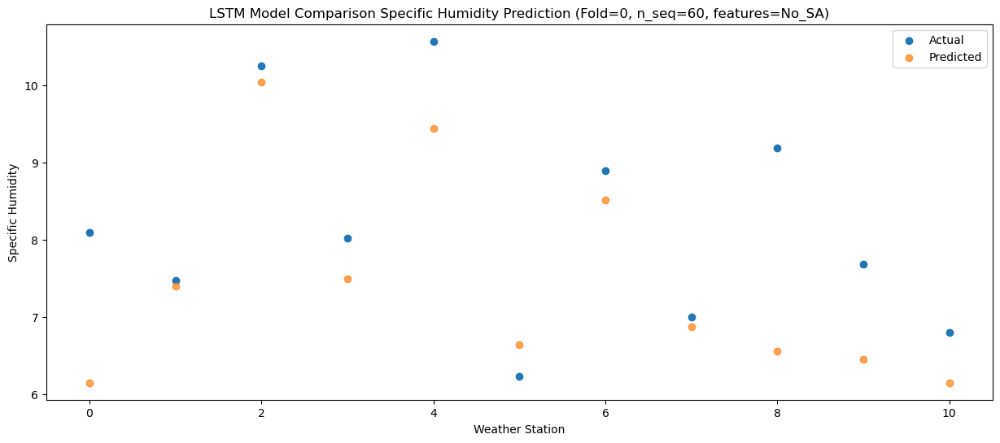

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   4.734555
1                 1    4.39   5.984555
2                 2    7.53   8.624555
3                 3    5.59   6.074555
4                 4    8.48   8.024555
5                 5    3.91   5.224555
6                 6    6.78   7.094555
7                 7    5.12   5.454555
8                 8    6.77   5.144555
9                 9    6.37   5.034555
10               10    5.81   4.734555


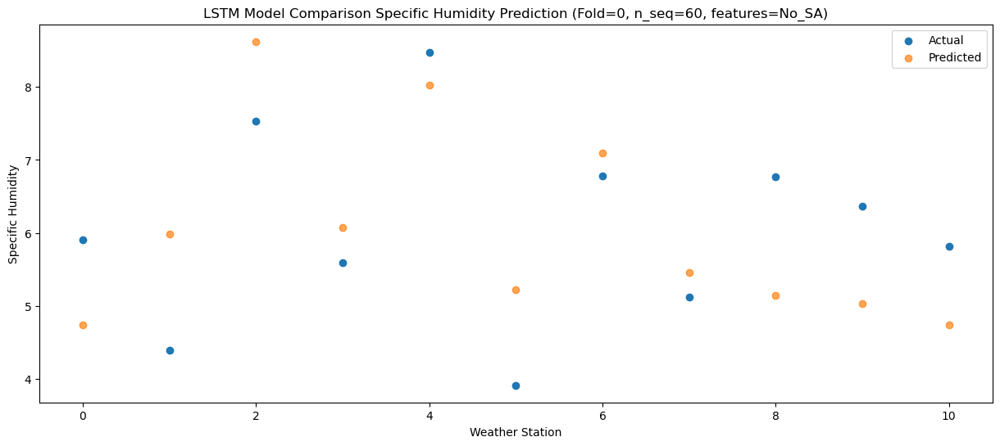

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61  -0.904481
1                 1   -1.27   0.345519
2                 2    1.66   2.985519
3                 3   -0.62   0.435519
4                 4    4.26   2.385519
5                 5   -1.35  -0.414481
6                 6    1.03   1.455519
7                 7   -0.67  -0.184481
8                 8    1.48  -0.494481
9                 9    0.85  -0.604481
10               10    0.96  -0.904481


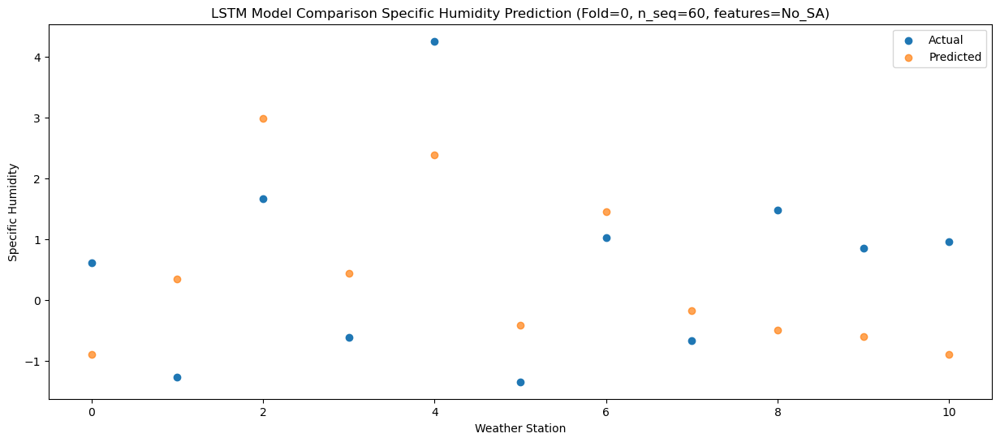

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39   1.109765
1                 1    2.37   2.359765
2                 2    4.06   4.999765
3                 3    2.43   2.449765
4                 4    7.02   4.399765
5                 5    0.07   1.599765
6                 6    2.87   3.469765
7                 7    1.10   1.829765
8                 8    3.07   1.519765
9                 9    1.69   1.409765
10               10    0.96   1.109765


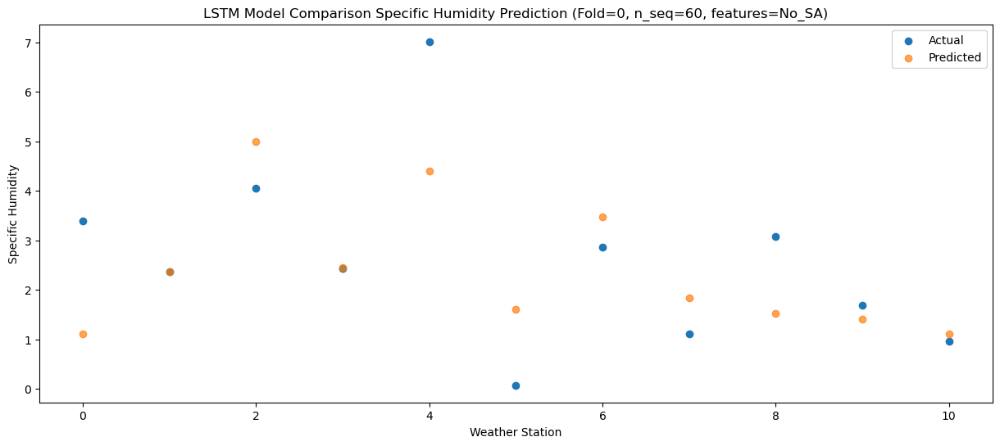

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.844283
1                 1   -2.39  -1.594283
2                 2    0.65   1.045717
3                 3   -2.69  -1.504283
4                 4    1.52   0.445717
5                 5   -3.04  -2.354283
6                 6    0.09  -0.484283
7                 7   -1.41  -2.124283
8                 8   -0.21  -2.434283
9                 9   -0.60  -2.544283
10               10   -1.11  -2.844283


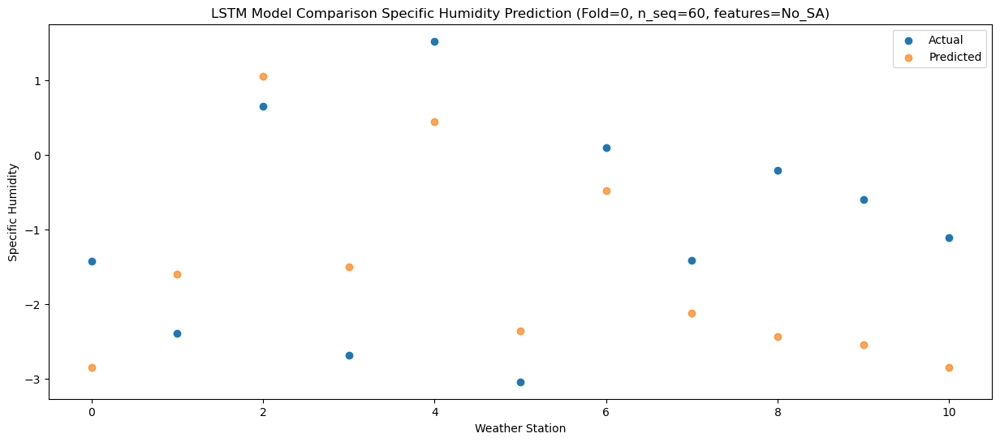

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76  -2.282639
1                 1   -1.17  -1.032639
2                 2    1.86   1.607361
3                 3   -1.48  -0.942639
4                 4    1.78   1.007361
5                 5   -1.66  -1.792639
6                 6    1.37   0.077361
7                 7   -0.18  -1.562639
8                 8    0.38  -1.872639
9                 9    0.14  -1.982639
10               10   -0.51  -2.282639


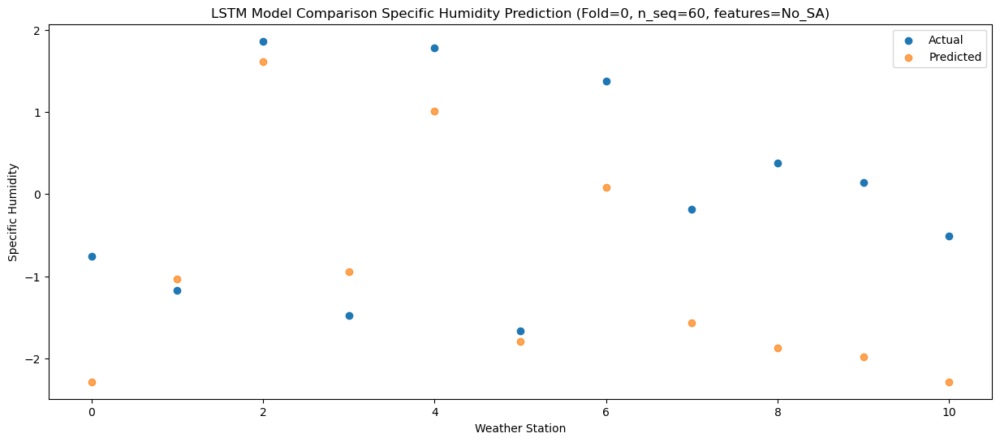

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64  -1.173869
1                 1    0.74   0.076131
2                 2    2.57   2.716131
3                 3   -0.39   0.166131
4                 4    3.33   2.116131
5                 5   -0.33  -0.683869
6                 6    2.38   1.186131
7                 7    0.81  -0.453869
8                 8    2.06  -0.763869
9                 9    1.42  -0.873869
10               10    0.74  -1.173869


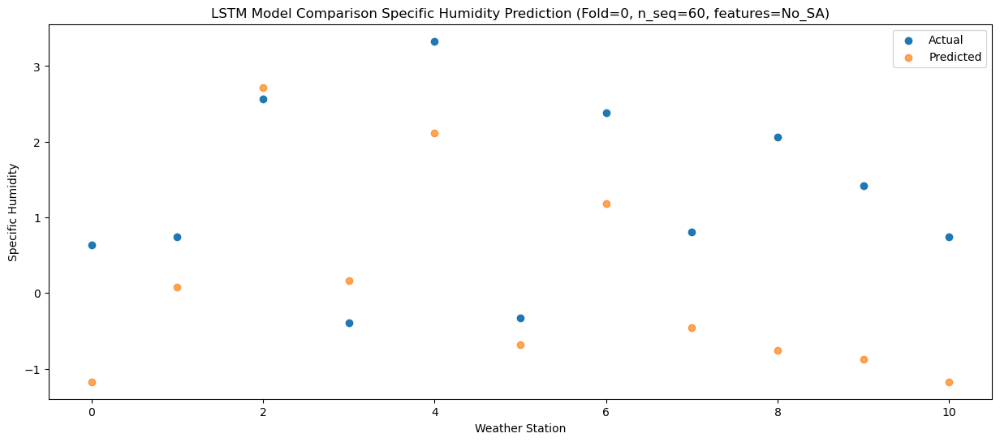

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   0.310749
1                 1    2.04   1.560749
2                 2    4.02   4.200749
3                 3    2.53   1.650749
4                 4    7.25   3.600749
5                 5    0.80   0.800749
6                 6    3.38   2.670749
7                 7    1.71   1.030749
8                 8    3.64   0.720749
9                 9    3.04   0.610749
10               10    1.68   0.310749


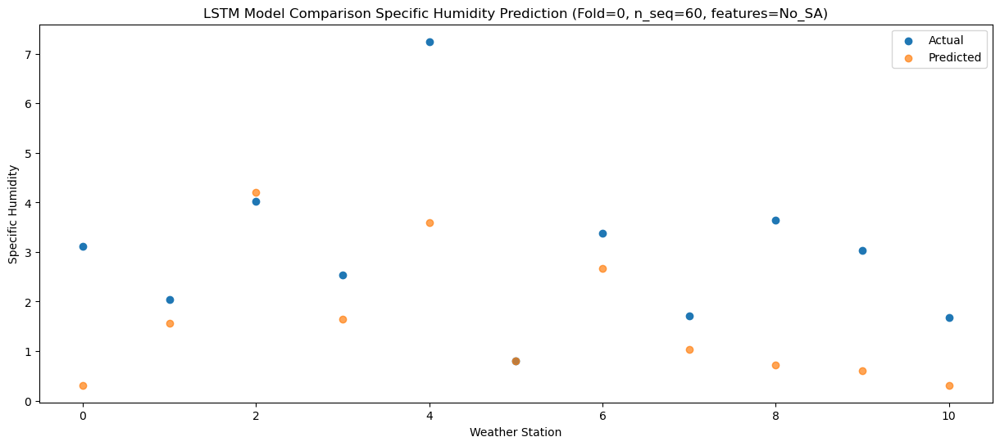

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   3.904939
1                 1    6.28   5.154939
2                 2    8.16   7.794939
3                 3    6.77   5.244939
4                 4   10.95   7.194939
5                 5    5.58   4.394939
6                 6    7.74   6.264939
7                 7    6.00   4.624939
8                 8    7.83   4.314939
9                 9    7.65   4.204939
10               10    5.40   3.904939


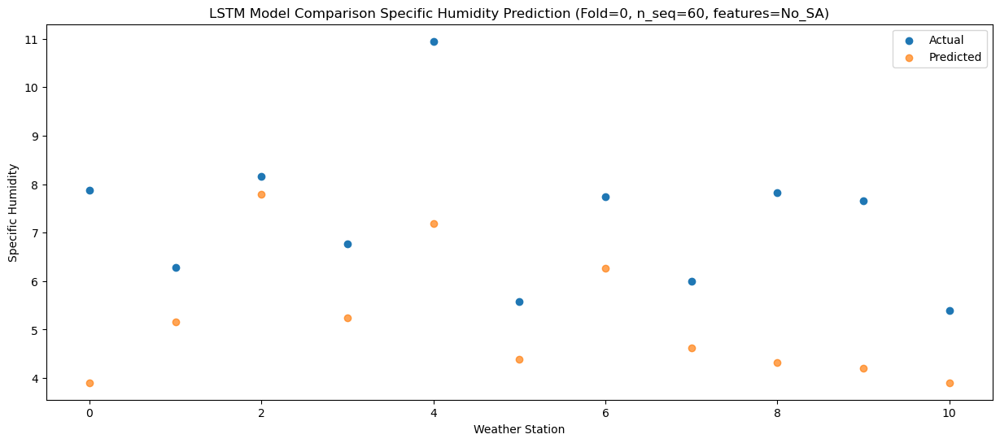

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80    5.64506
1                 1    8.89    6.89506
2                 2   10.94    9.53506
3                 3    8.78    6.98506
4                 4   11.92    8.93506
5                 5    6.67    6.13506
6                 6    9.62    8.00506
7                 7    7.45    6.36506
8                 8   10.01    6.05506
9                 9    9.33    5.94506
10               10    6.67    5.64506


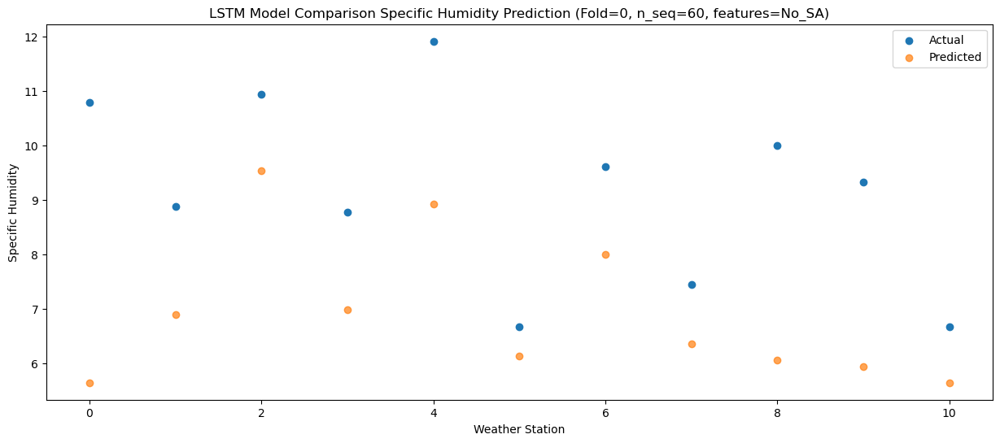

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38   7.800873
1                 1    9.79   9.050873
2                 2   13.14  11.690873
3                 3    9.99   9.140873
4                 4   11.68  11.090873
5                 5   11.00   8.290873
6                 6   13.24  10.160873
7                 7   10.82   8.520873
8                 8   13.67   8.210873
9                 9   12.91   8.100873
10               10    9.16   7.800873


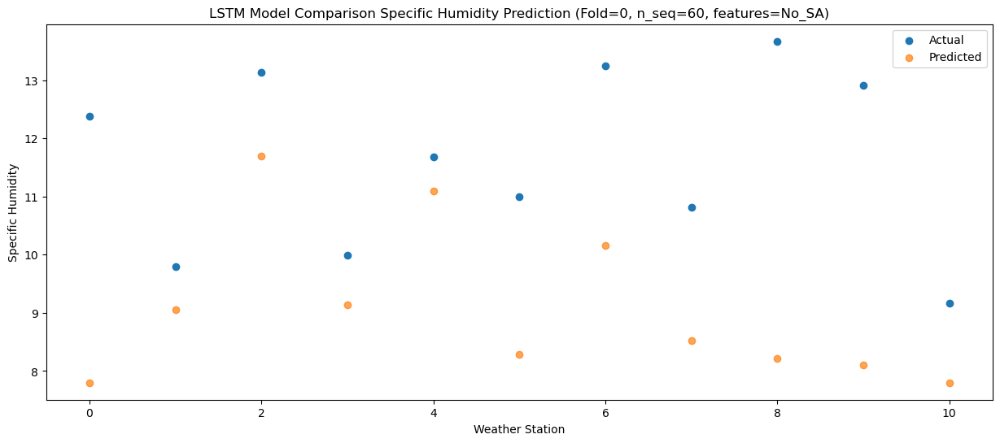

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96   7.808205
1                 1    9.22   9.058205
2                 2   12.44  11.698205
3                 3    9.27   9.148205
4                 4   12.77  11.098205
5                 5    9.21   8.298205
6                 6   11.89  10.168205
7                 7    9.75   8.528205
8                 8   12.70   8.218205
9                 9   11.37   8.108205
10               10   10.15   7.808205


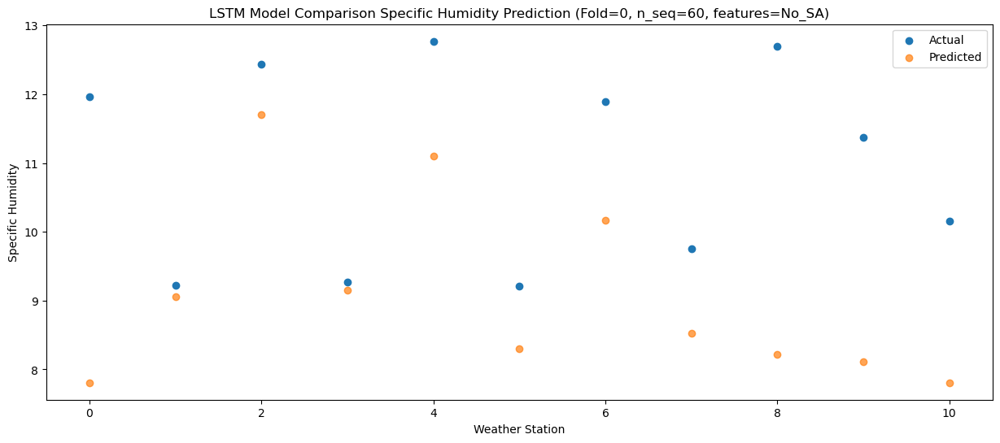

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   4.945651
1                 1    6.16   6.195651
2                 2    8.71   8.835651
3                 3    5.89   6.285651
4                 4    9.94   8.235651
5                 5    6.51   5.435651
6                 6    8.45   7.305651
7                 7    6.96   5.665651
8                 8    8.25   5.355651
9                 9    8.31   5.245651
10               10    7.55   4.945651


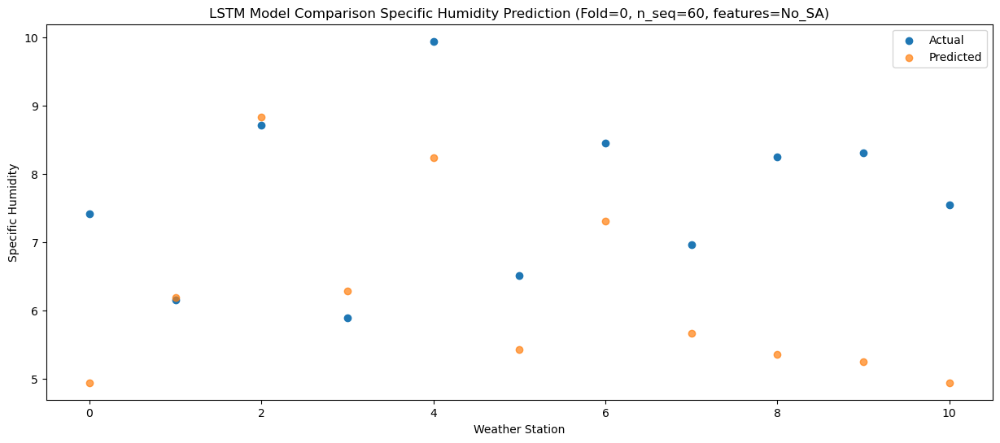

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   0.223971
1                 1    1.02   1.473971
2                 2    3.71   4.113971
3                 3    0.79   1.563971
4                 4    5.14   3.513971
5                 5    1.87   0.713971
6                 6    3.89   2.583971
7                 7    2.54   0.943971
8                 8    3.02   0.633971
9                 9    2.52   0.523971
10               10    2.53   0.223971


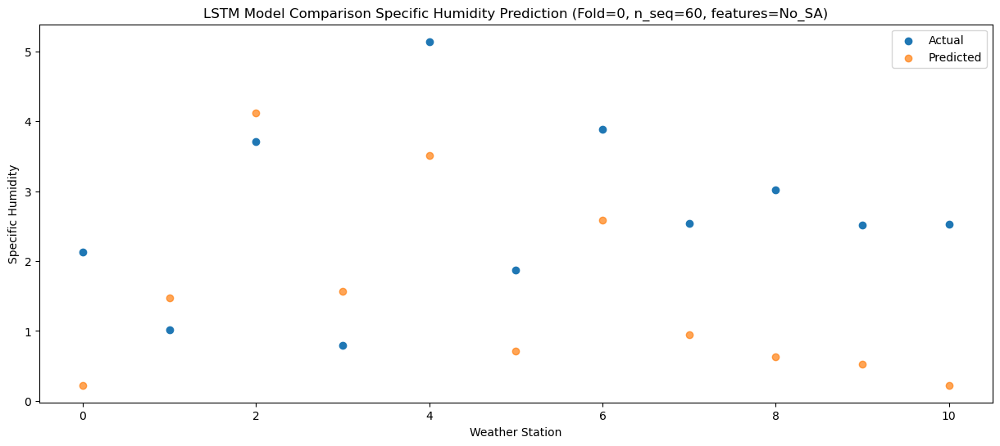

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59  -0.557035
1                 1    0.82   0.692965
2                 2    3.39   3.332965
3                 3    0.27   0.782965
4                 4    5.13   2.732965
5                 5    1.21  -0.067035
6                 6    3.29   1.802965
7                 7    1.84   0.162965
8                 8    2.02  -0.147035
9                 9    1.80  -0.257035
10               10    1.39  -0.557035


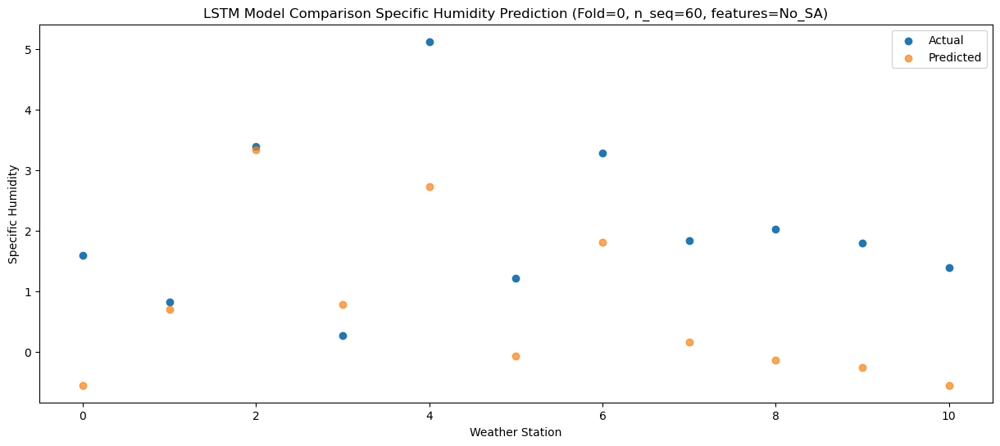

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13  -1.842303
1                 1   -0.38  -0.592303
2                 2    2.06   2.047697
3                 3   -0.23  -0.502303
4                 4    4.05   1.447697
5                 5   -2.14  -1.352303
6                 6    1.11   0.517697
7                 7   -0.50  -1.122303
8                 8    1.09  -1.432303
9                 9    0.87  -1.542303
10               10    0.22  -1.842303


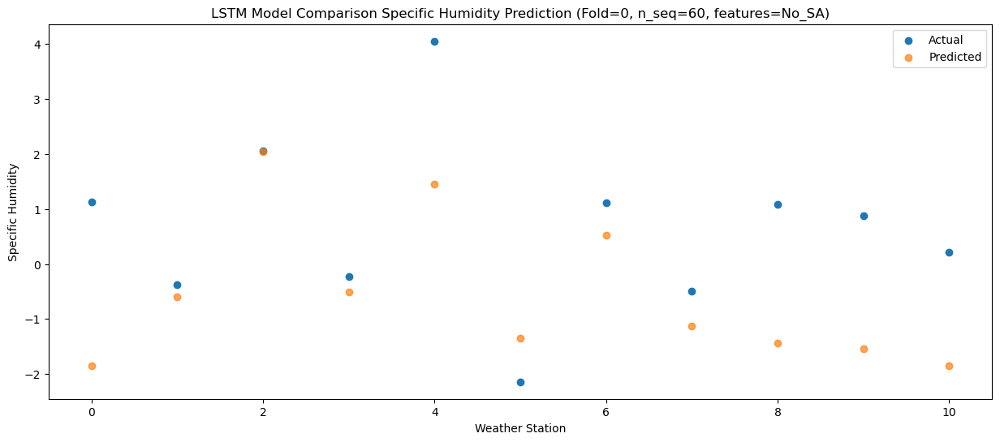

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73  -1.548603
1                 1   -0.29  -0.298603
2                 2    2.43   2.341397
3                 3   -0.04  -0.208603
4                 4    3.29   1.741397
5                 5   -1.39  -1.058603
6                 6    1.97   0.811397
7                 7    0.43  -0.828603
8                 8    1.69  -1.138603
9                 9    1.48  -1.248603
10               10    0.62  -1.548603


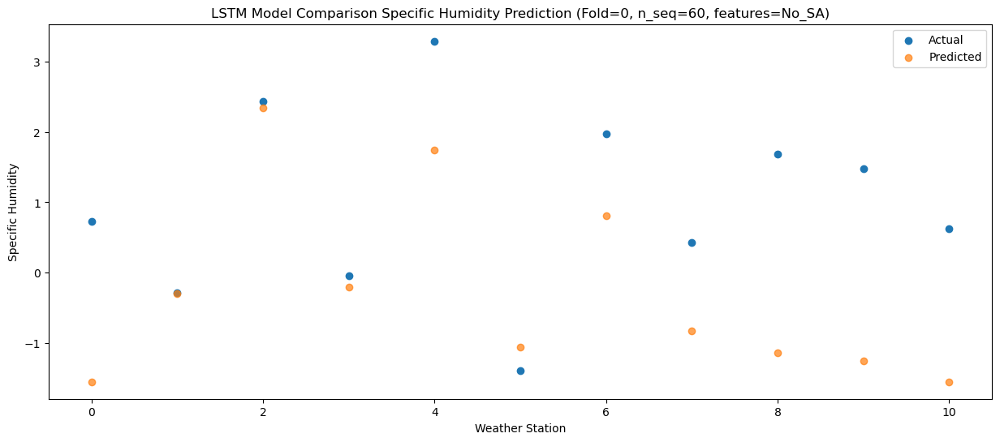

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35  -1.656511
1                 1    1.40  -0.406511
2                 2    3.54   2.233489
3                 3    0.63  -0.316511
4                 4    3.63   1.633489
5                 5   -0.46  -1.166511
6                 6    2.65   0.703489
7                 7    0.79  -0.936511
8                 8    1.76  -1.246511
9                 9    1.25  -1.356511
10               10    0.06  -1.656511


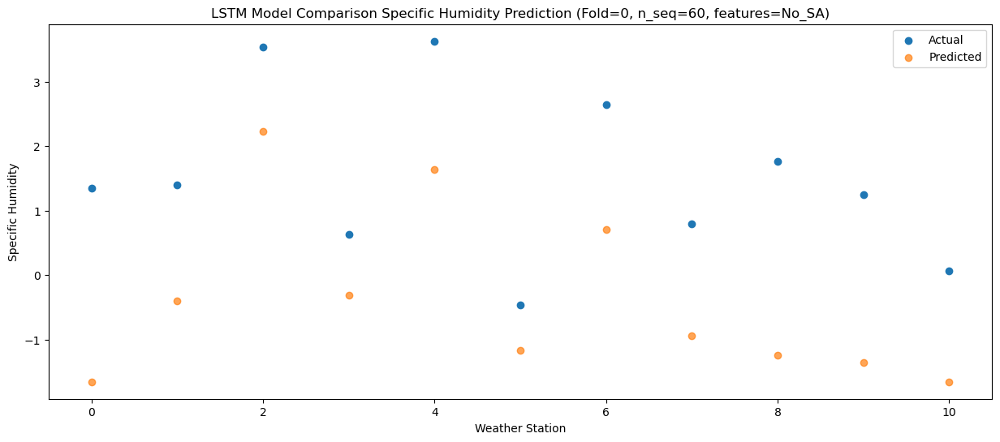

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95  -0.705212
1                 1    1.78   0.544788
2                 2    2.90   3.184788
3                 3    1.71   0.634788
4                 4    5.82   2.584788
5                 5   -0.68  -0.215212
6                 6    2.24   1.654788
7                 7    0.71   0.014788
8                 8    2.20  -0.295212
9                 9    1.35  -0.405212
10               10    0.52  -0.705212


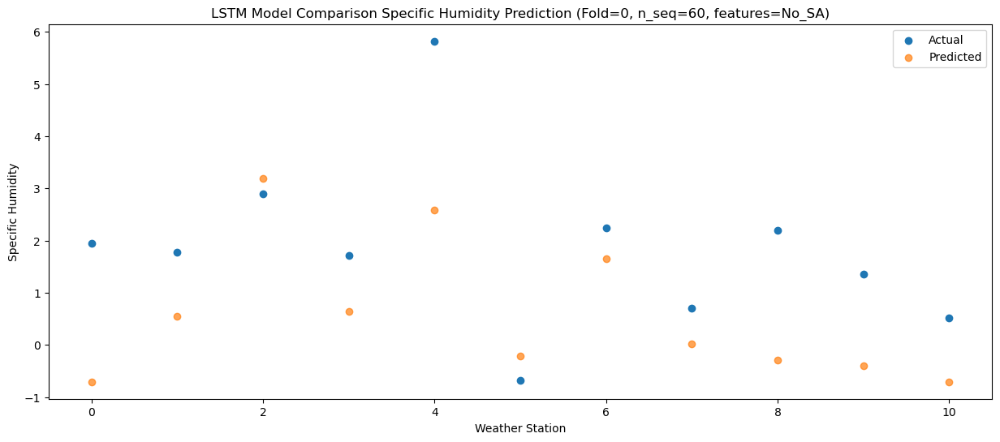

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   0.398475
1                 1    2.57   1.648475
2                 2    4.34   4.288475
3                 3    2.11   1.738475
4                 4    6.58   3.688475
5                 5    2.00   0.888475
6                 6    4.45   2.758475
7                 7    2.99   1.118475
8                 8    3.42   0.808475
9                 9    3.08   0.698475
10               10    2.16   0.398475


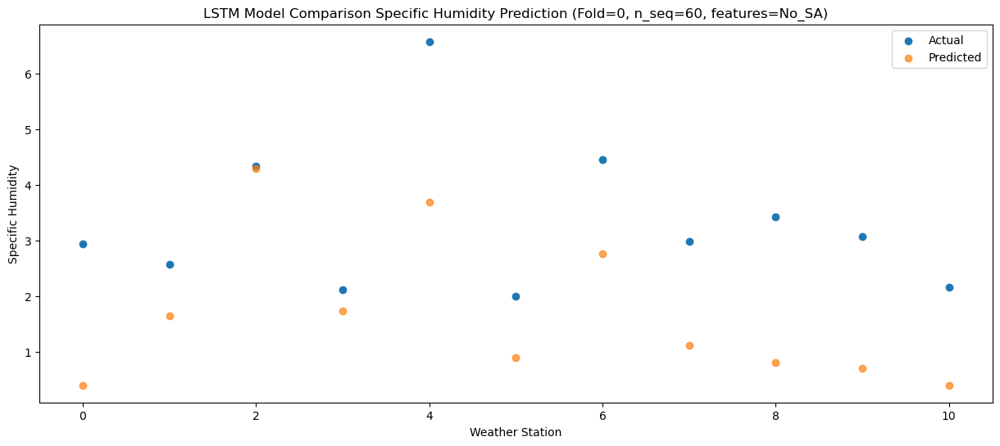

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   2.419638
1                 1    4.76   3.669638
2                 2    7.12   6.309638
3                 3    4.96   3.759638
4                 4   10.52   5.709638
5                 5    2.76   2.909638
6                 6    6.04   4.779638
7                 7    4.31   3.139638
8                 8    6.91   2.829638
9                 9    5.52   2.719638
10               10    3.37   2.419638


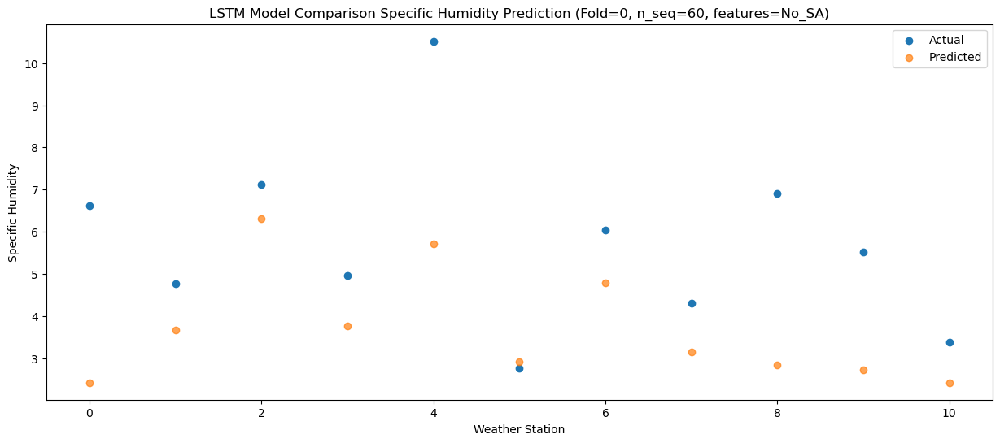

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41   5.728793
1                 1    8.09   6.978793
2                 2    9.70   9.618793
3                 3    9.11   7.068793
4                 4   14.64   9.018793
5                 5    6.66   6.218793
6                 6    8.77   8.088793
7                 7    6.93   6.448793
8                 8    9.19   6.138793
9                 9    8.14   6.028793
10               10    6.38   5.728793


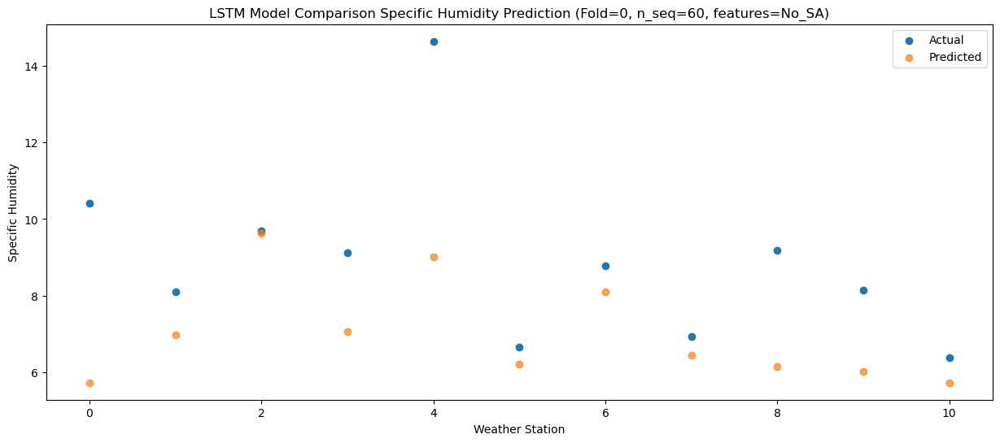

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70   7.642815
1                 1    9.76   8.892815
2                 2   12.56  11.532815
3                 3   10.14   8.982815
4                 4   13.22  10.932815
5                 5   11.01   8.132815
6                 6   12.51  10.002815
7                 7   11.28   8.362815
8                 8   12.74   8.052815
9                 9   11.96   7.942815
10               10   10.21   7.642815


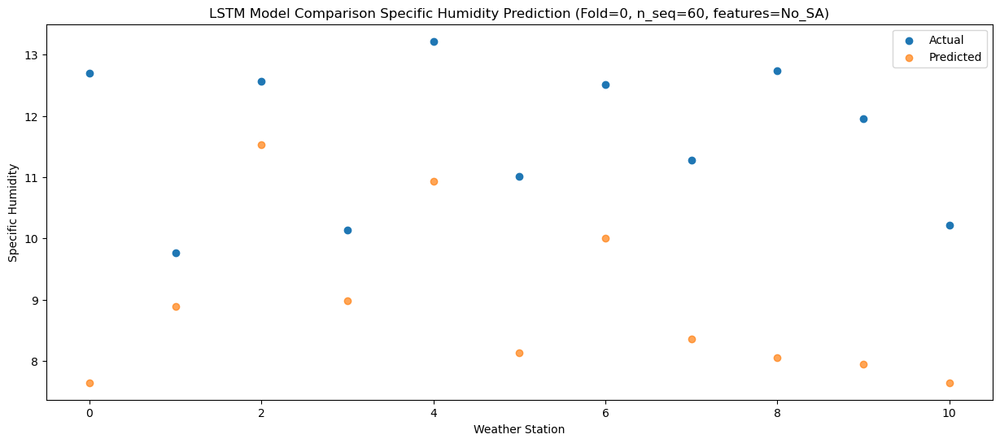

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   7.321387
1                 1   10.54   8.571387
2                 2   12.65  11.211387
3                 3    9.89   8.661387
4                 4   11.40  10.611387
5                 5   10.12   7.811387
6                 6   12.14   9.681387
7                 7   10.22   8.041387
8                 8   12.74   7.731387
9                 9   10.66   7.621387
10               10    9.46   7.321387


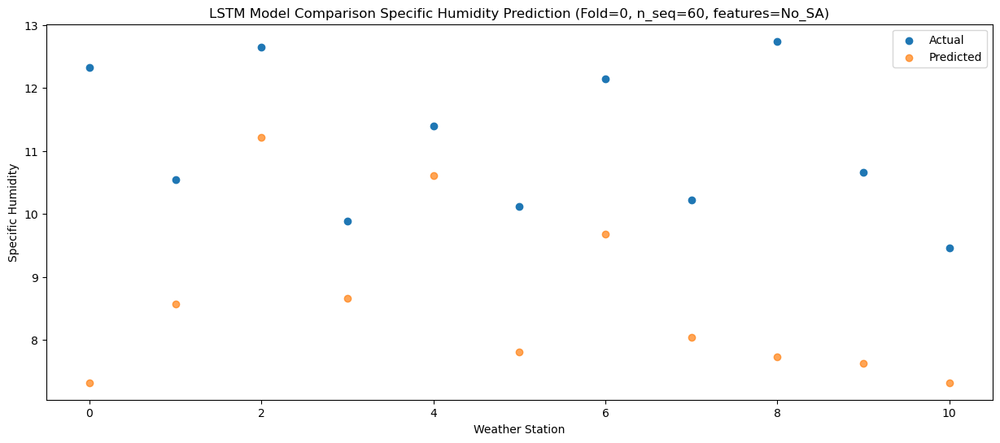

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   6.007632
1                 1    6.52   7.257632
2                 2    9.07   9.897632
3                 3    7.71   7.347632
4                 4   11.36   9.297632
5                 5    7.00   6.497632
6                 6    9.20   8.367632
7                 7    7.42   6.727632
8                 8    8.67   6.417632
9                 9    7.94   6.307632
10               10    8.15   6.007632


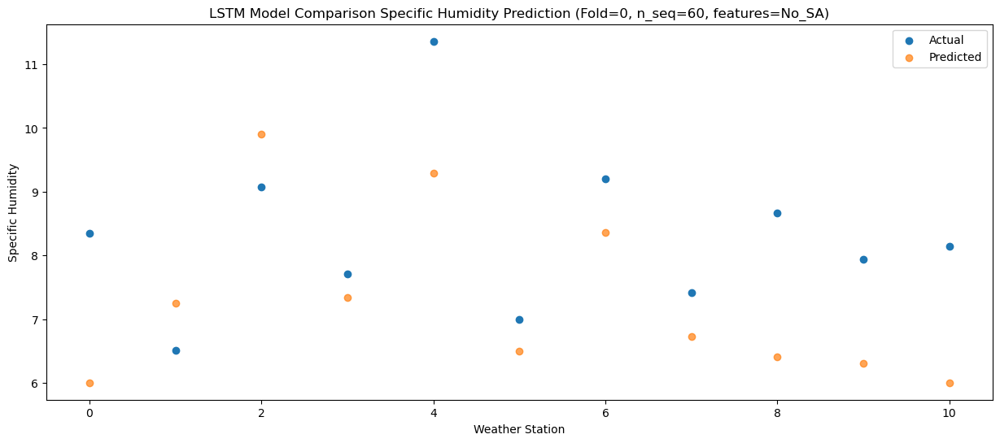

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   1.774411
1                 1    1.82   3.024411
2                 2    5.16   5.664411
3                 3    3.14   3.114411
4                 4    7.61   5.064411
5                 5    2.60   2.264411
6                 6    4.94   4.134411
7                 7    3.67   2.494411
8                 8    4.61   2.184411
9                 9    4.70   2.074411
10               10    4.39   1.774411


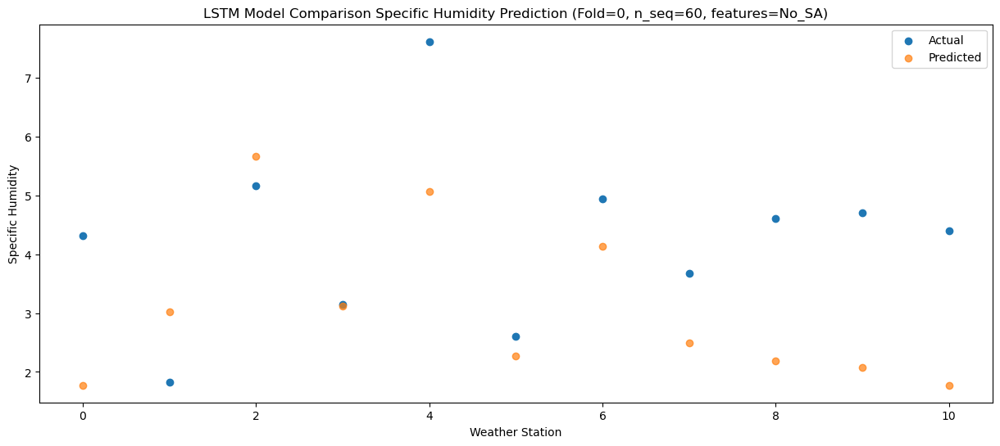

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14  -1.332921
1                 1   -0.36  -0.082921
2                 2    2.63   2.557079
3                 3    0.15   0.007079
4                 4    4.81   1.957079
5                 5   -0.42  -0.842921
6                 6    1.61   1.027079
7                 7    0.15  -0.612921
8                 8    1.95  -0.922921
9                 9    1.35  -1.032921
10               10    0.98  -1.332921


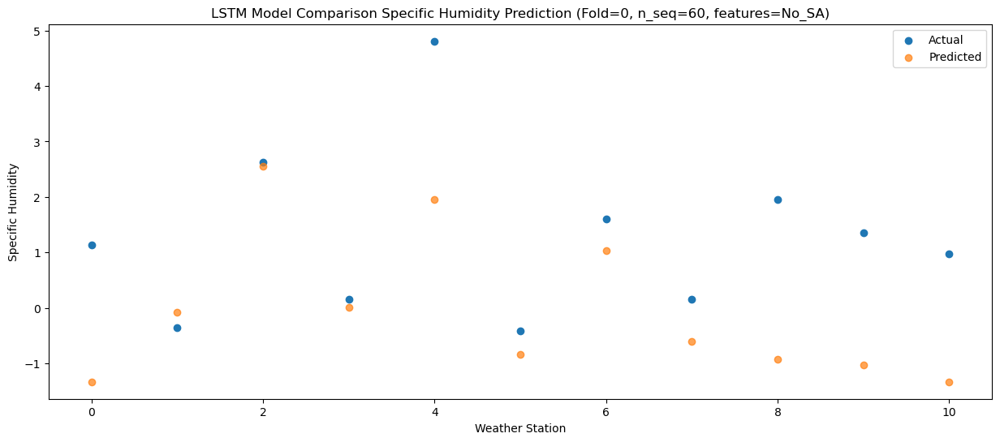

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -1.265092
1                 1   -1.80  -0.015092
2                 2    1.82   2.624908
3                 3   -1.25   0.074908
4                 4    2.95   2.024908
5                 5   -1.24  -0.775092
6                 6    1.54   1.094908
7                 7    0.35  -0.545092
8                 8    1.34  -0.855092
9                 9    1.54  -0.965092
10               10    1.51  -1.265092


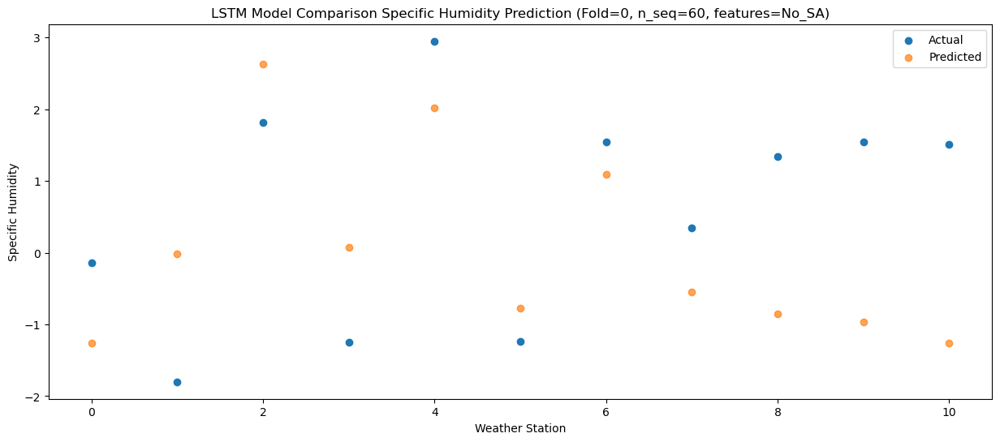

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -2.044105
1                 1   -2.58  -0.794105
2                 2    1.02   1.845895
3                 3   -2.17  -0.704105
4                 4    1.77   1.245895
5                 5   -2.03  -1.554105
6                 6    0.87   0.315895
7                 7   -0.34  -1.324105
8                 8    0.16  -1.634105
9                 9    0.57  -1.744105
10               10   -0.01  -2.044105


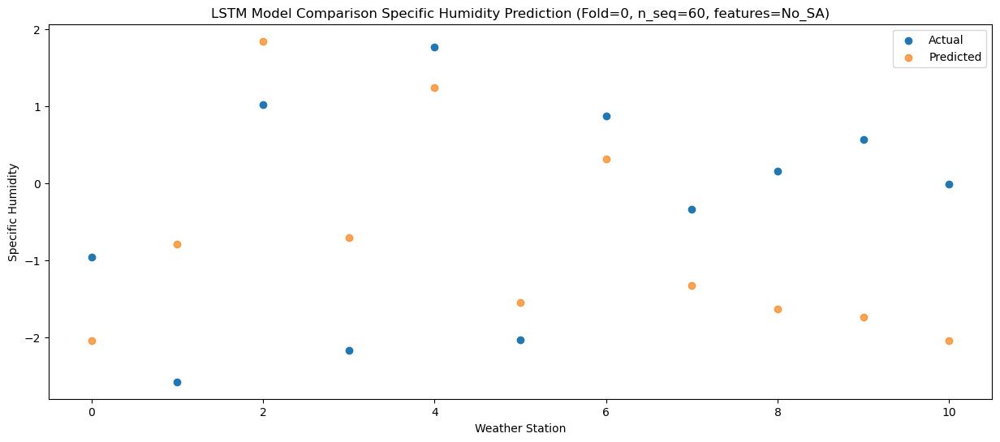

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94  -0.981244
1                 1   -1.36   0.268756
2                 2    1.66   2.908756
3                 3   -0.39   0.358756
4                 4    4.34   2.308756
5                 5   -2.13  -0.491244
6                 6    1.03   1.378756
7                 7   -0.31  -0.261244
8                 8    1.92  -0.571244
9                 9    0.92  -0.681244
10               10    0.52  -0.981244


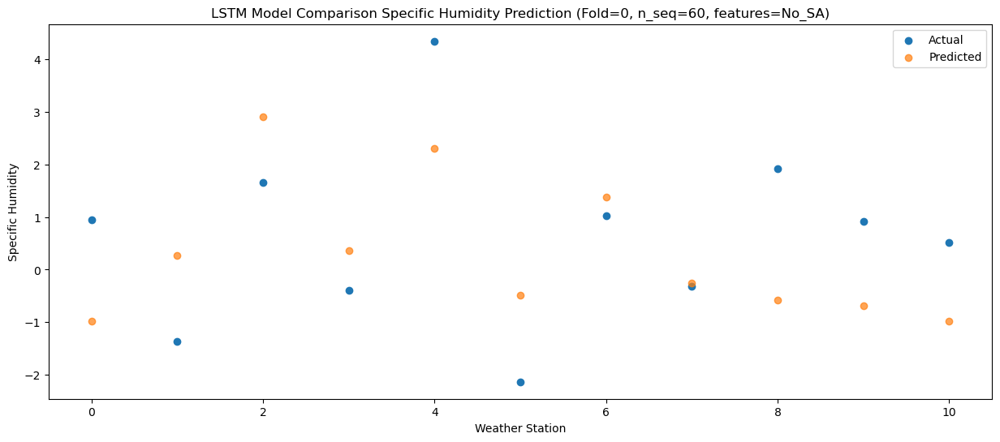

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20  -0.589738
1                 1    0.49   0.660262
2                 2    3.29   3.300262
3                 3    1.40   0.750262
4                 4    6.08   2.700262
5                 5   -0.21  -0.099738
6                 6    2.48   1.770262
7                 7    0.83   0.130262
8                 8    2.79  -0.179738
9                 9    2.05  -0.289738
10               10    1.21  -0.589738


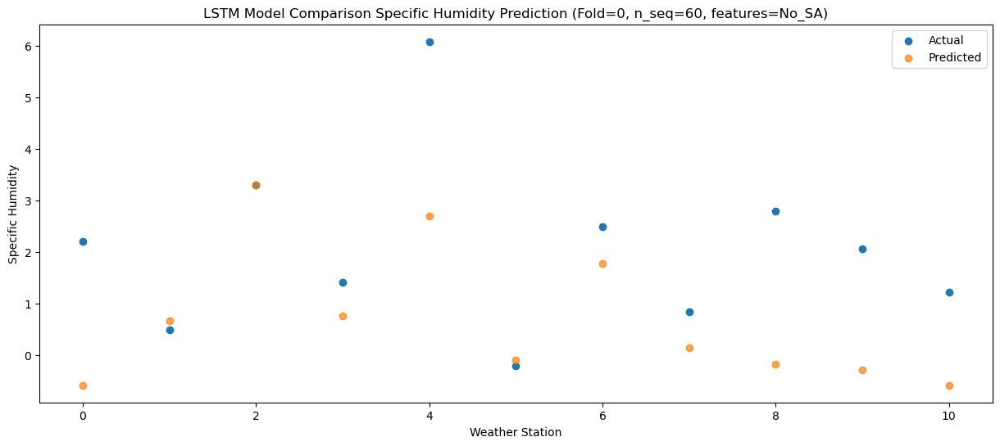

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   1.395354
1                 1    2.40   2.645354
2                 2    5.03   5.285354
3                 3    3.45   2.735354
4                 4    8.32   4.685354
5                 5    1.13   1.885354
6                 6    4.54   3.755354
7                 7    2.85   2.115354
8                 8    5.02   1.805354
9                 9    4.42   1.695354
10               10    2.77   1.395354


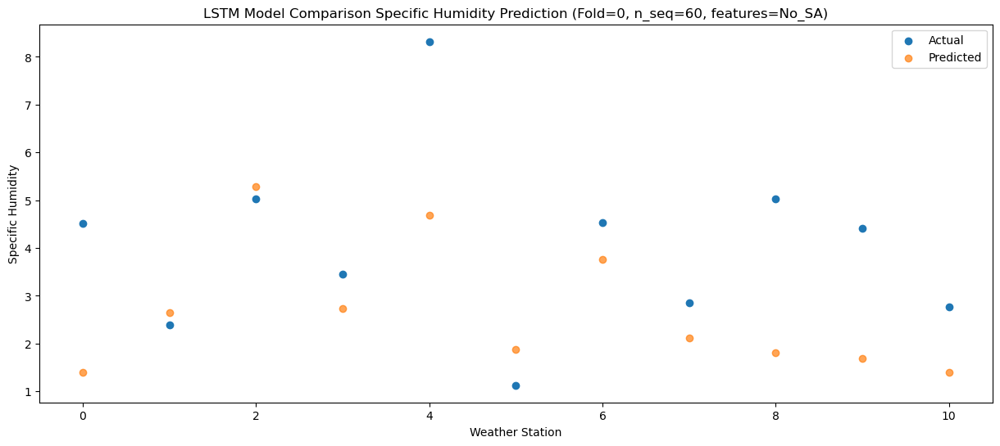

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   4.697603
1                 1    6.98   5.947603
2                 2    8.78   8.587603
3                 3    8.02   6.037603
4                 4   12.57   7.987603
5                 5    5.19   5.187603
6                 6    8.45   7.057603
7                 7    6.67   5.417603
8                 8    9.30   5.107603
9                 9    8.22   4.997603
10               10    5.82   4.697603


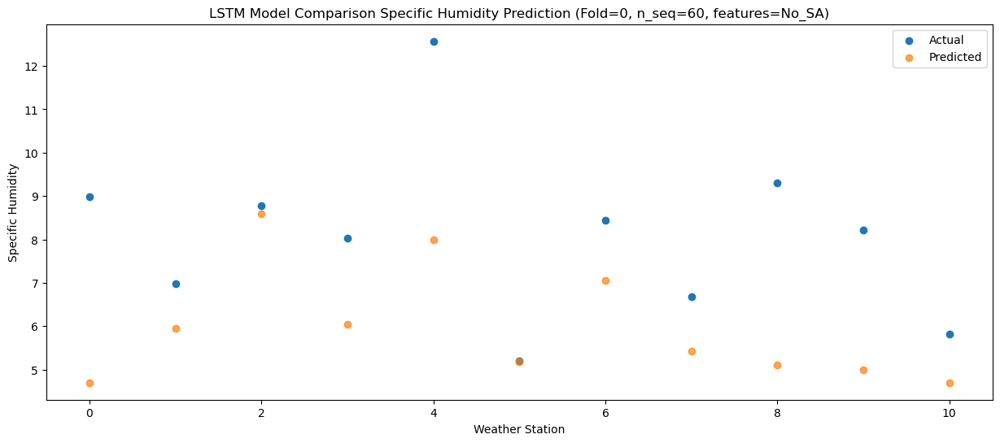

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37    7.11193
1                 1    8.58    8.36193
2                 2    9.91   11.00193
3                 3    9.53    8.45193
4                 4   14.22   10.40193
5                 5    7.16    7.60193
6                 6   10.27    9.47193
7                 7    8.36    7.83193
8                 8   11.72    7.52193
9                 9    9.29    7.41193
10               10    8.32    7.11193


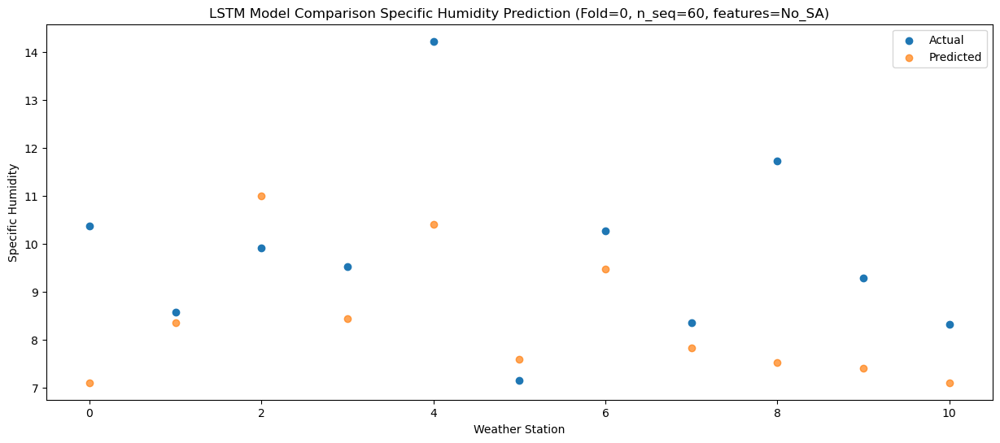

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66    8.32471
1                 1   10.75    9.57471
2                 2   13.14   12.21471
3                 3   10.93    9.66471
4                 4   13.96   11.61471
5                 5    9.95    8.81471
6                 6   12.80   10.68471
7                 7   11.25    9.04471
8                 8   12.90    8.73471
9                 9   10.79    8.62471
10               10    9.39    8.32471


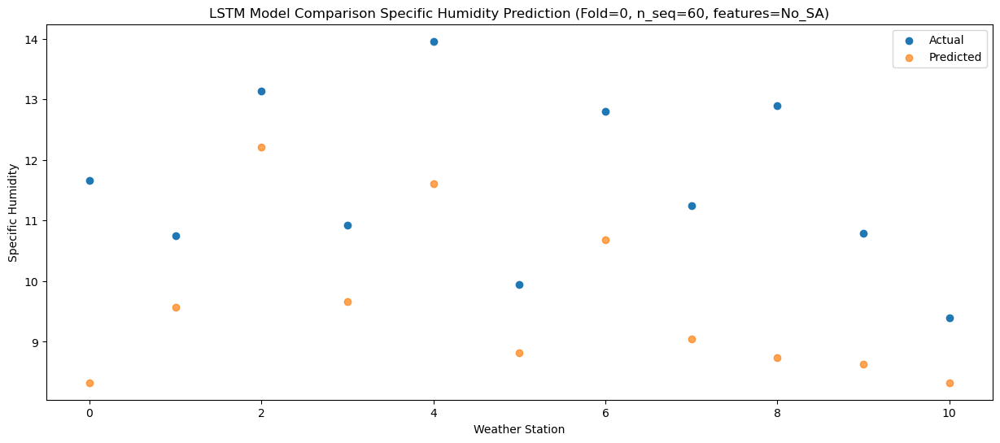

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   8.459387
1                 1    9.25   9.709387
2                 2   11.45  12.349387
3                 3    9.79   9.799387
4                 4   13.61  11.749387
5                 5    8.94   8.949387
6                 6   11.64  10.819387
7                 7    9.82   9.179387
8                 8   11.23   8.869387
9                 9    9.99   8.759387
10               10    9.15   8.459387


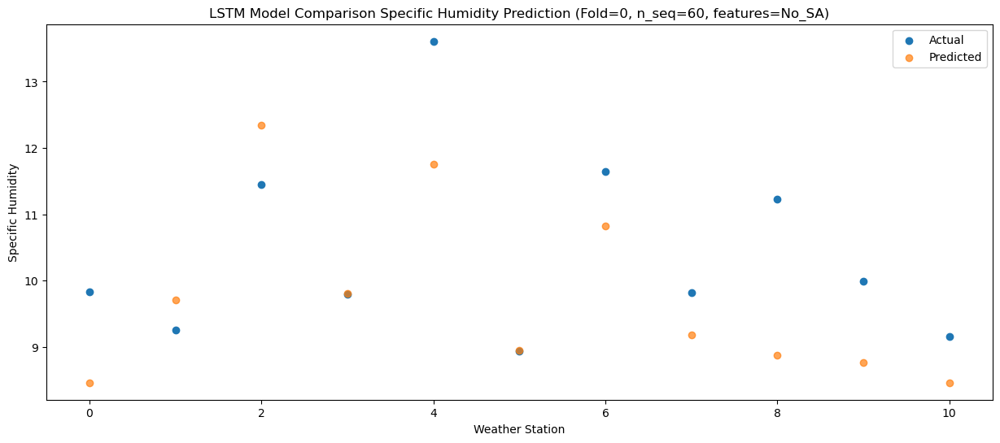

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36   6.334106
1                 1    8.38   7.584106
2                 2    9.76  10.224106
3                 3    8.23   7.674106
4                 4   11.12   9.624106
5                 5    6.99   6.824106
6                 6    9.91   8.694106
7                 7    8.23   7.054106
8                 8    9.19   6.744106
9                 9    7.64   6.634106
10               10    7.44   6.334106


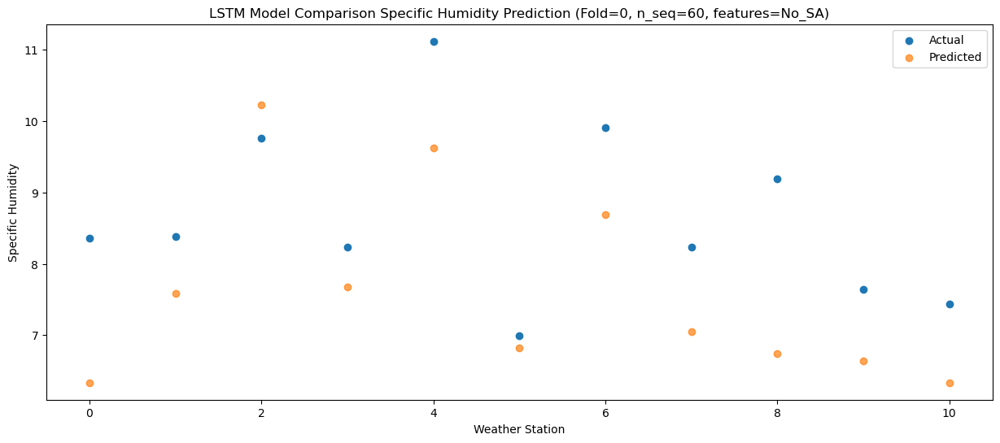

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98   2.141198
1                 1    2.98   3.391198
2                 2    5.63   6.031198
3                 3    3.04   3.481198
4                 4    7.51   5.431198
5                 5    1.70   2.631198
6                 6    5.21   4.501198
7                 7    3.34   2.861198
8                 8    4.59   2.551198
9                 9    4.11   2.441198
10               10    3.24   2.141198


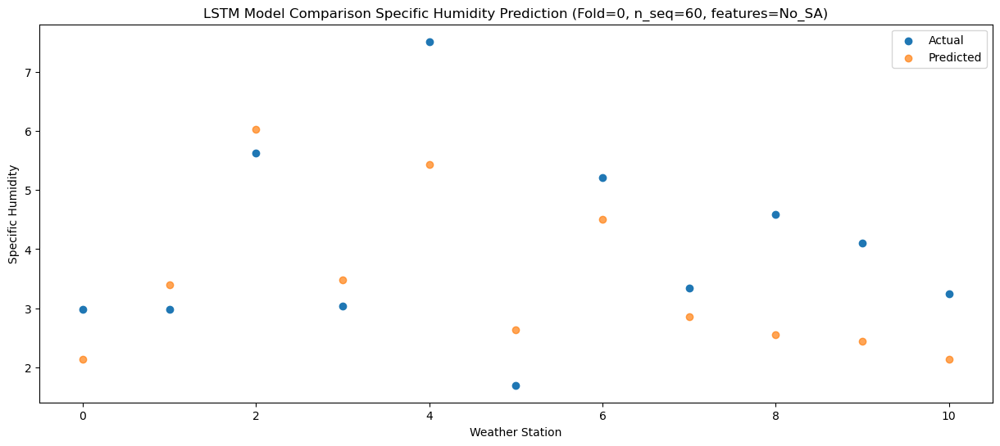

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

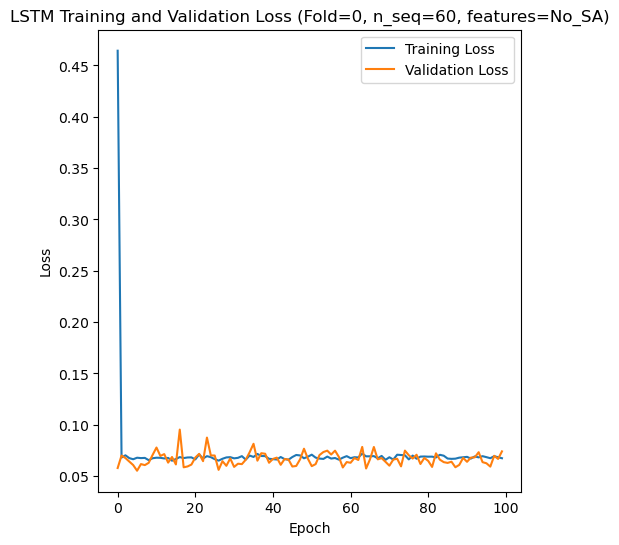

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 49s 256ms/step - loss: 0.6984 - accuracy: 0.2143 - mae: 0.6205 - rmse: 0.6984 - mape: 138.4262 - pearson: 0.5729 - val_loss: 0.0603 - val_accuracy: 0.5000 - val_mae: 0.0464 - val_rmse: 0.0603 - val_mape: 10.4751 - val_pearson: 0.7915
Epoch 2/100
84/84 [==============================] - 14s 167ms/step - loss: 0.0818 - accuracy: 0.4762 - mae: 0.0648 - rmse: 0.0818 - mape: 14.6363 - pearson: 0.7582 - val_loss: 0.0666 - val_accuracy: 0.5000 - val_mae: 0.0526 - val_rmse: 0.0666 - val_mape: 11.3540 - val_pearson: 0.7640
Epoch 3/100
84/84 [==============================] - 15s 173ms/step - loss: 0.0784 - accuracy: 0.4881 - mae: 0.0628 - rmse: 0.0784 - mape: 13.8374 - pearson: 0.764

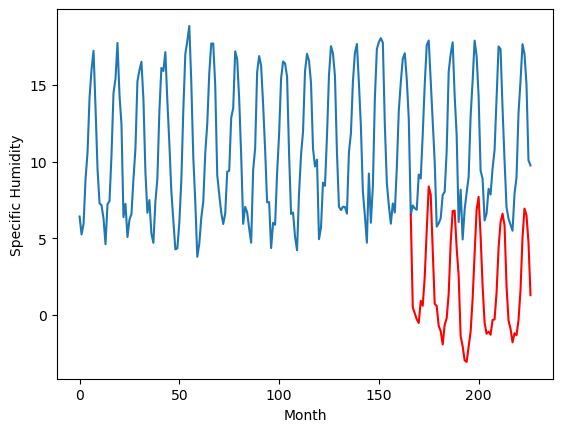

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		4.56		3.45
1.16		4.18		3.02
0.91		3.78		2.87
1.43		3.55		2.12
3.66		4.99		1.33
2.07		4.67		2.60
5.08		6.57		1.49
8.88		9.59		0.71
10.92		12.44		1.52
10.97		11.92		0.95
8.07		8.29		0.22
5.40		4.79		-0.61
2.34		4.65		2.31
-0.25		3.35		3.60
-0.23		3.01		3.24
-0.04		2.14		2.18
1.49		3.43		1.94
1.85		3.86		2.01
4.77		5.45		0.68
8.75		8.76		0.01
10.62		10.85		0.23
10.83		10.87		0.04
7.88		8.42		0.54
5.84		6.62		0.78
0.25		2.68		2.43
2.42		2.03		-0.39
-0.58		1.11		1.69
0.37		1.01		0.64
1.05		1.99		0.94
2.11		2.98		0.87
6.28		5.11		-1.17
8.68		8.07		-0.61
11.35		10.92		-0.43
10.94		11.77		0.83
7.58		9.23		1.65
2.69		5.96		3.27
2.21		3.56		1.35
0.62		2.84		2.22
1.03		2.98		1.95
2.15		2.78		0.63
1.28		3.74		2.46
2.88		3.78		0.90
5.62		5.52		-0.10
7.97		8.44		0.47
10.93		10.12		-0.81
11.06		10.68		-0.38
7.95		9.91		1.96
4.10		5.93		1.83
1.09		3.71		2.62
0.51		3.17		2.66
-0.26		2.28		2.54
0.08		2.8

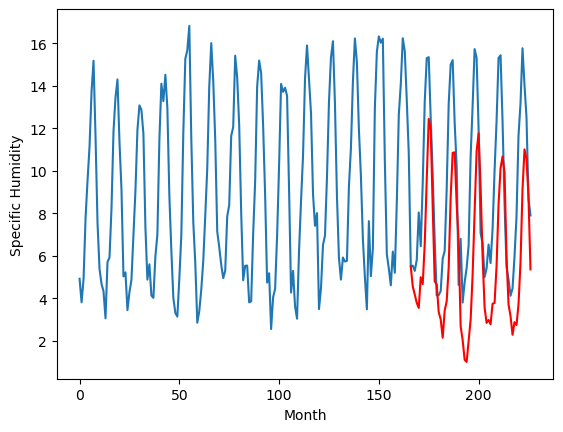

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		3.05		3.10
0.86		2.67		1.81
0.35		2.27		1.92
0.74		2.04		1.30
3.90		3.48		-0.42
2.28		3.16		0.88
5.05		5.06		0.01
8.90		8.08		-0.82
11.45		10.93		-0.52
10.97		10.41		-0.56
8.02		6.78		-1.24
5.26		3.28		-1.98
2.08		3.14		1.06
-0.69		1.84		2.53
-0.54		1.50		2.04
-0.54		0.63		1.17
2.08		1.92		-0.16
1.79		2.35		0.56
4.63		3.94		-0.69
9.15		7.25		-1.90
10.74		9.34		-1.40
10.96		9.36		-1.60
8.20		6.91		-1.29
5.45		5.11		-0.34
-0.05		1.17		1.22
2.59		0.52		-2.07
-1.29		-0.40		0.89
-0.26		-0.50		-0.24
0.53		0.48		-0.05
2.29		1.47		-0.82
6.65		3.60		-3.05
9.74		6.56		-3.18
11.37		9.41		-1.96
10.50		10.26		-0.24
6.99		7.72		0.73
1.88		4.45		2.57
1.51		2.05		0.54
0.82		1.33		0.51
0.79		1.47		0.68
1.84		1.27		-0.57
1.37		2.23		0.86
2.73		2.27		-0.46
6.03		4.01		-2.02
8.68		6.93		-1.75
11.82		8.61		-3.21
11.75		9.17		-2.58
7.94		8.40		0.46
3.43		4.42		0.99
0.88		2.20		1.32
-0.14		1.66		1.80
-0.77		

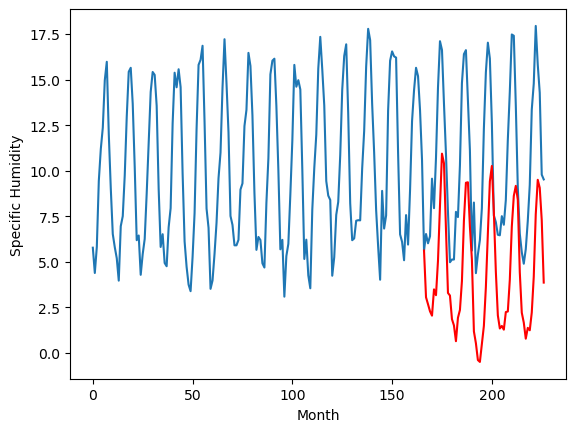

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		3.90		2.01
0.69		3.52		2.83
1.59		3.12		1.53
0.89		2.89		2.00
5.25		4.33		-0.92
4.91		4.01		-0.90
6.89		5.91		-0.98
9.01		8.93		-0.08
11.52		11.78		0.26
10.41		11.26		0.85
8.83		7.63		-1.20
5.43		4.13		-1.30
3.33		3.99		0.66
0.78		2.69		1.91
0.44		2.35		1.91
0.51		1.48		0.97
3.15		2.77		-0.38
4.49		3.20		-1.29
8.38		4.79		-3.59
11.57		8.10		-3.47
12.05		10.19		-1.86
12.39		10.21		-2.18
9.30		7.76		-1.54
7.05		5.96		-1.09
2.60		2.02		-0.58
5.52		1.37		-4.15
-0.13		0.45		0.58
0.04		0.35		0.31
1.72		1.33		-0.39
5.88		2.32		-3.56
9.69		4.45		-5.24
10.74		7.41		-3.33
11.66		10.26		-1.40
11.91		11.11		-0.80
8.62		8.57		-0.05
3.66		5.30		1.64
3.16		2.90		-0.26
2.35		2.18		-0.17
1.93		2.32		0.39
2.71		2.12		-0.59
4.26		3.08		-1.18
4.63		3.12		-1.51
8.41		4.86		-3.55
11.81		7.78		-4.03
12.37		9.46		-2.91
10.70		10.02		-0.68
9.50		9.25		-0.25
6.08		5.27		-0.81
2.75		3.05		0.30
1.11		2.51		1.40
0.

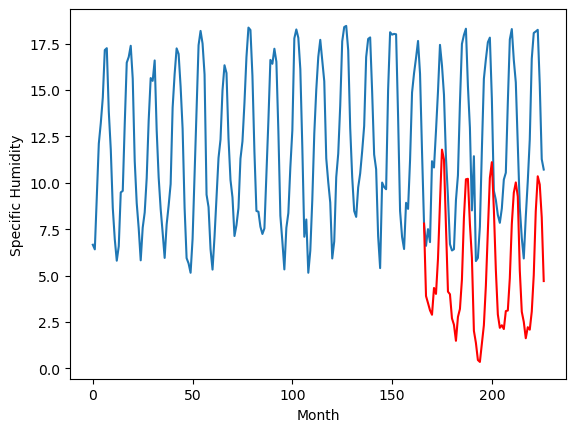

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		4.79		2.35
1.20		4.41		3.21
2.11		4.01		1.90
1.43		3.78		2.35
6.16		5.22		-0.94
5.85		4.90		-0.95
7.97		6.80		-1.17
10.26		9.82		-0.44
12.86		12.67		-0.19
11.41		12.15		0.74
9.92		8.52		-1.40
6.07		5.02		-1.05
3.59		4.88		1.29
0.77		3.58		2.81
0.52		3.24		2.72
0.56		2.37		1.81
3.28		3.66		0.38
4.54		4.09		-0.45
8.57		5.68		-2.89
11.98		8.99		-2.99
12.16		11.08		-1.08
12.20		11.10		-1.10
9.10		8.65		-0.45
7.15		6.85		-0.30
2.56		2.91		0.35
5.49		2.26		-3.23
-0.05		1.34		1.39
0.15		1.24		1.09
1.85		2.22		0.37
5.95		3.21		-2.74
9.83		5.34		-4.49
10.95		8.30		-2.65
11.70		11.15		-0.55
12.08		12.00		-0.08
8.73		9.46		0.73
3.83		6.19		2.36
3.45		3.79		0.34
2.63		3.07		0.44
2.15		3.21		1.06
2.75		3.01		0.26
4.45		3.97		-0.48
4.90		4.01		-0.89
8.57		5.75		-2.82
11.83		8.67		-3.16
11.91		10.35		-1.56
10.51		10.91		0.40
9.76		10.14		0.38
6.37		6.16		-0.21
3.03		3.94		0.91
1.31		3.40		2.09
0.14		2

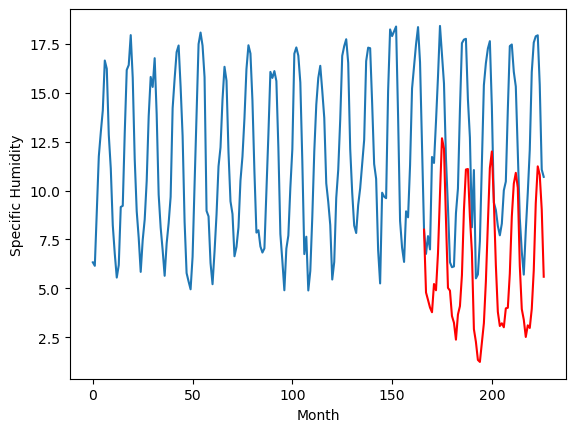

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		4.46		-0.30
3.28		4.08		0.80
3.00		3.68		0.68
3.18		3.45		0.27
5.85		4.89		-0.96
4.84		4.57		-0.27
7.52		6.47		-1.05
9.34		9.49		0.15
10.33		12.34		2.01
9.10		11.82		2.72
8.67		8.19		-0.48
5.16		4.69		-0.47
4.60		4.55		-0.05
2.16		3.25		1.09
2.99		2.91		-0.08
2.36		2.04		-0.32
3.15		3.33		0.18
4.45		3.76		-0.69
8.76		5.35		-3.41
10.93		8.66		-2.27
12.26		10.75		-1.51
12.48		10.77		-1.71
8.94		8.32		-0.62
5.83		6.52		0.69
3.99		2.58		-1.41
2.94		1.93		-1.01
1.67		1.01		-0.66
1.55		0.91		-0.64
2.10		1.89		-0.21
4.37		2.88		-1.49
6.14		5.01		-1.13
8.74		7.97		-0.77
9.69		10.82		1.13
11.80		11.67		-0.13
10.53		9.13		-1.40
7.34		5.86		-1.48
4.47		3.46		-1.01
3.80		2.74		-1.06
2.25		2.88		0.63
2.28		2.68		0.40
3.33		3.64		0.31
3.59		3.68		0.09
7.96		5.42		-2.54
7.91		8.34		0.43
10.08		10.02		-0.06
10.23		10.58		0.35
9.87		9.81		-0.06
7.89		5.83		-2.06
5.26		3.61		-1.65
3.39		3.07		-0.32
2.24	

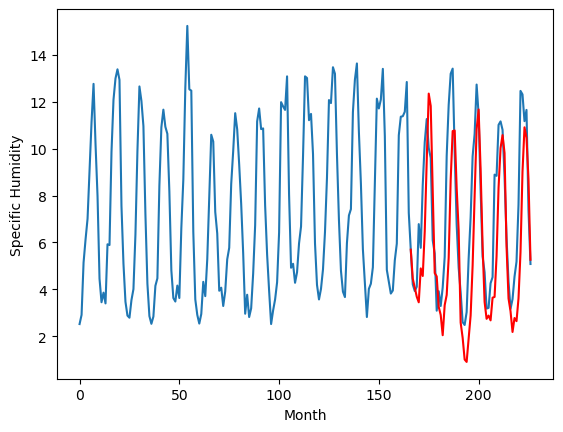

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		0.65		3.20
-2.52		0.27		2.79
-2.94		-0.13		2.81
-2.46		-0.36		2.10
-0.49		1.08		1.57
-1.14		0.76		1.90
2.06		2.66		0.60
5.70		5.68		-0.02
8.14		8.53		0.39
8.16		8.01		-0.15
4.85		4.38		-0.47
2.36		0.88		-1.48
-0.75		0.74		1.49
-3.47		-0.56		2.91
-3.58		-0.90		2.68
-3.46		-1.77		1.69
-1.90		-0.48		1.42
-1.28		-0.05		1.23
1.65		1.54		-0.11
6.00		4.85		-1.15
8.50		6.94		-1.56
8.79		6.96		-1.83
5.44		4.51		-0.93
3.31		2.71		-0.60
-2.62		-1.23		1.39
-0.75		-1.88		-1.13
-3.75		-2.80		0.95
-2.62		-2.90		-0.28
-1.87		-1.92		-0.05
-0.68		-0.93		-0.25
3.58		1.20		-2.38
6.30		4.16		-2.14
9.29		7.01		-2.28
8.20		7.86		-0.34
4.72		5.32		0.60
-0.34		2.05		2.39
-0.83		-0.35		0.48
-2.73		-1.07		1.66
-2.37		-0.93		1.44
-1.17		-1.13		0.04
-1.93		-0.17		1.76
-0.12		-0.13		-0.01
2.44		1.61		-0.83
5.02		4.53		-0.49
8.64		6.21		-2.43
8.53		6.77		-1.76
5.56		6.00		0.44
1.31		2.02		0.71
-2.04		-0.20		1.84
-2.

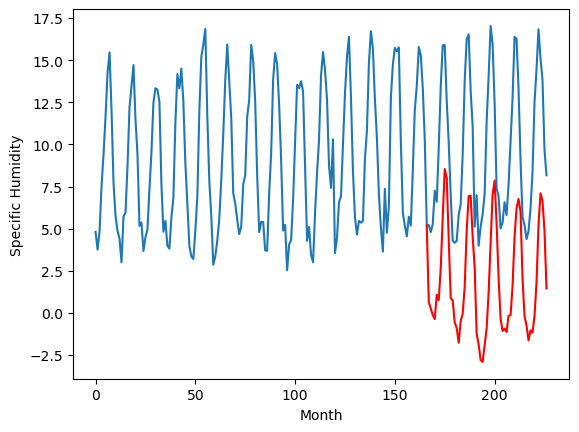

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		2.94		1.68
0.93		2.56		1.63
0.85		2.16		1.31
0.73		1.93		1.20
3.39		3.37		-0.02
3.65		3.05		-0.60
6.55		4.95		-1.60
10.38		7.97		-2.41
13.46		10.82		-2.64
11.29		10.30		-0.99
9.49		6.67		-2.82
4.67		3.17		-1.50
2.65		3.03		0.38
0.33		1.73		1.40
0.20		1.39		1.19
-0.32		0.52		0.84
2.41		1.81		-0.60
3.64		2.24		-1.40
6.85		3.83		-3.02
11.61		7.14		-4.47
12.24		9.23		-3.01
12.09		9.25		-2.84
8.84		6.80		-2.04
6.11		5.00		-1.11
1.55		1.06		-0.49
3.19		0.41		-2.78
-0.56		-0.51		0.05
0.12		-0.61		-0.73
1.65		0.37		-1.28
3.84		1.36		-2.48
8.29		3.49		-4.80
11.05		6.45		-4.60
12.02		9.30		-2.72
11.93		10.15		-1.78
7.97		7.61		-0.36
3.43		4.34		0.91
2.18		1.94		-0.24
1.27		1.22		-0.05
1.39		1.36		-0.03
1.49		1.16		-0.33
2.25		2.12		-0.13
3.45		2.16		-1.29
7.49		3.90		-3.59
10.41		6.82		-3.59
12.98		8.50		-4.48
12.56		9.06		-3.50
8.07		8.29		0.22
4.82		4.31		-0.51
2.11		2.09		-0.02
0.72		1.55		0.8

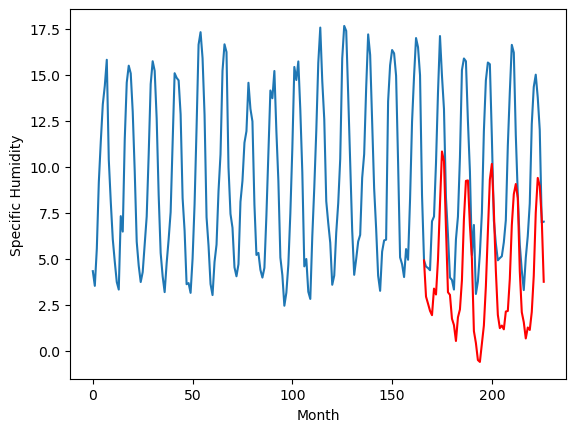

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		2.45		0.43
1.18		2.07		0.89
1.63		1.67		0.04
1.01		1.44		0.43
4.03		2.88		-1.15
4.22		2.56		-1.66
7.55		4.46		-3.09
9.69		7.48		-2.21
13.05		10.33		-2.72
10.15		9.81		-0.34
8.67		6.18		-2.49
4.00		2.68		-1.32
2.89		2.54		-0.35
0.61		1.24		0.63
0.77		0.90		0.13
-0.04		0.03		0.07
2.57		1.32		-1.25
3.73		1.75		-1.98
7.95		3.34		-4.61
11.09		6.65		-4.44
12.14		8.74		-3.40
11.72		8.76		-2.96
8.15		6.31		-1.84
5.71		4.51		-1.20
2.18		0.57		-1.61
1.57		-0.08		-1.65
-0.41		-1.00		-0.59
0.12		-1.10		-1.22
1.21		-0.12		-1.33
4.33		0.87		-3.46
8.57		3.00		-5.57
10.47		5.96		-4.51
9.83		8.81		-1.02
10.57		9.66		-0.91
7.83		7.12		-0.71
3.88		3.85		-0.03
2.90		1.45		-1.45
1.16		0.73		-0.43
0.68		0.87		0.19
1.01		0.67		-0.34
2.43		1.63		-0.80
3.65		1.67		-1.98
8.70		3.41		-5.29
11.28		6.33		-4.95
11.51		8.01		-3.50
9.68		8.57		-1.11
8.73		7.80		-0.93
5.30		3.82		-1.48
2.63		1.60		-1.03
1.58		1.06		-0.

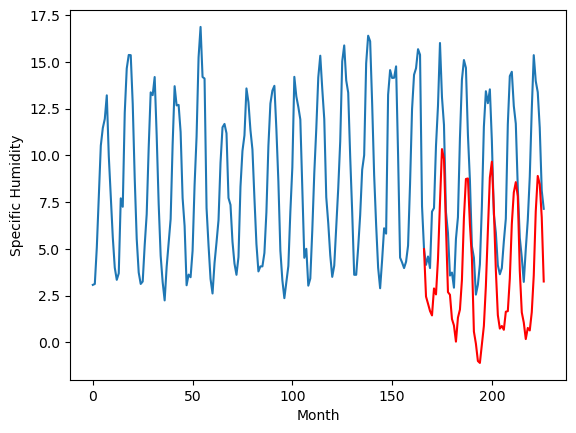

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.20		-0.15
0.70		0.82		0.12
0.55		0.42		-0.13
0.56		0.19		-0.37
2.45		1.63		-0.82
2.61		1.31		-1.30
5.43		3.21		-2.22
7.14		6.23		-0.91
10.03		9.08		-0.95
8.71		8.56		-0.15
5.92		4.93		-0.99
2.40		1.43		-0.97
2.08		1.29		-0.79
0.22		-0.01		-0.23
0.41		-0.35		-0.76
-0.33		-1.22		-0.89
1.49		0.07		-1.42
1.66		0.50		-1.16
6.81		2.09		-4.72
9.80		5.40		-4.40
11.04		7.49		-3.55
10.01		7.51		-2.50
7.05		5.06		-1.99
3.61		3.26		-0.35
1.25		-0.68		-1.93
0.27		-1.33		-1.60
-0.37		-2.25		-1.88
-0.45		-2.35		-1.90
0.51		-1.37		-1.88
1.48		-0.38		-1.86
4.04		1.75		-2.29
8.22		4.71		-3.51
8.87		7.56		-1.31
9.28		8.41		-0.87
7.28		5.87		-1.41
3.89		2.60		-1.29
1.91		0.20		-1.71
0.70		-0.52		-1.22
0.39		-0.38		-0.77
0.25		-0.58		-0.83
1.04		0.38		-0.66
1.56		0.42		-1.14
7.29		2.16		-5.13
8.90		5.08		-3.82
10.83		6.76		-4.07
8.92		7.32		-1.60
7.27		6.55		-0.72
4.16		2.57		-1.59
1.84		0.35		-1.49
1.40

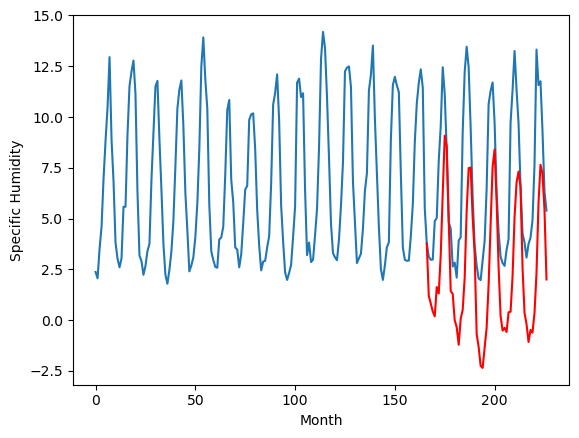

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		0.50		2.32
-1.83		0.12		1.95
-1.98		-0.28		1.70
-1.91		-0.51		1.40
-0.96		0.93		1.89
-0.67		0.61		1.28
1.90		2.51		0.61
5.54		5.53		-0.01
9.18		8.38		-0.80
9.09		7.86		-1.23
5.61		4.23		-1.38
2.69		0.73		-1.96
0.31		0.59		0.28
-1.85		-0.71		1.14
-2.58		-1.05		1.53
-2.54		-1.92		0.62
-1.30		-0.63		0.67
0.07		-0.20		-0.27
1.60		1.39		-0.21
6.92		4.70		-2.22
8.78		6.79		-1.99
9.12		6.81		-2.31
5.93		4.36		-1.57
4.07		2.56		-1.51
-1.12		-1.38		-0.26
-1.24		-2.03		-0.79
-2.85		-2.95		-0.10
-2.11		-3.05		-0.94
-1.09		-2.07		-0.98
-0.43		-1.08		-0.65
3.70		1.05		-2.65
5.29		4.01		-1.28
8.92		6.86		-2.06
8.49		7.71		-0.78
5.24		5.17		-0.07
1.80		1.90		0.10
0.30		-0.50		-0.80
-1.83		-1.22		0.61
-0.97		-1.08		-0.11
-1.77		-1.28		0.49
-1.74		-0.32		1.42
0.87		-0.28		-1.15
1.17		1.46		0.29
4.46		4.38		-0.08
9.17		6.06		-3.11
6.88		6.62		-0.26
5.62		5.85		0.23
2.57		1.87		-0.70
-1.09		-0.35		0.74


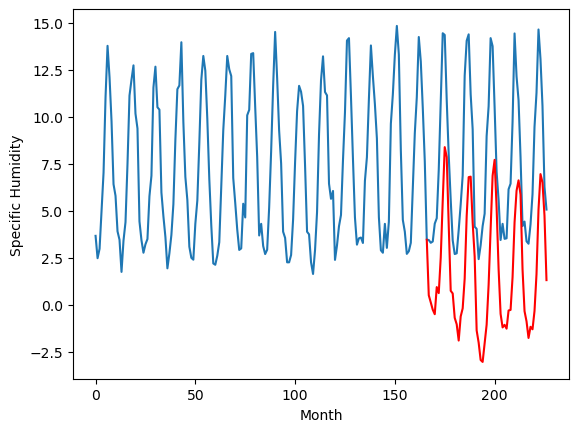

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88   0.495431
1                 1    1.11   4.555431
2                 2   -0.05   3.045431
3                 3    1.89   3.895431
4                 4    2.44   4.785431
5                 5    4.76   4.455431
6                 6   -2.55   0.645431
7                 7    1.26   2.935431
8                 8    2.02   2.445431
9                 9    1.35   1.195431
10               10   -1.82   0.495431


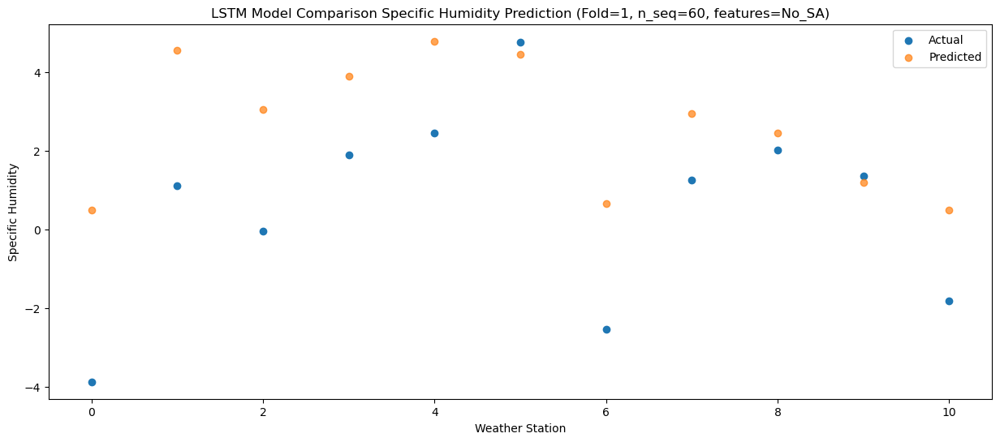

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28   0.115573
1                 1    1.16   4.175573
2                 2    0.86   2.665573
3                 3    0.69   3.515573
4                 4    1.20   4.405573
5                 5    3.28   4.075573
6                 6   -2.52   0.265573
7                 7    0.93   2.555573
8                 8    1.18   2.065573
9                 9    0.70   0.815573
10               10   -1.83   0.115573


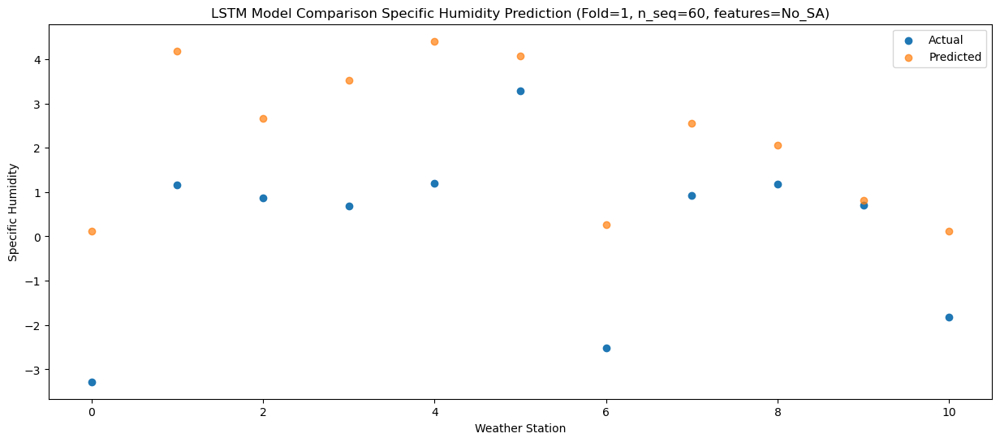

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -0.275148
1                 1    0.91   3.784852
2                 2    0.35   2.274852
3                 3    1.59   3.124852
4                 4    2.11   4.014852
5                 5    3.00   3.684852
6                 6   -2.94  -0.125148
7                 7    0.85   2.164852
8                 8    1.63   1.674852
9                 9    0.55   0.424852
10               10   -1.98  -0.275148


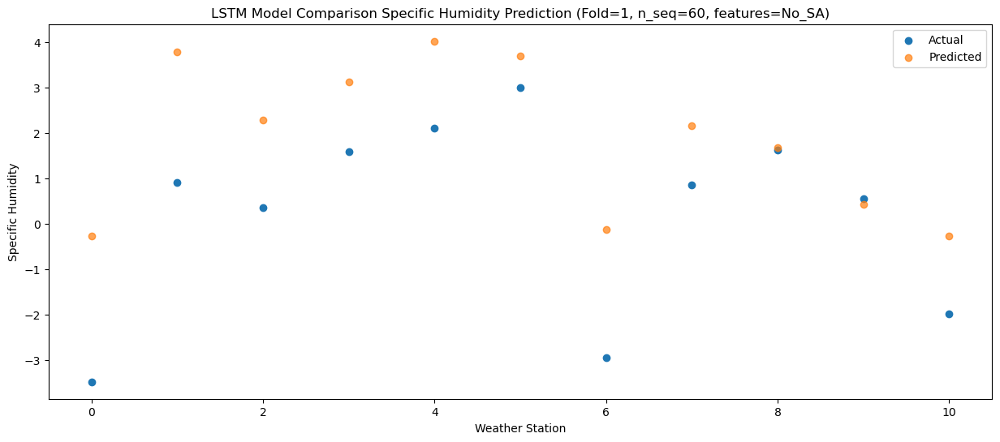

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -0.513155
1                 1    1.43   3.546845
2                 2    0.74   2.036845
3                 3    0.89   2.886845
4                 4    1.43   3.776845
5                 5    3.18   3.446845
6                 6   -2.46  -0.363155
7                 7    0.73   1.926845
8                 8    1.01   1.436845
9                 9    0.56   0.186845
10               10   -1.91  -0.513155


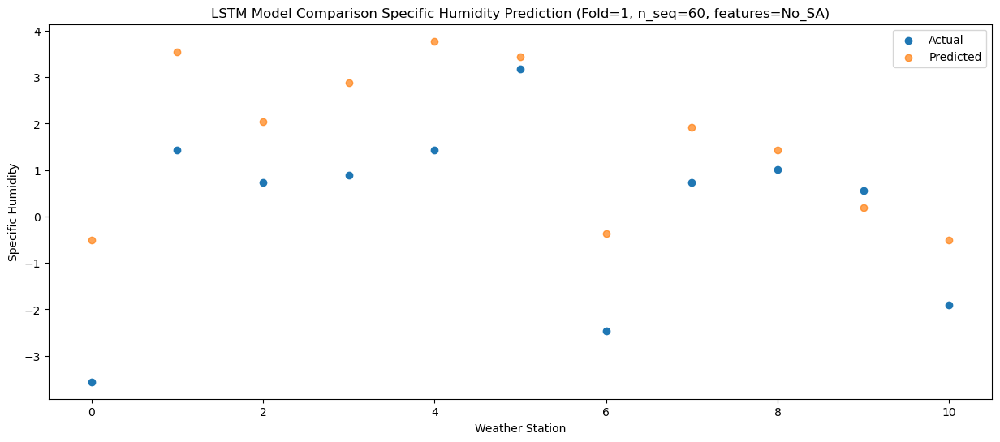

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26   0.932117
1                 1    3.66   4.992117
2                 2    3.90   3.482117
3                 3    5.25   4.332117
4                 4    6.16   5.222117
5                 5    5.85   4.892117
6                 6   -0.49   1.082117
7                 7    3.39   3.372117
8                 8    4.03   2.882117
9                 9    2.45   1.632117
10               10   -0.96   0.932117


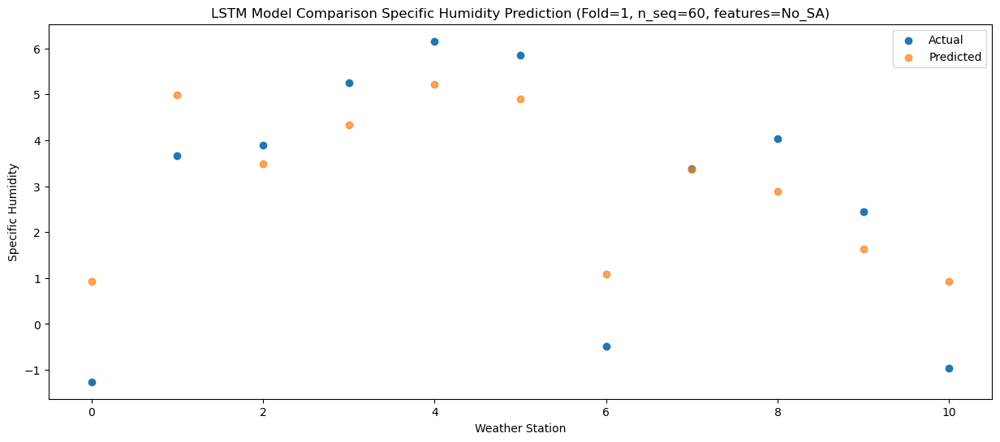

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52    0.60937
1                 1    2.07    4.66937
2                 2    2.28    3.15937
3                 3    4.91    4.00937
4                 4    5.85    4.89937
5                 5    4.84    4.56937
6                 6   -1.14    0.75937
7                 7    3.65    3.04937
8                 8    4.22    2.55937
9                 9    2.61    1.30937
10               10   -0.67    0.60937


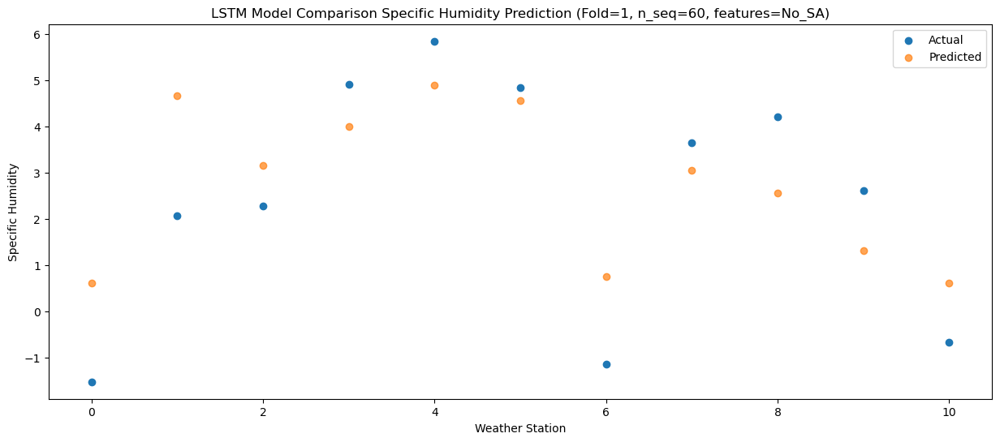

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   2.508165
1                 1    5.08   6.568165
2                 2    5.05   5.058165
3                 3    6.89   5.908165
4                 4    7.97   6.798165
5                 5    7.52   6.468165
6                 6    2.06   2.658165
7                 7    6.55   4.948165
8                 8    7.55   4.458165
9                 9    5.43   3.208165
10               10    1.90   2.508165


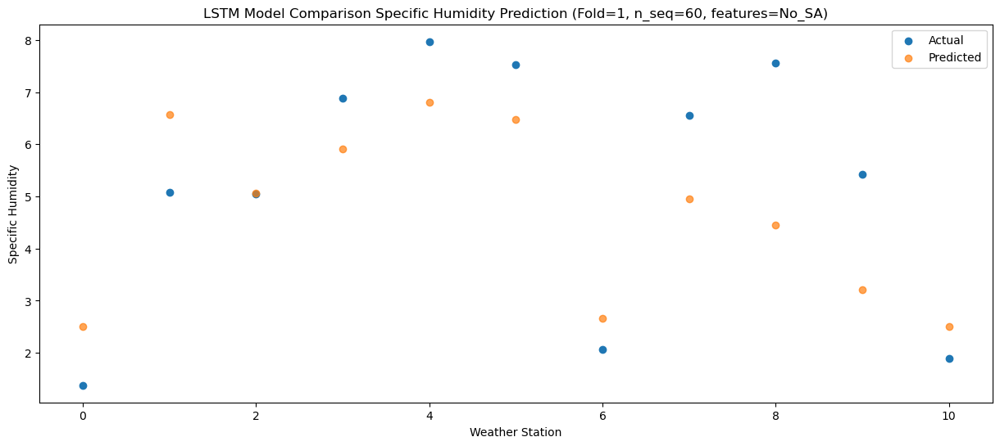

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.530663
1                 1    8.88   9.590663
2                 2    8.90   8.080663
3                 3    9.01   8.930663
4                 4   10.26   9.820663
5                 5    9.34   9.490663
6                 6    5.70   5.680663
7                 7   10.38   7.970663
8                 8    9.69   7.480663
9                 9    7.14   6.230663
10               10    5.54   5.530663


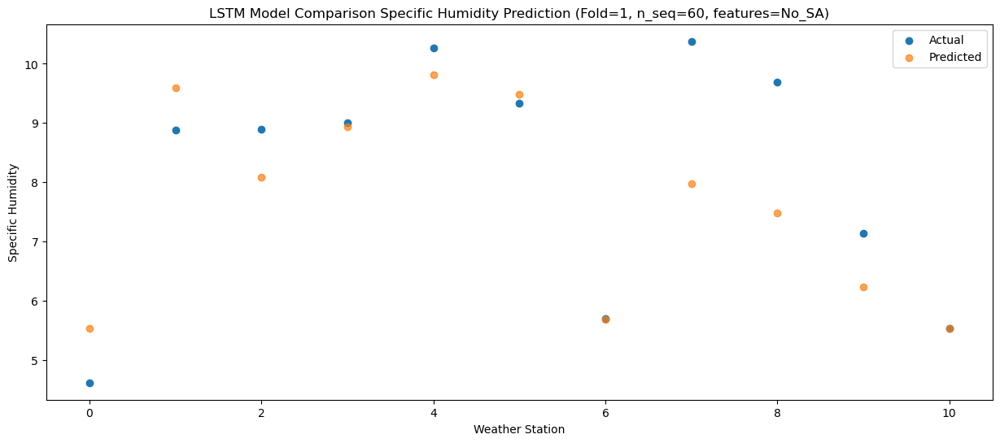

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   8.384186
1                 1   10.92  12.444186
2                 2   11.45  10.934186
3                 3   11.52  11.784186
4                 4   12.86  12.674186
5                 5   10.33  12.344186
6                 6    8.14   8.534186
7                 7   13.46  10.824186
8                 8   13.05  10.334186
9                 9   10.03   9.084186
10               10    9.18   8.384186


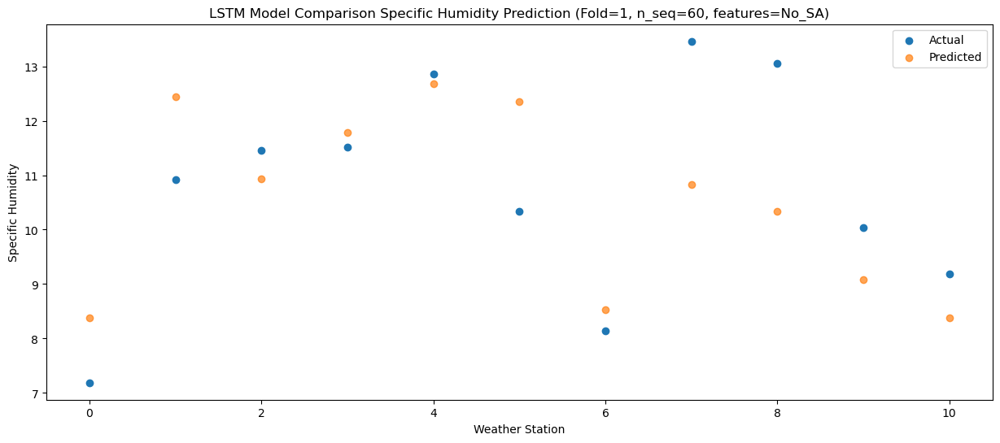

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   7.855814
1                 1   10.97  11.915814
2                 2   10.97  10.405814
3                 3   10.41  11.255814
4                 4   11.41  12.145814
5                 5    9.10  11.815814
6                 6    8.16   8.005814
7                 7   11.29  10.295814
8                 8   10.15   9.805814
9                 9    8.71   8.555814
10               10    9.09   7.855814


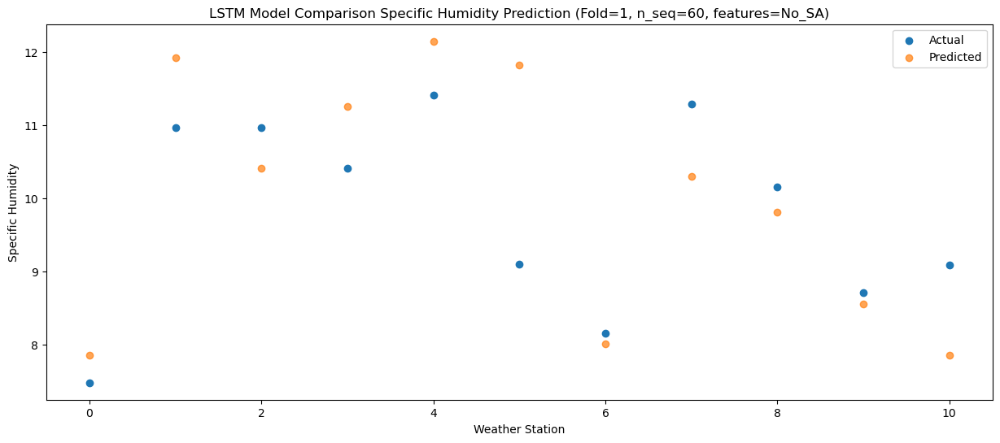

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   4.233414
1                 1    8.07   8.293414
2                 2    8.02   6.783414
3                 3    8.83   7.633414
4                 4    9.92   8.523414
5                 5    8.67   8.193414
6                 6    4.85   4.383414
7                 7    9.49   6.673414
8                 8    8.67   6.183414
9                 9    5.92   4.933414
10               10    5.61   4.233414


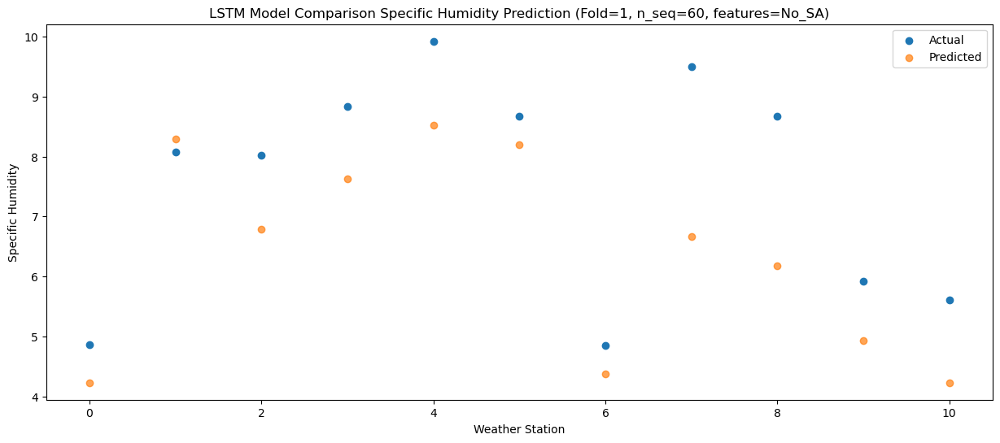

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   0.733135
1                 1    5.40   4.793135
2                 2    5.26   3.283135
3                 3    5.43   4.133135
4                 4    6.07   5.023135
5                 5    5.16   4.693135
6                 6    2.36   0.883135
7                 7    4.67   3.173135
8                 8    4.00   2.683135
9                 9    2.40   1.433135
10               10    2.69   0.733135


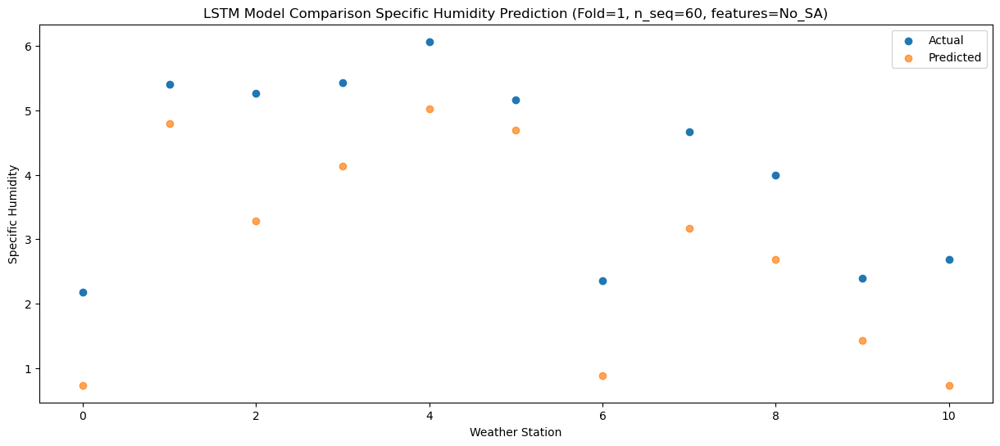

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45   0.591101
1                 1    2.34   4.651101
2                 2    2.08   3.141101
3                 3    3.33   3.991101
4                 4    3.59   4.881101
5                 5    4.60   4.551101
6                 6   -0.75   0.741101
7                 7    2.65   3.031101
8                 8    2.89   2.541101
9                 9    2.08   1.291101
10               10    0.31   0.591101


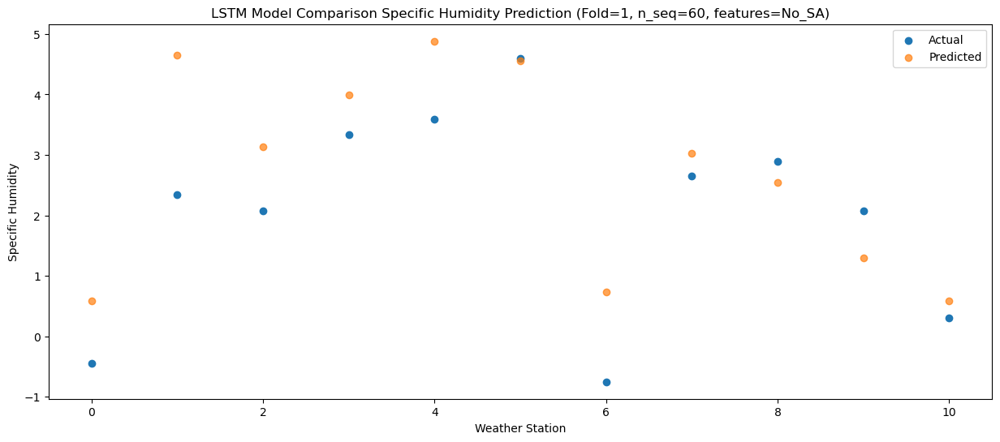

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -0.705088
1                 1   -0.25   3.354912
2                 2   -0.69   1.844912
3                 3    0.78   2.694912
4                 4    0.77   3.584912
5                 5    2.16   3.254912
6                 6   -3.47  -0.555088
7                 7    0.33   1.734912
8                 8    0.61   1.244912
9                 9    0.22  -0.005088
10               10   -1.85  -0.705088


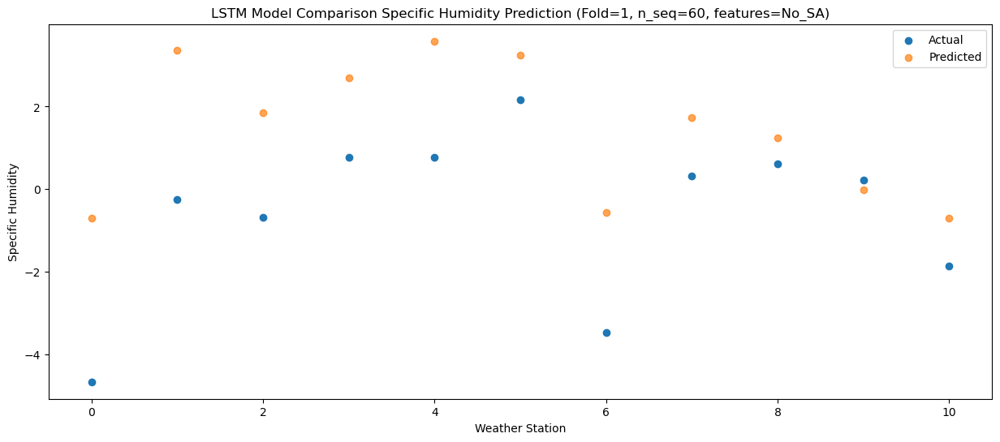

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -1.050762
1                 1   -0.23   3.009238
2                 2   -0.54   1.499238
3                 3    0.44   2.349238
4                 4    0.52   3.239238
5                 5    2.99   2.909238
6                 6   -3.58  -0.900762
7                 7    0.20   1.389238
8                 8    0.77   0.899238
9                 9    0.41  -0.350762
10               10   -2.58  -1.050762


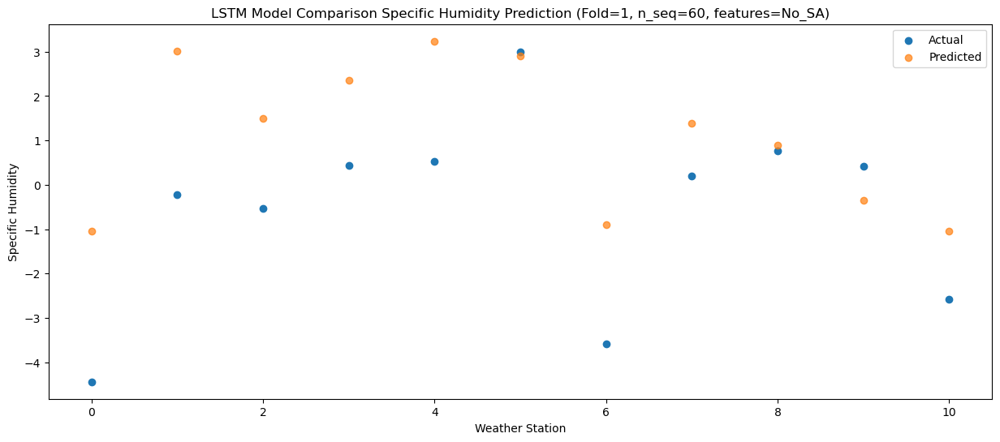

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -1.915775
1                 1   -0.04   2.144225
2                 2   -0.54   0.634225
3                 3    0.51   1.484225
4                 4    0.56   2.374225
5                 5    2.36   2.044225
6                 6   -3.46  -1.765775
7                 7   -0.32   0.524225
8                 8   -0.04   0.034225
9                 9   -0.33  -1.215775
10               10   -2.54  -1.915775


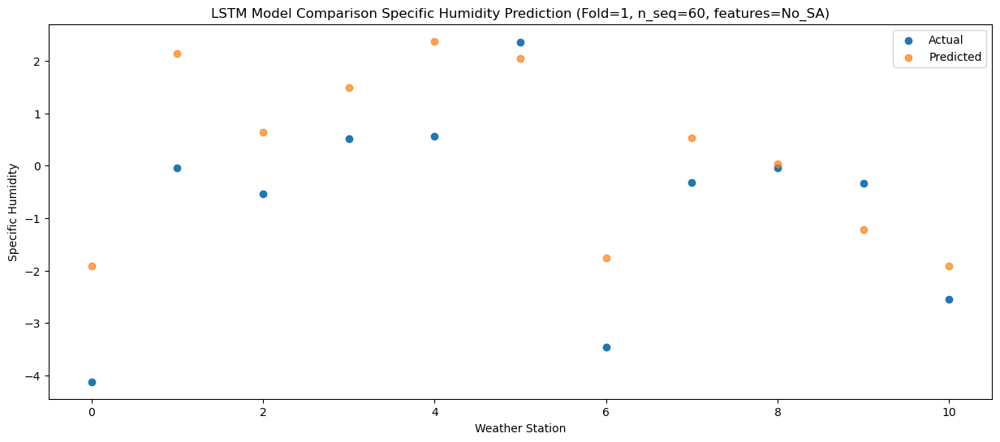

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -0.632018
1                 1    1.49   3.427982
2                 2    2.08   1.917982
3                 3    3.15   2.767982
4                 4    3.28   3.657982
5                 5    3.15   3.327982
6                 6   -1.90  -0.482018
7                 7    2.41   1.807982
8                 8    2.57   1.317982
9                 9    1.49   0.067982
10               10   -1.30  -0.632018


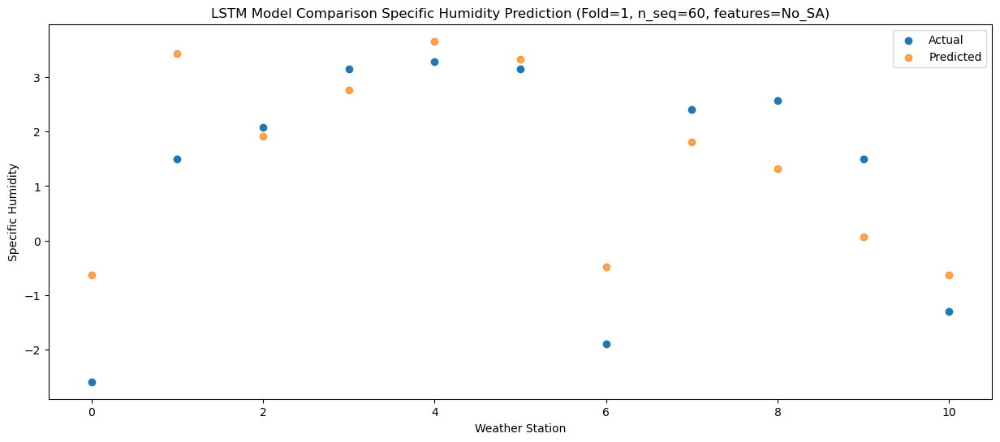

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39  -0.200703
1                 1    1.85   3.859297
2                 2    1.79   2.349297
3                 3    4.49   3.199297
4                 4    4.54   4.089297
5                 5    4.45   3.759297
6                 6   -1.28  -0.050703
7                 7    3.64   2.239297
8                 8    3.73   1.749297
9                 9    1.66   0.499297
10               10    0.07  -0.200703


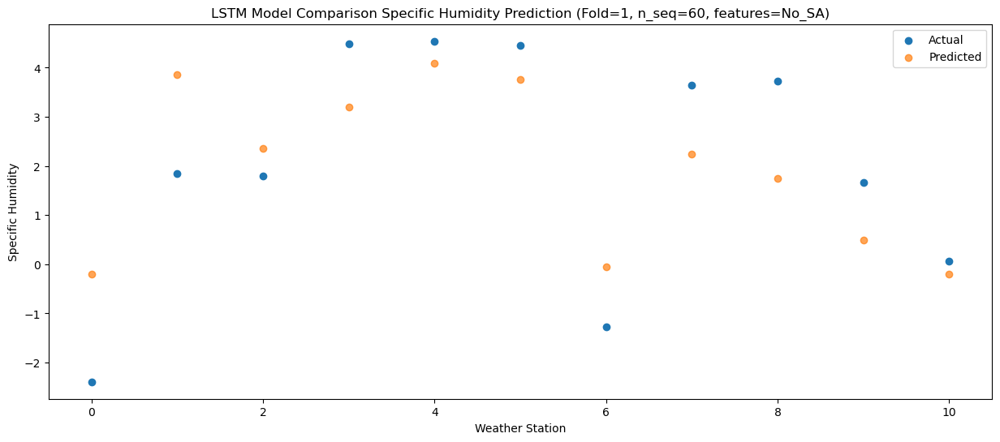

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   1.385415
1                 1    4.77   5.445415
2                 2    4.63   3.935415
3                 3    8.38   4.785415
4                 4    8.57   5.675415
5                 5    8.76   5.345415
6                 6    1.65   1.535415
7                 7    6.85   3.825415
8                 8    7.95   3.335415
9                 9    6.81   2.085415
10               10    1.60   1.385415


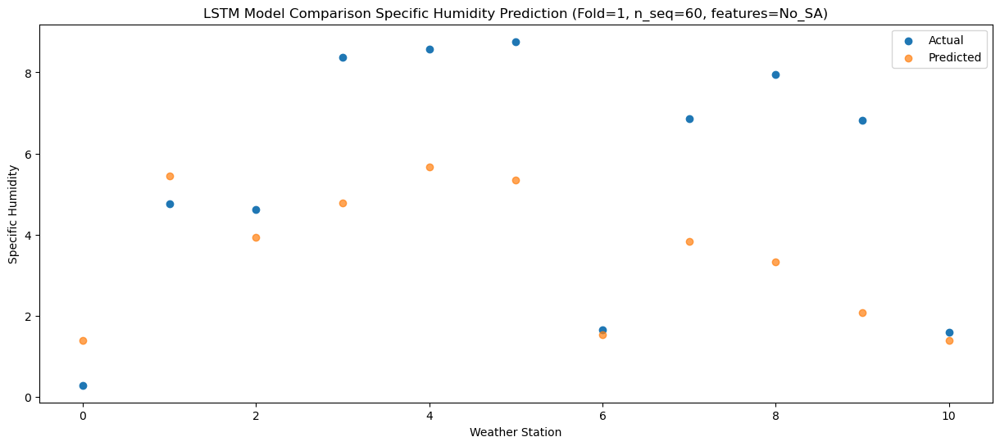

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   4.704713
1                 1    8.75   8.764713
2                 2    9.15   7.254713
3                 3   11.57   8.104713
4                 4   11.98   8.994713
5                 5   10.93   8.664713
6                 6    6.00   4.854713
7                 7   11.61   7.144713
8                 8   11.09   6.654713
9                 9    9.80   5.404713
10               10    6.92   4.704713


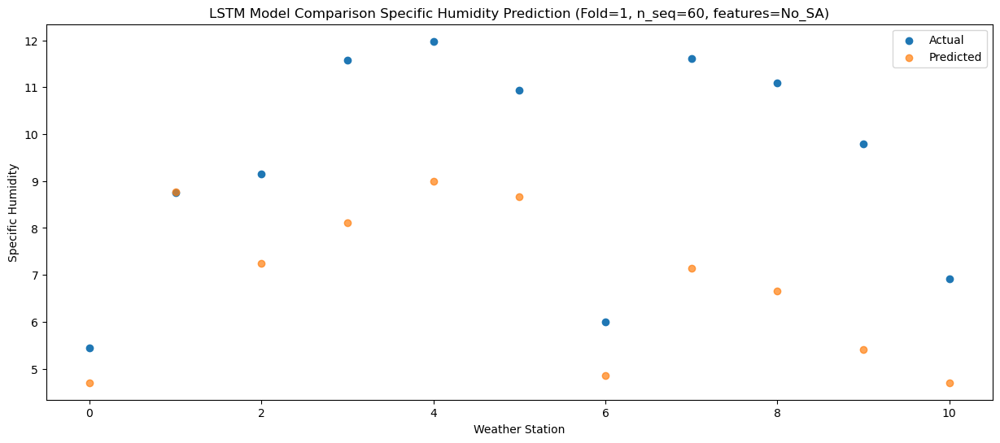

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   6.786144
1                 1   10.62  10.846144
2                 2   10.74   9.336144
3                 3   12.05  10.186144
4                 4   12.16  11.076144
5                 5   12.26  10.746144
6                 6    8.50   6.936144
7                 7   12.24   9.226144
8                 8   12.14   8.736144
9                 9   11.04   7.486144
10               10    8.78   6.786144


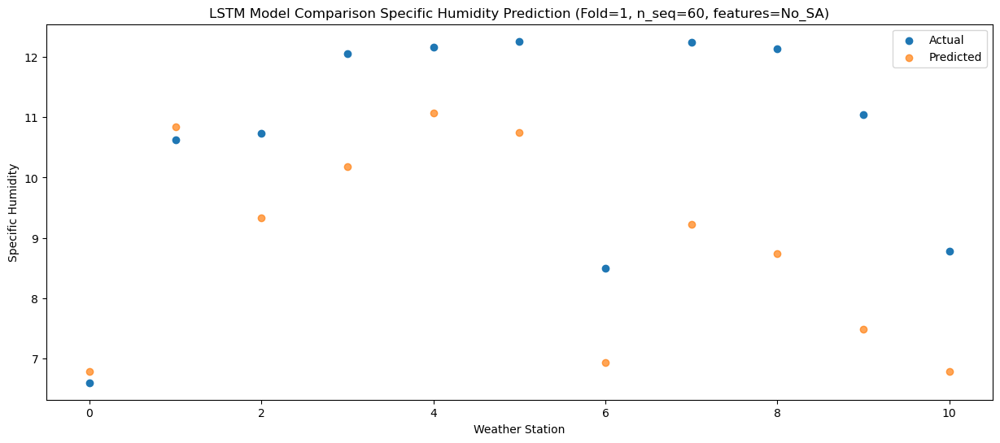

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   6.813439
1                 1   10.83  10.873439
2                 2   10.96   9.363439
3                 3   12.39  10.213439
4                 4   12.20  11.103439
5                 5   12.48  10.773439
6                 6    8.79   6.963439
7                 7   12.09   9.253439
8                 8   11.72   8.763439
9                 9   10.01   7.513439
10               10    9.12   6.813439


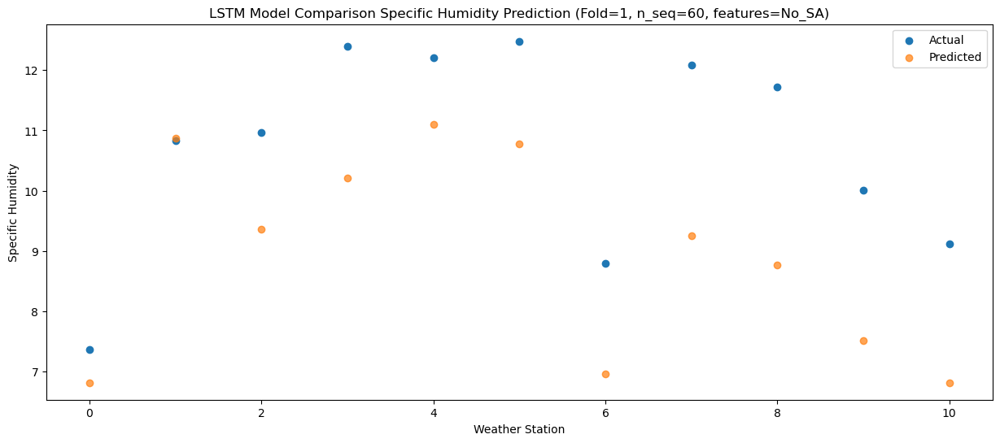

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   4.364269
1                 1    7.88   8.424269
2                 2    8.20   6.914269
3                 3    9.30   7.764269
4                 4    9.10   8.654269
5                 5    8.94   8.324269
6                 6    5.44   4.514269
7                 7    8.84   6.804269
8                 8    8.15   6.314269
9                 9    7.05   5.064269
10               10    5.93   4.364269


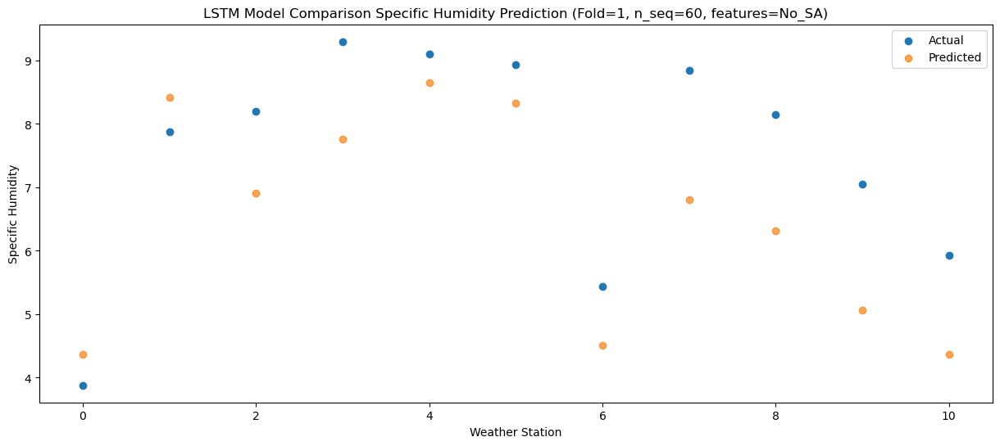

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   2.563385
1                 1    5.84   6.623385
2                 2    5.45   5.113385
3                 3    7.05   5.963385
4                 4    7.15   6.853385
5                 5    5.83   6.523385
6                 6    3.31   2.713385
7                 7    6.11   5.003385
8                 8    5.71   4.513385
9                 9    3.61   3.263385
10               10    4.07   2.563385


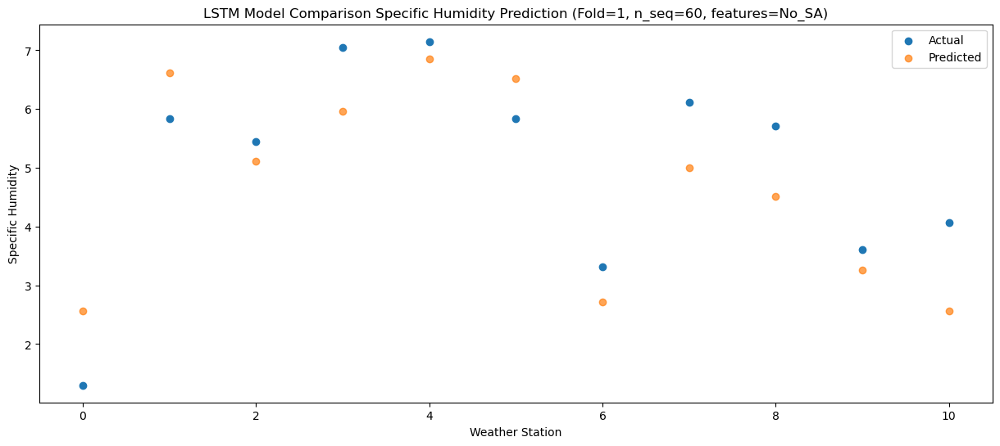

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -1.378479
1                 1    0.25   2.681521
2                 2   -0.05   1.171521
3                 3    2.60   2.021521
4                 4    2.56   2.911521
5                 5    3.99   2.581521
6                 6   -2.62  -1.228479
7                 7    1.55   1.061521
8                 8    2.18   0.571521
9                 9    1.25  -0.678479
10               10   -1.12  -1.378479


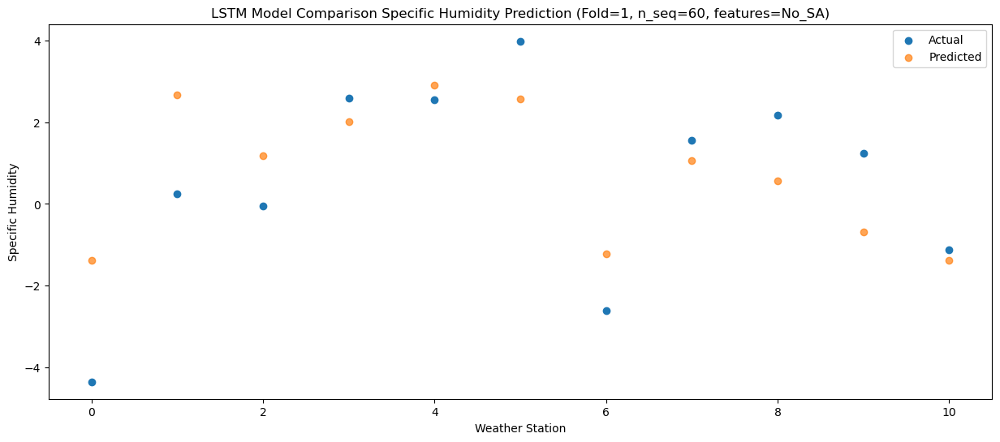

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25  -2.025105
1                 1    2.42   2.034895
2                 2    2.59   0.524895
3                 3    5.52   1.374895
4                 4    5.49   2.264895
5                 5    2.94   1.934895
6                 6   -0.75  -1.875105
7                 7    3.19   0.414895
8                 8    1.57  -0.075105
9                 9    0.27  -1.325105
10               10   -1.24  -2.025105


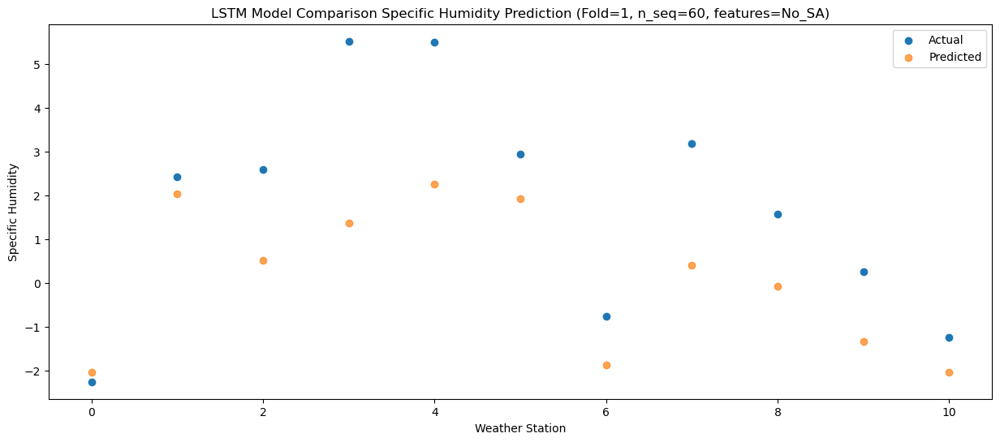

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -2.951439
1                 1   -0.58   1.108561
2                 2   -1.29  -0.401439
3                 3   -0.13   0.448561
4                 4   -0.05   1.338561
5                 5    1.67   1.008561
6                 6   -3.75  -2.801439
7                 7   -0.56  -0.511439
8                 8   -0.41  -1.001439
9                 9   -0.37  -2.251439
10               10   -2.85  -2.951439


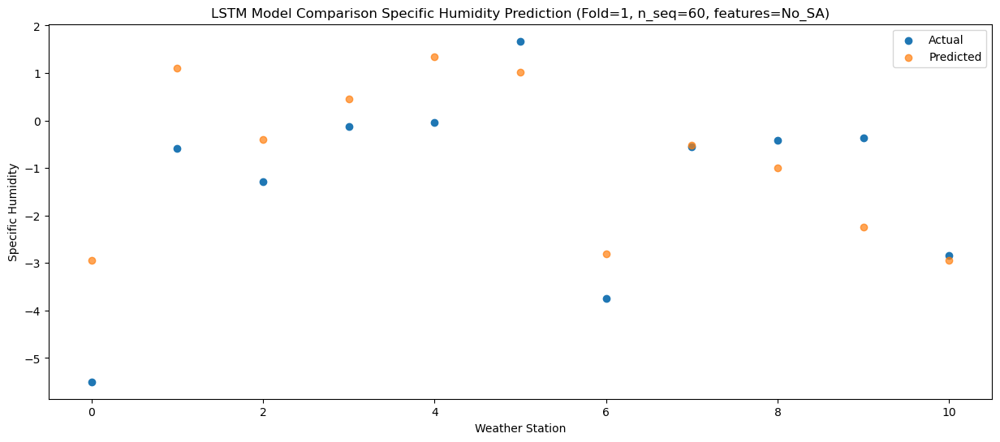

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -3.054465
1                 1    0.37   1.005535
2                 2   -0.26  -0.504465
3                 3    0.04   0.345535
4                 4    0.15   1.235535
5                 5    1.55   0.905535
6                 6   -2.62  -2.904465
7                 7    0.12  -0.614465
8                 8    0.12  -1.104465
9                 9   -0.45  -2.354465
10               10   -2.11  -3.054465


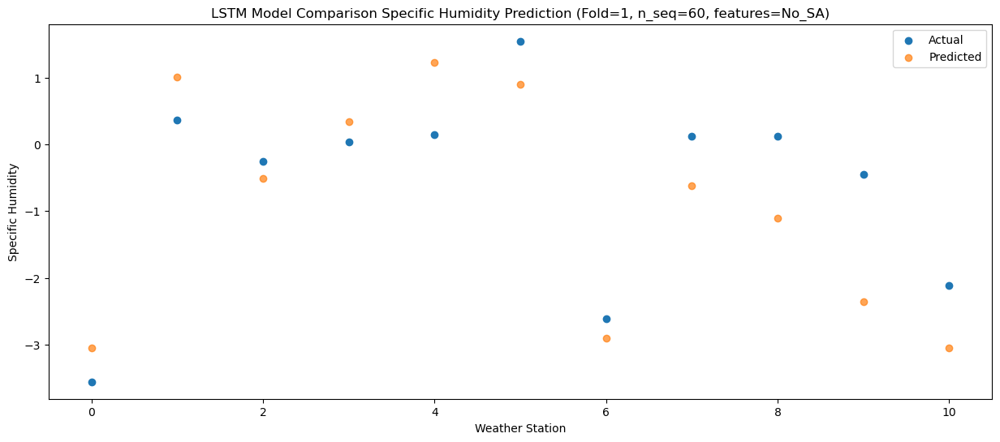

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -2.065342
1                 1    1.05   1.994658
2                 2    0.53   0.484658
3                 3    1.72   1.334658
4                 4    1.85   2.224658
5                 5    2.10   1.894658
6                 6   -1.87  -1.915342
7                 7    1.65   0.374658
8                 8    1.21  -0.115342
9                 9    0.51  -1.365342
10               10   -1.09  -2.065342


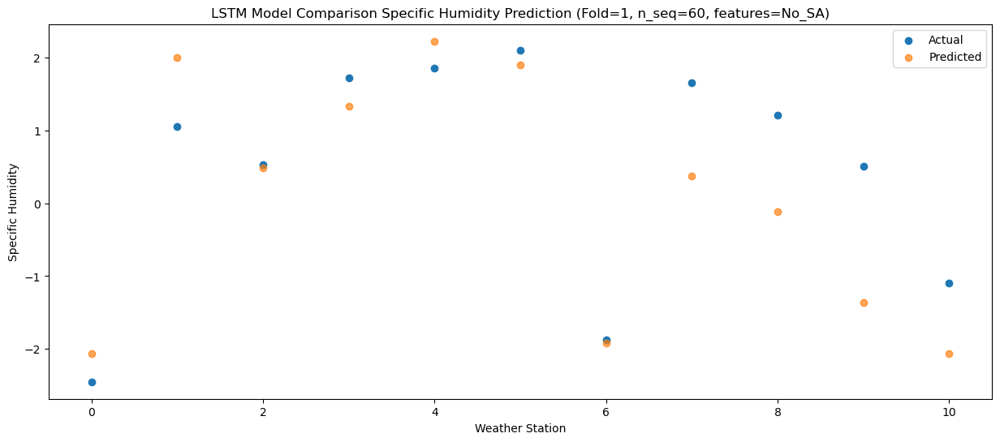

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -1.076276
1                 1    2.11   2.983724
2                 2    2.29   1.473724
3                 3    5.88   2.323724
4                 4    5.95   3.213724
5                 5    4.37   2.883724
6                 6   -0.68  -0.926276
7                 7    3.84   1.363724
8                 8    4.33   0.873724
9                 9    1.48  -0.376276
10               10   -0.43  -1.076276


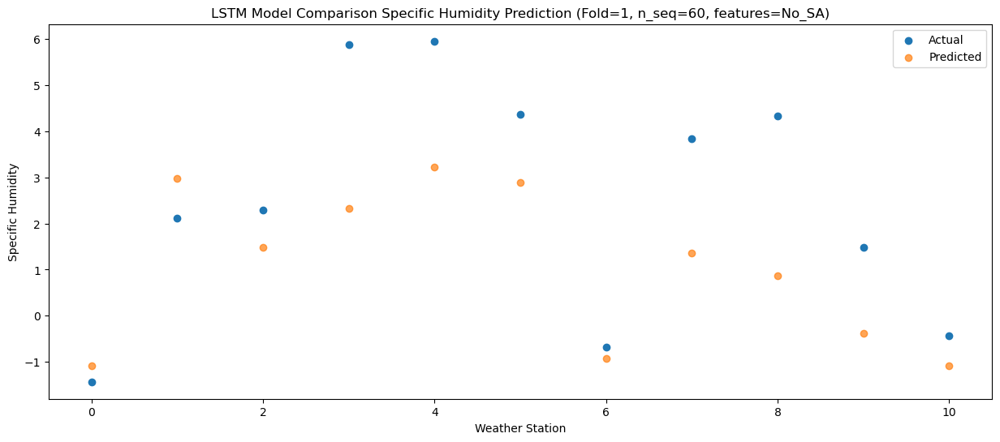

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.054728
1                 1    6.28   5.114728
2                 2    6.65   3.604728
3                 3    9.69   4.454728
4                 4    9.83   5.344728
5                 5    6.14   5.014728
6                 6    3.58   1.204728
7                 7    8.29   3.494728
8                 8    8.57   3.004728
9                 9    4.04   1.754728
10               10    3.70   1.054728


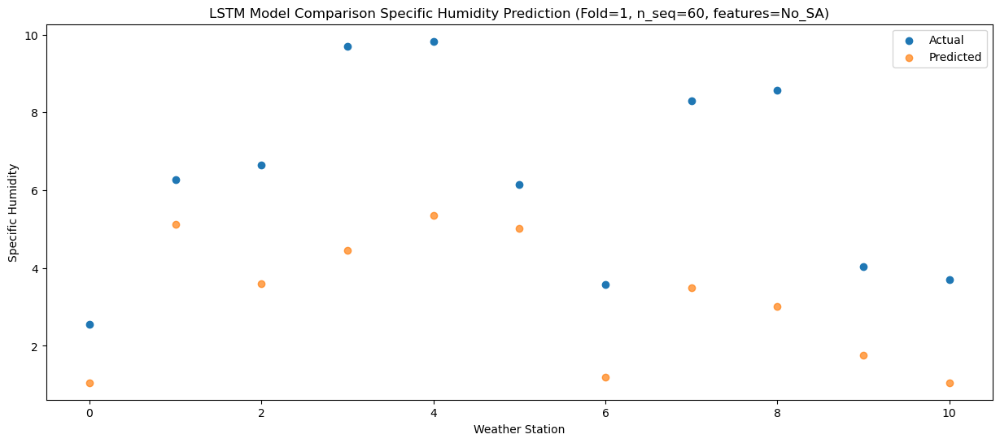

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   4.014705
1                 1    8.68   8.074705
2                 2    9.74   6.564705
3                 3   10.74   7.414705
4                 4   10.95   8.304705
5                 5    8.74   7.974705
6                 6    6.30   4.164705
7                 7   11.05   6.454705
8                 8   10.47   5.964705
9                 9    8.22   4.714705
10               10    5.29   4.014705


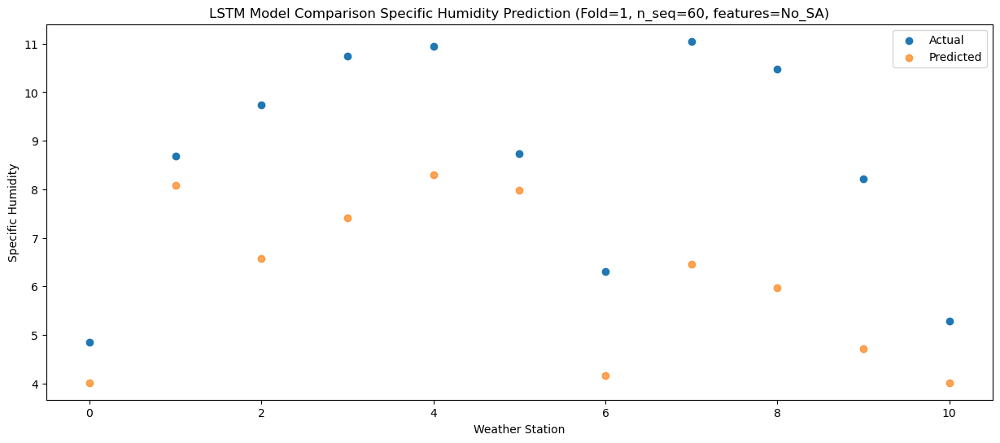

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   6.861511
1                 1   11.35  10.921511
2                 2   11.37   9.411511
3                 3   11.66  10.261511
4                 4   11.70  11.151511
5                 5    9.69  10.821511
6                 6    9.29   7.011511
7                 7   12.02   9.301511
8                 8    9.83   8.811511
9                 9    8.87   7.561511
10               10    8.92   6.861511


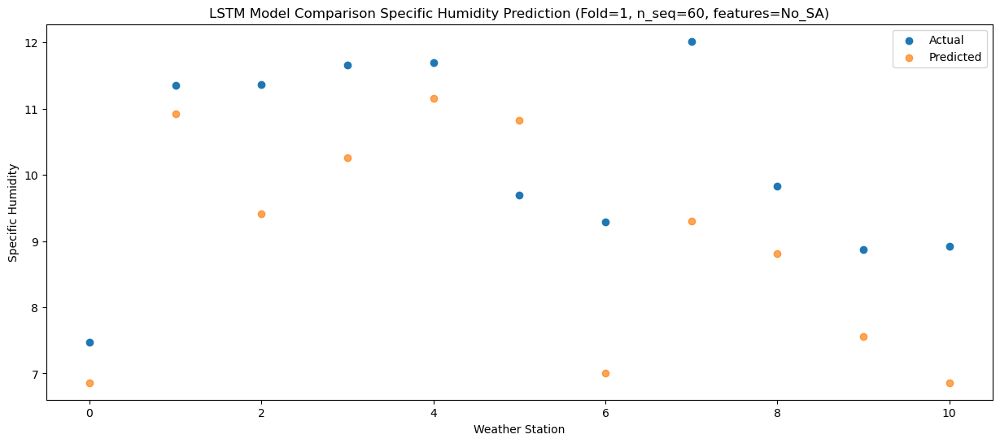

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   7.707432
1                 1   10.94  11.767432
2                 2   10.50  10.257432
3                 3   11.91  11.107432
4                 4   12.08  11.997432
5                 5   11.80  11.667432
6                 6    8.20   7.857432
7                 7   11.93  10.147432
8                 8   10.57   9.657432
9                 9    9.28   8.407432
10               10    8.49   7.707432


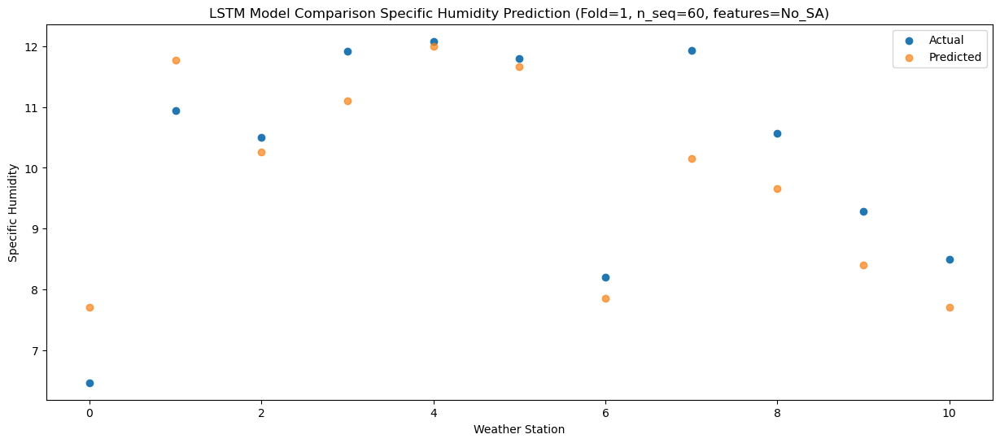

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   5.172012
1                 1    7.58   9.232012
2                 2    6.99   7.722012
3                 3    8.62   8.572012
4                 4    8.73   9.462012
5                 5   10.53   9.132012
6                 6    4.72   5.322012
7                 7    7.97   7.612012
8                 8    7.83   7.122012
9                 9    7.28   5.872012
10               10    5.24   5.172012


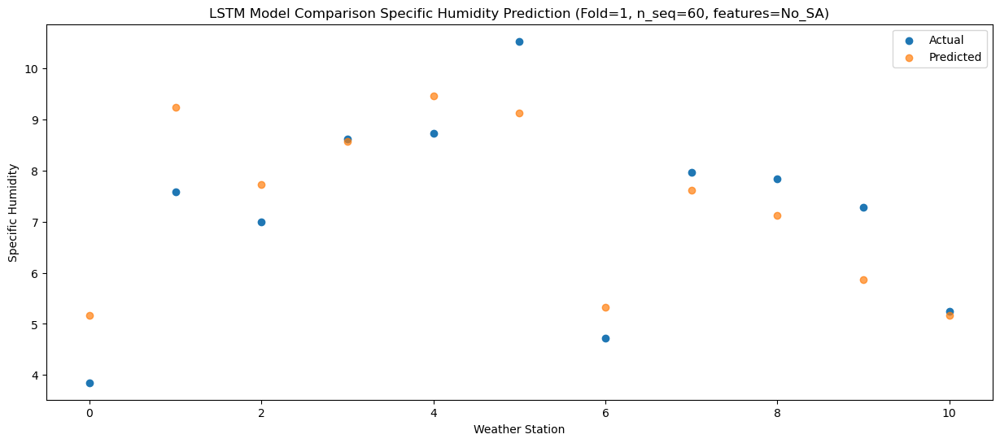

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01   1.899143
1                 1    2.69   5.959143
2                 2    1.88   4.449143
3                 3    3.66   5.299143
4                 4    3.83   6.189143
5                 5    7.34   5.859143
6                 6   -0.34   2.049143
7                 7    3.43   4.339143
8                 8    3.88   3.849143
9                 9    3.89   2.599143
10               10    1.80   1.899143


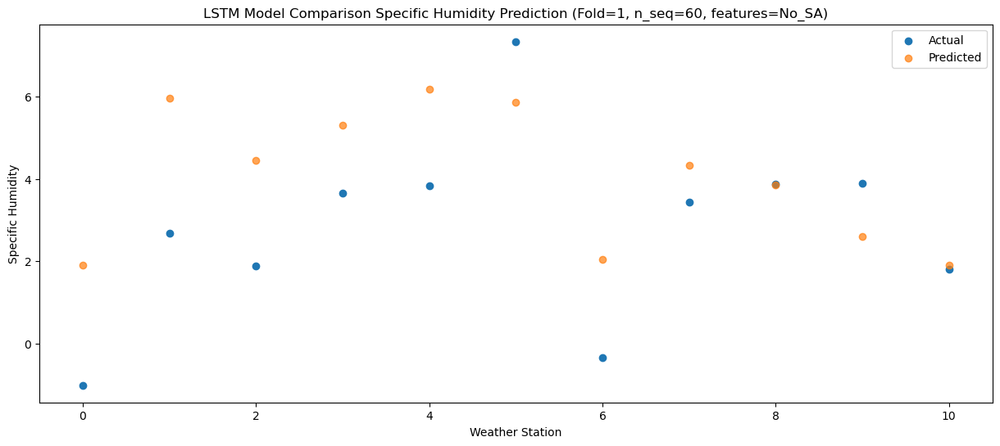

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54  -0.496282
1                 1    2.21   3.563718
2                 2    1.51   2.053718
3                 3    3.16   2.903718
4                 4    3.45   3.793718
5                 5    4.47   3.463718
6                 6   -0.83  -0.346282
7                 7    2.18   1.943718
8                 8    2.90   1.453718
9                 9    1.91   0.203718
10               10    0.30  -0.496282


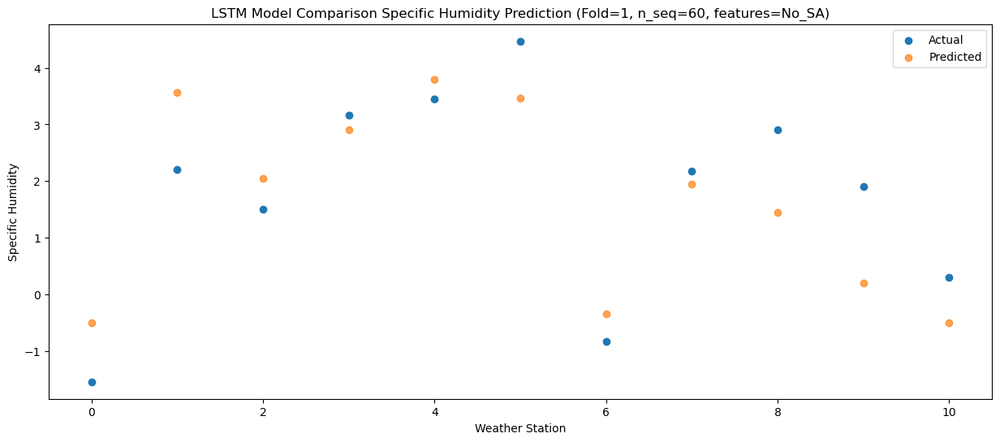

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -1.216823
1                 1    0.62   2.843177
2                 2    0.82   1.333177
3                 3    2.35   2.183177
4                 4    2.63   3.073177
5                 5    3.80   2.743177
6                 6   -2.73  -1.066823
7                 7    1.27   1.223177
8                 8    1.16   0.733177
9                 9    0.70  -0.516823
10               10   -1.83  -1.216823


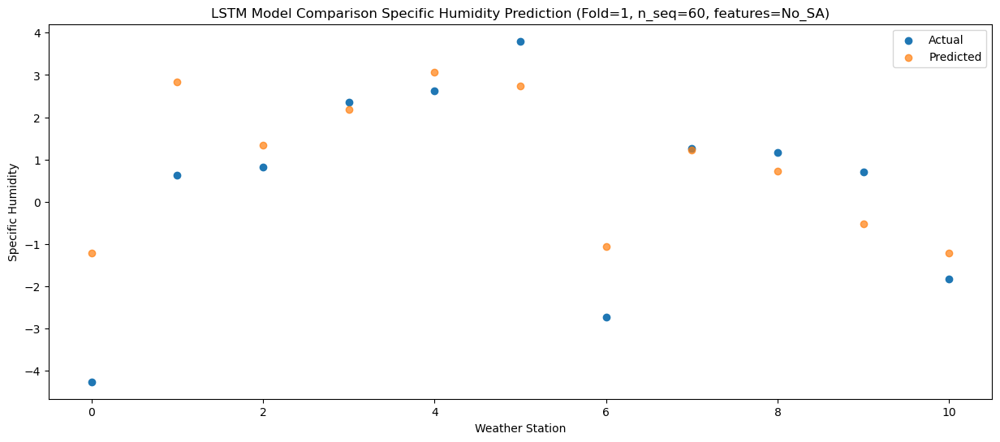

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80  -1.078739
1                 1    1.03   2.981261
2                 2    0.79   1.471261
3                 3    1.93   2.321261
4                 4    2.15   3.211261
5                 5    2.25   2.881261
6                 6   -2.37  -0.928739
7                 7    1.39   1.361261
8                 8    0.68   0.871261
9                 9    0.39  -0.378739
10               10   -0.97  -1.078739


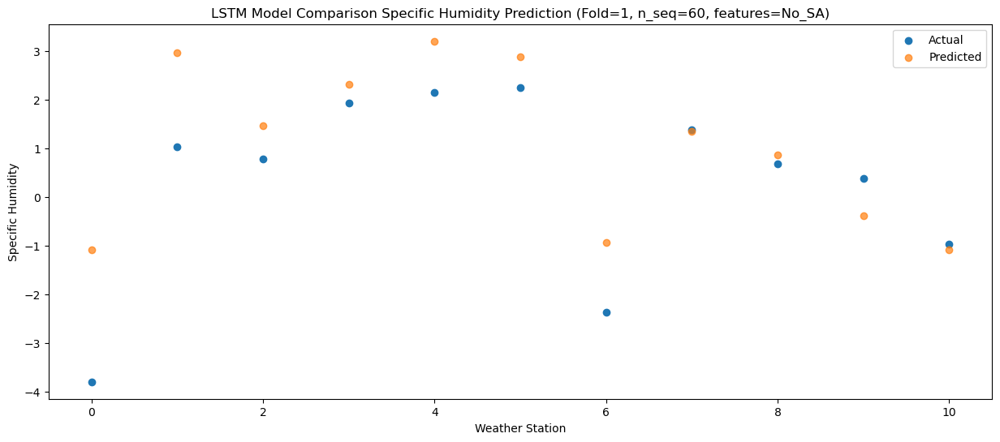

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19  -1.282885
1                 1    2.15   2.777115
2                 2    1.84   1.267115
3                 3    2.71   2.117115
4                 4    2.75   3.007115
5                 5    2.28   2.677115
6                 6   -1.17  -1.132885
7                 7    1.49   1.157115
8                 8    1.01   0.667115
9                 9    0.25  -0.582885
10               10   -1.77  -1.282885


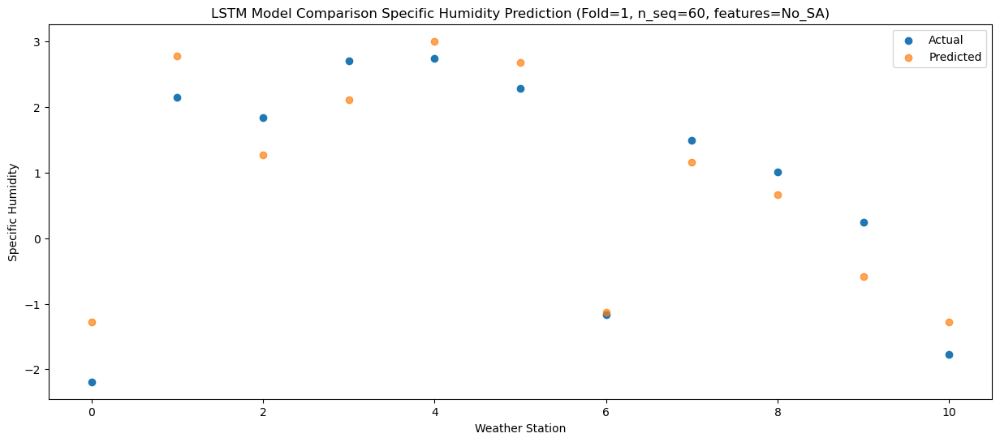

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57  -0.315706
1                 1    1.28   3.744294
2                 2    1.37   2.234294
3                 3    4.26   3.084294
4                 4    4.45   3.974294
5                 5    3.33   3.644294
6                 6   -1.93  -0.165706
7                 7    2.25   2.124294
8                 8    2.43   1.634294
9                 9    1.04   0.384294
10               10   -1.74  -0.315706


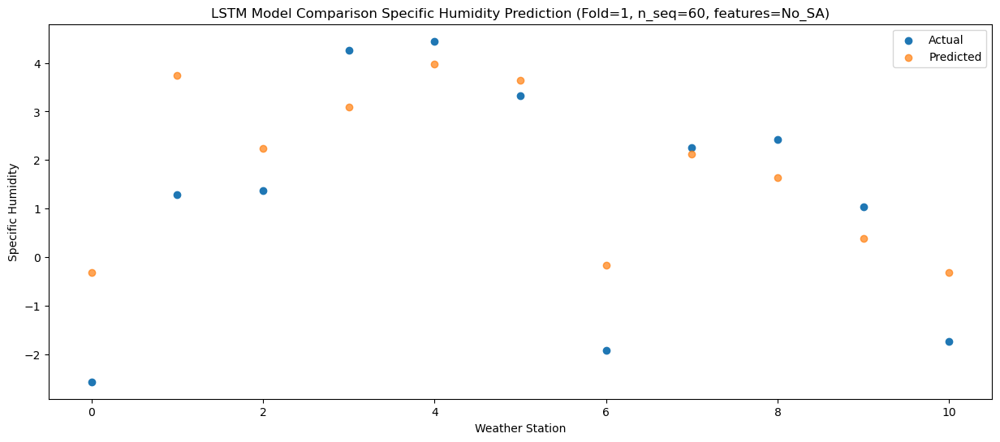

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87  -0.283865
1                 1    2.88   3.776135
2                 2    2.73   2.266135
3                 3    4.63   3.116135
4                 4    4.90   4.006135
5                 5    3.59   3.676135
6                 6   -0.12  -0.133865
7                 7    3.45   2.156135
8                 8    3.65   1.666135
9                 9    1.56   0.416135
10               10    0.87  -0.283865


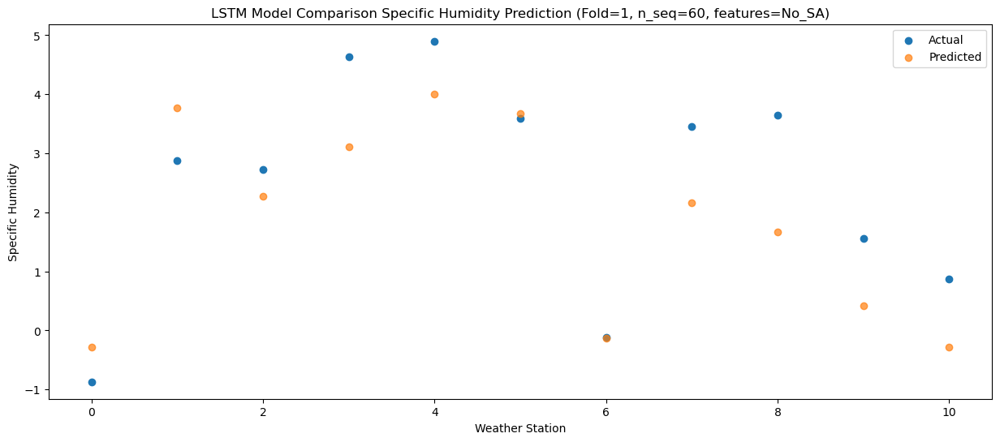

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33    1.45864
1                 1    5.62    5.51864
2                 2    6.03    4.00864
3                 3    8.41    4.85864
4                 4    8.57    5.74864
5                 5    7.96    5.41864
6                 6    2.44    1.60864
7                 7    7.49    3.89864
8                 8    8.70    3.40864
9                 9    7.29    2.15864
10               10    1.17    1.45864


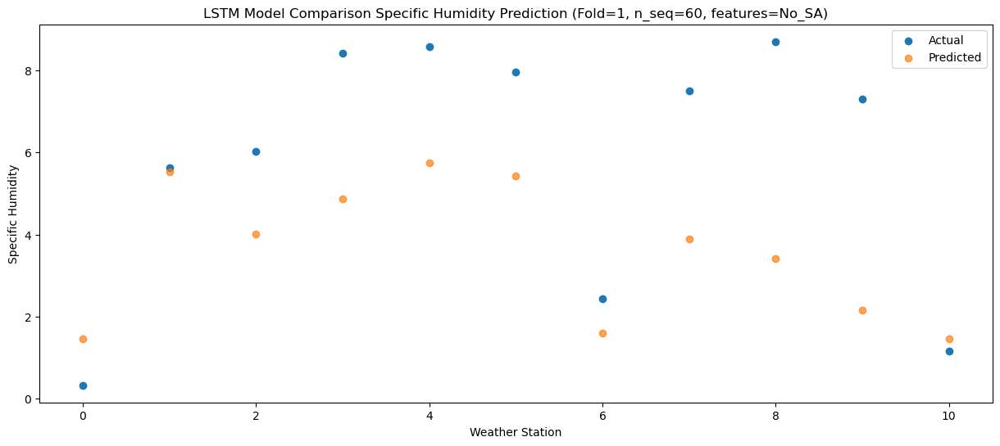

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   4.376487
1                 1    7.97   8.436487
2                 2    8.68   6.926487
3                 3   11.81   7.776487
4                 4   11.83   8.666487
5                 5    7.91   8.336487
6                 6    5.02   4.526487
7                 7   10.41   6.816487
8                 8   11.28   6.326487
9                 9    8.90   5.076487
10               10    4.46   4.376487


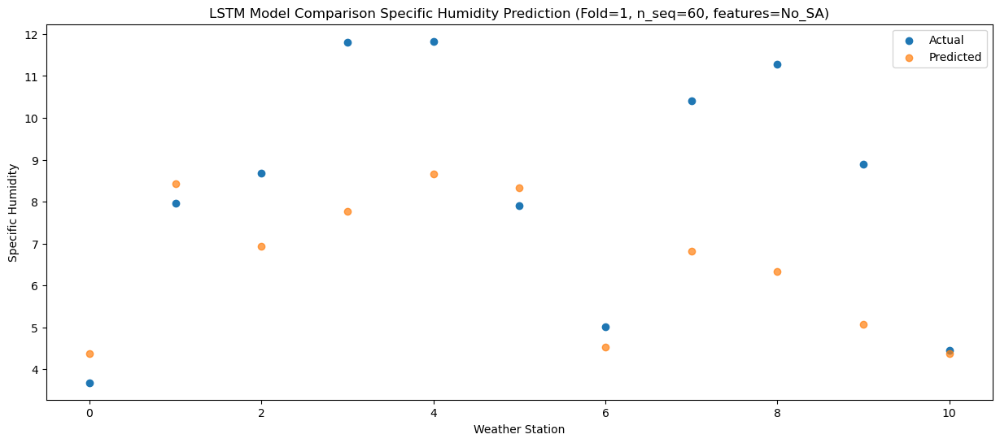

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09   6.062968
1                 1   10.93  10.122968
2                 2   11.82   8.612968
3                 3   12.37   9.462968
4                 4   11.91  10.352968
5                 5   10.08  10.022968
6                 6    8.64   6.212968
7                 7   12.98   8.502968
8                 8   11.51   8.012968
9                 9   10.83   6.762968
10               10    9.17   6.062968


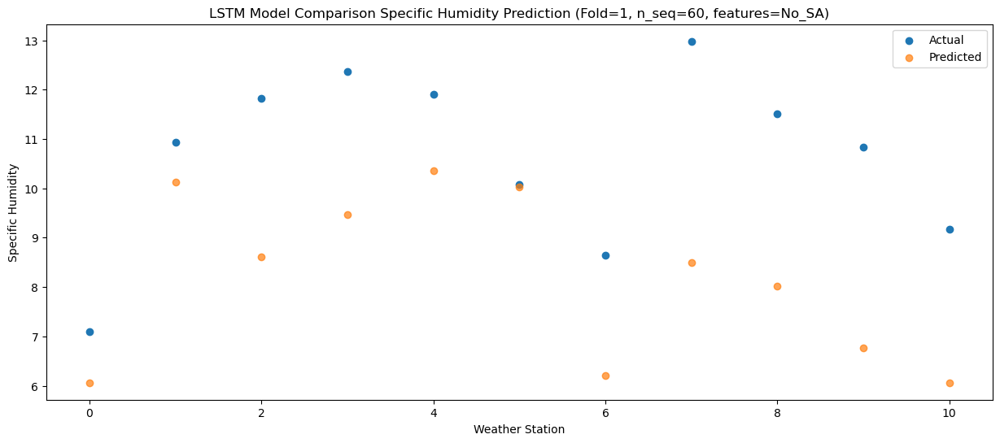

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   6.615545
1                 1   11.06  10.675545
2                 2   11.75   9.165545
3                 3   10.70  10.015545
4                 4   10.51  10.905545
5                 5   10.23  10.575545
6                 6    8.53   6.765545
7                 7   12.56   9.055545
8                 8    9.68   8.565545
9                 9    8.92   7.315545
10               10    6.88   6.615545


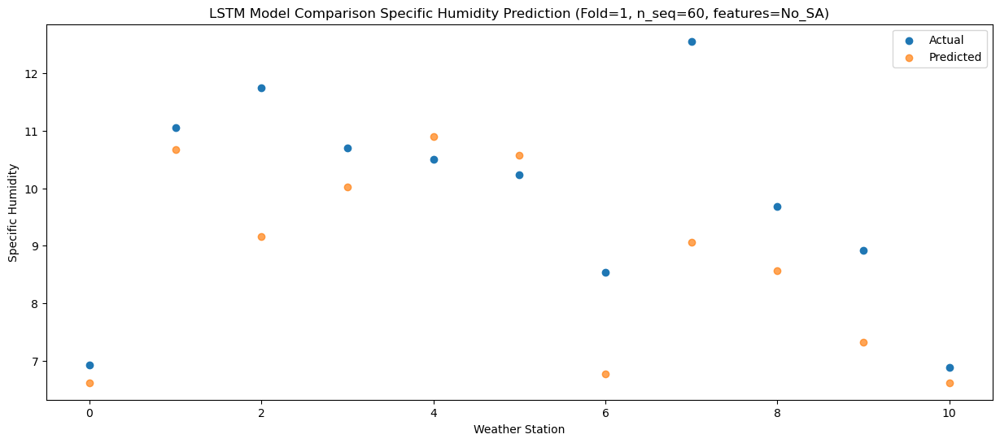

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06    5.85384
1                 1    7.95    9.91384
2                 2    7.94    8.40384
3                 3    9.50    9.25384
4                 4    9.76   10.14384
5                 5    9.87    9.81384
6                 6    5.56    6.00384
7                 7    8.07    8.29384
8                 8    8.73    7.80384
9                 9    7.27    6.55384
10               10    5.62    5.85384


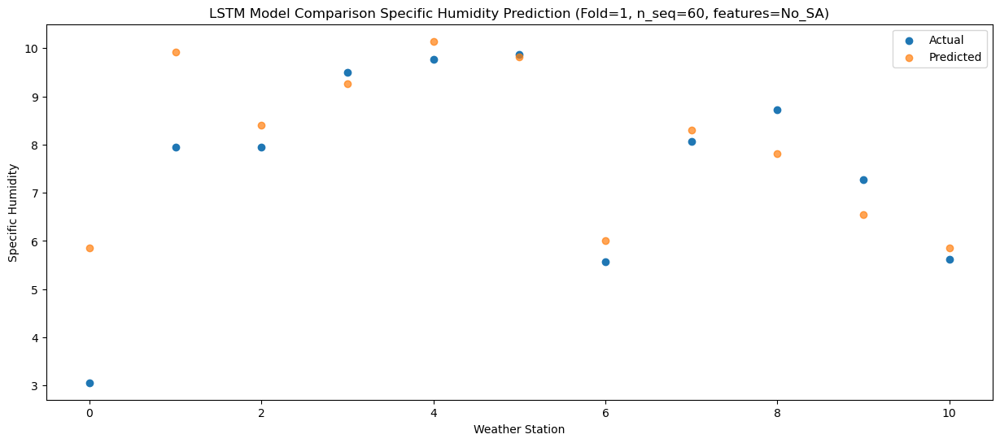

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34    1.87081
1                 1    4.10    5.93081
2                 2    3.43    4.42081
3                 3    6.08    5.27081
4                 4    6.37    6.16081
5                 5    7.89    5.83081
6                 6    1.31    2.02081
7                 7    4.82    4.31081
8                 8    5.30    3.82081
9                 9    4.16    2.57081
10               10    2.57    1.87081


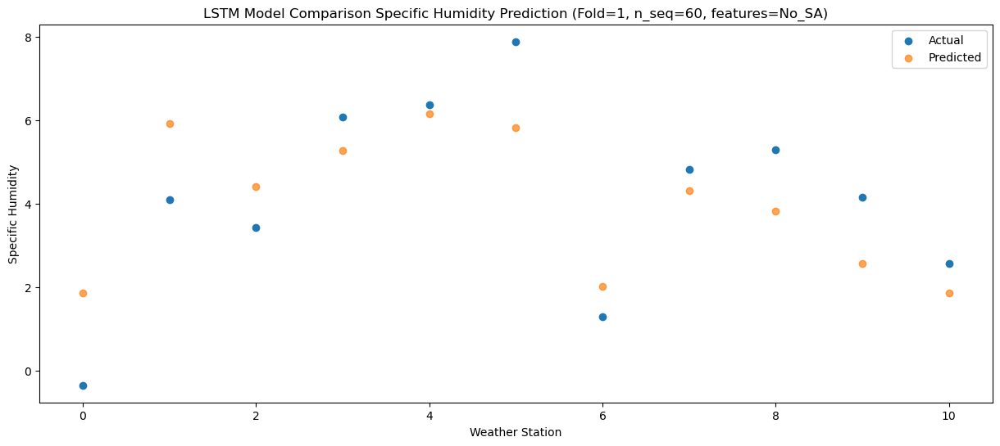

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -0.351407
1                 1    1.09   3.708593
2                 2    0.88   2.198593
3                 3    2.75   3.048593
4                 4    3.03   3.938593
5                 5    5.26   3.608593
6                 6   -2.04  -0.201407
7                 7    2.11   2.088593
8                 8    2.63   1.598593
9                 9    1.84   0.348593
10               10   -1.09  -0.351407


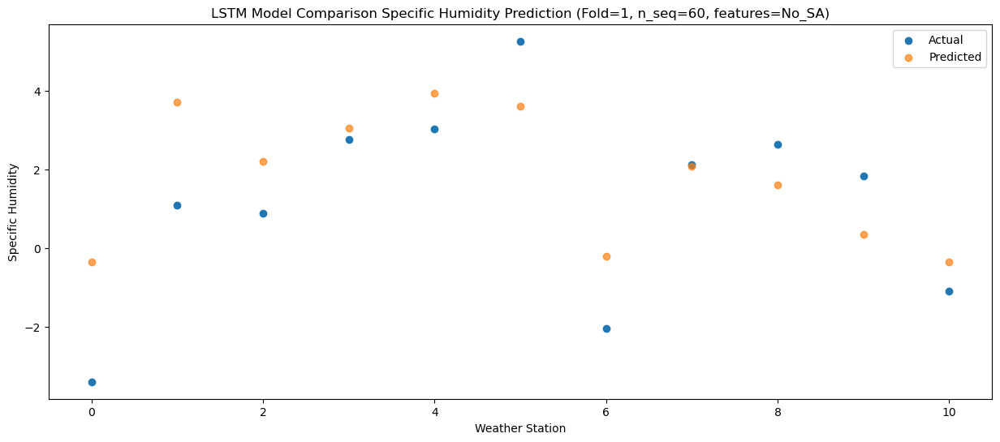

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -0.894901
1                 1    0.51   3.165099
2                 2   -0.14   1.655099
3                 3    1.11   2.505099
4                 4    1.31   3.395099
5                 5    3.39   3.065099
6                 6   -2.54  -0.744901
7                 7    0.72   1.545099
8                 8    1.58   1.055099
9                 9    1.40  -0.194901
10               10   -0.85  -0.894901


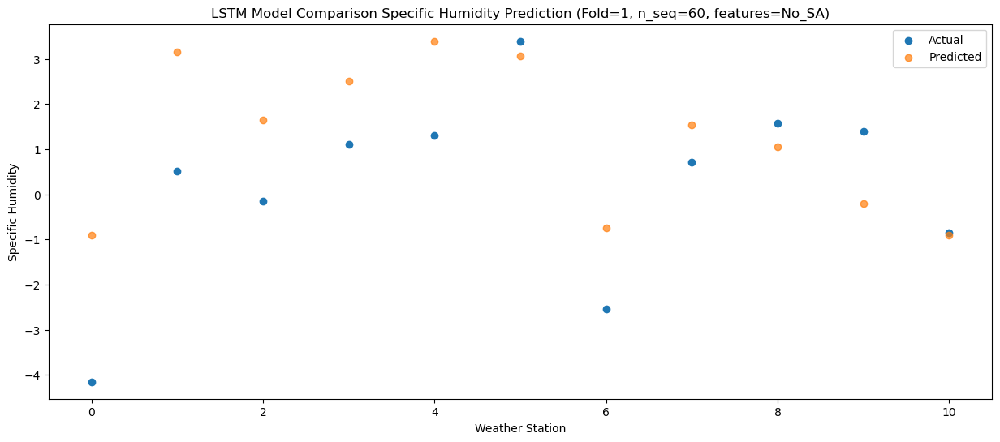

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -1.777301
1                 1   -0.26   2.282699
2                 2   -0.77   0.772699
3                 3    0.01   1.622699
4                 4    0.14   2.512699
5                 5    2.24   2.182699
6                 6   -3.36  -1.627301
7                 7   -0.35   0.662699
8                 8    0.27   0.172699
9                 9    0.66  -1.077301
10               10   -1.90  -1.777301


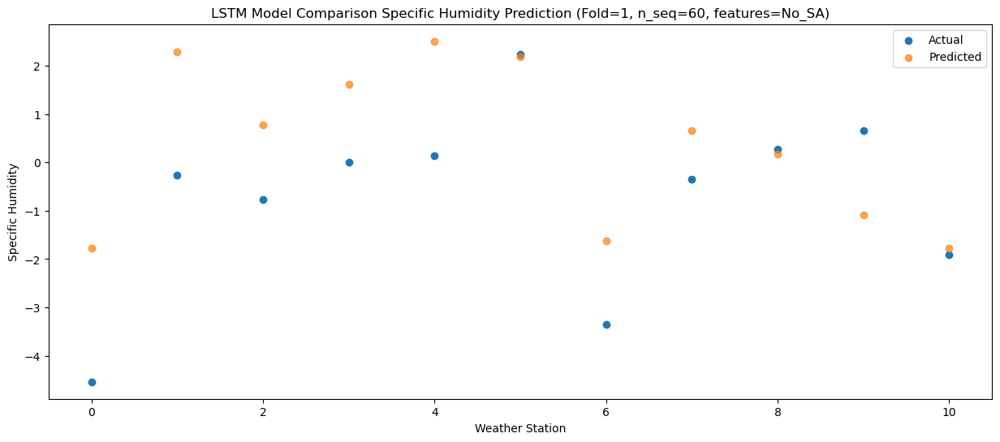

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -1.183427
1                 1    0.08   2.876573
2                 2    0.03   1.366573
3                 3    2.26   2.216573
4                 4    2.39   3.106573
5                 5    2.65   2.776573
6                 6   -2.88  -1.033427
7                 7    1.40   1.256573
8                 8    2.02   0.766573
9                 9    1.33  -0.483427
10               10   -2.03  -1.183427


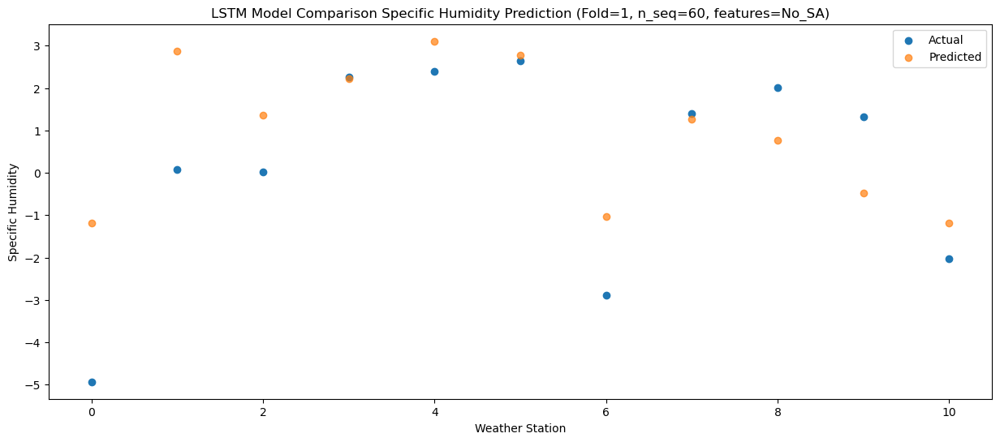

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -1.316852
1                 1    1.59   2.743148
2                 2    1.57   1.233148
3                 3    4.17   2.083148
4                 4    4.32   2.973148
5                 5    3.61   2.643148
6                 6   -1.54  -1.166852
7                 7    2.59   1.123148
8                 8    3.57   0.633148
9                 9    1.64  -0.616852
10               10   -1.00  -1.316852


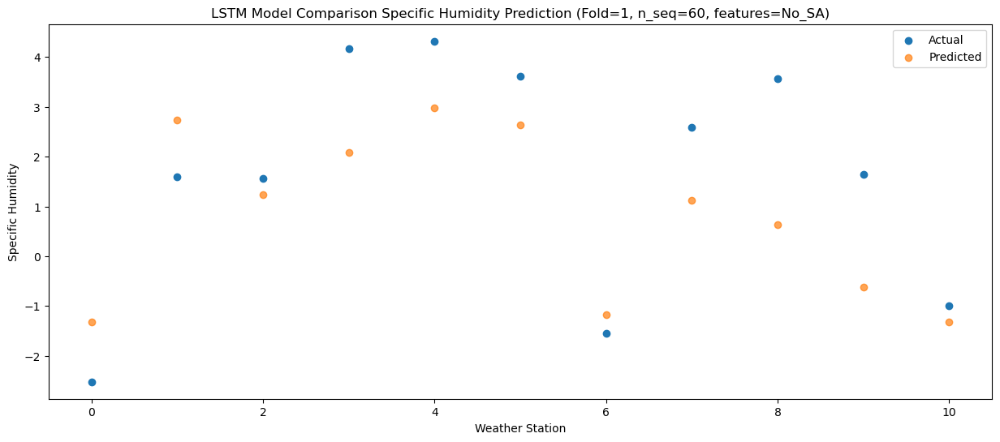

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45  -0.341821
1                 1    3.48   3.718179
2                 2    3.56   2.208179
3                 3    6.42   3.058179
4                 4    6.52   3.948179
5                 5    4.25   3.618179
6                 6    0.61  -0.191821
7                 7    4.36   2.098179
8                 8    5.89   1.608179
9                 9    2.50   0.358179
10               10    0.61  -0.341821


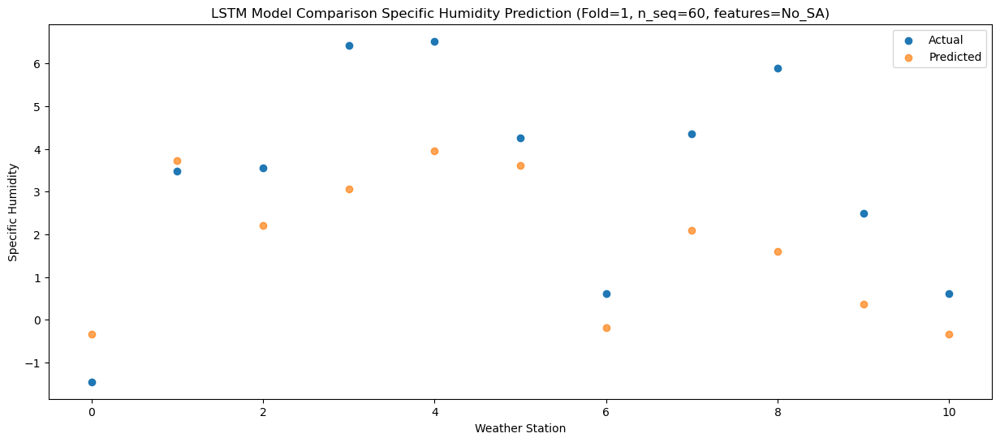

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   1.625614
1                 1    7.28   5.685614
2                 2    7.69   4.175614
3                 3   10.77   5.025614
4                 4   10.50   5.915614
5                 5    6.68   5.585614
6                 6    4.75   1.775614
7                 7    8.67   4.065614
8                 8    9.49   3.575614
9                 9    5.23   2.325614
10               10    4.19   1.625614


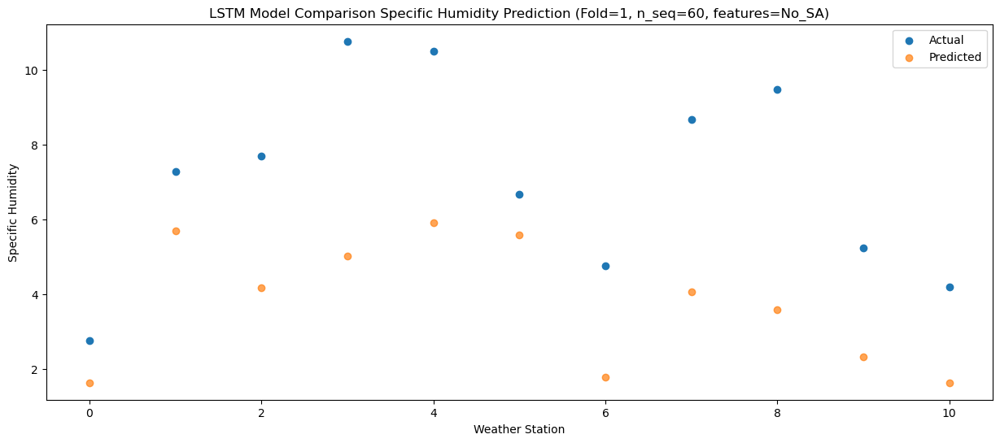

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   5.053185
1                 1    8.79   9.113185
2                 2    9.12   7.603185
3                 3   12.16   8.453185
4                 4   12.01   9.343185
5                 5   11.53   9.013185
6                 6    6.71   5.203185
7                 7   10.69   7.493185
8                 8   12.40   7.003185
9                 9   10.90   5.753185
10               10    6.01   5.053185


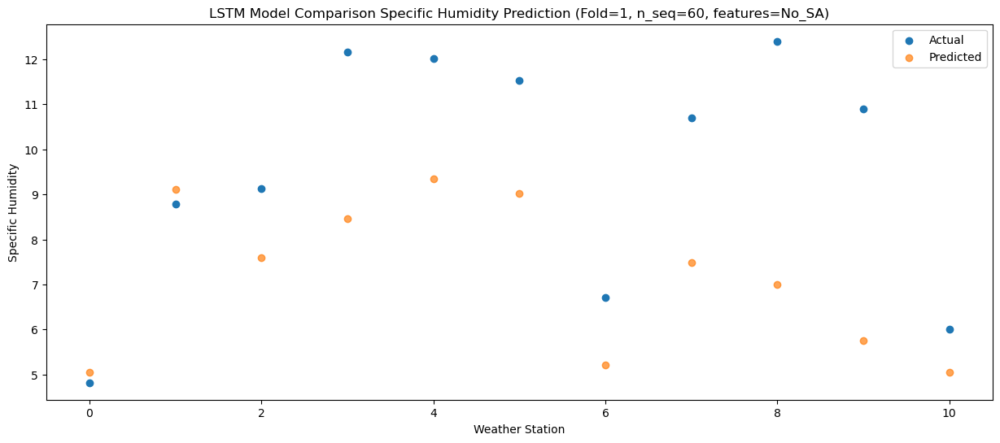

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   6.947402
1                 1   11.39  11.007402
2                 2   12.29   9.497402
3                 3   12.24  10.347402
4                 4   12.33  11.237402
5                 5   11.38  10.907402
6                 6    9.09   7.097402
7                 7   11.36   9.387402
8                 8   11.01   8.897402
9                 9    9.15   7.647402
10               10    9.38   6.947402


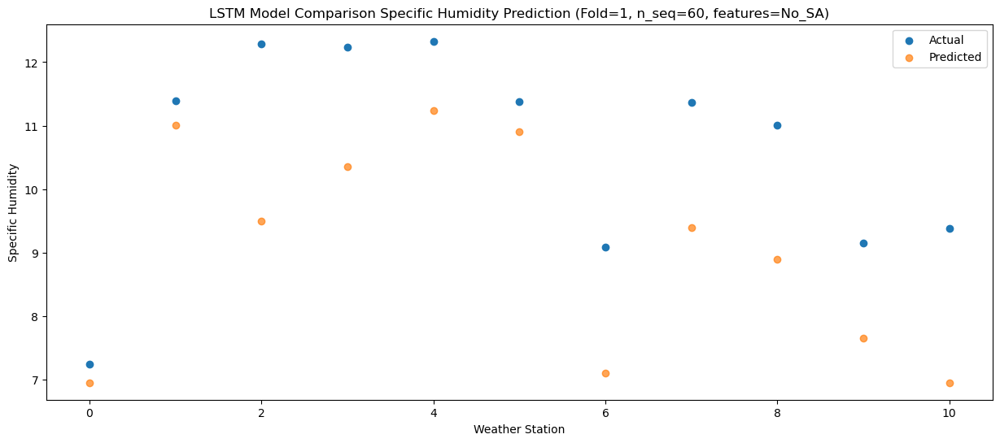

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60    6.50689
1                 1    9.66   10.56689
2                 2   10.17    9.05689
3                 3   12.33    9.90689
4                 4   12.38   10.79689
5                 5   10.24   10.46689
6                 6    7.37    6.65689
7                 7   10.12    8.94689
8                 8   10.42    8.45689
9                 9    9.34    7.20689
10               10    7.80    6.50689


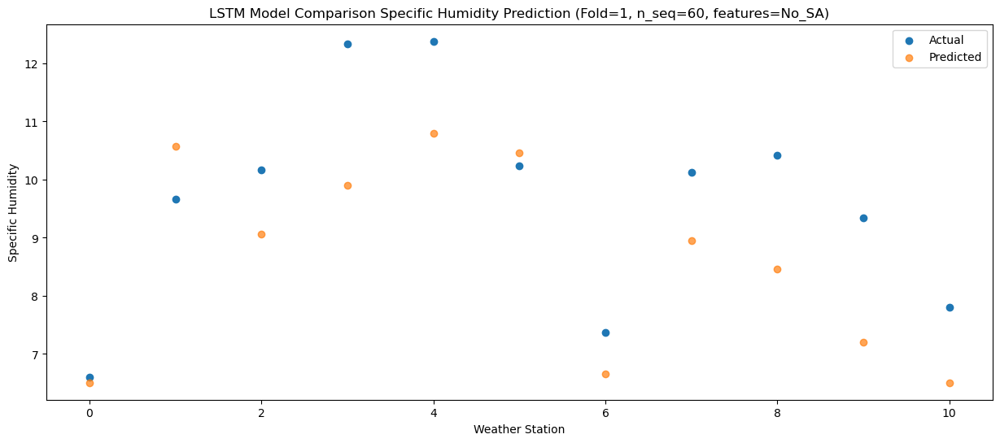

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   4.735909
1                 1    8.14   8.795909
2                 2    8.62   7.285909
3                 3    9.41   8.135909
4                 4    9.84   9.025909
5                 5   10.72   8.695909
6                 6    6.08   4.885909
7                 7    8.36   7.175909
8                 8    8.51   6.685909
9                 9    6.90   5.435909
10               10    5.31   4.735909


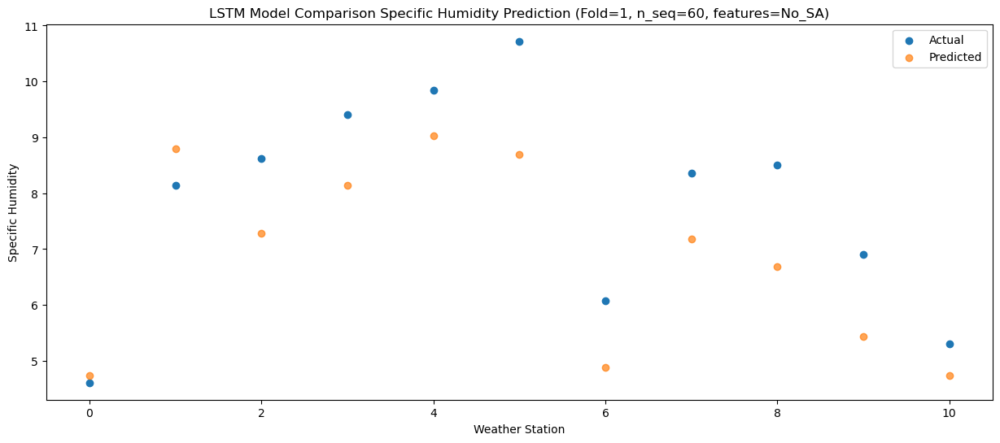

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34   1.301973
1                 1    4.31   5.361973
2                 2    4.12   3.851973
3                 3    5.36   4.701973
4                 4    5.51   5.591973
5                 5    6.45   5.261973
6                 6    1.94   1.451973
7                 7    3.32   3.741973
8                 8    5.15   3.251973
9                 9    3.91   2.001973
10               10    1.00   1.301973


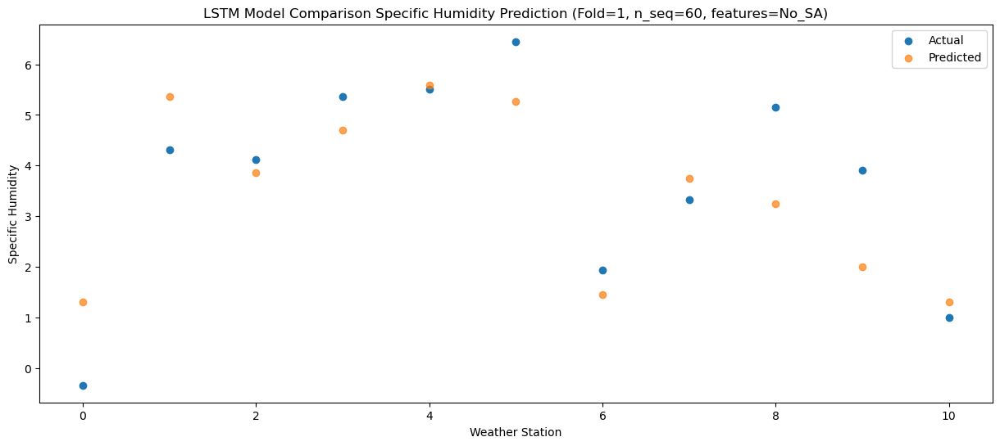

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

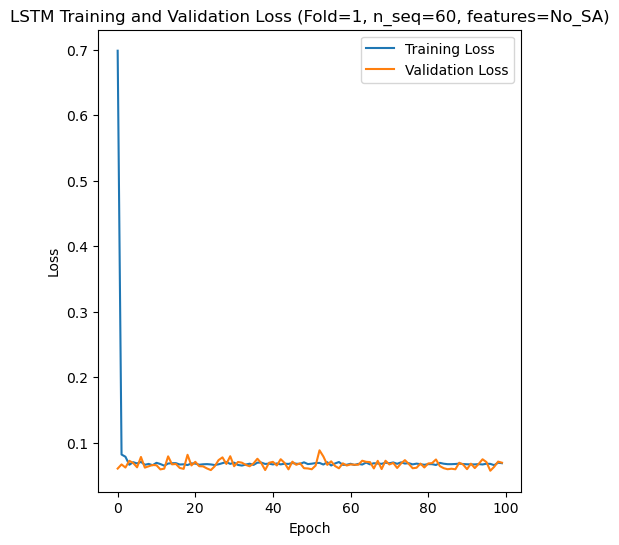

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 51s 267ms/step - loss: 0.4488 - accuracy: 0.3214 - mae: 0.4062 - rmse: 0.4488 - mape: 84.4953 - pearson: 0.6242 - val_loss: 0.0597 - val_accuracy: 0.8000 - val_mae: 0.0476 - val_rmse: 0.0597 - val_mape: 10.4972 - val_pearson: 0.8346
Epoch 2/100
84/84 [==============================] - 14s 164ms/step - loss: 0.0676 - accuracy: 0.4643 - mae: 0.0537 - rmse: 0.0676 - mape: 12.1162 - pearson: 0.7705 - val_loss: 0.0684 - val_accuracy: 0.0000e+00 - val_mae: 0.0549 - val_rmse: 0.0684 - val_mape: 12.1099 - val_pearson: 0.8215
Epoch 3/100
84/84 [==============================] - 14s 170ms/step - loss: 0.0679 - accuracy: 0.4048 - mae: 0.0536 - rmse: 0.0679 - mape: 12.1698 - pearson: 0.

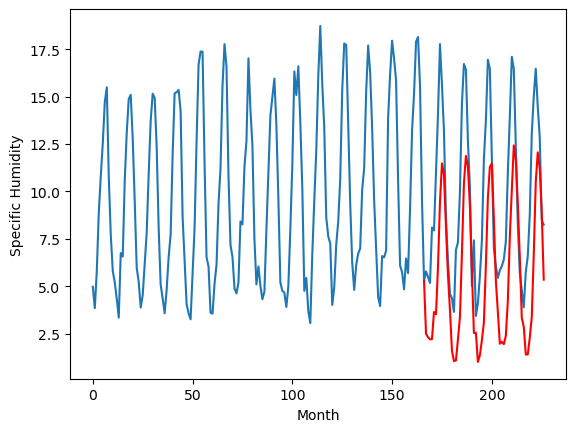

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		2.40		-0.94
2.83		2.21		-0.62
2.81		2.10		-0.71
2.87		2.12		-0.75
4.66		3.55		-1.11
4.95		3.43		-1.52
7.85		5.91		-1.94
9.27		9.38		0.11
14.08		11.39		-2.69
12.65		10.81		-1.84
8.59		8.03		-0.56
4.86		5.51		0.65
4.64		3.65		-0.99
2.91		1.50		-1.41
2.86		0.95		-1.91
2.18		0.99		-1.19
4.03		2.10		-1.93
4.15		3.27		-0.88
9.27		6.65		-2.62
12.18		10.35		-1.83
13.79		11.79		-2.00
12.17		11.22		-0.95
9.35		9.14		-0.21
5.96		5.71		-0.25
3.53		2.44		-1.09
2.47		2.45		-0.02
2.14		0.91		-1.23
2.05		1.26		-0.79
2.93		2.05		-0.88
4.08		2.98		-1.10
6.47		6.01		-0.46
10.83		9.57		-1.26
12.17		11.21		-0.96
11.67		11.39		-0.28
9.10		8.48		-0.62
5.42		5.18		-0.24
3.92		3.56		-0.36
2.73		1.87		-0.86
2.72		1.97		-0.75
2.64		1.85		-0.79
3.33		2.29		-1.04
3.95		4.12		0.17
9.73		7.51		-2.22
12.38		9.97		-2.41
14.44		12.34		-2.10
12.55		11.59		-0.96
9.96		9.28		-0.68
6.50		6.45		-0.05
3.94		3.24		-0.70
3.55		

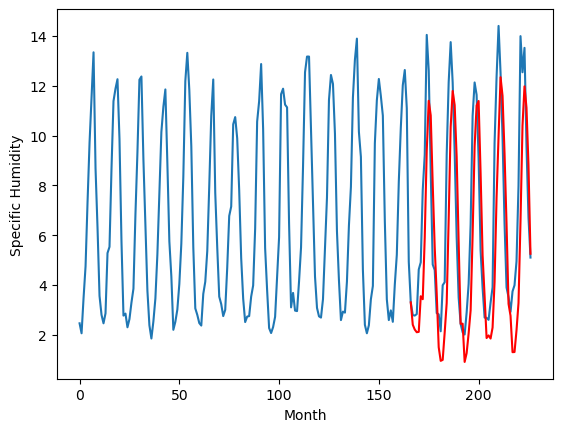

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-0.11		2.35
-2.15		-0.30		1.85
-3.71		-0.41		3.30
-2.83		-0.39		2.44
-1.66		1.04		2.70
-0.18		0.92		1.10
0.93		3.40		2.47
4.27		6.87		2.60
5.29		8.88		3.59
5.99		8.30		2.31
5.29		5.52		0.23
2.70		3.00		0.30
-0.25		1.14		1.39
-4.92		-1.01		3.91
-4.43		-1.56		2.87
-2.30		-1.52		0.78
-2.08		-0.41		1.67
-1.11		0.76		1.87
0.20		4.14		3.94
3.98		7.84		3.86
4.38		9.28		4.90
5.00		8.71		3.71
3.72		6.63		2.91
1.06		3.20		2.14
-2.89		-0.07		2.82
-1.49		-0.06		1.43
-5.14		-1.60		3.54
-3.95		-1.25		2.70
-2.14		-0.46		1.68
-0.78		0.47		1.25
2.32		3.50		1.18
4.25		7.06		2.81
5.08		8.70		3.62
4.97		8.88		3.91
4.82		5.97		1.15
0.43		2.67		2.24
0.32		1.05		0.73
-3.34		-0.64		2.70
-3.72		-0.54		3.18
-1.87		-0.66		1.21
-1.48		-0.22		1.26
0.03		1.61		1.58
0.84		5.00		4.16
4.00		7.46		3.46
4.97		9.83		4.86
5.69		9.08		3.39
3.30		6.77		3.47
0.38		3.94		3.56
-2.12		0.73		2.85
-2.69		0.25		2.94
-3.76		-1.21		

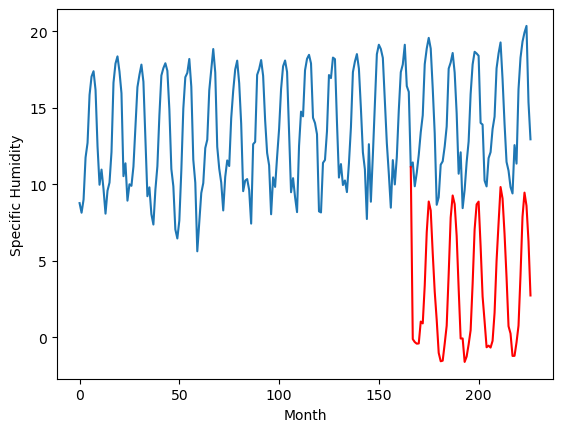

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		6.21		1.72
3.93		6.02		2.09
3.75		5.91		2.16
3.77		5.93		2.16
4.29		7.36		3.07
4.67		7.24		2.57
6.92		9.72		2.80
10.93		13.19		2.26
14.31		15.20		0.89
13.48		14.62		1.14
10.39		11.84		1.45
7.88		9.32		1.44
6.01		7.46		1.45
4.09		5.31		1.22
3.01		4.76		1.75
3.18		4.80		1.62
3.82		5.91		2.09
5.17		7.08		1.91
6.85		10.46		3.61
11.45		14.16		2.71
14.05		15.60		1.55
14.79		15.03		0.24
12.13		12.95		0.82
9.17		9.52		0.35
4.72		6.25		1.53
4.36		6.26		1.90
3.03		4.72		1.69
3.60		5.07		1.47
4.36		5.86		1.50
5.06		6.79		1.73
8.36		9.82		1.46
10.62		13.38		2.76
13.98		15.02		1.04
14.66		15.20		0.54
10.86		12.29		1.43
7.99		8.99		1.00
6.17		7.37		1.20
4.08		5.68		1.60
4.59		5.78		1.19
3.83		5.66		1.83
4.08		6.10		2.02
6.16		7.93		1.77
6.97		11.32		4.35
10.87		13.78		2.91
15.13		16.15		1.02
12.79		15.40		2.61
11.78		13.09		1.31
8.42		10.26		1.84
4.59		7.05		2.46
4.88		6.57		1.69
3.55		5.11		1.56
3.5

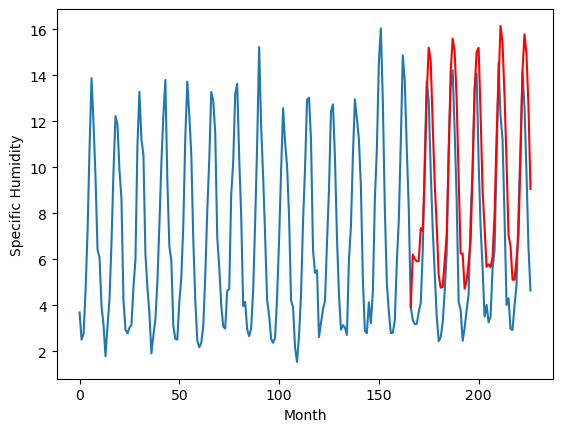

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		1.12		3.19
-1.27		0.93		2.20
-1.24		0.82		2.06
-0.92		0.84		1.76
2.57		2.27		-0.30
1.61		2.15		0.54
3.73		4.63		0.90
7.07		8.10		1.03
9.20		10.11		0.91
8.47		9.53		1.06
6.67		6.75		0.08
3.46		4.23		0.77
0.73		2.37		1.64
-2.55		0.22		2.77
-2.42		-0.33		2.09
-2.44		-0.29		2.15
0.85		0.82		-0.03
0.87		1.99		1.12
4.07		5.37		1.30
7.96		9.07		1.11
8.99		10.51		1.52
8.59		9.94		1.35
6.45		7.86		1.41
3.92		4.43		0.51
-1.74		1.16		2.90
1.54		1.17		-0.37
-3.37		-0.37		3.00
-1.91		-0.02		1.89
-1.06		0.77		1.83
1.37		1.70		0.33
5.40		4.73		-0.67
7.70		8.29		0.59
8.99		9.93		0.94
9.39		10.11		0.72
5.88		7.20		1.32
0.70		3.90		3.20
0.26		2.28		2.02
-0.29		0.59		0.88
-0.38		0.69		1.07
0.92		0.57		-0.35
1.80		1.01		-0.79
2.35		2.84		0.49
5.41		6.23		0.82
8.72		8.69		-0.03
10.06		11.06		1.00
10.09		10.31		0.22
7.74		8.00		0.26
2.51		5.17		2.66
-0.01		1.96		1.97
-1.60		1.48		3.08
-2.47		0.02		2.49
-1.4

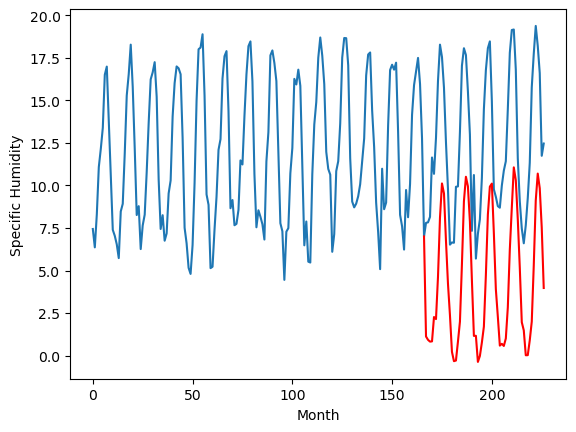

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		4.87		1.10
2.58		4.68		2.10
3.41		4.57		1.16
2.74		4.59		1.85
7.35		6.02		-1.33
6.83		5.90		-0.93
8.91		8.38		-0.53
11.03		11.85		0.82
13.61		13.86		0.25
12.17		13.28		1.11
10.72		10.50		-0.22
6.85		7.98		1.13
4.79		6.12		1.33
2.47		3.97		1.50
2.34		3.42		1.08
2.29		3.46		1.17
5.28		4.57		-0.71
6.85		5.74		-1.11
11.68		9.12		-2.56
14.32		12.82		-1.50
13.28		14.26		0.98
13.41		13.69		0.28
9.85		11.61		1.76
8.26		8.18		-0.08
4.07		4.91		0.84
6.94		4.92		-2.02
1.31		3.38		2.07
1.53		3.73		2.20
3.15		4.52		1.37
7.11		5.45		-1.66
10.76		8.48		-2.28
11.79		12.04		0.25
12.89		13.68		0.79
13.35		13.86		0.51
9.99		10.95		0.96
5.17		7.65		2.48
5.03		6.03		1.00
4.12		4.34		0.22
3.74		4.44		0.70
4.19		4.32		0.13
5.97		4.76		-1.21
6.52		6.59		0.07
10.22		9.98		-0.24
13.68		12.44		-1.24
13.39		14.81		1.42
11.96		14.06		2.10
11.41		11.75		0.34
7.88		8.92		1.04
4.71		5.71		1.00
2.78		5.23		2.45
1.77		3

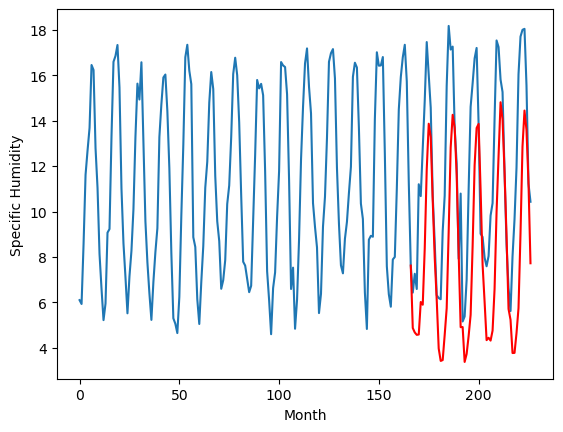

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		3.53		0.64
1.79		3.34		1.55
2.47		3.23		0.76
1.91		3.25		1.34
6.13		4.68		-1.45
5.71		4.56		-1.15
8.65		7.04		-1.61
10.93		10.51		-0.42
13.84		12.52		-1.32
11.14		11.94		0.80
10.20		9.16		-1.04
5.71		6.64		0.93
4.12		4.78		0.66
1.41		2.63		1.22
1.31		2.08		0.77
0.98		2.12		1.14
3.84		3.23		-0.61
5.16		4.40		-0.76
9.36		7.78		-1.58
13.11		11.48		-1.63
13.93		12.92		-1.01
14.31		12.35		-1.96
9.86		10.27		0.41
7.25		6.84		-0.41
3.26		3.57		0.31
5.76		3.58		-2.18
0.47		2.04		1.57
0.94		2.39		1.45
2.57		3.18		0.61
6.47		4.11		-2.36
10.56		7.14		-3.42
11.36		10.70		-0.66
10.68		12.34		1.66
11.74		12.52		0.78
9.07		9.61		0.54
4.29		6.31		2.02
3.84		4.69		0.85
2.67		3.00		0.33
1.89		3.10		1.21
2.29		2.98		0.69
4.20		3.42		-0.78
4.87		5.25		0.38
8.76		8.64		-0.12
12.66		11.10		-1.56
11.95		13.47		1.52
9.90		12.72		2.82
9.27		10.41		1.14
6.12		7.58		1.46
3.50		4.37		0.87
1.68		3.89		2.21
0.56		2.

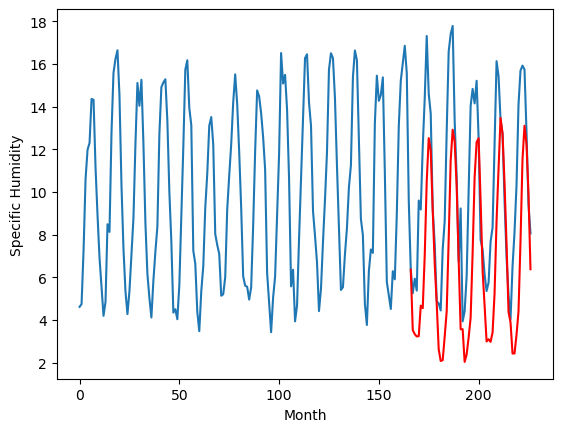

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		2.05		-1.50
3.10		1.86		-1.24
2.15		1.75		-0.40
2.68		1.77		-0.91
4.14		3.20		-0.94
2.74		3.08		0.34
2.98		5.56		2.58
4.66		9.03		4.37
8.10		11.04		2.94
6.37		10.46		4.09
5.72		7.68		1.96
2.65		5.16		2.51
2.70		3.30		0.60
1.44		1.15		-0.29
1.72		0.60		-1.12
1.59		0.64		-0.95
1.68		1.75		0.07
1.98		2.92		0.94
2.10		6.30		4.20
4.76		10.00		5.24
10.00		11.44		1.44
10.29		10.87		0.58
7.53		8.79		1.26
3.82		5.36		1.54
2.17		2.09		-0.08
2.30		2.10		-0.20
2.02		0.56		-1.46
1.03		0.91		-0.12
1.43		1.70		0.27
1.44		2.63		1.19
1.37		5.66		4.29
6.87		9.22		2.35
9.43		10.86		1.43
11.40		11.04		-0.36
8.36		8.13		-0.23
6.28		4.83		-1.45
2.31		3.21		0.90
3.13		1.52		-1.61
2.24		1.62		-0.62
2.12		1.50		-0.62
2.46		1.94		-0.52
1.62		3.77		2.15
3.62		7.16		3.54
3.42		9.62		6.20
6.77		11.99		5.22
8.96		11.24		2.28
7.15		8.93		1.78
4.70		6.10		1.40
3.78		2.89		-0.89
2.26		2.41		0.15
2.68		0.95		-1.73
2.70	

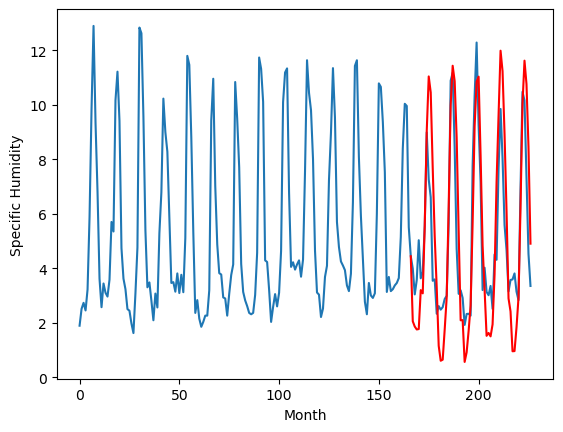

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		-0.68		-2.91
2.05		-0.87		-2.92
1.84		-0.98		-2.82
1.12		-0.96		-2.08
2.76		0.47		-2.29
4.17		0.35		-3.82
4.93		2.83		-2.10
4.91		6.30		1.39
5.68		8.31		2.63
6.76		7.73		0.97
4.98		4.95		-0.03
3.85		2.43		-1.42
1.61		0.57		-1.04
0.04		-1.58		-1.62
0.89		-2.13		-3.02
1.42		-2.09		-3.51
1.53		-0.98		-2.51
2.85		0.19		-2.66
4.33		3.57		-0.76
5.58		7.27		1.69
6.73		8.71		1.98
6.13		8.14		2.01
5.67		6.06		0.39
2.87		2.63		-0.24
2.33		-0.64		-2.97
2.15		-0.63		-2.78
0.79		-2.17		-2.96
0.05		-1.82		-1.87
1.79		-1.03		-2.82
2.63		-0.10		-2.73
3.89		2.93		-0.96
5.66		6.49		0.83
6.55		8.13		1.58
6.65		8.31		1.66
7.50		5.40		-2.10
5.73		2.10		-3.63
1.09		0.48		-0.61
1.94		-1.21		-3.15
2.03		-1.11		-3.14
0.62		-1.23		-1.85
2.54		-0.79		-3.33
3.24		1.04		-2.20
4.64		4.43		-0.21
5.02		6.89		1.87
6.36		9.26		2.90
6.97		8.51		1.54
6.72		6.20		-0.52
4.42		3.37		-1.05
1.39		0.16		-1.23
2.18		-0.32		-2.50

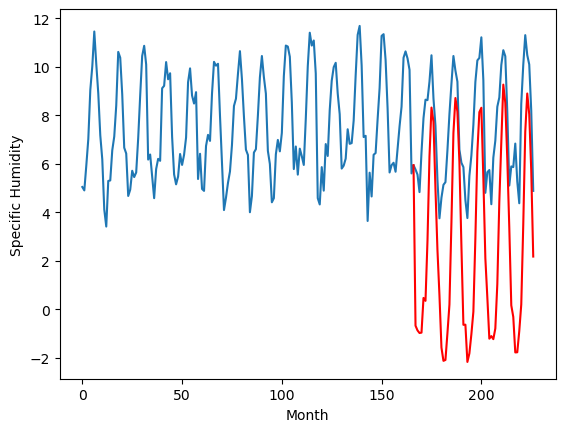

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		2.47		2.64
-0.06		2.28		2.34
-0.08		2.17		2.25
0.31		2.19		1.88
1.94		3.62		1.68
1.85		3.50		1.65
5.18		5.98		0.80
8.69		9.45		0.76
11.54		11.46		-0.08
11.53		10.88		-0.65
7.81		8.10		0.29
5.19		5.58		0.39
2.54		3.72		1.18
-0.68		1.57		2.25
-0.80		1.02		1.82
-0.73		1.06		1.79
1.00		2.17		1.17
1.53		3.34		1.81
4.24		6.72		2.48
8.74		10.42		1.68
10.26		11.86		1.60
10.84		11.29		0.45
7.24		9.21		1.97
5.08		5.78		0.70
-0.48		2.51		2.99
1.37		2.52		1.15
-1.41		0.98		2.39
-0.10		1.33		1.43
0.86		2.12		1.26
1.90		3.05		1.15
6.22		6.08		-0.14
8.02		9.64		1.62
11.60		11.28		-0.32
10.03		11.46		1.43
6.60		8.55		1.95
2.24		5.25		3.01
1.77		3.63		1.86
-0.47		1.94		2.41
0.39		2.04		1.65
1.15		1.92		0.77
0.84		2.36		1.52
2.97		4.19		1.22
4.50		7.58		3.08
7.36		10.04		2.68
11.20		12.41		1.21
10.71		11.66		0.95
7.57		9.35		1.78
3.38		6.52		3.14
0.27		3.31		3.04
0.18		2.83		2.65
-0.51		1.37		1.88
-0.3

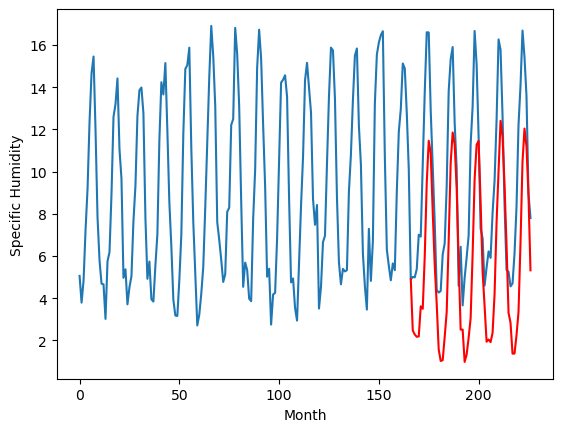

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		2.49		1.97
0.97		2.30		1.33
0.77		2.19		1.42
0.88		2.21		1.33
2.73		3.64		0.91
2.16		3.52		1.36
4.95		6.00		1.05
8.39		9.47		1.08
11.09		11.48		0.39
10.85		10.90		0.05
8.24		8.12		-0.12
5.05		5.60		0.55
1.93		3.74		1.81
0.14		1.59		1.45
0.15		1.04		0.89
0.39		1.08		0.69
1.42		2.19		0.77
2.03		3.36		1.33
4.70		6.74		2.04
8.80		10.44		1.64
10.21		11.88		1.67
10.60		11.31		0.71
7.39		9.23		1.84
5.66		5.80		0.14
0.30		2.53		2.23
1.86		2.54		0.68
-0.56		1.00		1.56
0.34		1.35		1.01
0.96		2.14		1.18
2.23		3.07		0.84
6.39		6.10		-0.29
8.35		9.66		1.31
11.56		11.30		-0.26
10.57		11.48		0.91
7.09		8.57		1.48
2.43		5.27		2.84
1.81		3.65		1.84
0.72		1.96		1.24
0.99		2.06		1.07
1.39		1.94		0.55
0.99		2.38		1.39
2.63		4.21		1.58
5.22		7.60		2.38
7.06		10.06		3.00
10.37		12.43		2.06
10.48		11.68		1.20
8.06		9.37		1.31
3.95		6.54		2.59
1.00		3.33		2.33
0.79		2.85		2.06
0.17		1.39		1.22
0.57		1.40		0.8

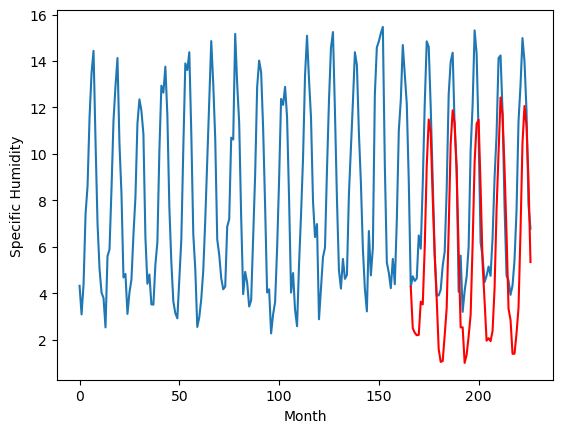

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   2.493151
1                 1    3.34   2.403151
2                 2   -2.46  -0.106849
3                 3    4.49   6.213151
4                 4   -2.07   1.123151
5                 5    3.77   4.873151
6                 6    2.89   3.533151
7                 7    3.55   2.053151
8                 8    2.23  -0.676849
9                 9   -0.17   2.473151
10               10    0.52   2.493151


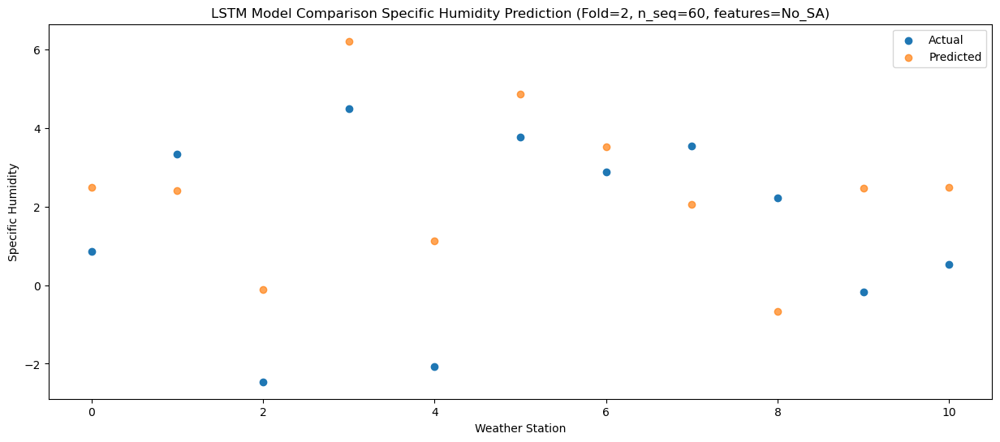

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   2.298558
1                 1    2.83   2.208558
2                 2   -2.15  -0.301442
3                 3    3.93   6.018558
4                 4   -1.27   0.928558
5                 5    2.58   4.678558
6                 6    1.79   3.338558
7                 7    3.10   1.858558
8                 8    2.05  -0.871442
9                 9   -0.06   2.278558
10               10    0.97   2.298558


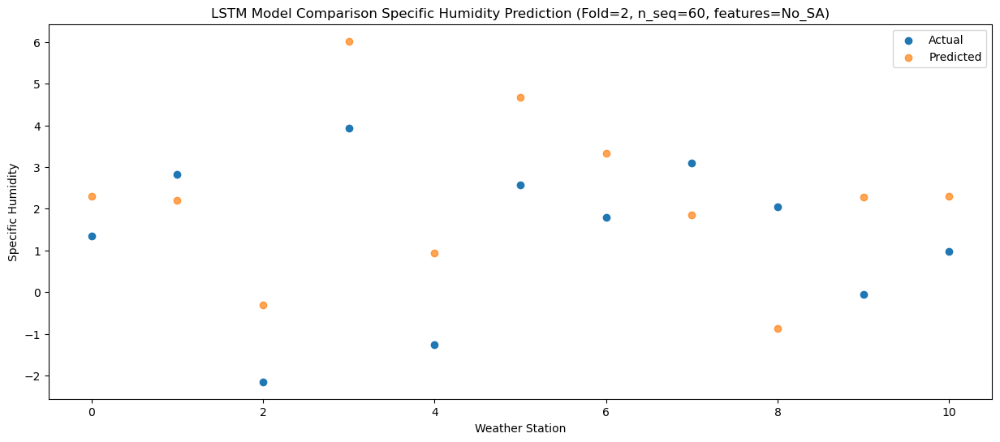

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   2.192073
1                 1    2.81   2.102073
2                 2   -3.71  -0.407927
3                 3    3.75   5.912073
4                 4   -1.24   0.822073
5                 5    3.41   4.572073
6                 6    2.47   3.232073
7                 7    2.15   1.752073
8                 8    1.84  -0.977927
9                 9   -0.08   2.172073
10               10    0.77   2.192073


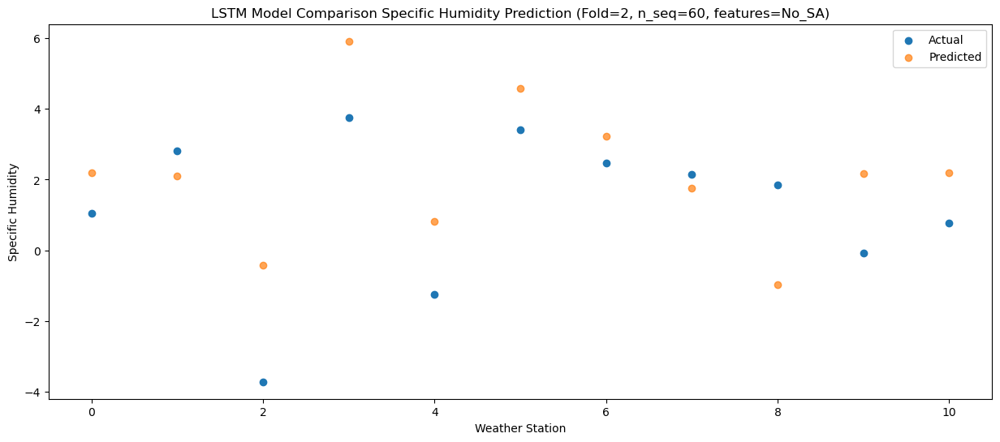

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   2.207124
1                 1    2.87   2.117124
2                 2   -2.83  -0.392876
3                 3    3.77   5.927124
4                 4   -0.92   0.837124
5                 5    2.74   4.587124
6                 6    1.91   3.247124
7                 7    2.68   1.767124
8                 8    1.12  -0.962876
9                 9    0.31   2.187124
10               10    0.88   2.207124


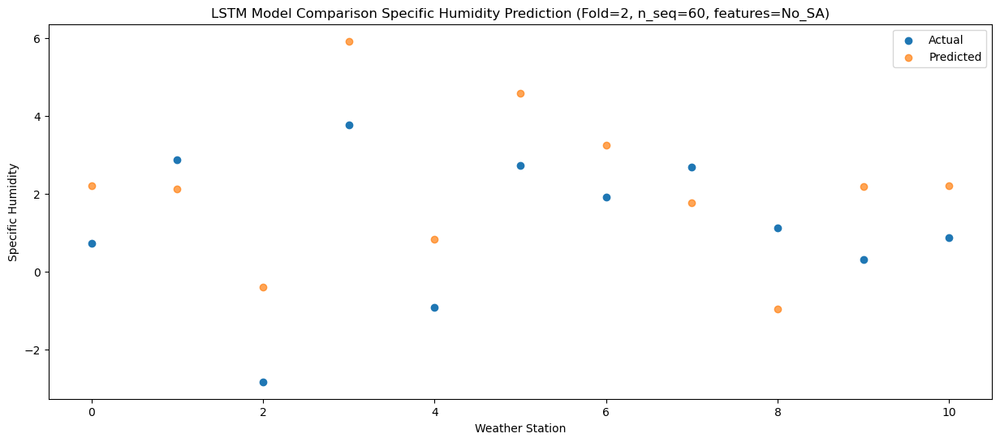

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.637248
1                 1    4.66   3.547248
2                 2   -1.66   1.037248
3                 3    4.29   7.357248
4                 4    2.57   2.267248
5                 5    7.35   6.017248
6                 6    6.13   4.677248
7                 7    4.14   3.197248
8                 8    2.76   0.467248
9                 9    1.94   3.617248
10               10    2.73   3.637248


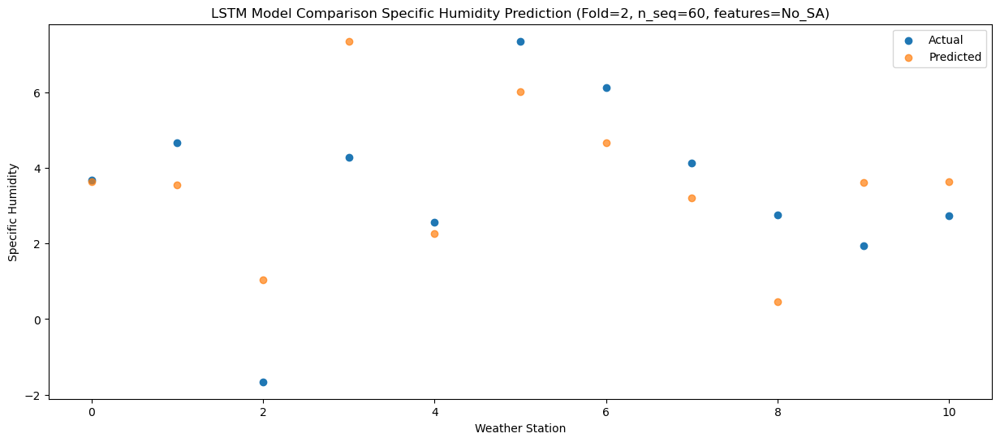

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.517552
1                 1    4.95   3.427552
2                 2   -0.18   0.917552
3                 3    4.67   7.237552
4                 4    1.61   2.147552
5                 5    6.83   5.897552
6                 6    5.71   4.557552
7                 7    2.74   3.077552
8                 8    4.17   0.347552
9                 9    1.85   3.497552
10               10    2.16   3.517552


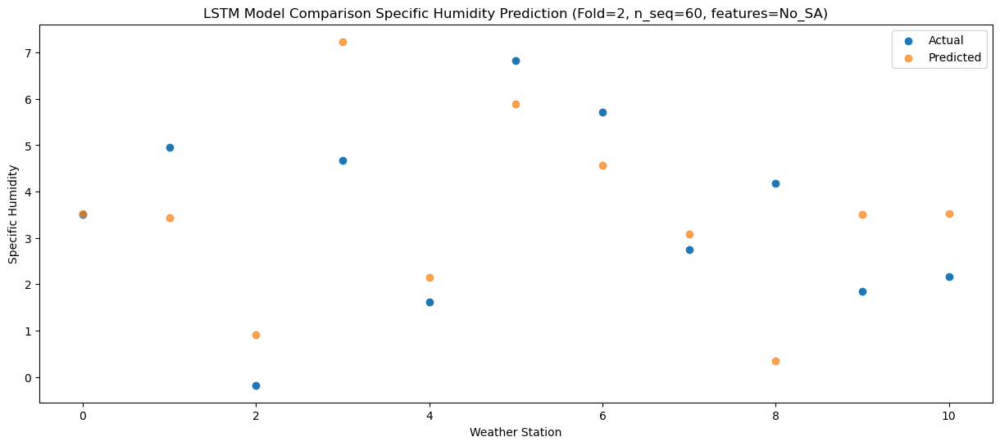

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   6.000354
1                 1    7.85   5.910354
2                 2    0.93   3.400354
3                 3    6.92   9.720354
4                 4    3.73   4.630354
5                 5    8.91   8.380354
6                 6    8.65   7.040354
7                 7    2.98   5.560354
8                 8    4.93   2.830354
9                 9    5.18   5.980354
10               10    4.95   6.000354


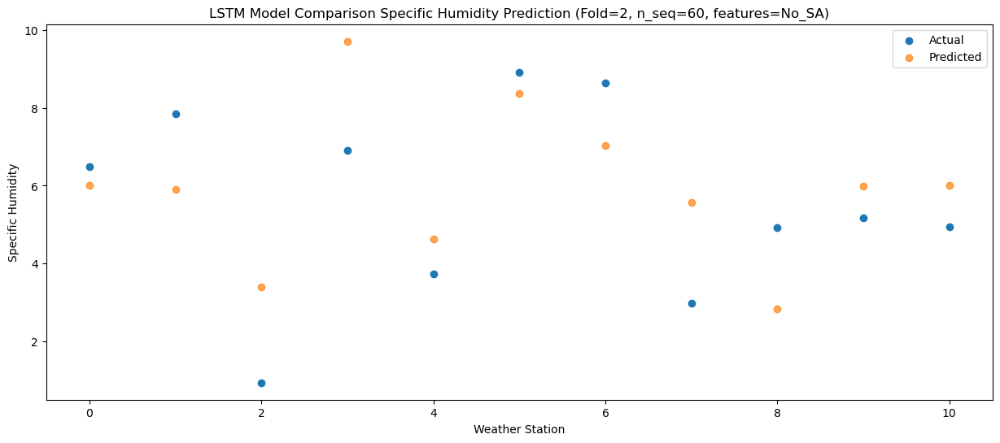

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   9.474223
1                 1    9.27   9.384223
2                 2    4.27   6.874223
3                 3   10.93  13.194223
4                 4    7.07   8.104223
5                 5   11.03  11.854223
6                 6   10.93  10.514223
7                 7    4.66   9.034223
8                 8    4.91   6.304223
9                 9    8.69   9.454223
10               10    8.39   9.474223


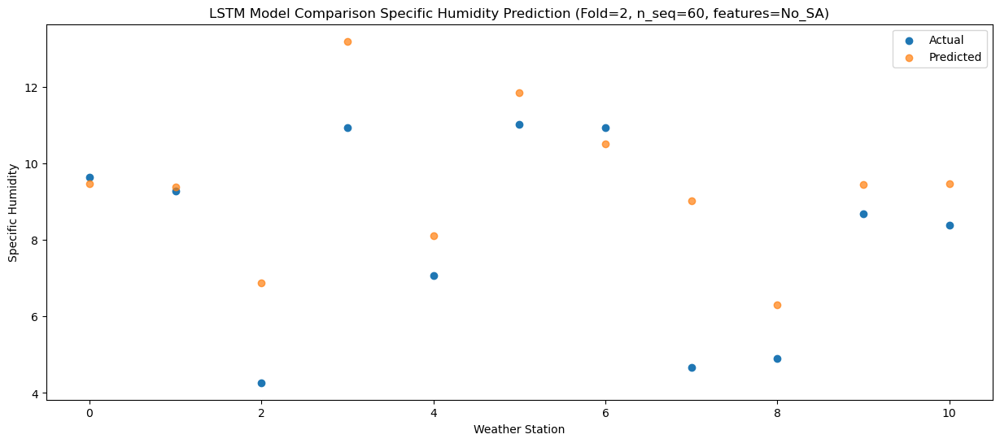

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  11.484682
1                 1   14.08  11.394682
2                 2    5.29   8.884682
3                 3   14.31  15.204682
4                 4    9.20  10.114682
5                 5   13.61  13.864682
6                 6   13.84  12.524682
7                 7    8.10  11.044682
8                 8    5.68   8.314682
9                 9   11.54  11.464682
10               10   11.09  11.484682


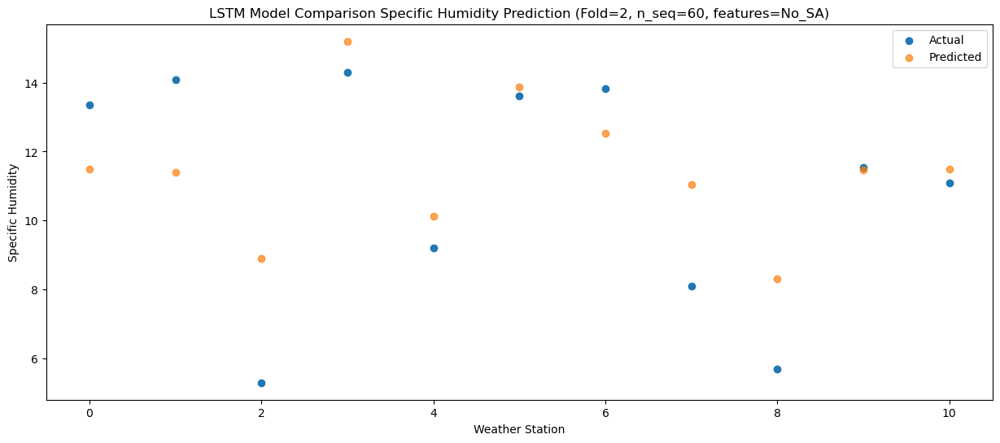

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  10.897804
1                 1   12.65  10.807804
2                 2    5.99   8.297804
3                 3   13.48  14.617804
4                 4    8.47   9.527804
5                 5   12.17  13.277804
6                 6   11.14  11.937804
7                 7    6.37  10.457804
8                 8    6.76   7.727804
9                 9   11.53  10.877804
10               10   10.85  10.897804


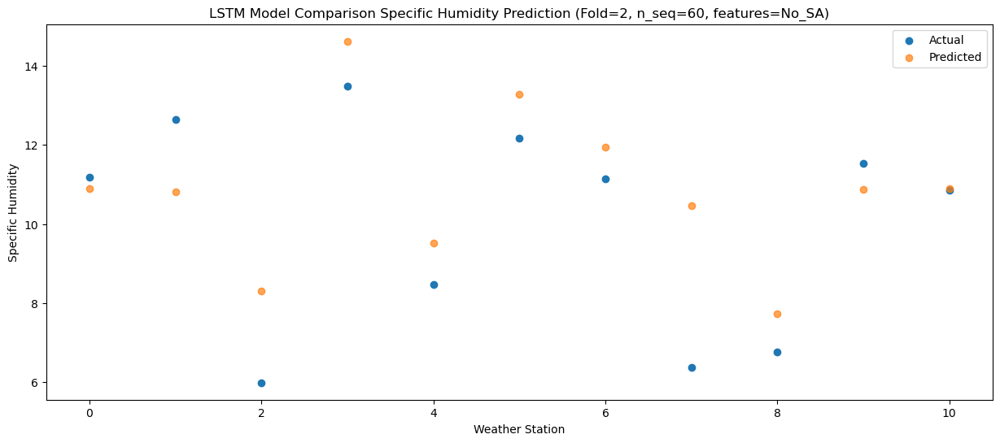

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   8.120072
1                 1    8.59   8.030072
2                 2    5.29   5.520072
3                 3   10.39  11.840072
4                 4    6.67   6.750072
5                 5   10.72  10.500072
6                 6   10.20   9.160072
7                 7    5.72   7.680072
8                 8    4.98   4.950072
9                 9    7.81   8.100072
10               10    8.24   8.120072


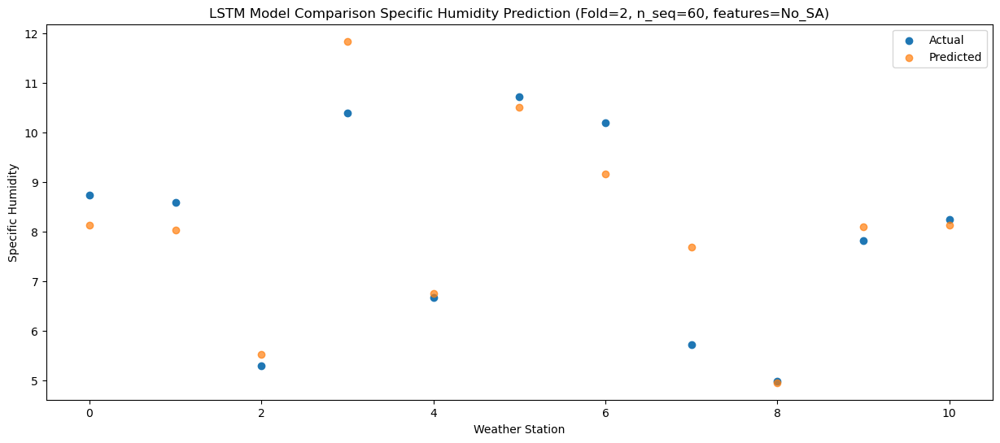

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   5.601112
1                 1    4.86   5.511112
2                 2    2.70   3.001112
3                 3    7.88   9.321112
4                 4    3.46   4.231112
5                 5    6.85   7.981112
6                 6    5.71   6.641112
7                 7    2.65   5.161112
8                 8    3.85   2.431112
9                 9    5.19   5.581112
10               10    5.05   5.601112


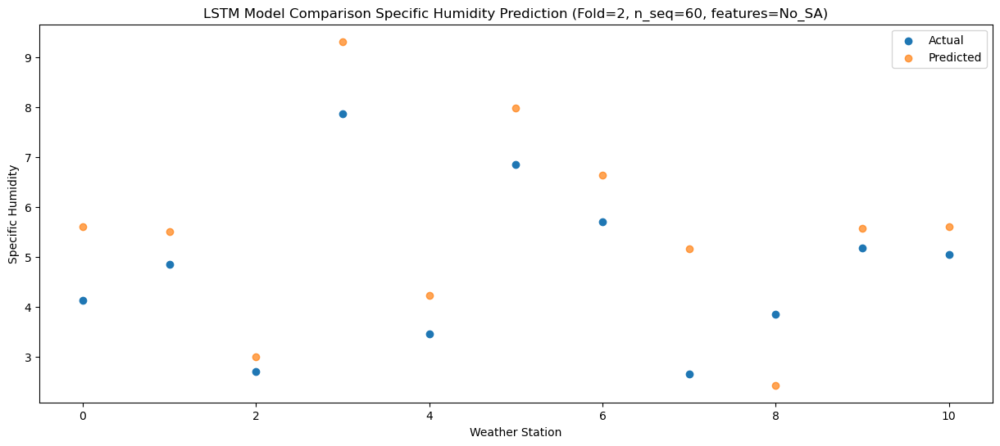

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   3.740752
1                 1    4.64   3.650752
2                 2   -0.25   1.140752
3                 3    6.01   7.460752
4                 4    0.73   2.370752
5                 5    4.79   6.120752
6                 6    4.12   4.780752
7                 7    2.70   3.300752
8                 8    1.61   0.570752
9                 9    2.54   3.720752
10               10    1.93   3.740752


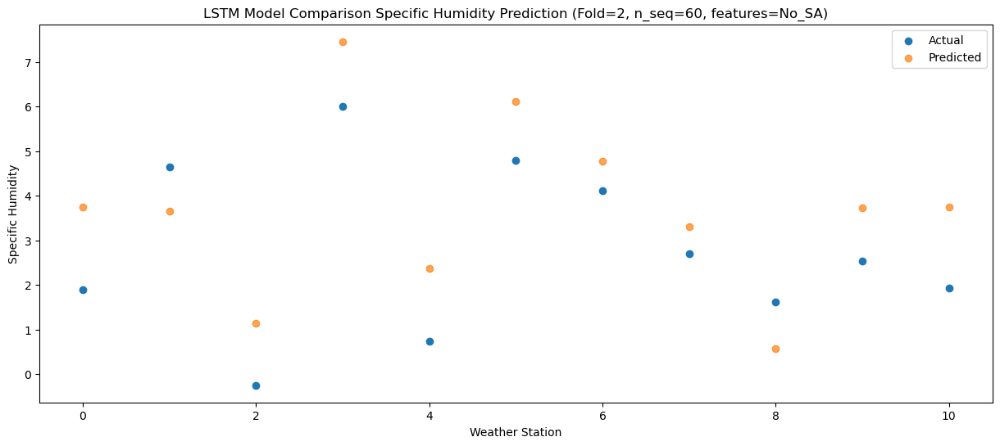

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   1.590356
1                 1    2.91   1.500356
2                 2   -4.92  -1.009644
3                 3    4.09   5.310356
4                 4   -2.55   0.220356
5                 5    2.47   3.970356
6                 6    1.41   2.630356
7                 7    1.44   1.150356
8                 8    0.04  -1.579644
9                 9   -0.68   1.570356
10               10    0.14   1.590356


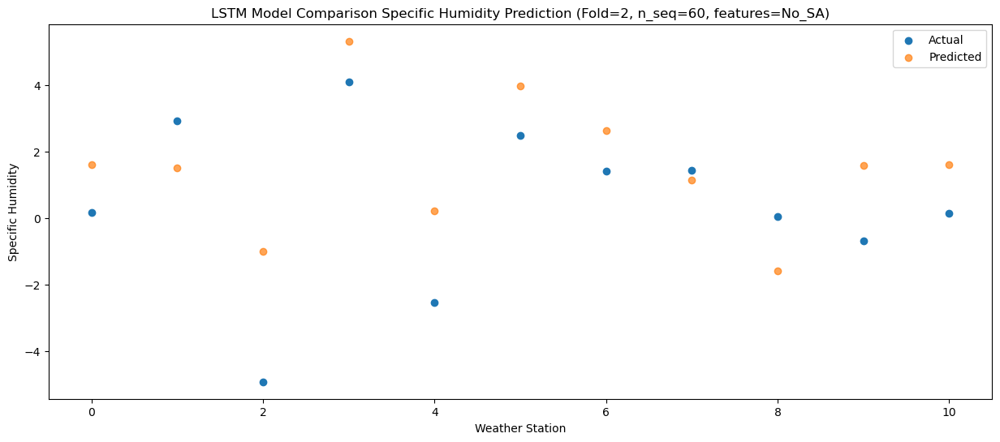

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07   1.043419
1                 1    2.86   0.953419
2                 2   -4.43  -1.556581
3                 3    3.01   4.763419
4                 4   -2.42  -0.326581
5                 5    2.34   3.423419
6                 6    1.31   2.083419
7                 7    1.72   0.603419
8                 8    0.89  -2.126581
9                 9   -0.80   1.023419
10               10    0.15   1.043419


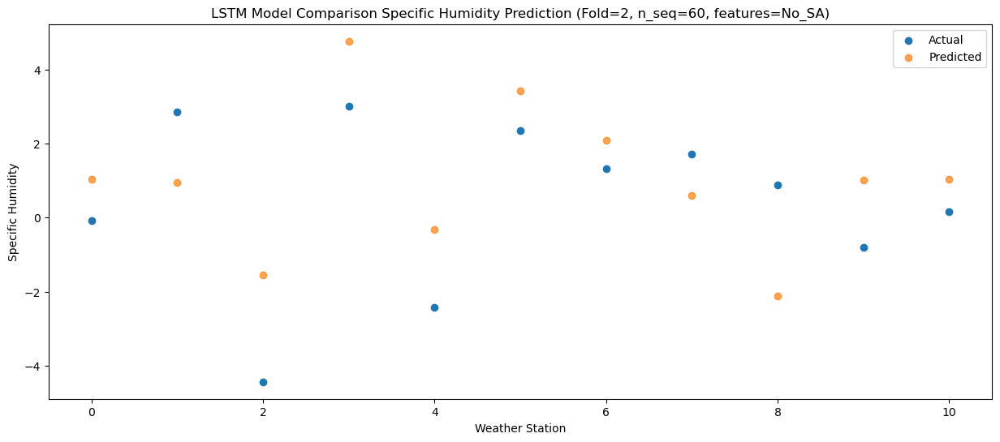

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79   1.081905
1                 1    2.18   0.991905
2                 2   -2.30  -1.518095
3                 3    3.18   4.801905
4                 4   -2.44  -0.288095
5                 5    2.29   3.461905
6                 6    0.98   2.121905
7                 7    1.59   0.641905
8                 8    1.42  -2.088095
9                 9   -0.73   1.061905
10               10    0.39   1.081905


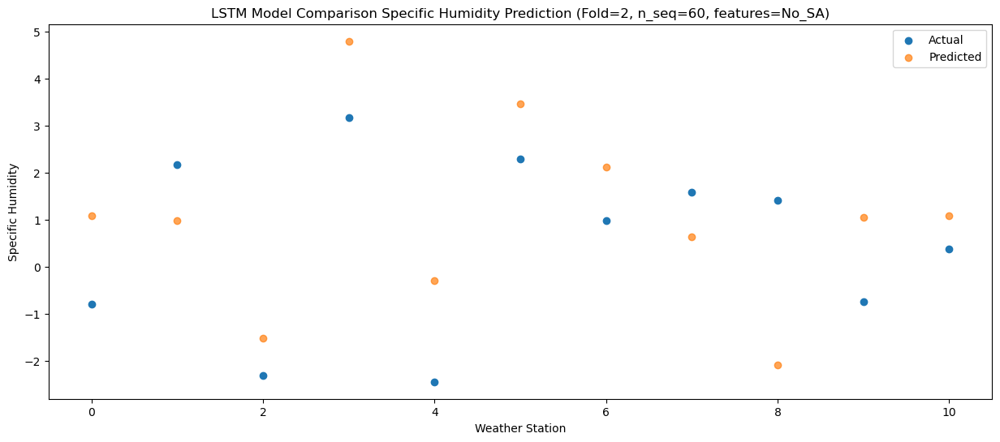

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49    2.18786
1                 1    4.03    2.09786
2                 2   -2.08   -0.41214
3                 3    3.82    5.90786
4                 4    0.85    0.81786
5                 5    5.28    4.56786
6                 6    3.84    3.22786
7                 7    1.68    1.74786
8                 8    1.53   -0.98214
9                 9    1.00    2.16786
10               10    1.42    2.18786


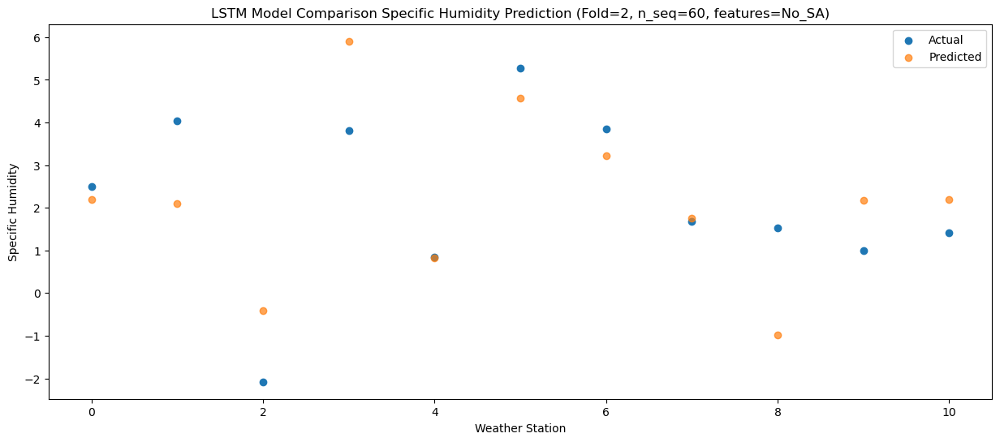

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   3.363503
1                 1    4.15   3.273503
2                 2   -1.11   0.763503
3                 3    5.17   7.083503
4                 4    0.87   1.993503
5                 5    6.85   5.743503
6                 6    5.16   4.403503
7                 7    1.98   2.923503
8                 8    2.85   0.193503
9                 9    1.53   3.343503
10               10    2.03   3.363503


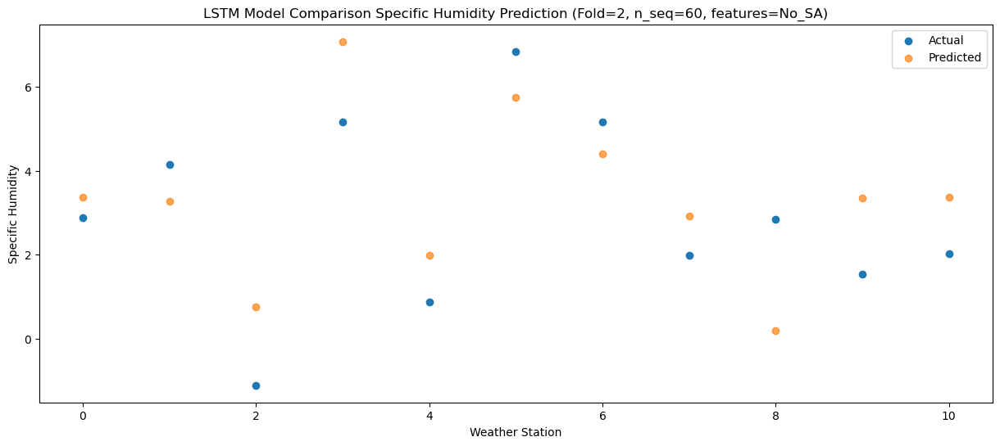

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   6.744831
1                 1    9.27   6.654831
2                 2    0.20   4.144831
3                 3    6.85  10.464831
4                 4    4.07   5.374831
5                 5   11.68   9.124831
6                 6    9.36   7.784831
7                 7    2.10   6.304831
8                 8    4.33   3.574831
9                 9    4.24   6.724831
10               10    4.70   6.744831


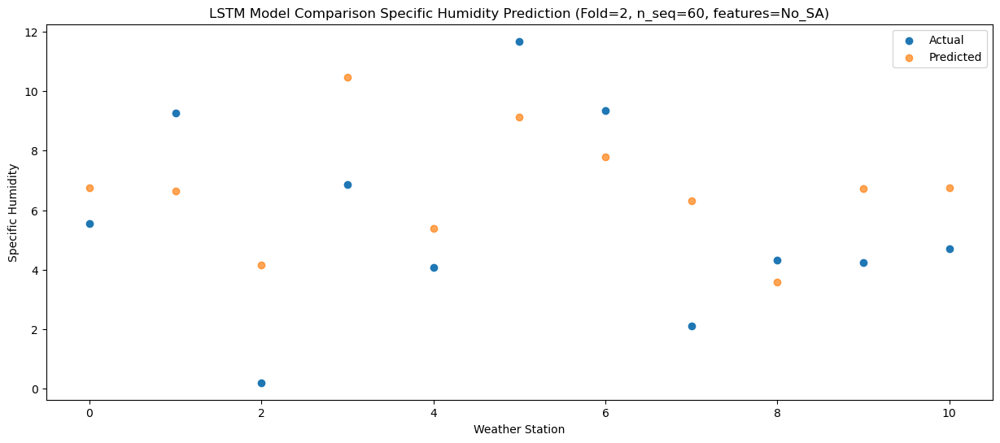

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20  10.436412
1                 1   12.18  10.346412
2                 2    3.98   7.836412
3                 3   11.45  14.156412
4                 4    7.96   9.066412
5                 5   14.32  12.816412
6                 6   13.11  11.476412
7                 7    4.76   9.996412
8                 8    5.58   7.266412
9                 9    8.74  10.416412
10               10    8.80  10.436412


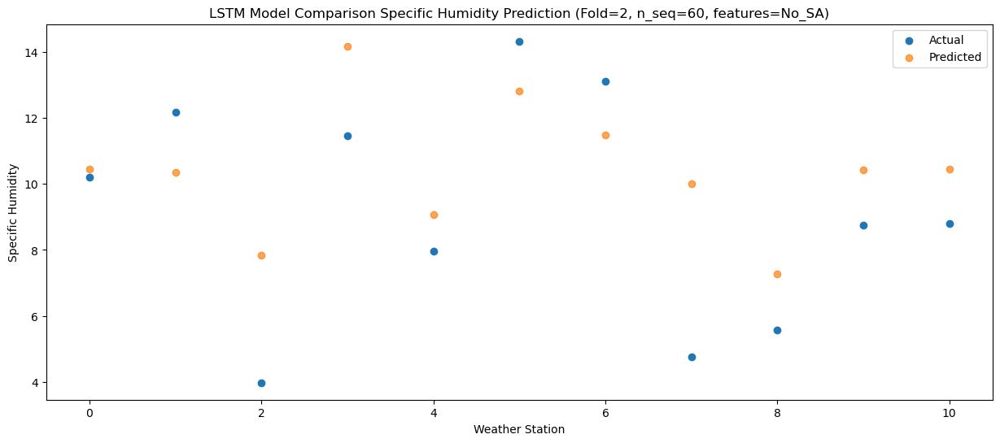

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30  11.877513
1                 1   13.79  11.787513
2                 2    4.38   9.277513
3                 3   14.05  15.597513
4                 4    8.99  10.507513
5                 5   13.28  14.257513
6                 6   13.93  12.917513
7                 7   10.00  11.437513
8                 8    6.73   8.707513
9                 9   10.26  11.857513
10               10   10.21  11.877513


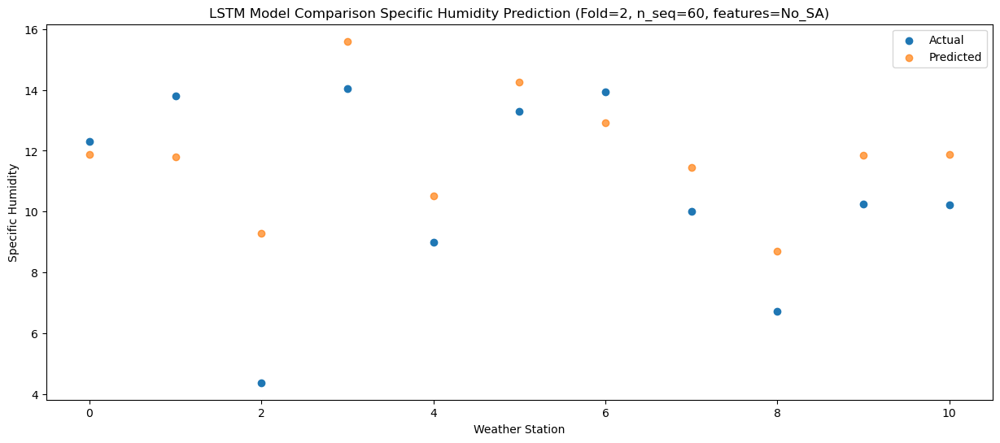

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  11.312782
1                 1   12.17  11.222782
2                 2    5.00   8.712782
3                 3   14.79  15.032782
4                 4    8.59   9.942782
5                 5   13.41  13.692782
6                 6   14.31  12.352782
7                 7   10.29  10.872782
8                 8    6.13   8.142782
9                 9   10.84  11.292782
10               10   10.60  11.312782


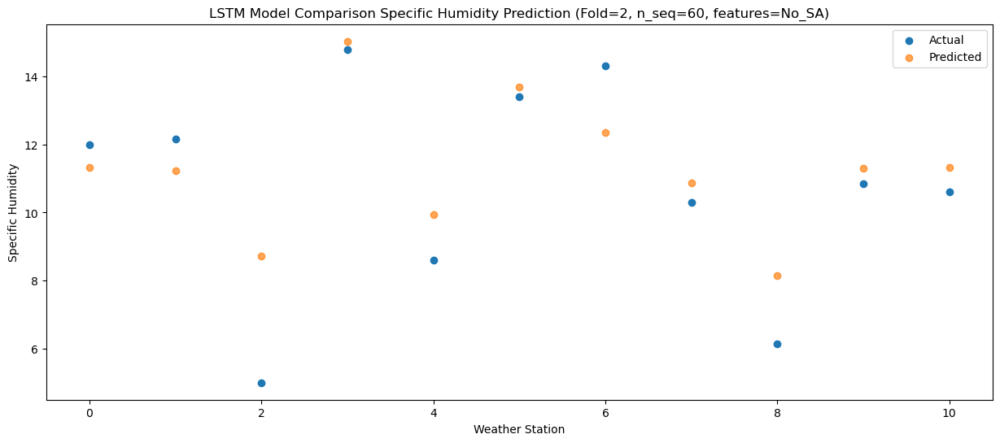

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   9.234551
1                 1    9.35   9.144551
2                 2    3.72   6.634551
3                 3   12.13  12.954551
4                 4    6.45   7.864551
5                 5    9.85  11.614551
6                 6    9.86  10.274551
7                 7    7.53   8.794551
8                 8    5.67   6.064551
9                 9    7.24   9.214551
10               10    7.39   9.234551


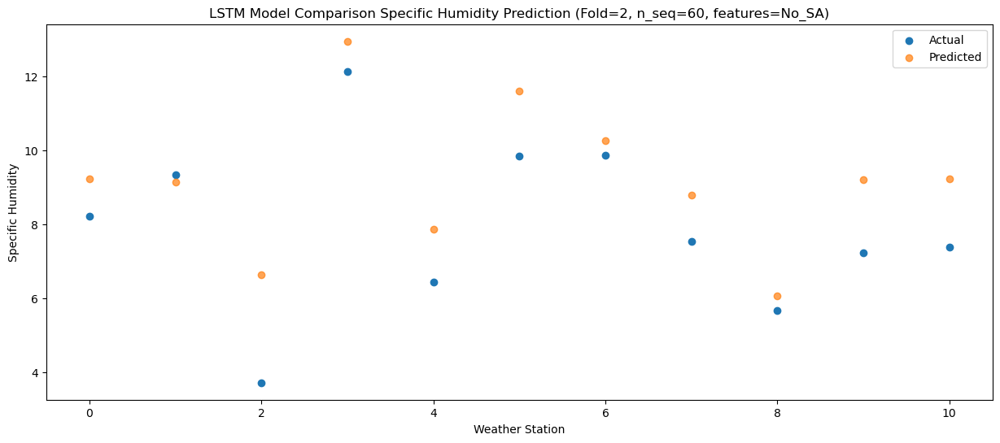

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78     5.7985
1                 1    5.96     5.7085
2                 2    1.06     3.1985
3                 3    9.17     9.5185
4                 4    3.92     4.4285
5                 5    8.26     8.1785
6                 6    7.25     6.8385
7                 7    3.82     5.3585
8                 8    2.87     2.6285
9                 9    5.08     5.7785
10               10    5.66     5.7985


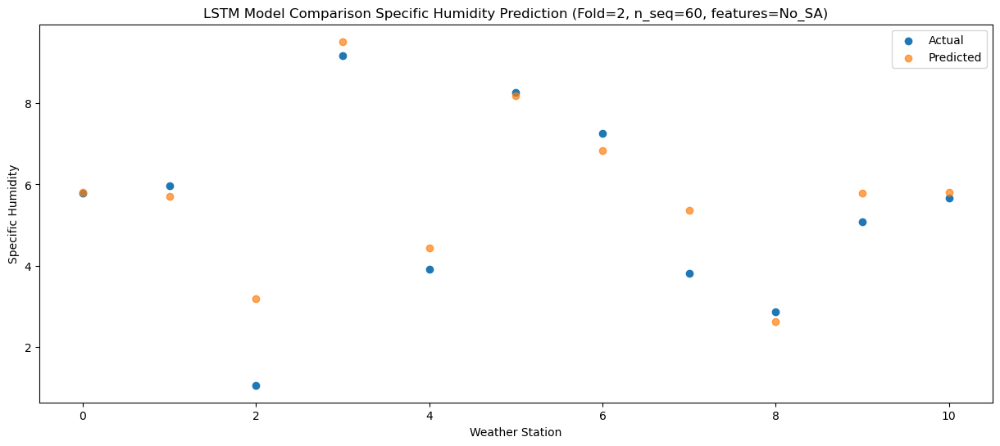

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59   2.528639
1                 1    3.53   2.438639
2                 2   -2.89  -0.071361
3                 3    4.72   6.248639
4                 4   -1.74   1.158639
5                 5    4.07   4.908639
6                 6    3.26   3.568639
7                 7    2.17   2.088639
8                 8    2.33  -0.641361
9                 9   -0.48   2.508639
10               10    0.30   2.528639


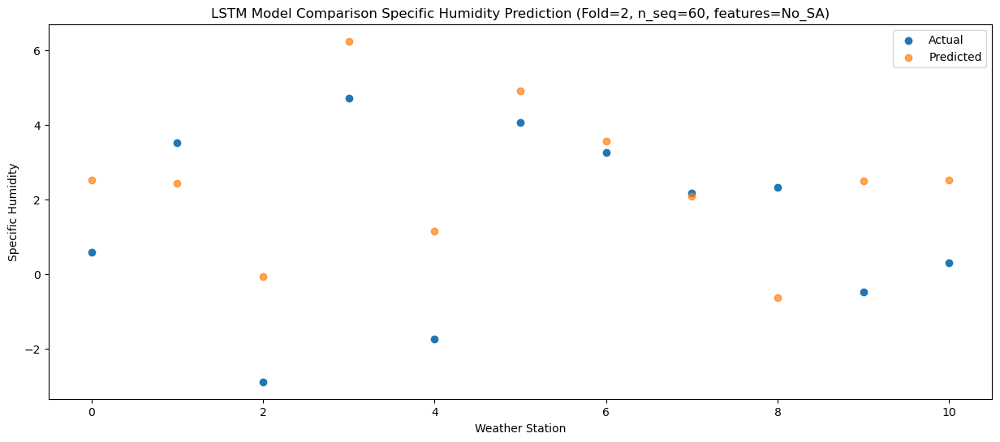

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.535679
1                 1    2.47   2.445679
2                 2   -1.49  -0.064321
3                 3    4.36   6.255679
4                 4    1.54   1.165679
5                 5    6.94   4.915679
6                 6    5.76   3.575679
7                 7    2.30   2.095679
8                 8    2.15  -0.634321
9                 9    1.37   2.515679
10               10    1.86   2.535679


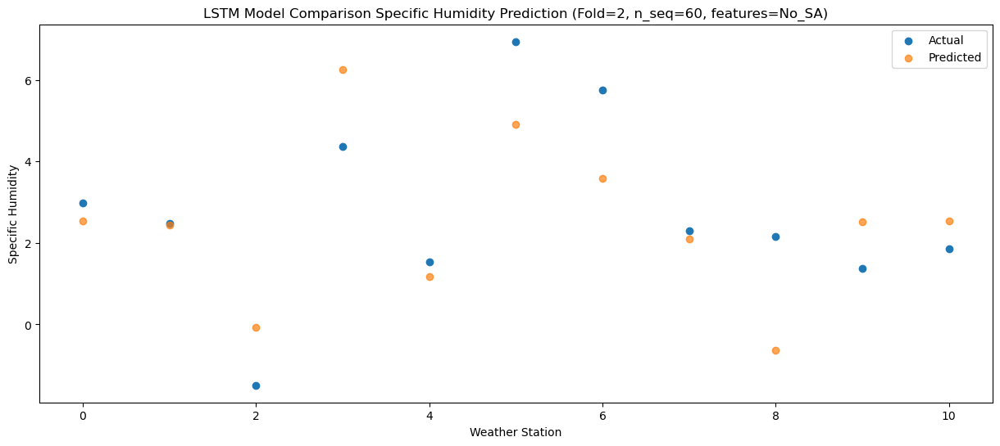

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00   0.999939
1                 1    2.14   0.909939
2                 2   -5.14  -1.600061
3                 3    3.03   4.719939
4                 4   -3.37  -0.370061
5                 5    1.31   3.379939
6                 6    0.47   2.039939
7                 7    2.02   0.559939
8                 8    0.79  -2.170061
9                 9   -1.41   0.979939
10               10   -0.56   0.999939


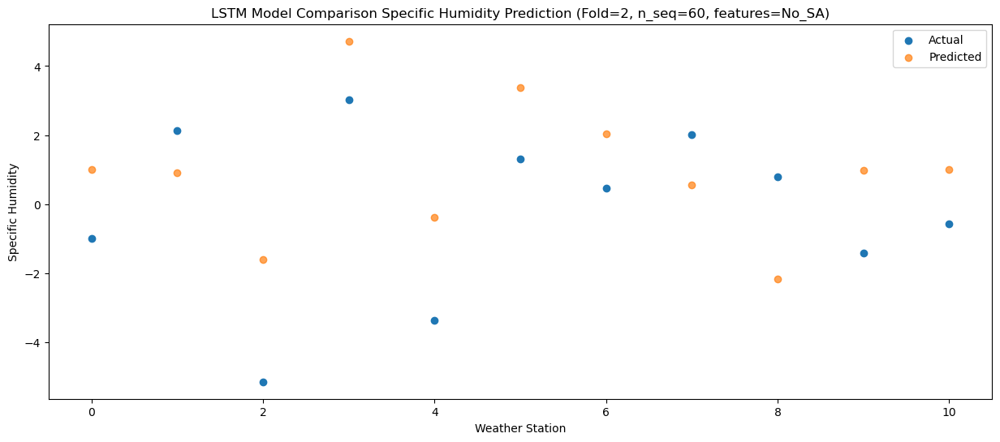

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34   1.352276
1                 1    2.05   1.262276
2                 2   -3.95  -1.247724
3                 3    3.60   5.072276
4                 4   -1.91  -0.017724
5                 5    1.53   3.732276
6                 6    0.94   2.392276
7                 7    1.03   0.912276
8                 8    0.05  -1.817724
9                 9   -0.10   1.332276
10               10    0.34   1.352276


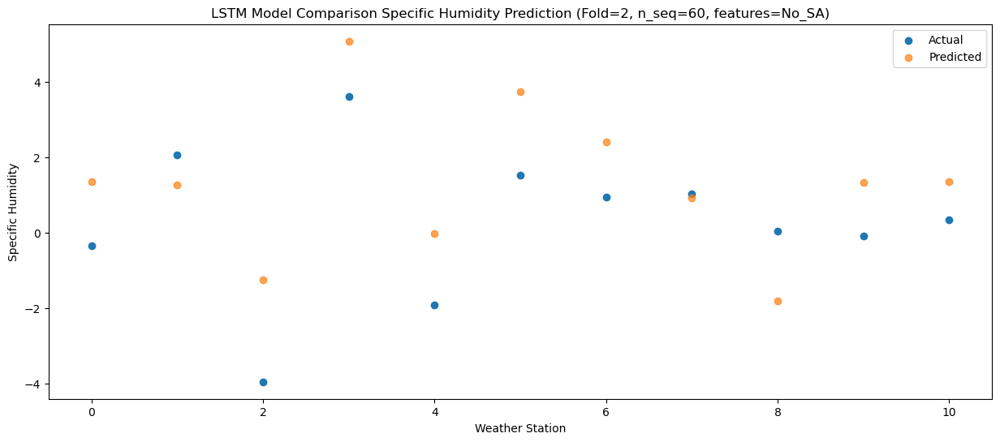

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   2.144187
1                 1    2.93   2.054187
2                 2   -2.14  -0.455813
3                 3    4.36   5.864187
4                 4   -1.06   0.774187
5                 5    3.15   4.524187
6                 6    2.57   3.184187
7                 7    1.43   1.704187
8                 8    1.79  -1.025813
9                 9    0.86   2.124187
10               10    0.96   2.144187


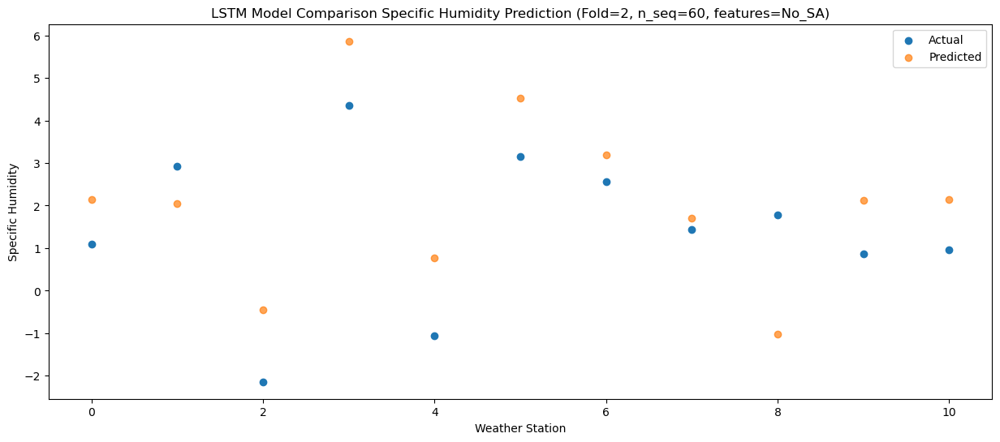

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   3.071311
1                 1    4.08   2.981311
2                 2   -0.78   0.471311
3                 3    5.06   6.791311
4                 4    1.37   1.701311
5                 5    7.11   5.451311
6                 6    6.47   4.111311
7                 7    1.44   2.631311
8                 8    2.63  -0.098689
9                 9    1.90   3.051311
10               10    2.23   3.071311


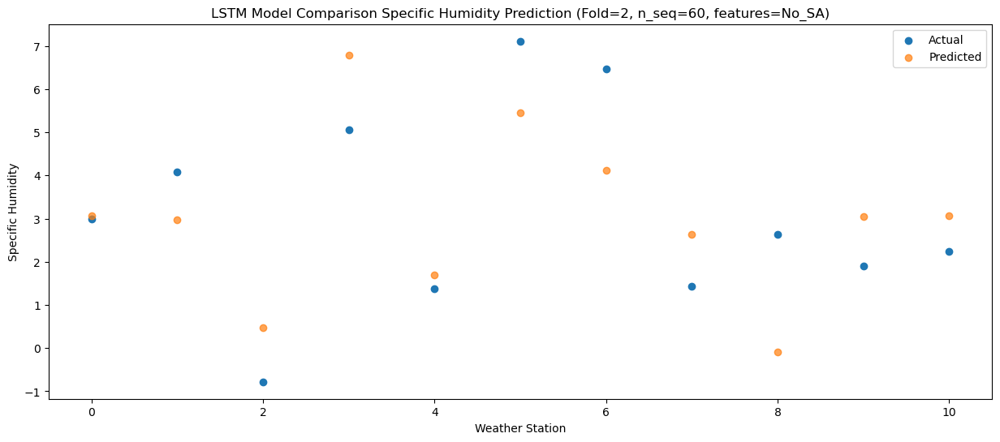

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   6.103324
1                 1    6.47   6.013324
2                 2    2.32   3.503324
3                 3    8.36   9.823324
4                 4    5.40   4.733324
5                 5   10.76   8.483324
6                 6   10.56   7.143324
7                 7    1.37   5.663324
8                 8    3.89   2.933324
9                 9    6.22   6.083324
10               10    6.39   6.103324


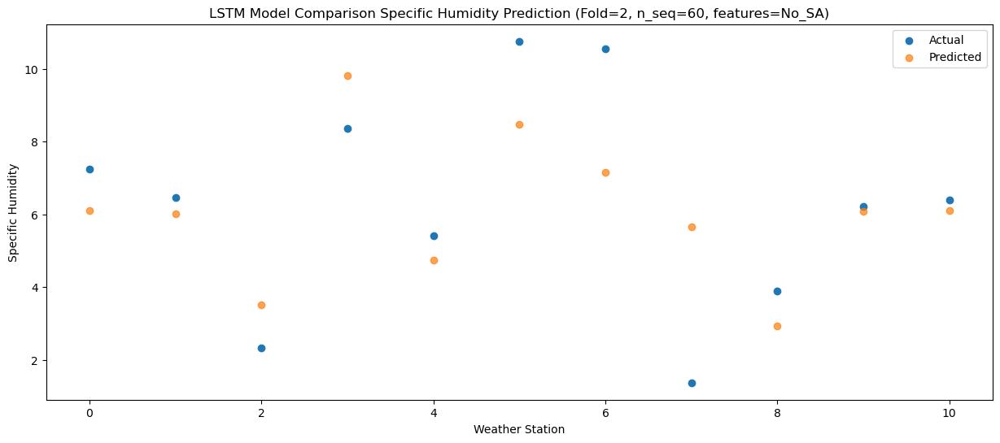

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30   9.657594
1                 1   10.83   9.567594
2                 2    4.25   7.057594
3                 3   10.62  13.377594
4                 4    7.70   8.287594
5                 5   11.79  12.037594
6                 6   11.36  10.697594
7                 7    6.87   9.217594
8                 8    5.66   6.487594
9                 9    8.02   9.637594
10               10    8.35   9.657594


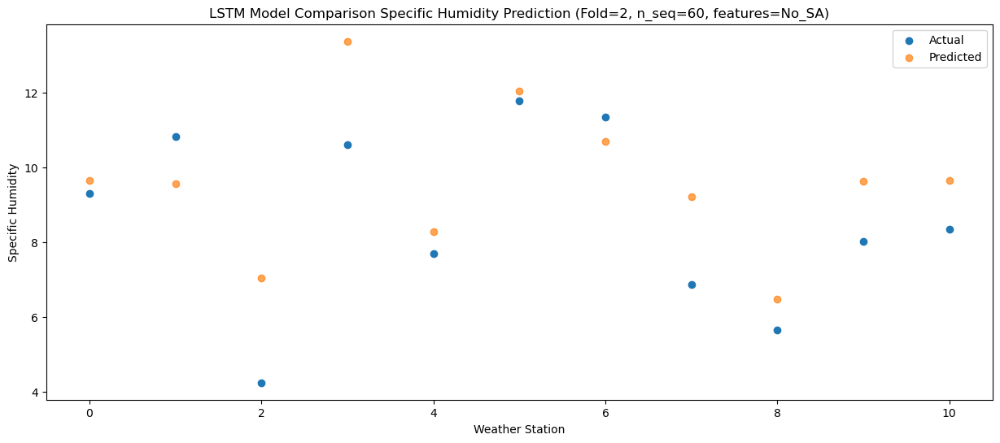

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  11.296229
1                 1   12.17  11.206229
2                 2    5.08   8.696229
3                 3   13.98  15.016229
4                 4    8.99   9.926229
5                 5   12.89  13.676229
6                 6   10.68  12.336229
7                 7    9.43  10.856229
8                 8    6.55   8.126229
9                 9   11.60  11.276229
10               10   11.56  11.296229


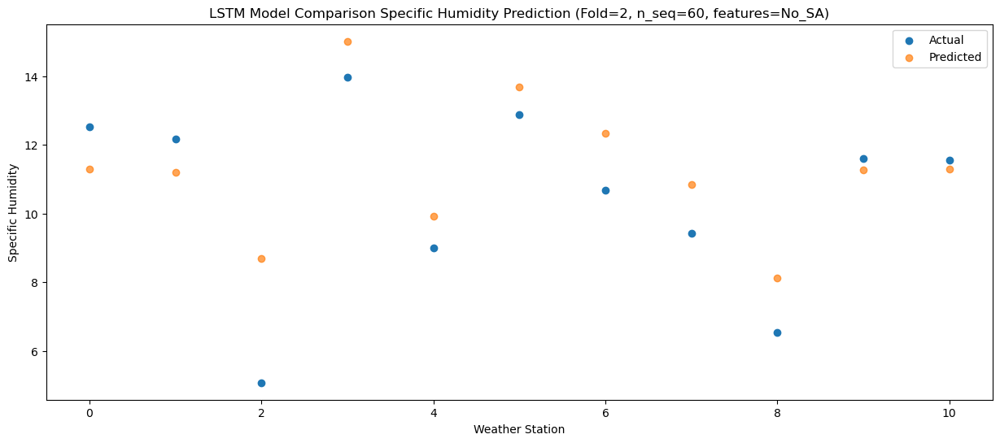

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  11.477257
1                 1   11.67  11.387257
2                 2    4.97   8.877257
3                 3   14.66  15.197257
4                 4    9.39  10.107257
5                 5   13.35  13.857257
6                 6   11.74  12.517257
7                 7   11.40  11.037257
8                 8    6.65   8.307257
9                 9   10.03  11.457257
10               10   10.57  11.477257


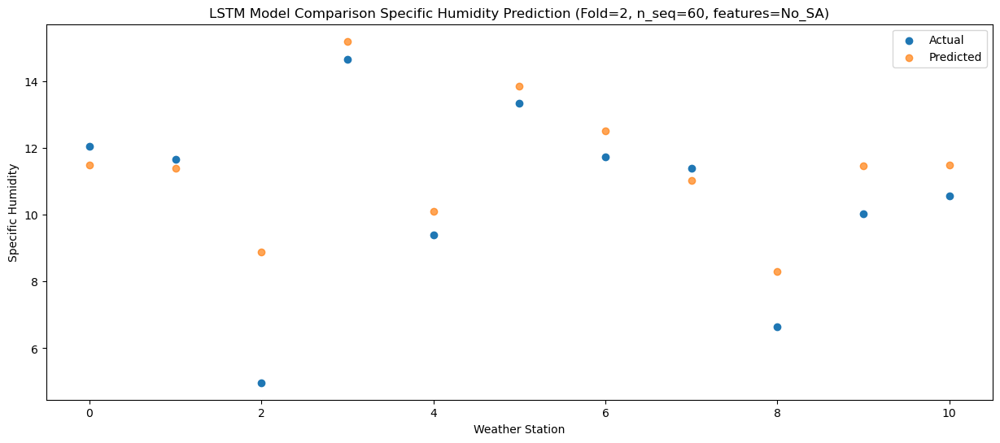

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29   8.571399
1                 1    9.10   8.481399
2                 2    4.82   5.971399
3                 3   10.86  12.291399
4                 4    5.88   7.201399
5                 5    9.99  10.951399
6                 6    9.07   9.611399
7                 7    8.36   8.131399
8                 8    7.50   5.401399
9                 9    6.60   8.551399
10               10    7.09   8.571399


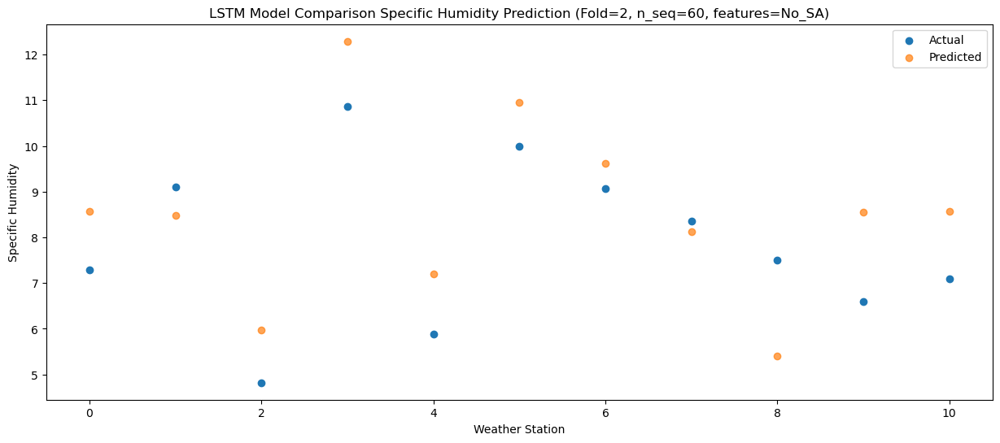

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   5.274954
1                 1    5.42   5.184954
2                 2    0.43   2.674954
3                 3    7.99   8.994954
4                 4    0.70   3.904954
5                 5    5.17   7.654954
6                 6    4.29   6.314954
7                 7    6.28   4.834954
8                 8    5.73   2.104954
9                 9    2.24   5.254954
10               10    2.43   5.274954


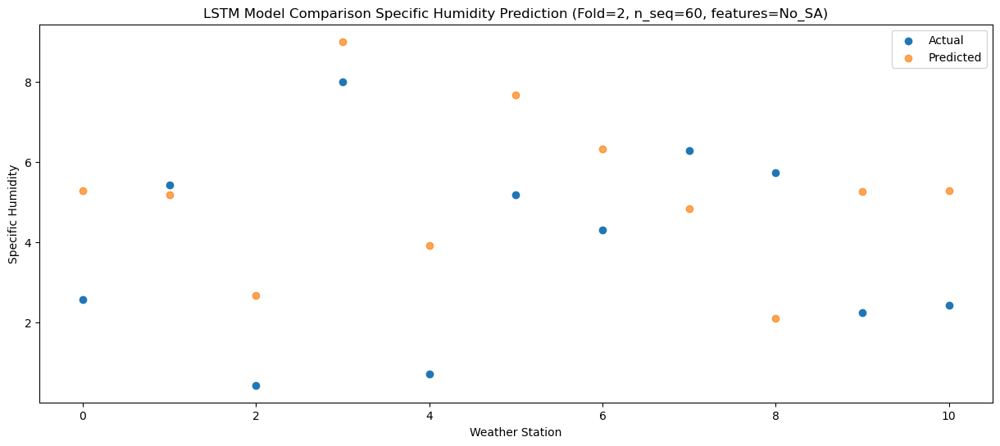

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   3.648722
1                 1    3.92   3.558722
2                 2    0.32   1.048722
3                 3    6.17   7.368722
4                 4    0.26   2.278722
5                 5    5.03   6.028722
6                 6    3.84   4.688722
7                 7    2.31   3.208722
8                 8    1.09   0.478722
9                 9    1.77   3.628722
10               10    1.81   3.648722


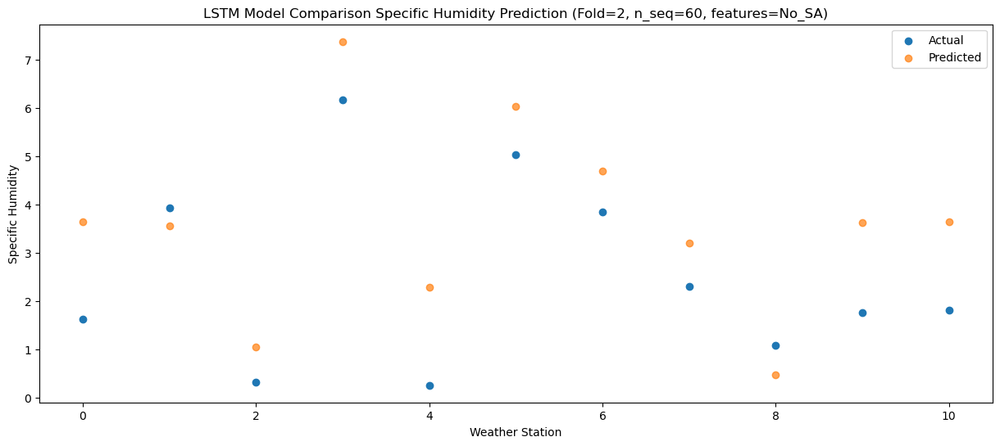

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00   1.958594
1                 1    2.73   1.868594
2                 2   -3.34  -0.641406
3                 3    4.08   5.678594
4                 4   -0.29   0.588594
5                 5    4.12   4.338594
6                 6    2.67   2.998594
7                 7    3.13   1.518594
8                 8    1.94  -1.211406
9                 9   -0.47   1.938594
10               10    0.72   1.958594


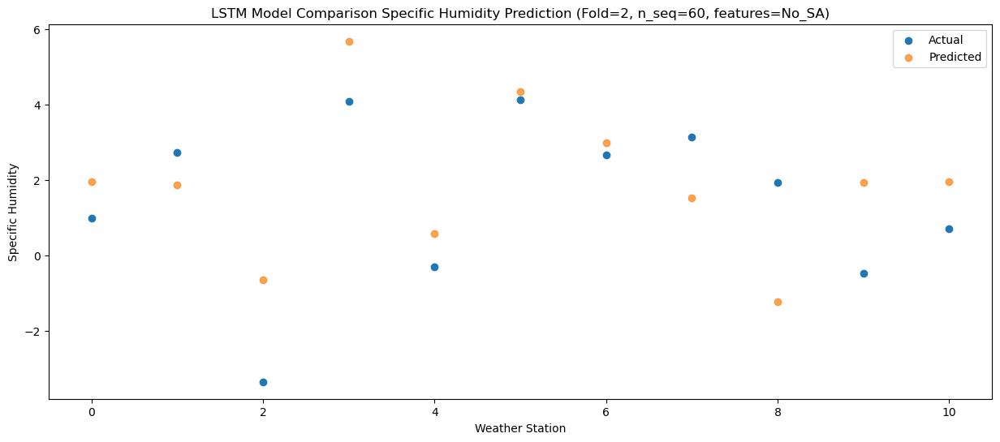

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   2.063728
1                 1    2.72   1.973728
2                 2   -3.72  -0.536272
3                 3    4.59   5.783728
4                 4   -0.38   0.693728
5                 5    3.74   4.443728
6                 6    1.89   3.103728
7                 7    2.24   1.623728
8                 8    2.03  -1.106272
9                 9    0.39   2.043728
10               10    0.99   2.063728


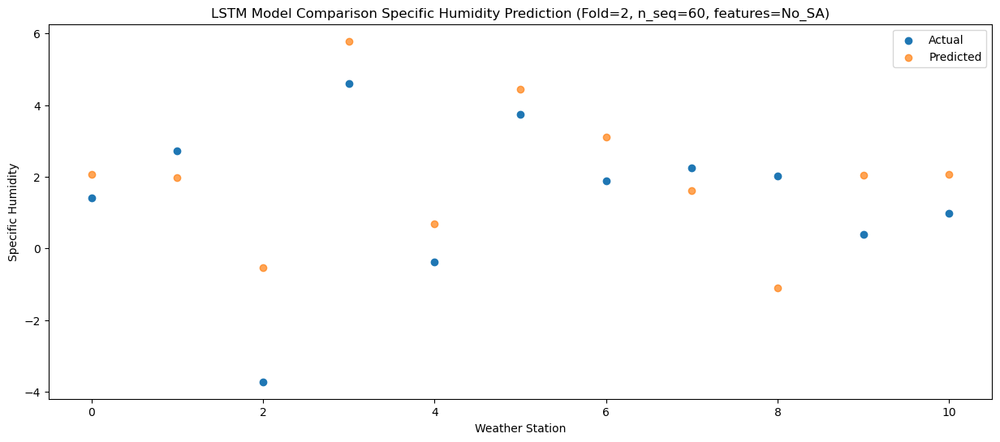

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63    1.93833
1                 1    2.64    1.84833
2                 2   -1.87   -0.66167
3                 3    3.83    5.65833
4                 4    0.92    0.56833
5                 5    4.19    4.31833
6                 6    2.29    2.97833
7                 7    2.12    1.49833
8                 8    0.62   -1.23167
9                 9    1.15    1.91833
10               10    1.39    1.93833


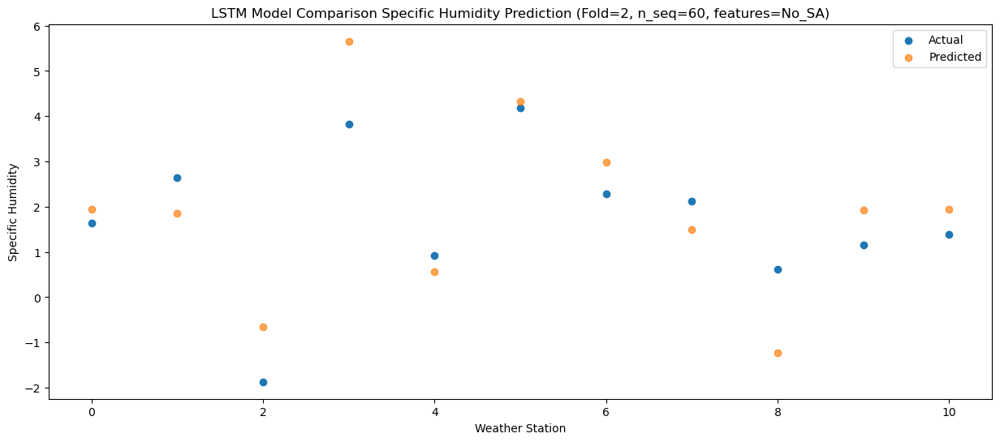

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   2.378073
1                 1    3.33   2.288073
2                 2   -1.48  -0.221927
3                 3    4.08   6.098073
4                 4    1.80   1.008073
5                 5    5.97   4.758073
6                 6    4.20   3.418073
7                 7    2.46   1.938073
8                 8    2.54  -0.791927
9                 9    0.84   2.358073
10               10    0.99   2.378073


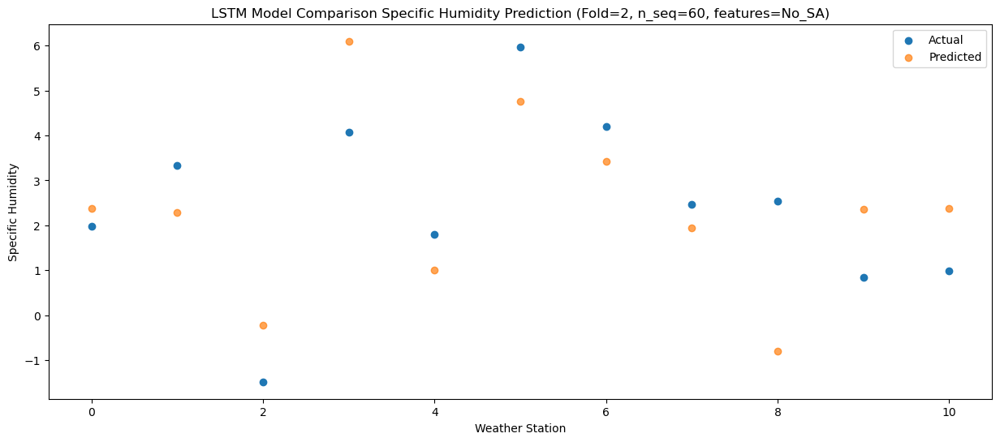

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92    4.20994
1                 1    3.95    4.11994
2                 2    0.03    1.60994
3                 3    6.16    7.92994
4                 4    2.35    2.83994
5                 5    6.52    6.58994
6                 6    4.87    5.24994
7                 7    1.62    3.76994
8                 8    3.24    1.03994
9                 9    2.97    4.18994
10               10    2.63    4.20994


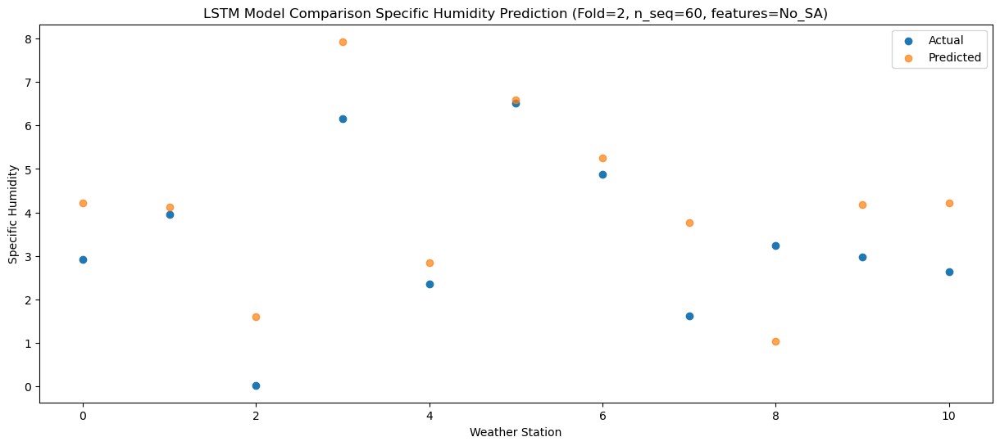

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   7.603087
1                 1    9.73   7.513087
2                 2    0.84   5.003087
3                 3    6.97  11.323087
4                 4    5.41   6.233087
5                 5   10.22   9.983087
6                 6    8.76   8.643087
7                 7    3.62   7.163087
8                 8    4.64   4.433087
9                 9    4.50   7.583087
10               10    5.22   7.603087


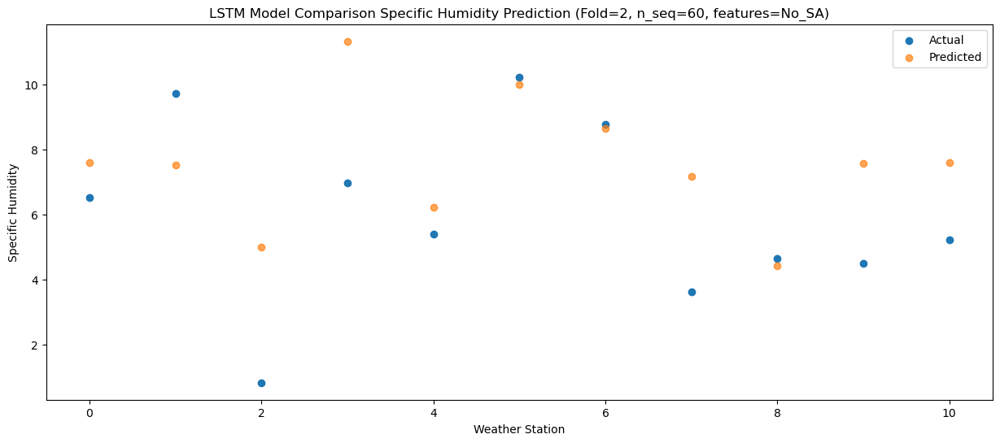

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50  10.061706
1                 1   12.38   9.971706
2                 2    4.00   7.461706
3                 3   10.87  13.781706
4                 4    8.72   8.691706
5                 5   13.68  12.441706
6                 6   12.66  11.101706
7                 7    3.42   9.621706
8                 8    5.02   6.891706
9                 9    7.36  10.041706
10               10    7.06  10.061706


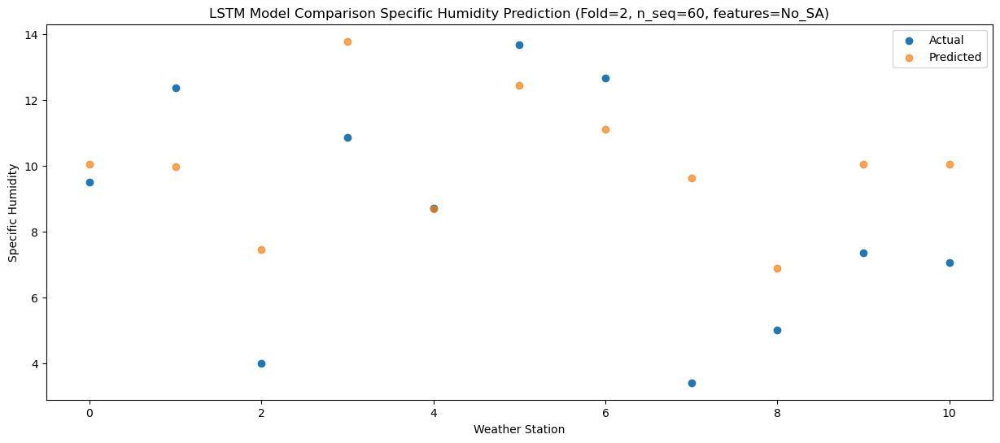

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  12.430276
1                 1   14.44  12.340276
2                 2    4.97   9.830276
3                 3   15.13  16.150276
4                 4   10.06  11.060276
5                 5   13.39  14.810276
6                 6   11.95  13.470276
7                 7    6.77  11.990276
8                 8    6.36   9.260276
9                 9   11.20  12.410276
10               10   10.37  12.430276


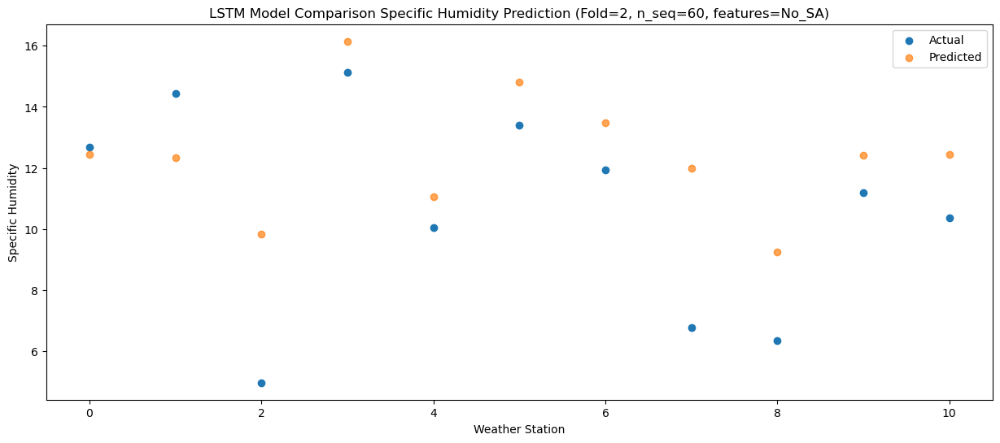

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  11.678323
1                 1   12.55  11.588323
2                 2    5.69   9.078323
3                 3   12.79  15.398323
4                 4   10.09  10.308323
5                 5   11.96  14.058323
6                 6    9.90  12.718323
7                 7    8.96  11.238323
8                 8    6.97   8.508323
9                 9   10.71  11.658323
10               10   10.48  11.678323


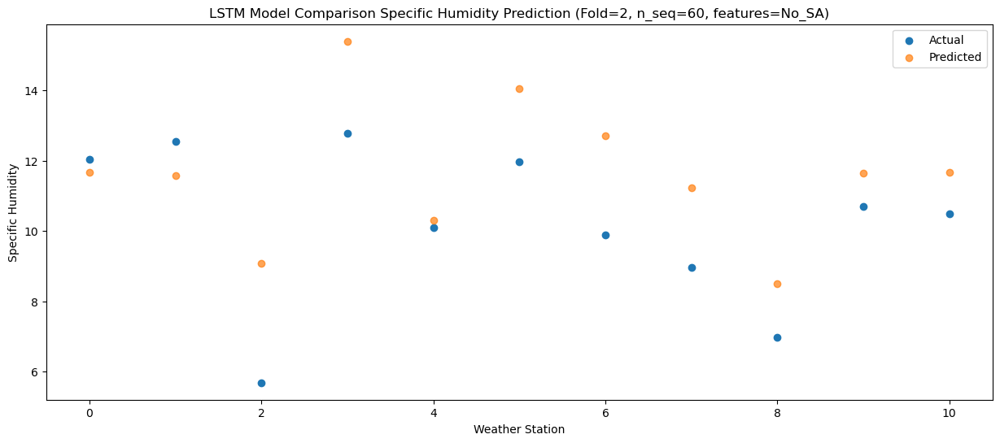

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   9.367657
1                 1    9.96   9.277657
2                 2    3.30   6.767657
3                 3   11.78  13.087657
4                 4    7.74   7.997657
5                 5   11.41  11.747657
6                 6    9.27  10.407657
7                 7    7.15   8.927657
8                 8    6.72   6.197657
9                 9    7.57   9.347657
10               10    8.06   9.367657


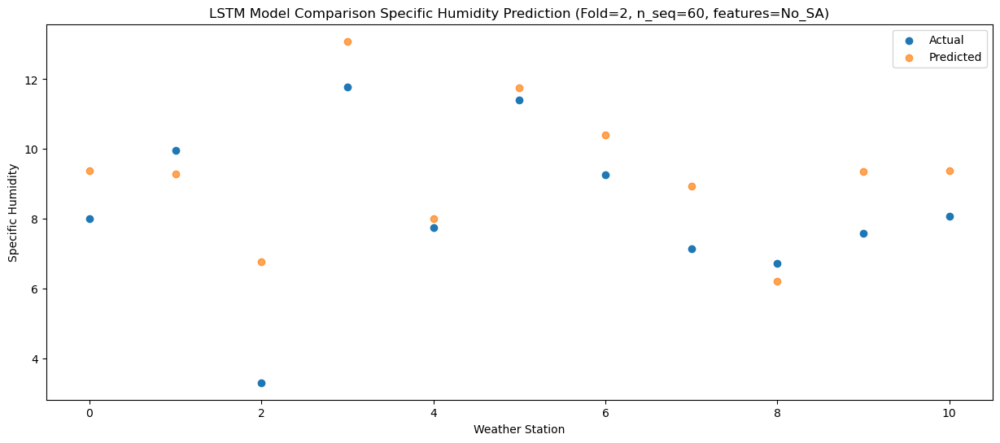

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   6.535913
1                 1    6.50   6.445913
2                 2    0.38   3.935913
3                 3    8.42  10.255913
4                 4    2.51   5.165913
5                 5    7.88   8.915913
6                 6    6.12   7.575913
7                 7    4.70   6.095913
8                 8    4.42   3.365913
9                 9    3.38   6.515913
10               10    3.95   6.535913


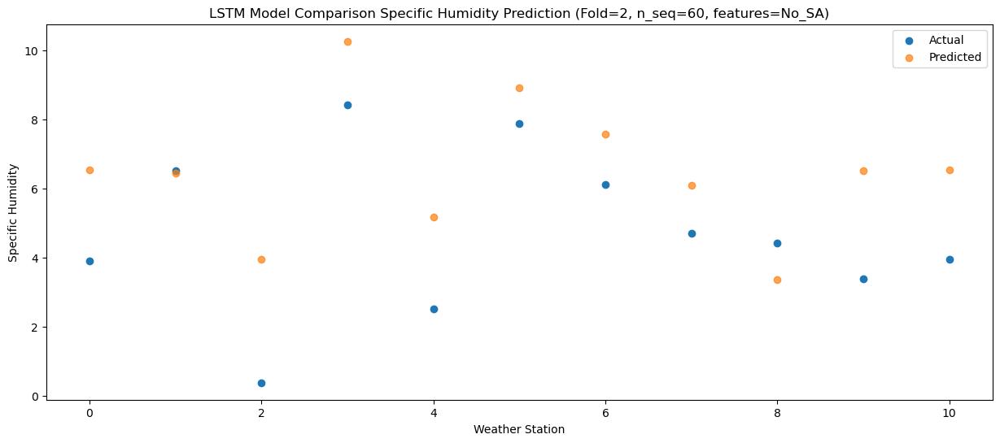

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26    3.33201
1                 1    3.94    3.24201
2                 2   -2.12    0.73201
3                 3    4.59    7.05201
4                 4   -0.01    1.96201
5                 5    4.71    5.71201
6                 6    3.50    4.37201
7                 7    3.78    2.89201
8                 8    1.39    0.16201
9                 9    0.27    3.31201
10               10    1.00    3.33201


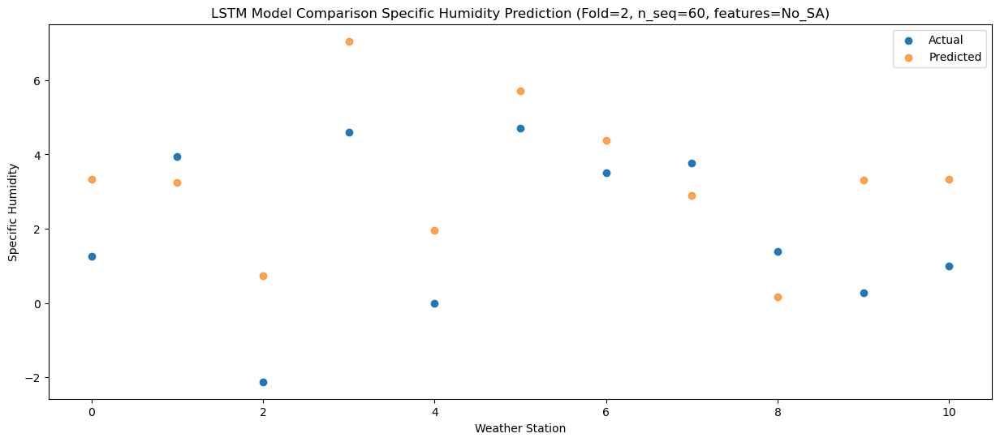

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   2.853705
1                 1    3.55   2.763705
2                 2   -2.69   0.253705
3                 3    4.88   6.573705
4                 4   -1.60   1.483705
5                 5    2.78   5.233705
6                 6    1.68   3.893705
7                 7    2.26   2.413705
8                 8    2.18  -0.316295
9                 9    0.18   2.833705
10               10    0.79   2.853705


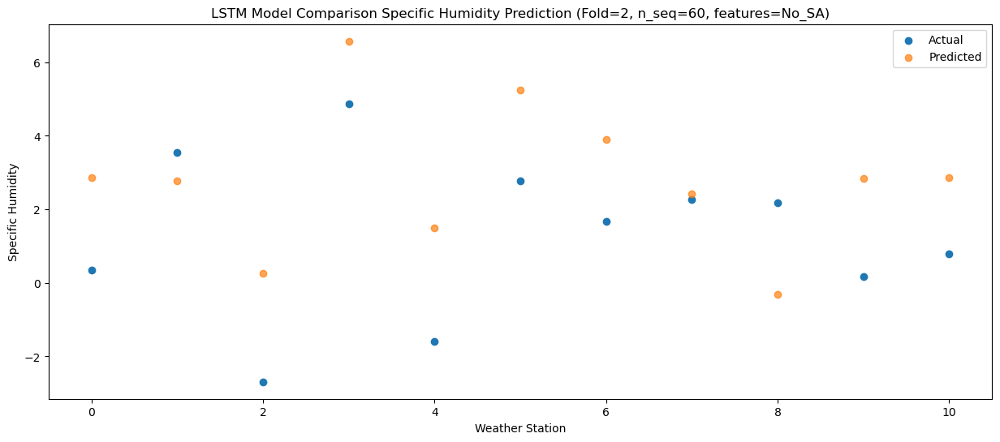

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   1.391086
1                 1    2.96   1.301086
2                 2   -3.76  -1.208914
3                 3    3.55   5.111086
4                 4   -2.47   0.021086
5                 5    1.77   3.771086
6                 6    0.56   2.431086
7                 7    2.68   0.951086
8                 8    2.15  -1.778914
9                 9   -0.51   1.371086
10               10    0.17   1.391086


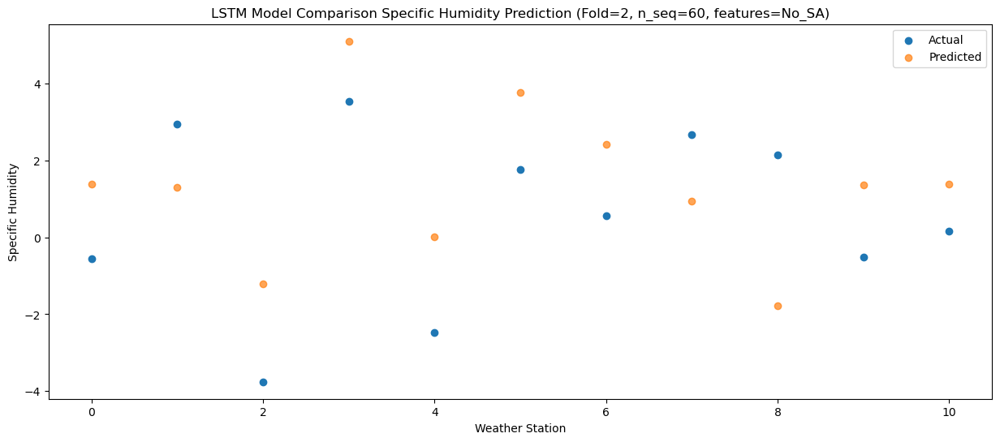

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   1.397686
1                 1    3.78   1.307686
2                 2   -4.18  -1.202314
3                 3    3.50   5.117686
4                 4   -1.41   0.027686
5                 5    4.17   3.777686
6                 6    3.03   2.437686
7                 7    2.70   0.957686
8                 8    3.12  -1.772314
9                 9   -0.37   1.377686
10               10    0.57   1.397686


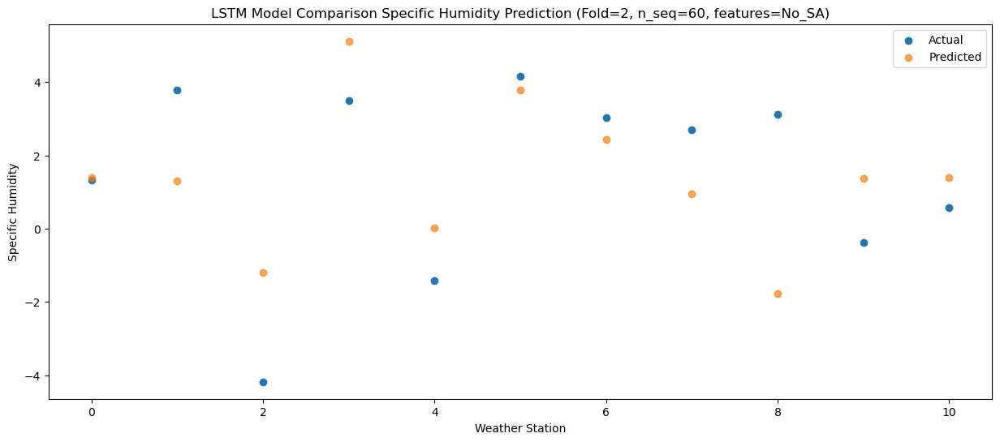

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14    2.27122
1                 1    4.03    2.18122
2                 2   -1.02   -0.32878
3                 3    4.55    5.99122
4                 4    0.19    0.90122
5                 5    5.81    4.65122
6                 6    4.65    3.31122
7                 7    2.92    1.83122
8                 8    1.56   -0.89878
9                 9    1.04    2.25122
10               10    1.67    2.27122


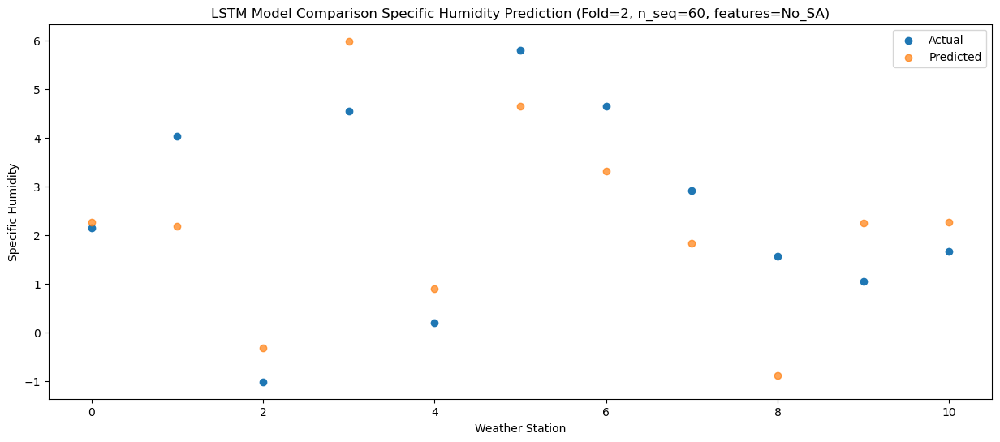

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35     3.3683
1                 1    4.99     3.2783
2                 2   -2.23     0.7683
3                 3    5.44     7.0883
4                 4    2.26     1.9983
5                 5    8.09     5.7483
6                 6    6.85     4.4083
7                 7    2.25     2.9283
8                 8    0.66     0.1983
9                 9    3.26     3.3483
10               10    3.78     3.3683


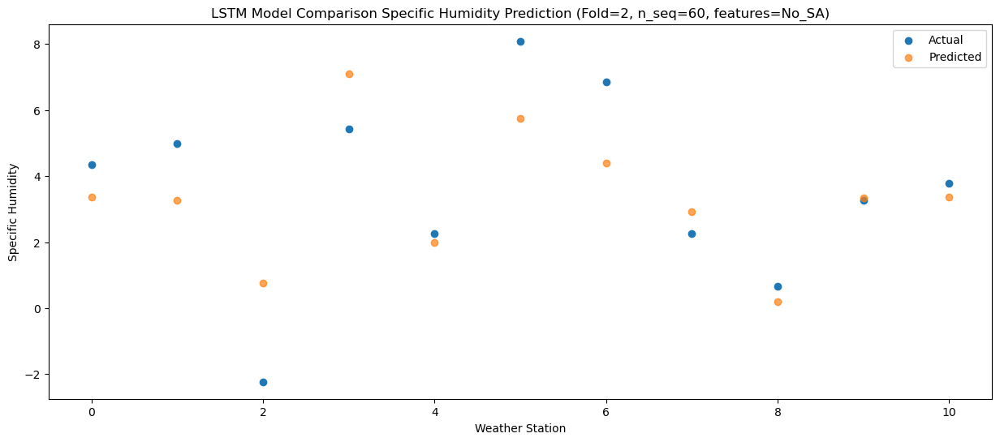

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   6.655486
1                 1    8.02   6.565486
2                 2    2.63   4.055486
3                 3    8.62  10.375486
4                 4    6.69   5.285486
5                 5   12.19   9.035486
6                 6   10.63   7.695486
7                 7    1.94   6.215486
8                 8    4.76   3.485486
9                 9    7.14   6.635486
10               10    7.64   6.655486


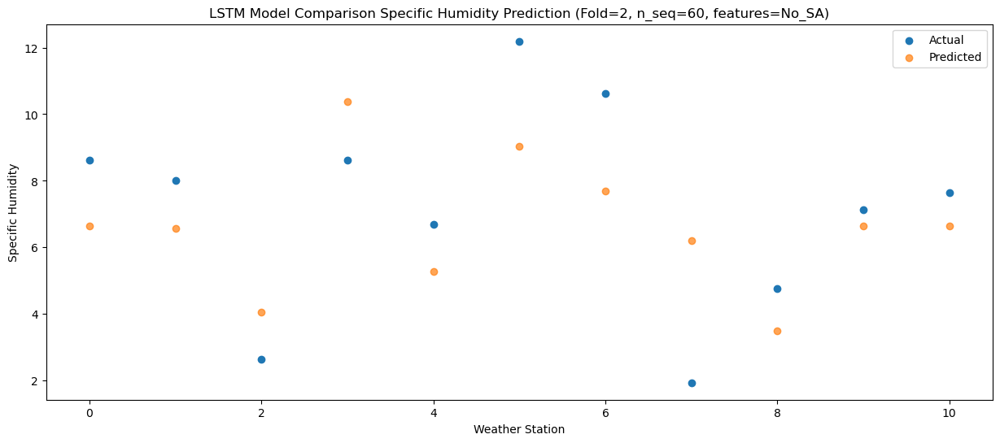

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58  10.481903
1                 1   14.03  10.391903
2                 2    4.69   7.881903
3                 3   11.54  14.201903
4                 4    8.66   9.111903
5                 5   13.85  12.861903
6                 6   12.22  11.521903
7                 7    5.99  10.041903
8                 8    6.36   7.311903
9                 9    9.01  10.461903
10               10    9.19  10.481903


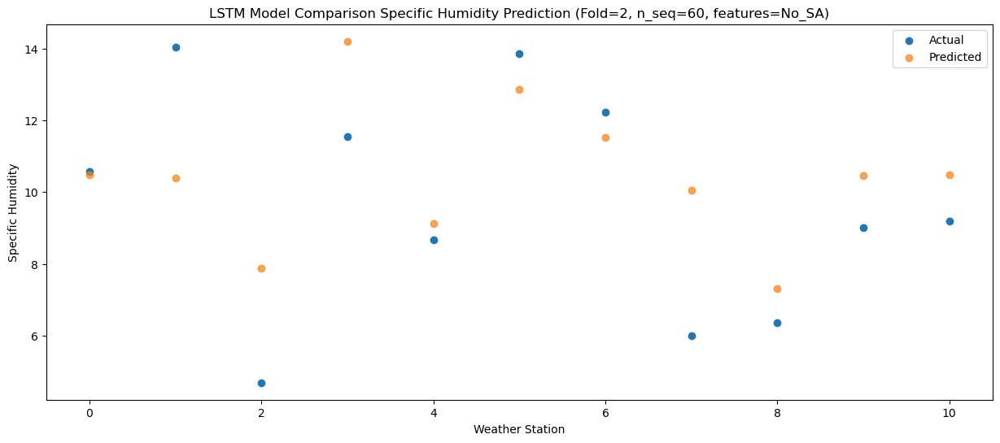

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  12.064346
1                 1   12.58  11.974346
2                 2    5.74   9.464346
3                 3   14.71  15.784346
4                 4   10.30  10.694346
5                 5   14.15  14.444346
6                 6   12.45  13.104346
7                 7    9.59  11.624346
8                 8    7.59   8.894346
9                 9   11.62  12.044346
10               10   11.23  12.064346


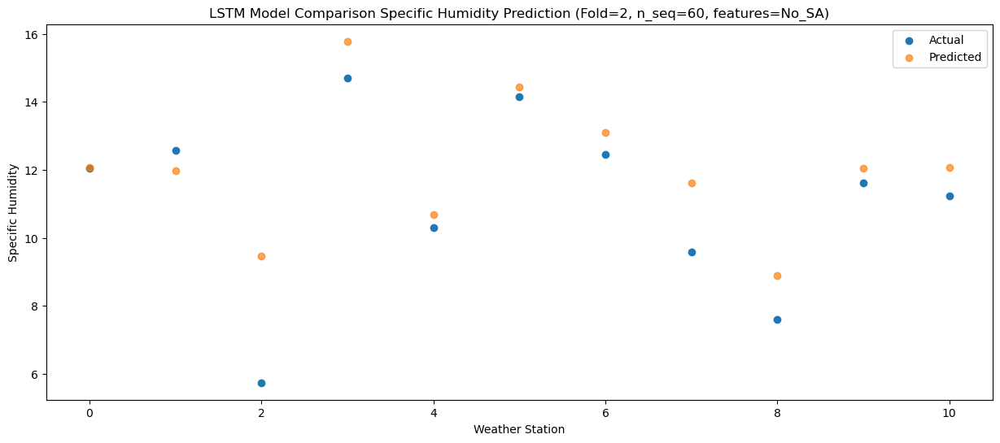

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05  11.204199
1                 1   13.56  11.114199
2                 2    6.34   8.604199
3                 3   13.21  14.924199
4                 4    9.13   9.834199
5                 5   14.19  13.584199
6                 6   12.27  12.244199
7                 7    9.27  10.764199
8                 8    6.77   8.034199
9                 9   10.36  11.184199
10               10   10.22  11.204199


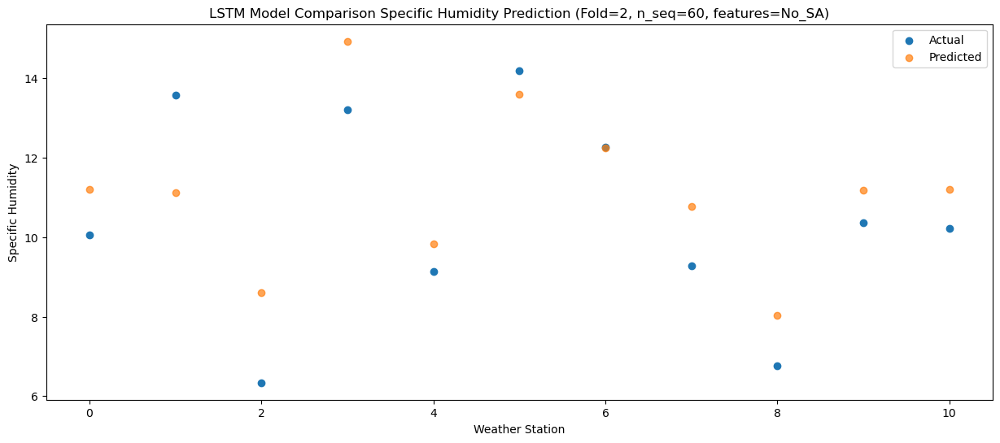

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   8.897706
1                 1    9.61   8.807706
2                 2    6.77   6.297706
3                 3   10.32  12.617706
4                 4    7.53   7.527706
5                 5   11.70  11.277706
6                 6    9.37   9.937706
7                 7    6.53   8.457706
8                 8    6.38   5.727706
9                 9    8.51   8.877706
10               10    8.12   8.897706


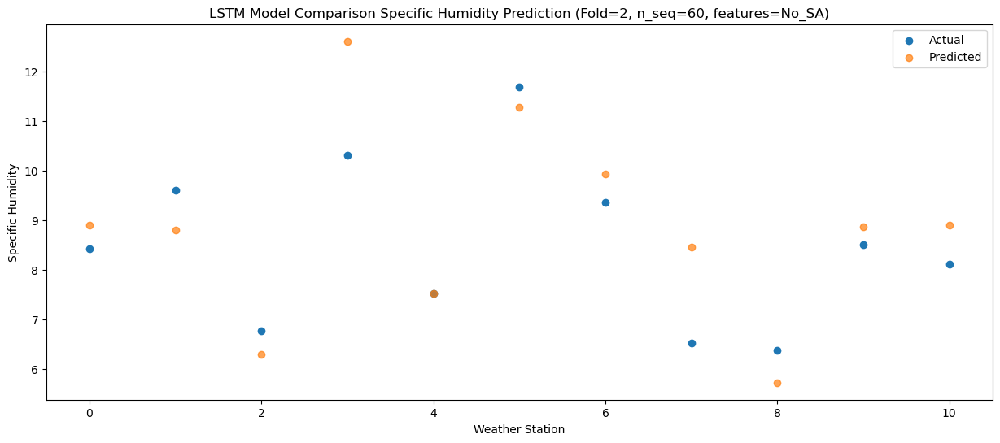

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   5.343045
1                 1    6.75   5.253045
2                 2    1.79   2.743045
3                 3    7.08   9.063045
4                 4    2.67   3.973045
5                 5    7.38   7.723045
6                 6    5.95   6.383045
7                 7    3.64   4.903045
8                 8    4.48   2.173045
9                 9    3.89   5.323045
10               10    4.05   5.343045


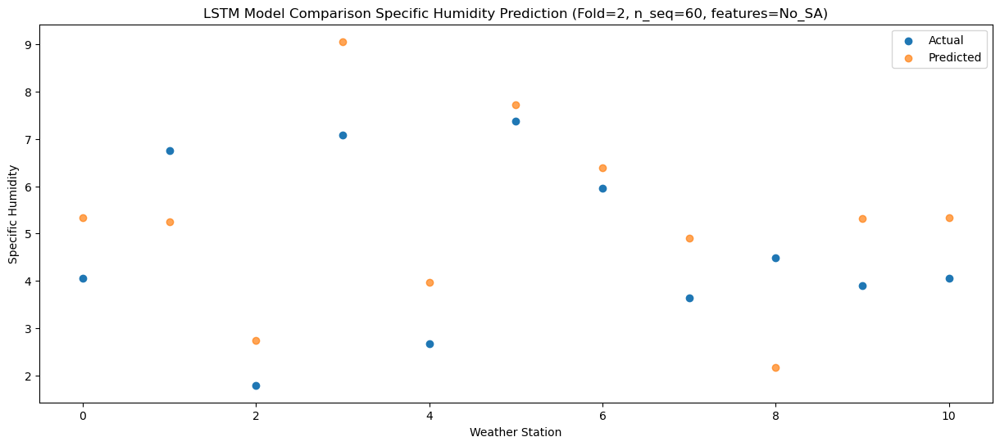

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

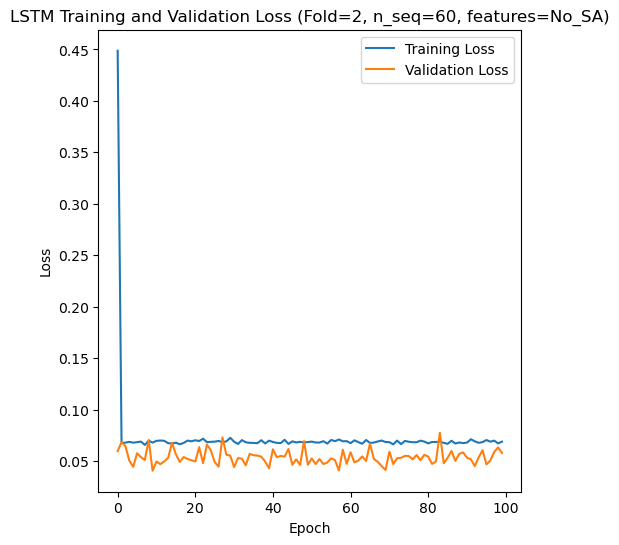

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 46s 242ms/step - loss: 0.5505 - accuracy: 0.2857 - mae: 0.4918 - rmse: 0.5505 - mape: 110.7579 - pearson: 0.6050 - val_loss: 0.0645 - val_accuracy: 0.6000 - val_mae: 0.0498 - val_rmse: 0.0645 - val_mape: 11.0457 - val_pearson: 0.7060
Epoch 2/100
84/84 [==============================] - 14s 166ms/step - loss: 0.0667 - accuracy: 0.4643 - mae: 0.0523 - rmse: 0.0667 - mape: 11.9984 - pearson: 0.7874 - val_loss: 0.0757 - val_accuracy: 0.6000 - val_mae: 0.0592 - val_rmse: 0.0757 - val_mape: 12.7979 - val_pearson: 0.6731
Epoch 3/100
84/84 [==============================] - 14s 167ms/step - loss: 0.0650 - accuracy: 0.4643 - mae: 0.0513 - rmse: 0.0650 - mape: 11.6665 - pearson: 0.798

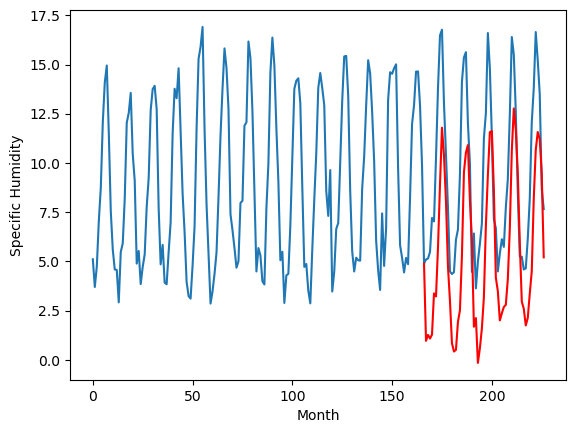

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		2.37		0.13
1.83		2.67		0.84
1.80		2.48		0.68
1.44		2.69		1.25
4.04		4.78		0.74
4.19		4.62		0.43
7.16		7.10		-0.06
10.69		10.28		-0.41
13.43		13.19		-0.24
10.76		11.79		1.03
9.32		9.44		0.12
4.75		6.13		1.38
3.25		4.40		1.15
1.21		2.25		1.04
1.12		1.83		0.71
0.56		1.91		1.35
3.07		3.33		0.26
4.24		3.92		-0.32
7.76		6.68		-1.08
12.29		10.93		-1.36
13.17		11.93		-1.24
13.34		12.31		-1.03
9.37		9.51		0.14
7.18		7.46		0.28
2.75		3.08		0.33
3.72		3.52		-0.20
0.53		1.24		0.71
0.90		1.99		1.09
2.37		3.00		0.63
4.67		4.56		-0.11
9.12		8.21		-0.91
11.74		10.78		-0.96
11.95		12.97		1.02
12.56		13.02		0.46
8.71		10.06		1.35
4.25		5.57		1.32
3.22		4.89		1.67
2.03		3.40		1.37
1.95		3.77		1.82
2.11		4.08		1.97
3.05		4.20		1.15
3.92		5.50		1.58
8.33		8.07		-0.26
10.97		12.04		1.07
13.24		14.17		0.93
13.48		13.08		-0.40
9.41		10.88		1.47
5.97		7.34		1.37
3.09		4.36		1.27
2.27		4.00		1.73
0.96		3.15		2.1

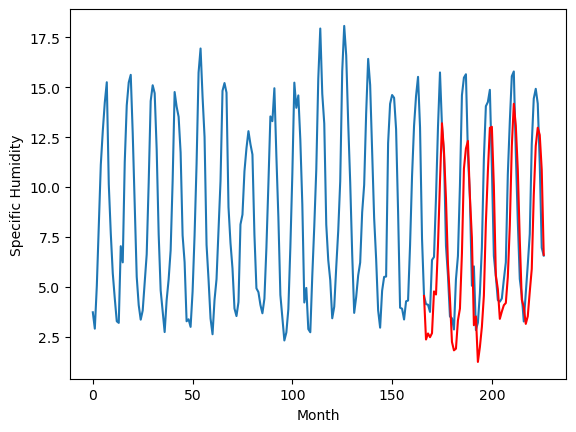

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		0.99		-2.80
4.33		1.29		-3.04
3.95		1.10		-2.85
3.26		1.31		-1.95
4.34		3.40		-0.94
5.71		3.24		-2.47
5.52		5.72		0.20
7.06		8.90		1.84
7.28		11.81		4.53
8.80		10.41		1.61
8.32		8.06		-0.26
6.44		4.75		-1.69
3.75		3.02		-0.73
3.15		0.87		-2.28
3.59		0.45		-3.14
3.53		0.53		-3.00
3.61		1.95		-1.66
4.23		2.54		-1.69
4.63		5.30		0.67
7.08		9.55		2.47
7.78		10.55		2.77
7.31		10.93		3.62
6.02		8.13		2.11
4.88		6.08		1.20
5.46		1.70		-3.76
3.96		2.14		-1.82
3.68		-0.14		-3.82
2.90		0.61		-2.29
4.24		1.62		-2.62
3.91		3.18		-0.73
4.09		6.83		2.74
5.26		9.40		4.14
6.43		11.59		5.16
7.22		11.64		4.42
6.93		8.68		1.75
5.76		4.19		-1.57
3.04		3.51		0.47
3.88		2.02		-1.86
4.03		2.39		-1.64
2.90		2.70		-0.20
4.42		2.82		-1.60
4.62		4.12		-0.50
5.56		6.69		1.13
6.33		10.66		4.33
7.43		12.79		5.36
8.50		11.70		3.20
6.96		9.50		2.54
5.80		5.96		0.16
3.69		2.98		-0.71
3.92		2.62		-1.30
4.46		1.77		-2.69

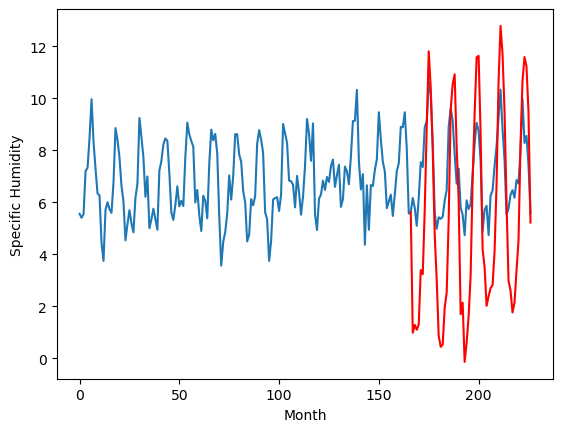

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		2.82		1.80
1.55		3.12		1.57
1.15		2.93		1.78
0.97		3.14		2.17
2.83		5.23		2.40
2.75		5.07		2.32
6.18		7.55		1.37
9.42		10.73		1.31
12.52		13.64		1.12
11.44		12.24		0.80
8.87		9.89		1.02
5.18		6.58		1.40
2.29		4.85		2.56
0.68		2.70		2.02
0.41		2.28		1.87
0.34		2.36		2.02
1.64		3.78		2.14
2.83		4.37		1.54
5.36		7.13		1.77
10.78		11.38		0.60
11.41		12.38		0.97
12.29		12.76		0.47
8.82		9.96		1.14
6.76		7.91		1.15
1.07		3.53		2.46
2.21		3.97		1.76
-0.11		1.69		1.80
0.41		2.44		2.03
1.39		3.45		2.06
2.66		5.01		2.35
7.08		8.66		1.58
9.34		11.23		1.89
12.38		13.42		1.04
11.25		13.47		2.22
8.00		10.51		2.51
2.85		6.02		3.17
2.04		5.34		3.30
1.01		3.85		2.84
1.55		4.22		2.67
1.37		4.53		3.16
1.24		4.65		3.41
2.78		5.95		3.17
5.69		8.52		2.83
7.71		12.49		4.78
11.36		14.62		3.26
10.81		13.53		2.72
8.34		11.33		2.99
4.81		7.79		2.98
1.42		4.81		3.39
1.44		4.45		3.01
0.70		3.60		2.90
1.02		3.98		2.

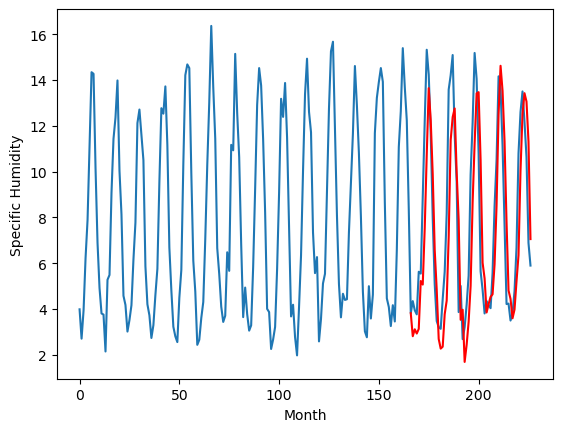

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		1.25		-1.24
0.99		1.55		0.56
-1.30		1.36		2.66
-2.06		1.57		3.63
0.01		3.66		3.65
0.33		3.50		3.17
4.03		5.98		1.95
7.12		9.16		2.04
11.07		12.07		1.00
8.69		10.67		1.98
5.73		8.32		2.59
1.01		5.01		4.00
-0.09		3.28		3.37
-2.02		1.13		3.15
-2.22		0.71		2.93
-3.05		0.79		3.84
-0.57		2.21		2.78
0.49		2.80		2.31
2.91		5.56		2.65
7.37		9.81		2.44
9.32		10.81		1.49
9.41		11.19		1.78
5.64		8.39		2.75
3.69		6.34		2.65
-1.43		1.96		3.39
-0.73		2.40		3.13
-3.19		0.12		3.31
-2.57		0.87		3.44
-1.00		1.88		2.88
0.56		3.44		2.88
4.65		7.09		2.44
6.75		9.66		2.91
9.34		11.85		2.51
8.84		11.90		3.06
5.74		8.94		3.20
0.74		4.45		3.71
-0.65		3.77		4.42
-1.77		2.28		4.05
-1.39		2.65		4.04
-0.51		2.96		3.47
-0.84		3.08		3.92
0.39		4.38		3.99
3.57		6.95		3.38
5.70		10.92		5.22
9.47		13.05		3.58
9.86		11.96		2.10
5.75		9.76		4.01
2.13		6.22		4.09
-1.04		3.24		4.28
-1.45		2.88		4.33
-2.32		2.03		4.35
-1.41		

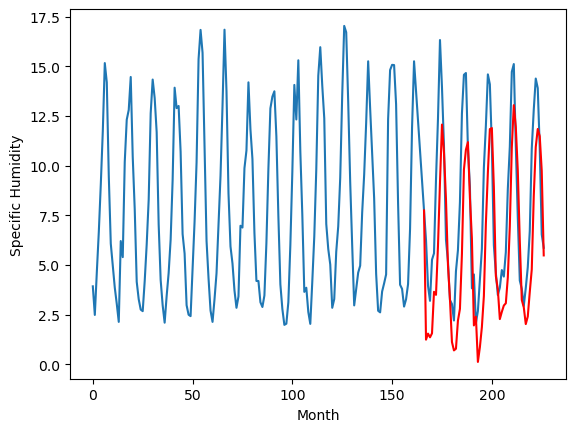

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		1.19		0.75
0.73		1.49		0.76
0.23		1.30		1.07
-0.02		1.51		1.53
1.97		3.60		1.63
2.09		3.44		1.35
5.30		5.92		0.62
8.03		9.10		1.07
11.19		12.01		0.82
9.97		10.61		0.64
6.79		8.26		1.47
3.37		4.95		1.58
1.60		3.22		1.62
-0.06		1.07		1.13
-0.37		0.65		1.02
-0.89		0.73		1.62
1.14		2.15		1.01
2.44		2.74		0.30
4.68		5.50		0.82
9.90		9.75		-0.15
11.15		10.75		-0.40
11.32		11.13		-0.19
8.02		8.33		0.31
6.40		6.28		-0.12
0.53		1.90		1.37
1.58		2.34		0.76
-0.93		0.06		0.99
-0.40		0.81		1.21
0.91		1.82		0.91
2.44		3.38		0.94
6.67		7.03		0.36
8.74		9.60		0.86
11.52		11.79		0.27
10.32		11.84		1.52
7.55		8.88		1.33
2.25		4.39		2.14
1.03		3.71		2.68
0.27		2.22		1.95
0.85		2.59		1.74
0.52		2.90		2.38
0.95		3.02		2.07
2.26		4.32		2.06
4.86		6.89		2.03
7.02		10.86		3.84
11.53		12.99		1.46
10.65		11.90		1.25
7.42		9.70		2.28
4.04		6.16		2.12
0.85		3.18		2.33
0.81		2.82		2.01
-0.07		1.97		2.04
0.51		2.35	

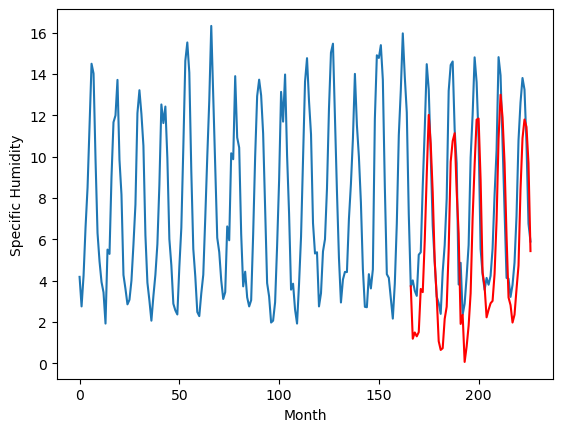

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		1.44		-3.34
4.41		1.74		-2.67
4.37		1.55		-2.82
4.33		1.76		-2.57
4.96		3.85		-1.11
5.31		3.69		-1.62
6.44		6.17		-0.27
7.50		9.35		1.85
9.02		12.26		3.24
7.81		10.86		3.05
6.67		8.51		1.84
5.02		5.20		0.18
4.96		3.47		-1.49
4.15		1.32		-2.83
4.32		0.90		-3.42
4.38		0.98		-3.40
4.69		2.40		-2.29
5.16		2.99		-2.17
6.56		5.75		-0.81
7.89		10.00		2.11
10.34		11.00		0.66
8.91		11.38		2.47
7.21		8.58		1.37
6.12		6.53		0.41
5.41		2.15		-3.26
4.70		2.59		-2.11
4.22		0.31		-3.91
4.01		1.06		-2.95
4.69		2.07		-2.62
5.19		3.63		-1.56
6.00		7.28		1.28
7.94		9.85		1.91
10.93		12.04		1.11
10.77		12.09		1.32
7.82		9.13		1.31
6.21		4.64		-1.57
4.55		3.96		-0.59
4.58		2.47		-2.11
4.55		2.84		-1.71
4.17		3.15		-1.02
4.47		3.27		-1.20
5.10		4.57		-0.53
7.26		7.14		-0.12
7.49		11.11		3.62
8.33		13.24		4.91
9.98		12.15		2.17
7.36		9.95		2.59
6.11		6.41		0.30
4.78		3.43		-1.35
4.65		3.07		-1.58
4.59		2.22		

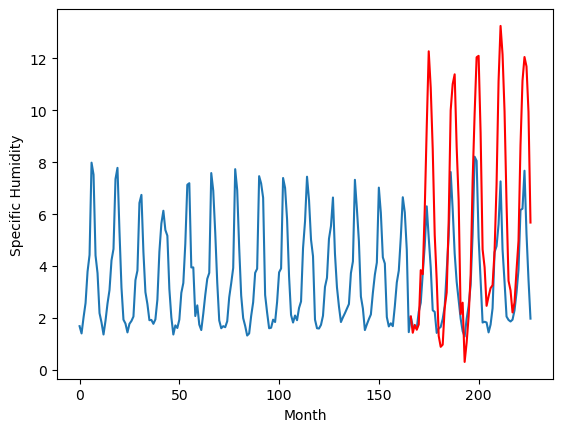

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		-1.05		-3.74
3.68		-0.75		-4.43
2.56		-0.94		-3.50
2.14		-0.73		-2.87
3.88		1.36		-2.52
3.69		1.20		-2.49
2.99		3.68		0.69
3.32		6.86		3.54
3.80		9.77		5.97
4.67		8.37		3.70
3.41		6.02		2.61
2.40		2.71		0.31
2.38		0.98		-1.40
1.55		-1.17		-2.72
2.36		-1.59		-3.95
1.88		-1.51		-3.39
2.18		-0.09		-2.27
1.87		0.50		-1.37
2.43		3.26		0.83
3.85		7.51		3.66
9.21		8.51		-0.70
6.78		8.89		2.11
5.06		6.09		1.03
3.96		4.04		0.08
2.69		-0.34		-3.03
2.83		0.10		-2.73
1.84		-2.18		-4.02
1.41		-1.43		-2.84
2.03		-0.42		-2.45
2.03		1.14		-0.89
2.29		4.79		2.50
4.05		7.36		3.31
7.48		9.55		2.07
10.55		9.60		-0.95
6.64		6.64		-0.00
3.91		2.15		-1.76
2.14		1.47		-0.67
2.89		-0.02		-2.91
3.28		0.35		-2.93
2.03		0.66		-1.37
3.07		0.78		-2.29
2.22		2.08		-0.14
3.76		4.65		0.89
4.26		8.62		4.36
5.23		10.75		5.52
7.81		9.66		1.85
6.87		7.46		0.59
3.81		3.92		0.11
2.80		0.94		-1.86
2.72		0.58		-2.14
3.26		-0.2

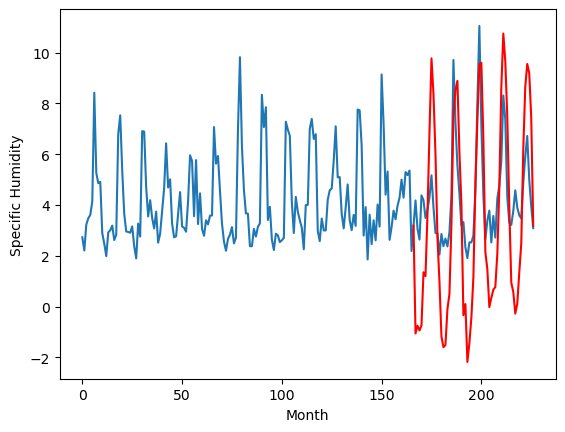

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		-0.01		-3.34
4.56		0.29		-4.27
3.88		0.10		-3.78
2.99		0.31		-2.68
3.47		2.40		-1.07
4.53		2.24		-2.29
5.39		4.72		-0.67
5.61		7.90		2.29
6.08		10.81		4.73
6.88		9.41		2.53
6.49		7.06		0.57
4.29		3.75		-0.54
3.13		2.02		-1.11
2.79		-0.13		-2.92
3.46		-0.55		-4.01
3.11		-0.47		-3.58
2.76		0.95		-1.81
3.69		1.54		-2.15
4.13		4.30		0.17
5.56		8.55		2.99
6.04		9.55		3.51
6.43		9.93		3.50
5.79		7.13		1.34
4.76		5.08		0.32
4.98		0.70		-4.28
3.73		1.14		-2.59
3.40		-1.14		-4.54
2.56		-0.39		-2.95
3.56		0.62		-2.94
3.66		2.18		-1.48
4.03		5.83		1.80
5.52		8.40		2.88
6.35		10.59		4.24
6.81		10.64		3.83
6.21		7.68		1.47
4.90		3.19		-1.71
2.65		2.51		-0.14
3.44		1.02		-2.42
3.27		1.39		-1.88
2.41		1.70		-0.71
3.21		1.82		-1.39
3.59		3.12		-0.47
5.18		5.69		0.51
5.24		9.66		4.42
6.08		11.79		5.71
7.35		10.70		3.35
6.80		8.50		1.70
5.37		4.96		-0.41
4.28		1.98		-2.30
4.66		1.62		-3.04
4.67		0.77		-3

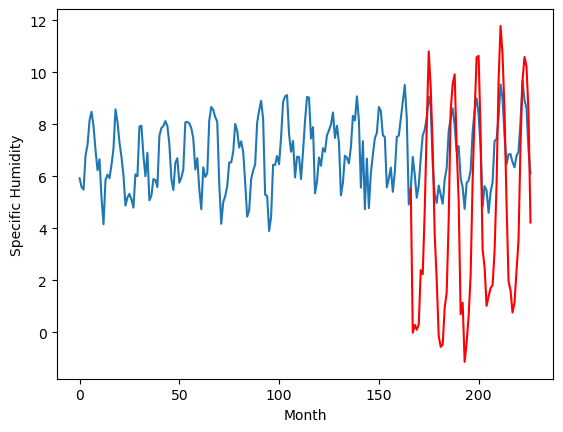

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		3.19		0.94
1.89		3.49		1.60
1.61		3.30		1.69
1.69		3.51		1.82
2.18		5.60		3.42
2.68		5.44		2.76
4.91		7.92		3.01
9.02		11.10		2.08
13.00		14.01		1.01
11.93		12.61		0.68
8.56		10.26		1.70
6.03		6.95		0.92
3.87		5.22		1.35
1.91		3.07		1.16
0.82		2.65		1.83
0.97		2.73		1.76
1.75		4.15		2.40
3.13		4.74		1.61
4.70		7.50		2.80
9.60		11.75		2.15
11.81		12.75		0.94
12.19		13.13		0.94
9.59		10.33		0.74
7.05		8.28		1.23
2.52		3.90		1.38
2.22		4.34		2.12
0.74		2.06		1.32
1.33		2.81		1.48
2.17		3.82		1.65
2.82		5.38		2.56
6.21		9.03		2.82
8.55		11.60		3.05
11.71		13.79		2.08
11.85		13.84		1.99
8.18		10.88		2.70
5.55		6.39		0.84
3.70		5.71		2.01
1.73		4.22		2.49
2.30		4.59		2.29
1.59		4.90		3.31
1.80		5.02		3.22
4.04		6.32		2.28
4.56		8.89		4.33
8.26		12.86		4.60
13.11		14.99		1.88
10.54		13.90		3.36
9.57		11.70		2.13
6.18		8.16		1.98
2.38		5.18		2.80
2.71		4.82		2.11
1.41		3.97		2.56
1.31		4.35		3

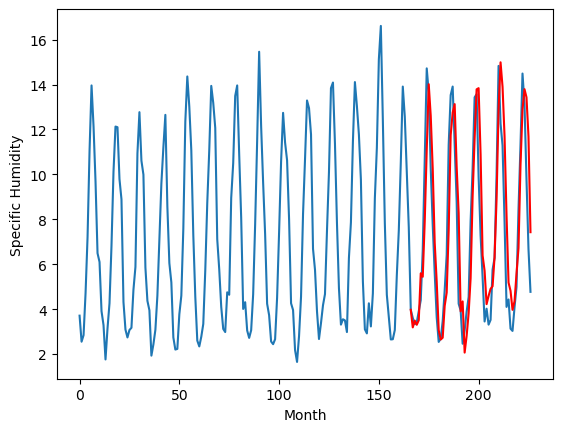

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.97		1.51
-0.66		1.27		1.93
-0.74		1.08		1.82
-0.75		1.29		2.04
0.21		3.38		3.17
0.64		3.22		2.58
3.17		5.70		2.53
6.74		8.88		2.14
10.09		11.79		1.70
9.45		10.39		0.94
6.16		8.04		1.88
3.39		4.73		1.34
1.06		3.00		1.94
-0.79		0.85		1.64
-1.48		0.43		1.91
-1.62		0.51		2.13
-0.34		1.93		2.27
1.07		2.52		1.45
2.66		5.28		2.62
7.53		9.53		2.00
9.22		10.53		1.31
9.54		10.91		1.37
6.62		8.11		1.49
4.72		6.06		1.34
-0.20		1.68		1.88
-0.30		2.12		2.42
-1.81		-0.16		1.65
-1.11		0.59		1.70
-0.17		1.60		1.77
0.47		3.16		2.69
4.65		6.81		2.16
6.05		9.38		3.33
9.03		11.57		2.54
8.66		11.62		2.96
5.64		8.66		3.02
2.22		4.17		1.95
1.00		3.49		2.49
-0.92		2.00		2.92
-0.14		2.37		2.51
-0.89		2.68		3.57
-0.76		2.80		3.56
1.67		4.10		2.43
2.14		6.67		4.53
5.83		10.64		4.81
9.81		12.77		2.96
8.57		11.68		3.11
6.88		9.48		2.60
3.61		5.94		2.33
-0.07		2.96		3.03
0.31		2.60		2.29
-0.82		1.75		2.57
-0.91		

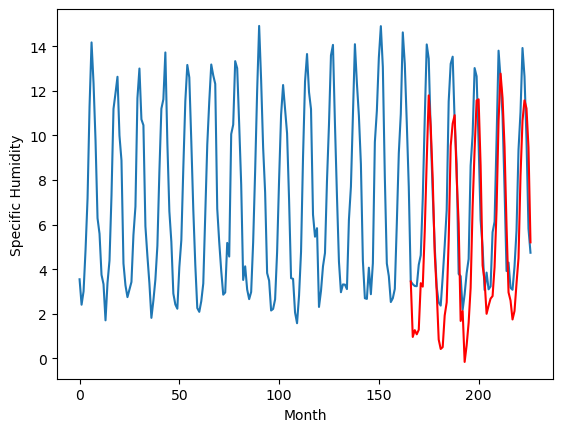

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29   0.966027
1                 1    2.24   2.366027
2                 2    3.79   0.986027
3                 3    1.02   2.816027
4                 4    2.49   1.246027
5                 5    0.44   1.186027
6                 6    4.78   1.436027
7                 7    2.69  -1.053973
8                 8    3.33  -0.013973
9                 9    2.25   3.186027
10               10   -0.54   0.966027


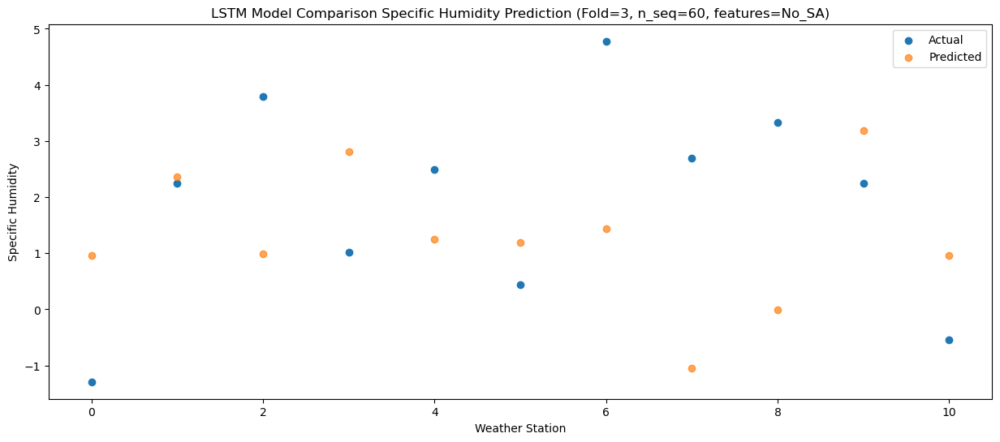

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08   1.269383
1                 1    1.83   2.669383
2                 2    4.33   1.289383
3                 3    1.55   3.119383
4                 4    0.99   1.549383
5                 5    0.73   1.489383
6                 6    4.41   1.739383
7                 7    3.68  -0.750617
8                 8    4.56   0.289383
9                 9    1.89   3.489383
10               10   -0.66   1.269383


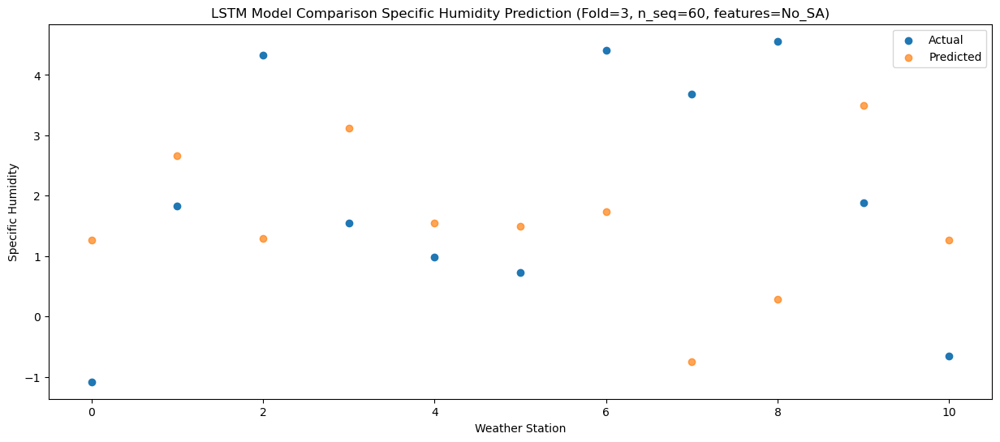

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03   1.083211
1                 1    1.80   2.483211
2                 2    3.95   1.103211
3                 3    1.15   2.933211
4                 4   -1.30   1.363211
5                 5    0.23   1.303211
6                 6    4.37   1.553211
7                 7    2.56  -0.936789
8                 8    3.88   0.103211
9                 9    1.61   3.303211
10               10   -0.74   1.083211


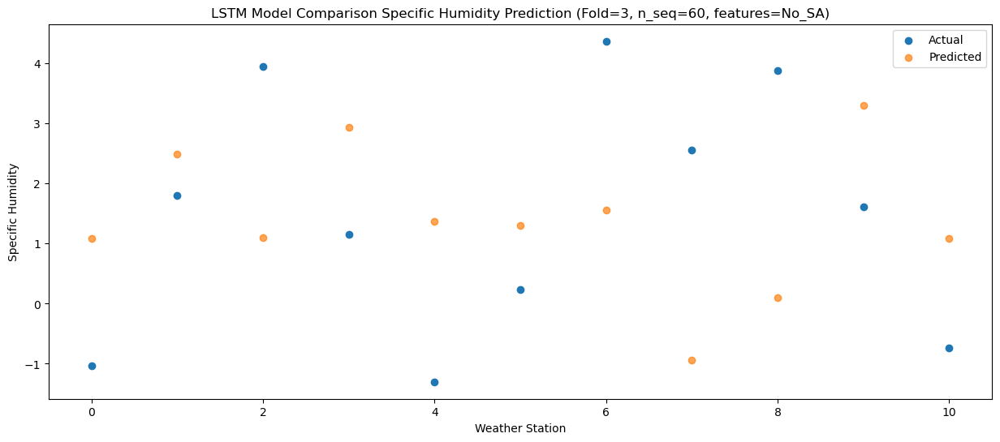

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70   1.285014
1                 1    1.44   2.685014
2                 2    3.26   1.305014
3                 3    0.97   3.135014
4                 4   -2.06   1.565014
5                 5   -0.02   1.505014
6                 6    4.33   1.755014
7                 7    2.14  -0.734986
8                 8    2.99   0.305014
9                 9    1.69   3.505014
10               10   -0.75   1.285014


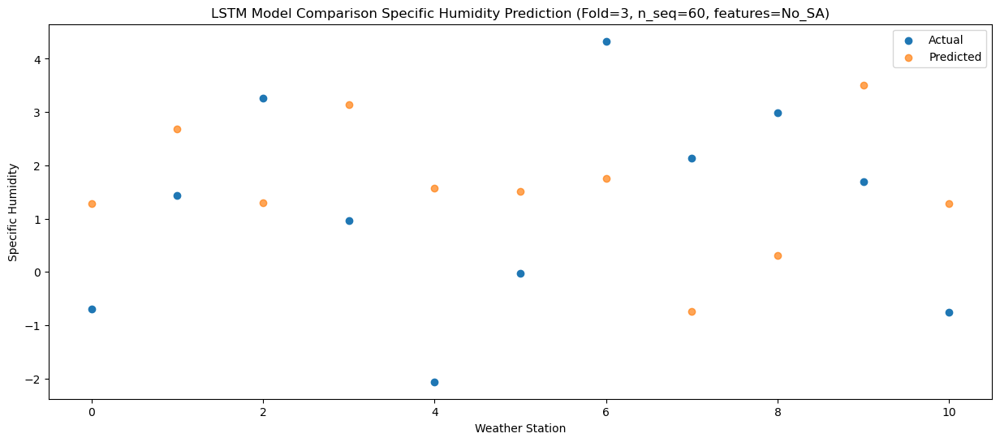

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   3.375881
1                 1    4.04   4.775881
2                 2    4.34   3.395881
3                 3    2.83   5.225881
4                 4    0.01   3.655881
5                 5    1.97   3.595881
6                 6    4.96   3.845881
7                 7    3.88   1.355881
8                 8    3.47   2.395881
9                 9    2.18   5.595881
10               10    0.21   3.375881


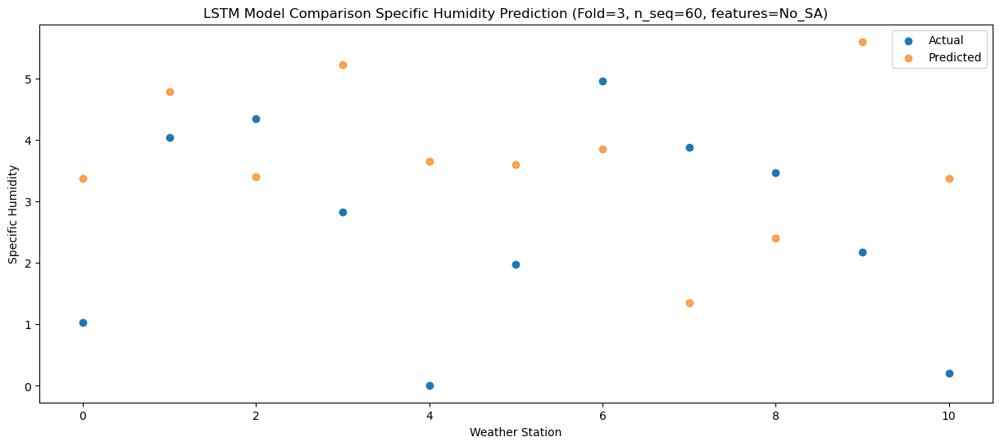

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   3.220299
1                 1    4.19   4.620299
2                 2    5.71   3.240299
3                 3    2.75   5.070299
4                 4    0.33   3.500299
5                 5    2.09   3.440299
6                 6    5.31   3.690299
7                 7    3.69   1.200299
8                 8    4.53   2.240299
9                 9    2.68   5.440299
10               10    0.64   3.220299


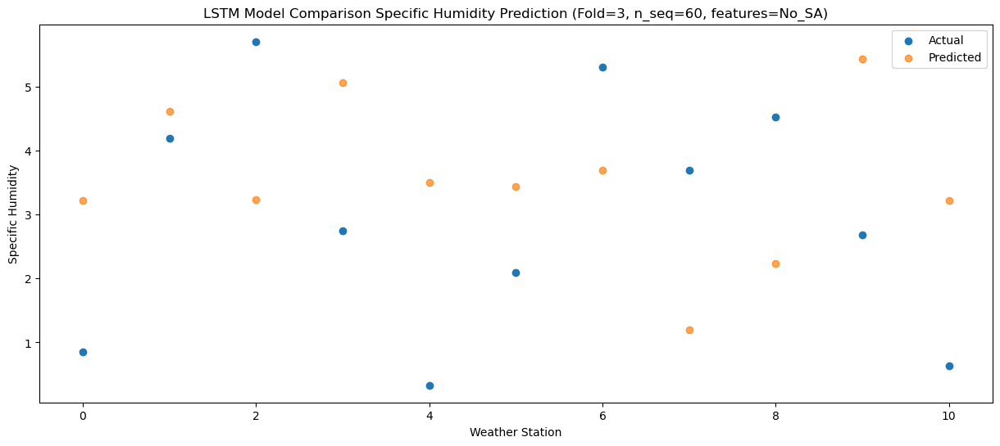

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   5.698345
1                 1    7.16   7.098345
2                 2    5.52   5.718345
3                 3    6.18   7.548345
4                 4    4.03   5.978345
5                 5    5.30   5.918345
6                 6    6.44   6.168345
7                 7    2.99   3.678345
8                 8    5.39   4.718345
9                 9    4.91   7.918345
10               10    3.17   5.698345


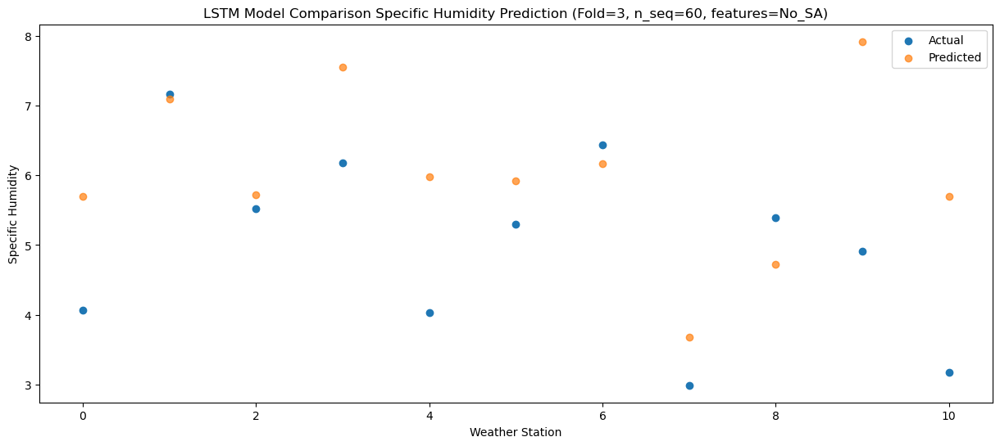

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   8.881406
1                 1   10.69  10.281406
2                 2    7.06   8.901406
3                 3    9.42  10.731406
4                 4    7.12   9.161406
5                 5    8.03   9.101406
6                 6    7.50   9.351406
7                 7    3.32   6.861406
8                 8    5.61   7.901406
9                 9    9.02  11.101406
10               10    6.74   8.881406


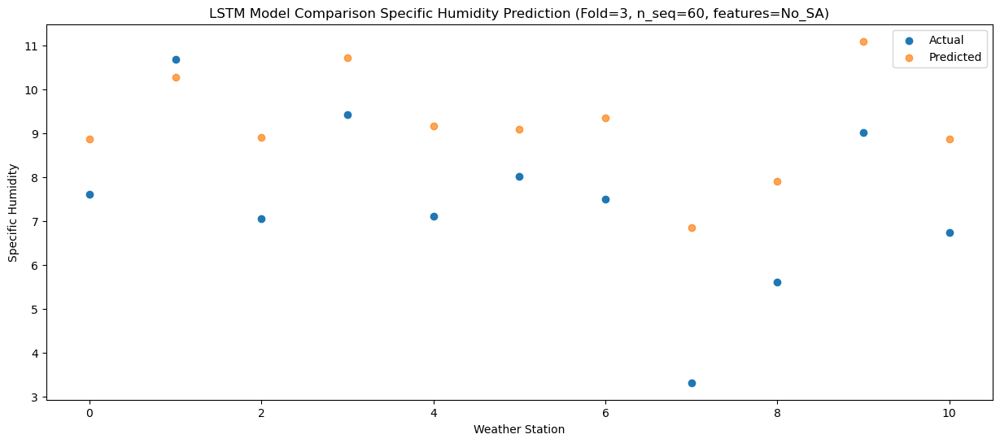

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30  11.793886
1                 1   13.43  13.193886
2                 2    7.28  11.813886
3                 3   12.52  13.643886
4                 4   11.07  12.073886
5                 5   11.19  12.013886
6                 6    9.02  12.263886
7                 7    3.80   9.773886
8                 8    6.08  10.813886
9                 9   13.00  14.013886
10               10   10.09  11.793886


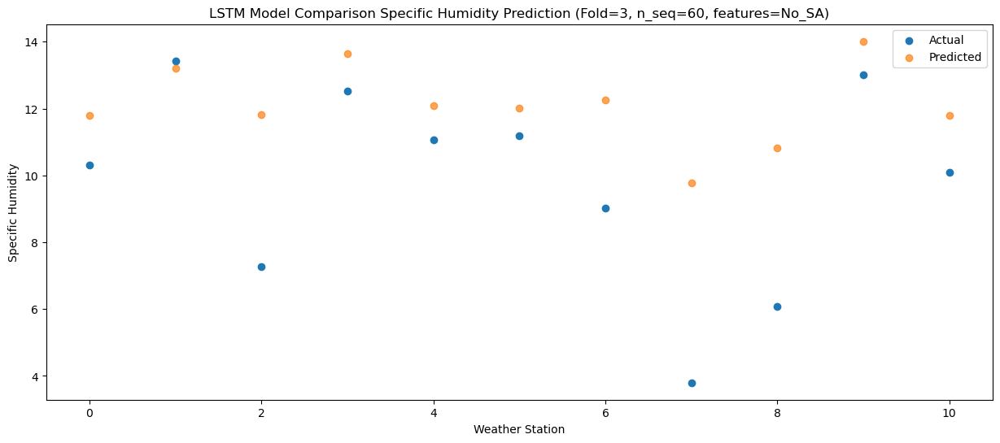

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59  10.392026
1                 1   10.76  11.792026
2                 2    8.80  10.412026
3                 3   11.44  12.242026
4                 4    8.69  10.672026
5                 5    9.97  10.612026
6                 6    7.81  10.862026
7                 7    4.67   8.372026
8                 8    6.88   9.412026
9                 9   11.93  12.612026
10               10    9.45  10.392026


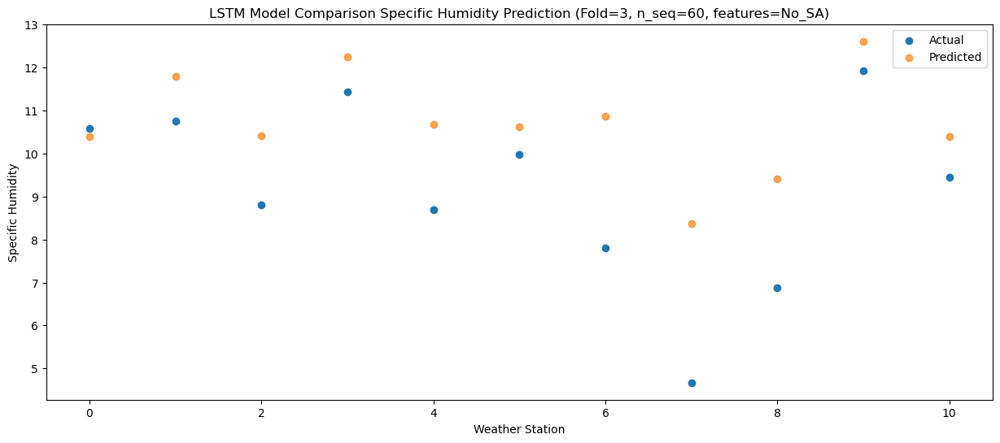

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   8.035925
1                 1    9.32   9.435925
2                 2    8.32   8.055925
3                 3    8.87   9.885925
4                 4    5.73   8.315925
5                 5    6.79   8.255925
6                 6    6.67   8.505925
7                 7    3.41   6.015925
8                 8    6.49   7.055925
9                 9    8.56  10.255925
10               10    6.16   8.035925


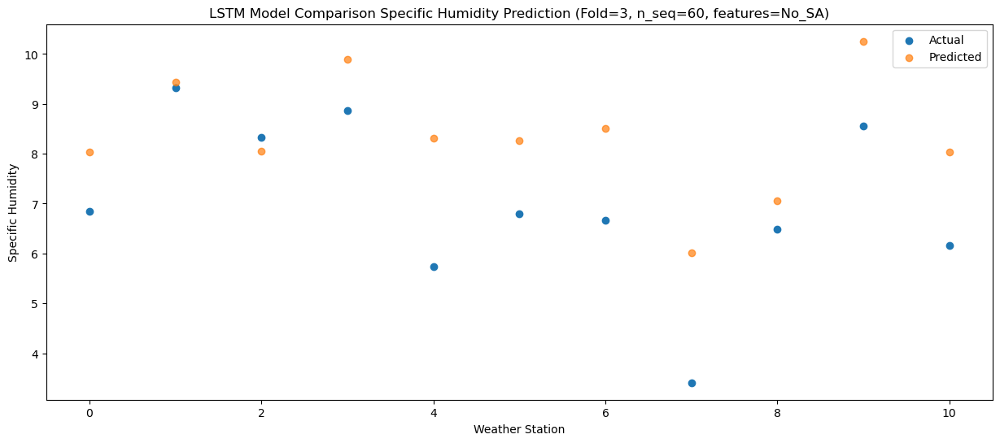

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   4.732113
1                 1    4.75   6.132113
2                 2    6.44   4.752113
3                 3    5.18   6.582113
4                 4    1.01   5.012113
5                 5    3.37   4.952113
6                 6    5.02   5.202113
7                 7    2.40   2.712113
8                 8    4.29   3.752113
9                 9    6.03   6.952113
10               10    3.39   4.732113


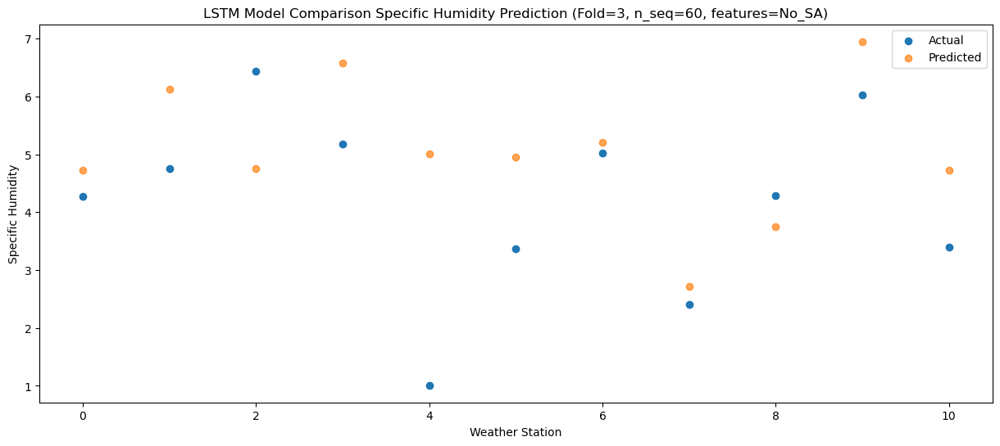

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   3.000073
1                 1    3.25   4.400073
2                 2    3.75   3.020073
3                 3    2.29   4.850073
4                 4   -0.09   3.280073
5                 5    1.60   3.220073
6                 6    4.96   3.470073
7                 7    2.38   0.980073
8                 8    3.13   2.020073
9                 9    3.87   5.220073
10               10    1.06   3.000073


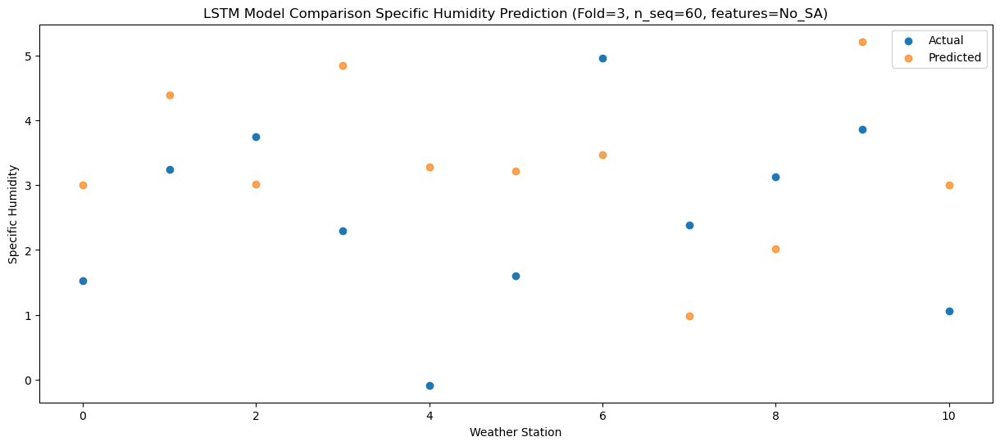

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69   0.845618
1                 1    1.21   2.245618
2                 2    3.15   0.865618
3                 3    0.68   2.695618
4                 4   -2.02   1.125618
5                 5   -0.06   1.065618
6                 6    4.15   1.315618
7                 7    1.55  -1.174382
8                 8    2.79  -0.134382
9                 9    1.91   3.065618
10               10   -0.79   0.845618


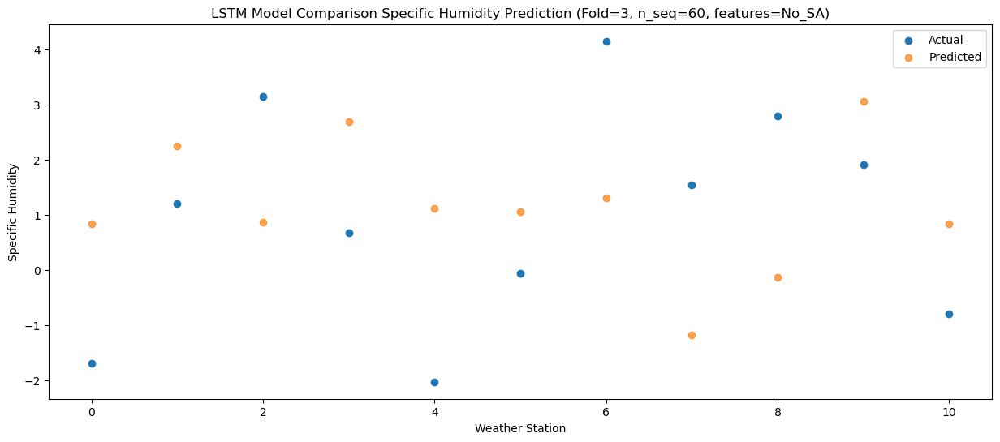

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82   0.425177
1                 1    1.12   1.825177
2                 2    3.59   0.445177
3                 3    0.41   2.275177
4                 4   -2.22   0.705177
5                 5   -0.37   0.645177
6                 6    4.32   0.895177
7                 7    2.36  -1.594823
8                 8    3.46  -0.554823
9                 9    0.82   2.645177
10               10   -1.48   0.425177


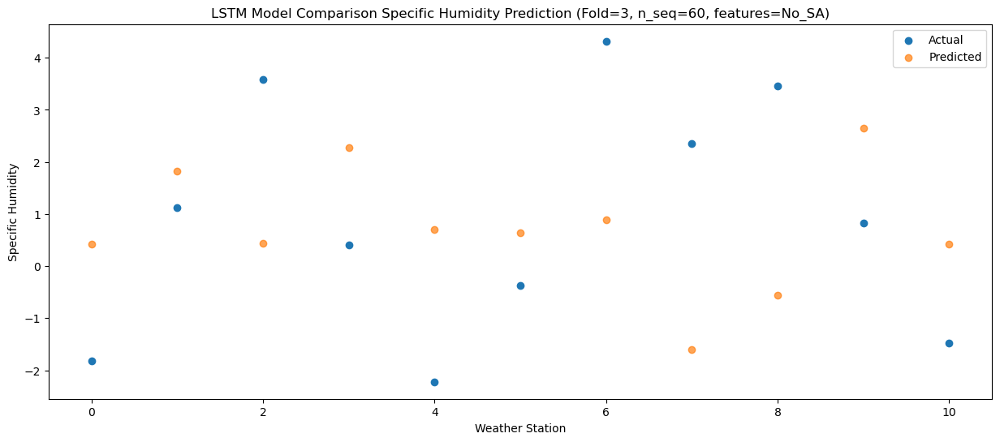

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73   0.507959
1                 1    0.56   1.907959
2                 2    3.53   0.527959
3                 3    0.34   2.357959
4                 4   -3.05   0.787959
5                 5   -0.89   0.727959
6                 6    4.38   0.977959
7                 7    1.88  -1.512041
8                 8    3.11  -0.472041
9                 9    0.97   2.727959
10               10   -1.62   0.507959


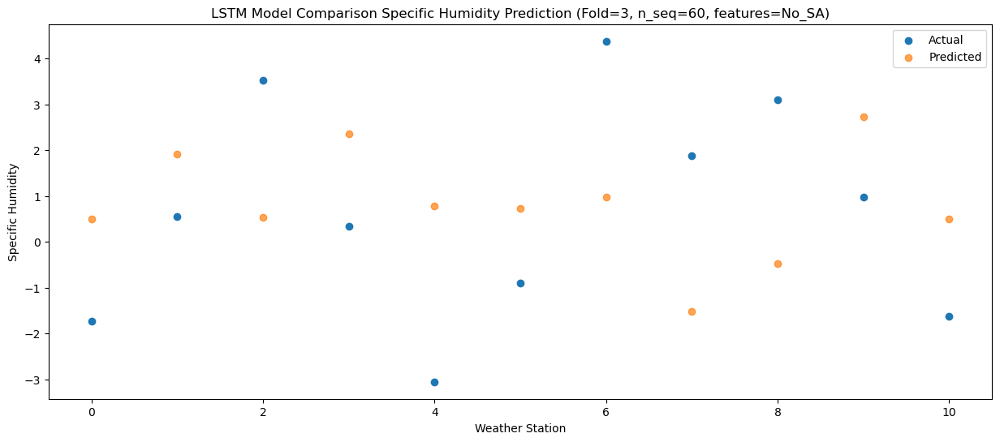

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08   1.926738
1                 1    3.07   3.326738
2                 2    3.61   1.946738
3                 3    1.64   3.776738
4                 4   -0.57   2.206738
5                 5    1.14   2.146738
6                 6    4.69   2.396738
7                 7    2.18  -0.093262
8                 8    2.76   0.946738
9                 9    1.75   4.146738
10               10   -0.34   1.926738


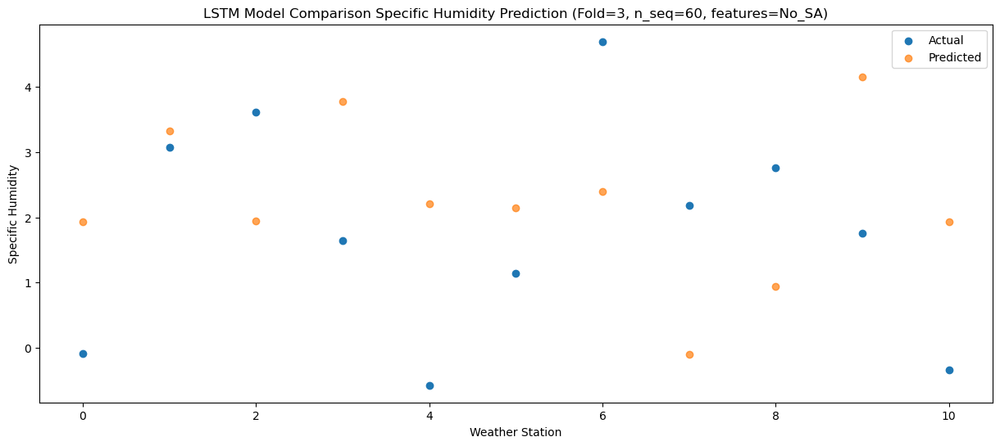

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44   2.515102
1                 1    4.24   3.915102
2                 2    4.23   2.535102
3                 3    2.83   4.365102
4                 4    0.49   2.795102
5                 5    2.44   2.735102
6                 6    5.16   2.985102
7                 7    1.87   0.495102
8                 8    3.69   1.535102
9                 9    3.13   4.735102
10               10    1.07   2.515102


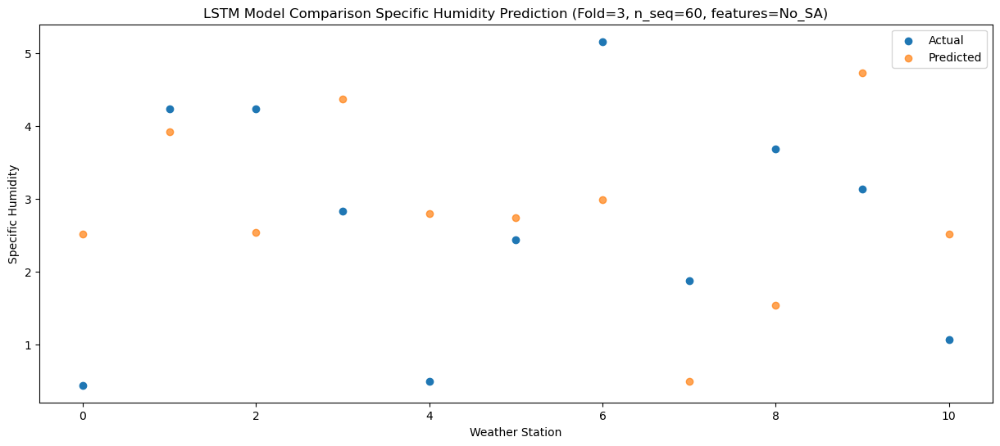

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   5.282655
1                 1    7.76   6.682655
2                 2    4.63   5.302655
3                 3    5.36   7.132655
4                 4    2.91   5.562655
5                 5    4.68   5.502655
6                 6    6.56   5.752655
7                 7    2.43   3.262655
8                 8    4.13   4.302655
9                 9    4.70   7.502655
10               10    2.66   5.282655


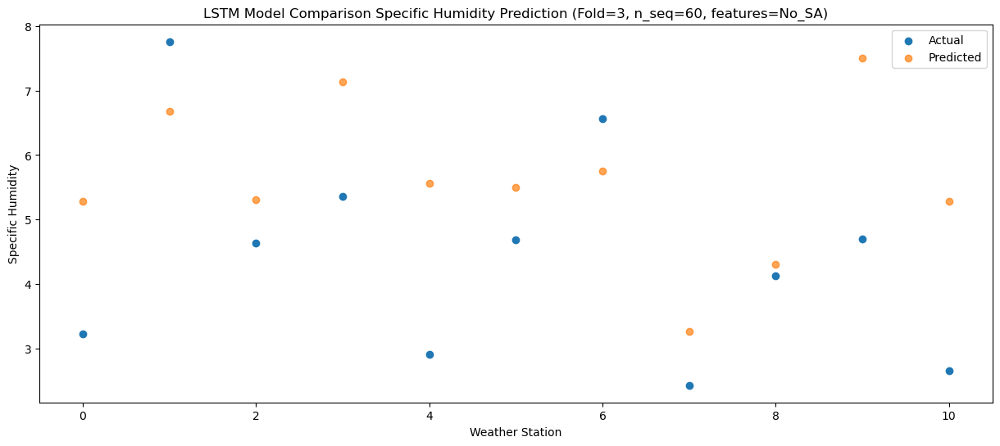

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94    9.52654
1                 1   12.29   10.92654
2                 2    7.08    9.54654
3                 3   10.78   11.37654
4                 4    7.37    9.80654
5                 5    9.90    9.74654
6                 6    7.89    9.99654
7                 7    3.85    7.50654
8                 8    5.56    8.54654
9                 9    9.60   11.74654
10               10    7.53    9.52654


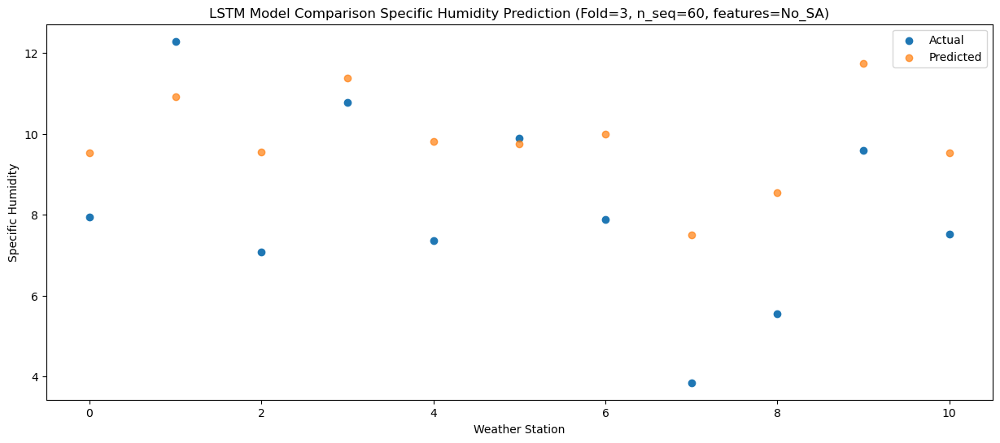

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18  10.530339
1                 1   13.17  11.930339
2                 2    7.78  10.550339
3                 3   11.41  12.380339
4                 4    9.32  10.810339
5                 5   11.15  10.750339
6                 6   10.34  11.000339
7                 7    9.21   8.510339
8                 8    6.04   9.550339
9                 9   11.81  12.750339
10               10    9.22  10.530339


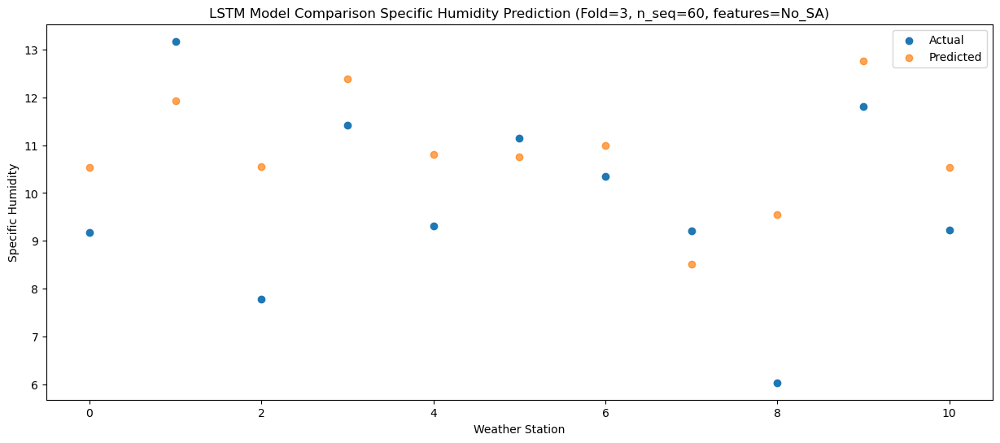

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45  10.908343
1                 1   13.34  12.308343
2                 2    7.31  10.928343
3                 3   12.29  12.758343
4                 4    9.41  11.188343
5                 5   11.32  11.128343
6                 6    8.91  11.378343
7                 7    6.78   8.888343
8                 8    6.43   9.928343
9                 9   12.19  13.128343
10               10    9.54  10.908343


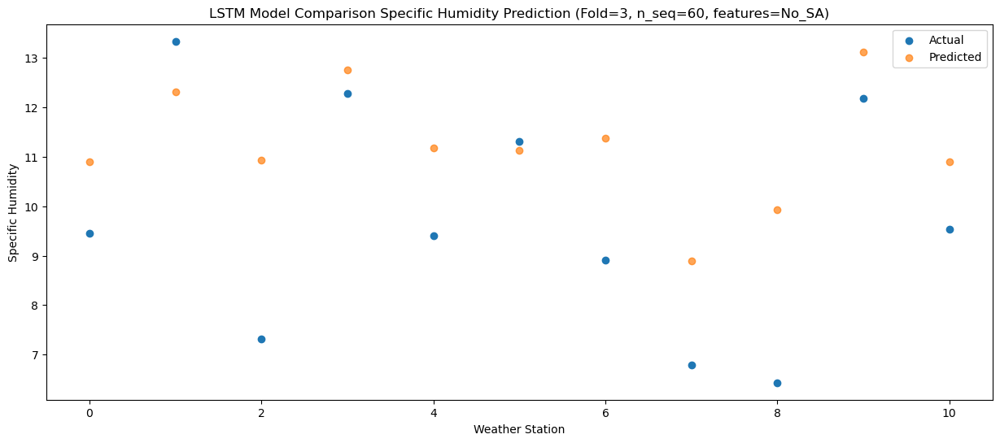

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   8.112712
1                 1    9.37   9.512712
2                 2    6.02   8.132712
3                 3    8.82   9.962712
4                 4    5.64   8.392712
5                 5    8.02   8.332712
6                 6    7.21   8.582712
7                 7    5.06   6.092712
8                 8    5.79   7.132712
9                 9    9.59  10.332712
10               10    6.62   8.112712


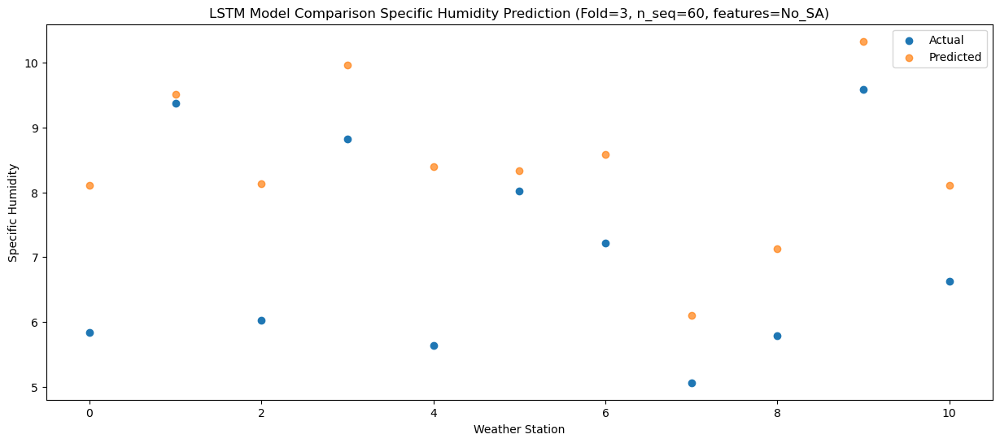

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   6.056506
1                 1    7.18   7.456506
2                 2    4.88   6.076506
3                 3    6.76   7.906506
4                 4    3.69   6.336506
5                 5    6.40   6.276506
6                 6    6.12   6.526506
7                 7    3.96   4.036506
8                 8    4.76   5.076506
9                 9    7.05   8.276506
10               10    4.72   6.056506


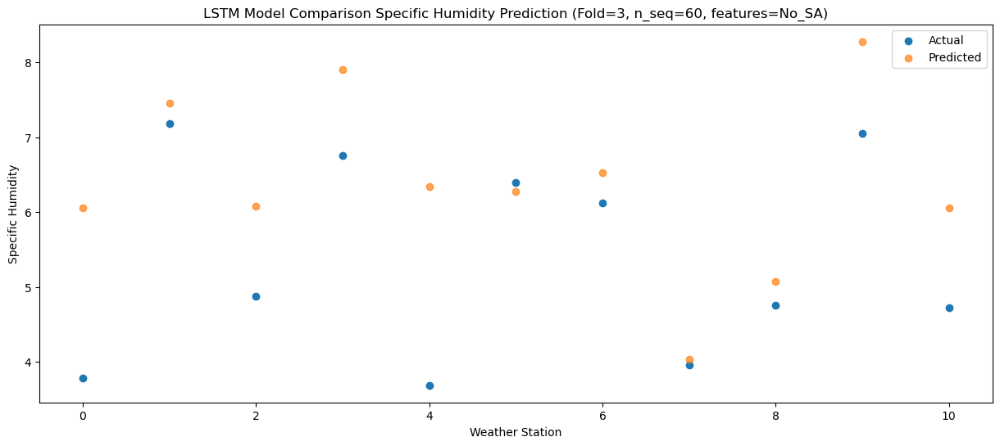

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71   1.682438
1                 1    2.75   3.082438
2                 2    5.46   1.702438
3                 3    1.07   3.532438
4                 4   -1.43   1.962438
5                 5    0.53   1.902438
6                 6    5.41   2.152438
7                 7    2.69  -0.337562
8                 8    4.98   0.702438
9                 9    2.52   3.902438
10               10   -0.20   1.682438


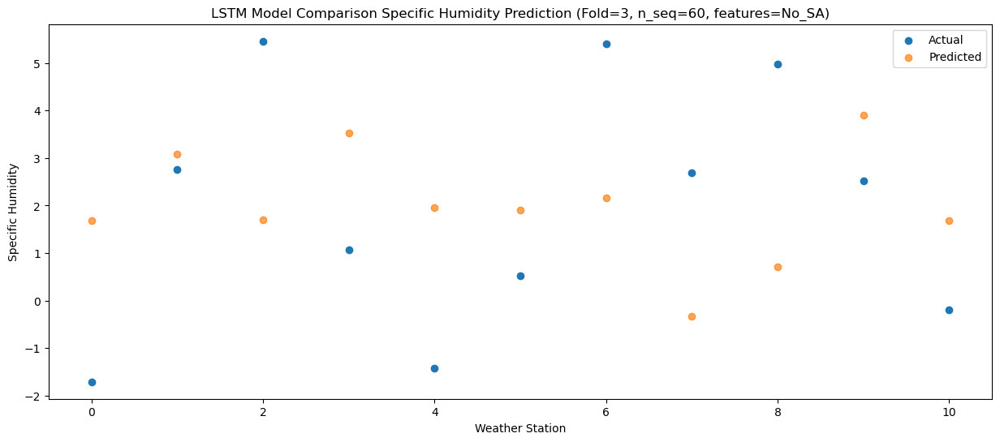

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24   2.122925
1                 1    3.72   3.522925
2                 2    3.96   2.142925
3                 3    2.21   3.972925
4                 4   -0.73   2.402925
5                 5    1.58   2.342925
6                 6    4.70   2.592925
7                 7    2.83   0.102925
8                 8    3.73   1.142925
9                 9    2.22   4.342925
10               10   -0.30   2.122925


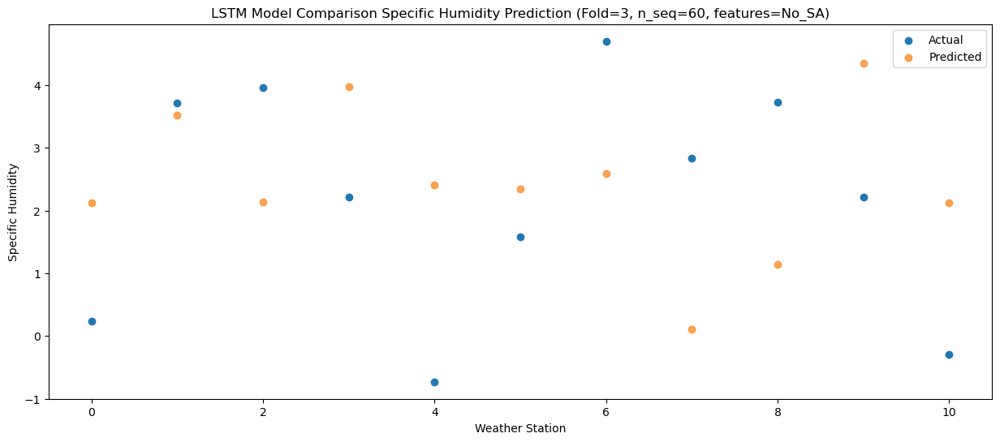

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -0.155347
1                 1    0.53   1.244653
2                 2    3.68  -0.135347
3                 3   -0.11   1.694653
4                 4   -3.19   0.124653
5                 5   -0.93   0.064653
6                 6    4.22   0.314653
7                 7    1.84  -2.175347
8                 8    3.40  -1.135347
9                 9    0.74   2.064653
10               10   -1.81  -0.155347


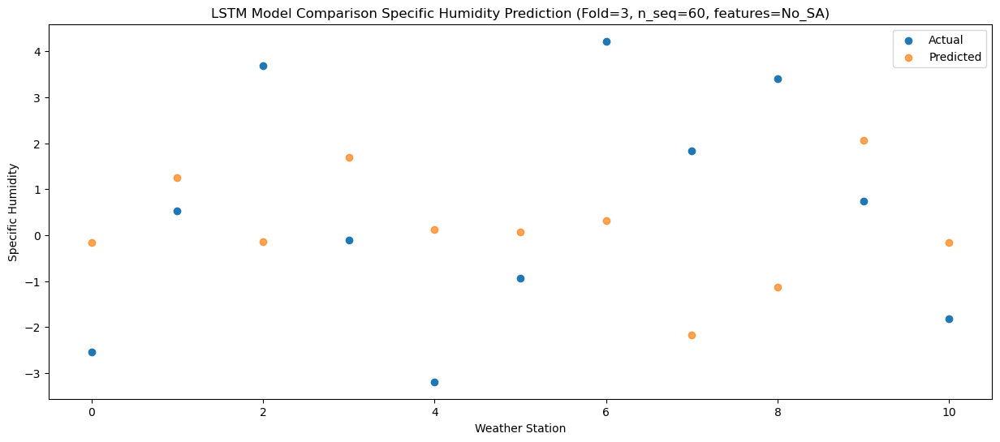

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19   0.589123
1                 1    0.90   1.989123
2                 2    2.90   0.609123
3                 3    0.41   2.439123
4                 4   -2.57   0.869123
5                 5   -0.40   0.809123
6                 6    4.01   1.059123
7                 7    1.41  -1.430877
8                 8    2.56  -0.390877
9                 9    1.33   2.809123
10               10   -1.11   0.589123


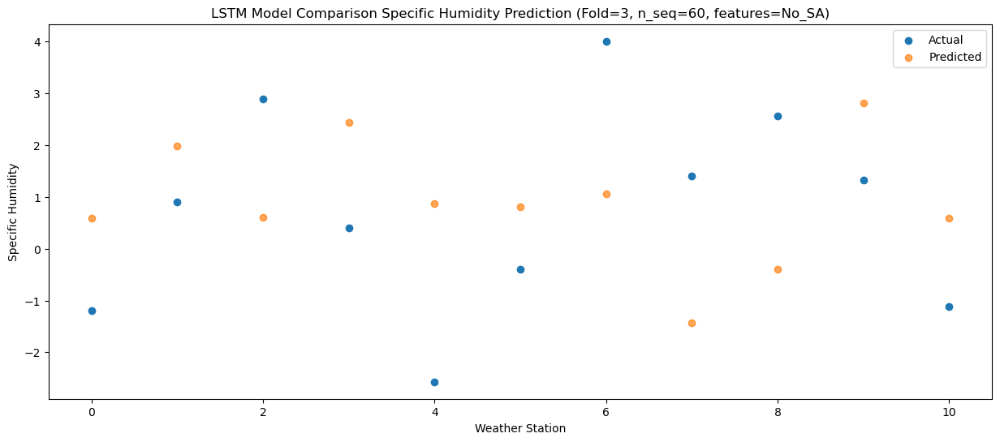

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29   1.600012
1                 1    2.37   3.000012
2                 2    4.24   1.620012
3                 3    1.39   3.450012
4                 4   -1.00   1.880012
5                 5    0.91   1.820012
6                 6    4.69   2.070012
7                 7    2.03  -0.419988
8                 8    3.56   0.620012
9                 9    2.17   3.820012
10               10   -0.17   1.600012


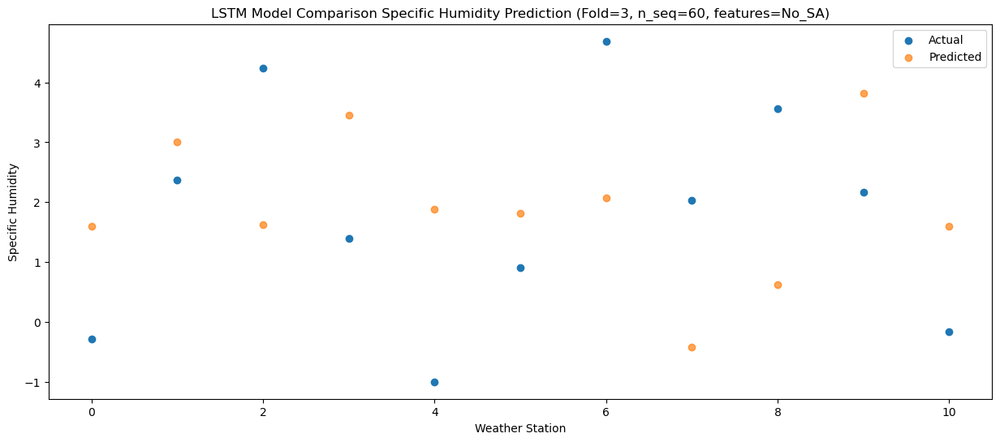

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74    3.16332
1                 1    4.67    4.56332
2                 2    3.91    3.18332
3                 3    2.66    5.01332
4                 4    0.56    3.44332
5                 5    2.44    3.38332
6                 6    5.19    3.63332
7                 7    2.03    1.14332
8                 8    3.66    2.18332
9                 9    2.82    5.38332
10               10    0.47    3.16332


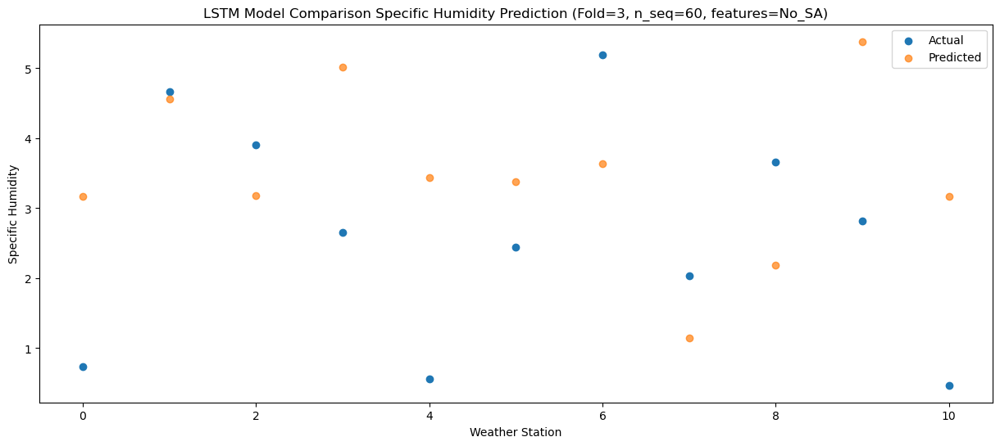

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   6.808225
1                 1    9.12   8.208225
2                 2    4.09   6.828225
3                 3    7.08   8.658225
4                 4    4.65   7.088225
5                 5    6.67   7.028225
6                 6    6.00   7.278225
7                 7    2.29   4.788225
8                 8    4.03   5.828225
9                 9    6.21   9.028225
10               10    4.65   6.808225


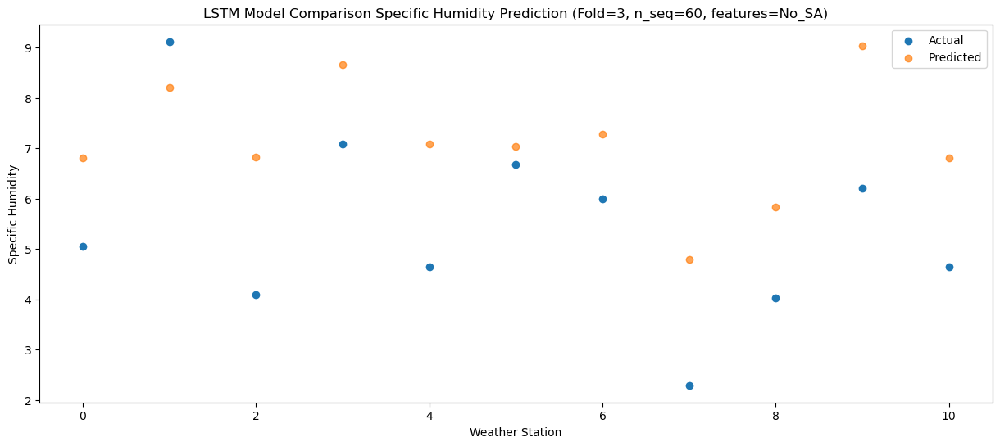

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   9.377203
1                 1   11.74  10.777203
2                 2    5.26   9.397203
3                 3    9.34  11.227203
4                 4    6.75   9.657203
5                 5    8.74   9.597203
6                 6    7.94   9.847203
7                 7    4.05   7.357203
8                 8    5.52   8.397203
9                 9    8.55  11.597203
10               10    6.05   9.377203


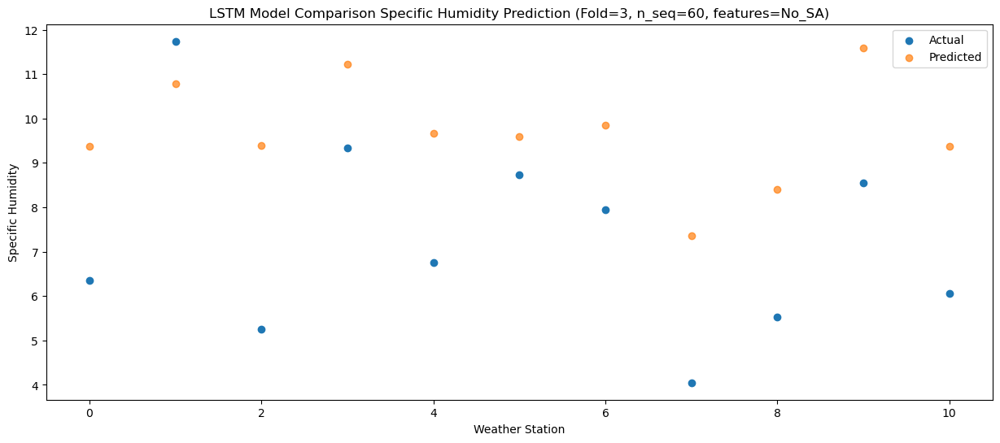

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42  11.565667
1                 1   11.95  12.965667
2                 2    6.43  11.585667
3                 3   12.38  13.415667
4                 4    9.34  11.845667
5                 5   11.52  11.785667
6                 6   10.93  12.035667
7                 7    7.48   9.545667
8                 8    6.35  10.585667
9                 9   11.71  13.785667
10               10    9.03  11.565667


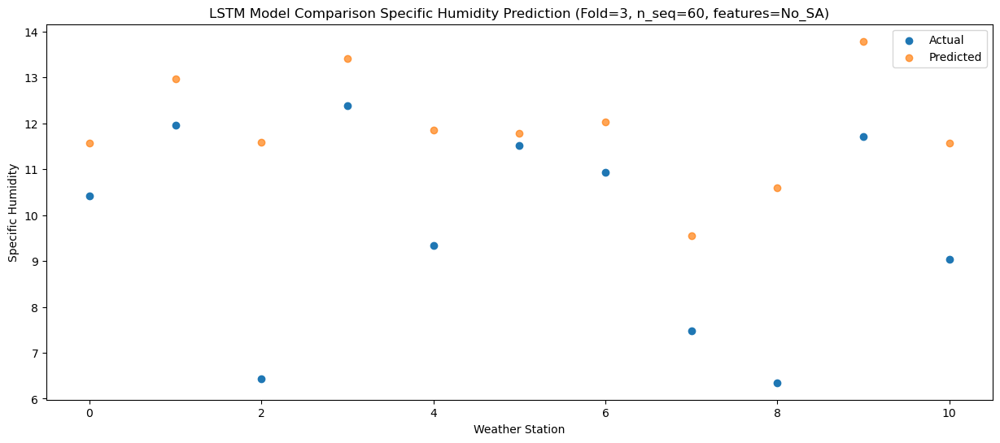

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   11.61868
1                 1   12.56   13.01868
2                 2    7.22   11.63868
3                 3   11.25   13.46868
4                 4    8.84   11.89868
5                 5   10.32   11.83868
6                 6   10.77   12.08868
7                 7   10.55    9.59868
8                 8    6.81   10.63868
9                 9   11.85   13.83868
10               10    8.66   11.61868


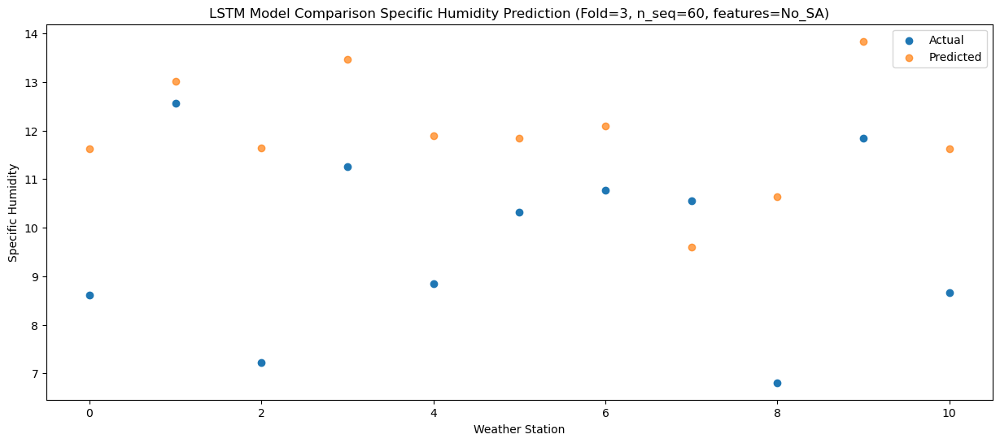

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   8.657167
1                 1    8.71  10.057167
2                 2    6.93   8.677167
3                 3    8.00  10.507167
4                 4    5.74   8.937167
5                 5    7.55   8.877167
6                 6    7.82   9.127167
7                 7    6.64   6.637167
8                 8    6.21   7.677167
9                 9    8.18  10.877167
10               10    5.64   8.657167


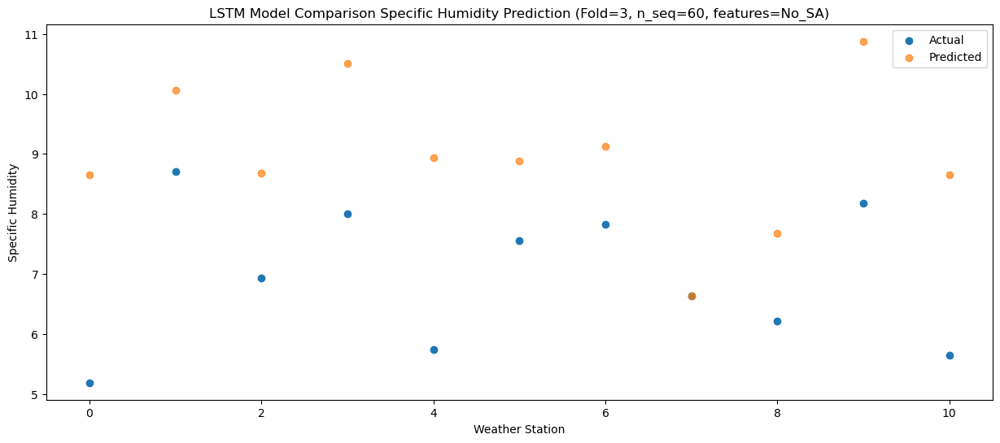

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   4.173173
1                 1    4.25   5.573173
2                 2    5.76   4.193173
3                 3    2.85   6.023173
4                 4    0.74   4.453173
5                 5    2.25   4.393173
6                 6    6.21   4.643173
7                 7    3.91   2.153173
8                 8    4.90   3.193173
9                 9    5.55   6.393173
10               10    2.22   4.173173


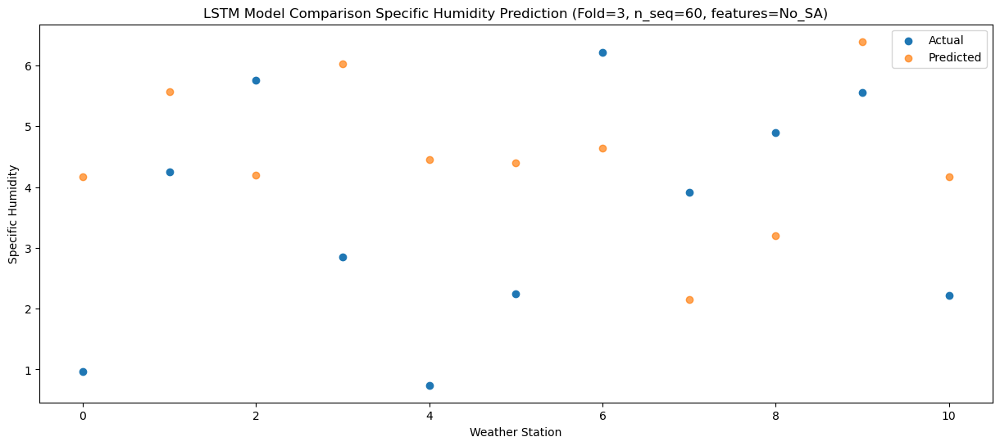

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51   3.488032
1                 1    3.22   4.888032
2                 2    3.04   3.508032
3                 3    2.04   5.338032
4                 4   -0.65   3.768032
5                 5    1.03   3.708032
6                 6    4.55   3.958032
7                 7    2.14   1.468032
8                 8    2.65   2.508032
9                 9    3.70   5.708032
10               10    1.00   3.488032


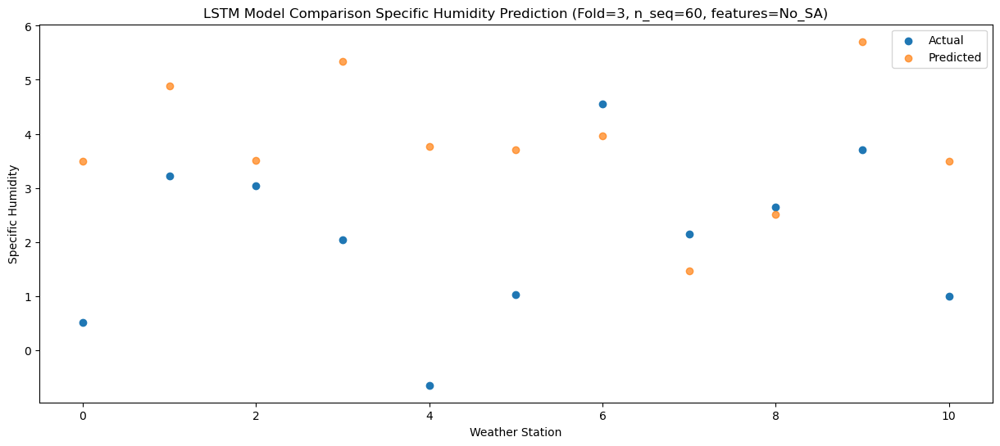

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69   2.002644
1                 1    2.03   3.402644
2                 2    3.88   2.022644
3                 3    1.01   3.852644
4                 4   -1.77   2.282644
5                 5    0.27   2.222644
6                 6    4.58   2.472644
7                 7    2.89  -0.017356
8                 8    3.44   1.022644
9                 9    1.73   4.222644
10               10   -0.92   2.002644


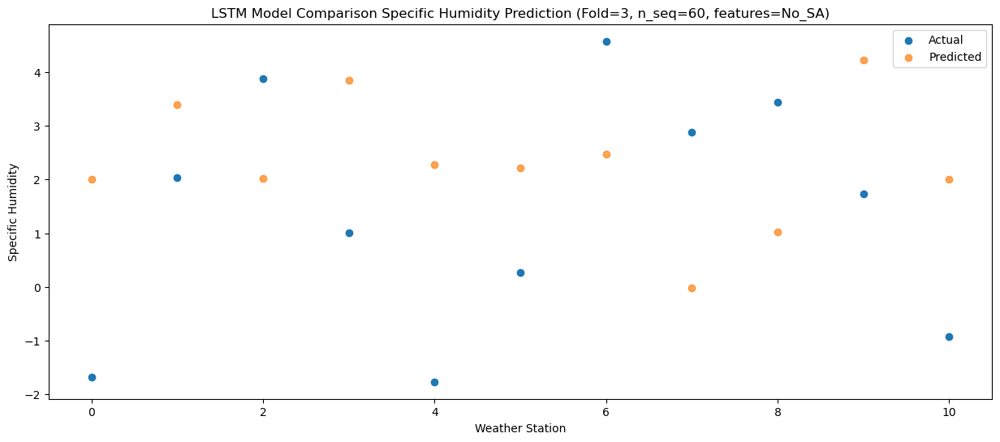

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78   2.366166
1                 1    1.95   3.766166
2                 2    4.03   2.386166
3                 3    1.55   4.216166
4                 4   -1.39   2.646166
5                 5    0.85   2.586166
6                 6    4.55   2.836166
7                 7    3.28   0.346166
8                 8    3.27   1.386166
9                 9    2.30   4.586166
10               10   -0.14   2.366166


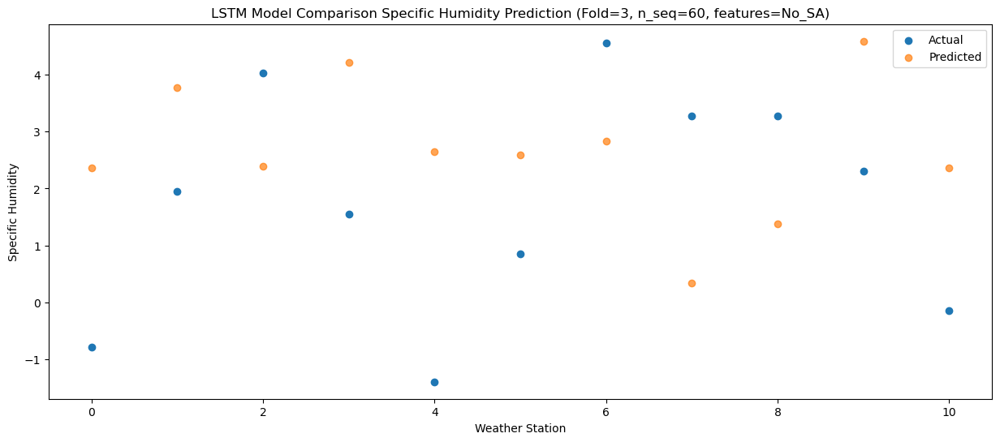

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05   2.683302
1                 1    2.11   4.083302
2                 2    2.90   2.703302
3                 3    1.37   4.533302
4                 4   -0.51   2.963302
5                 5    0.52   2.903302
6                 6    4.17   3.153302
7                 7    2.03   0.663302
8                 8    2.41   1.703302
9                 9    1.59   4.903302
10               10   -0.89   2.683302


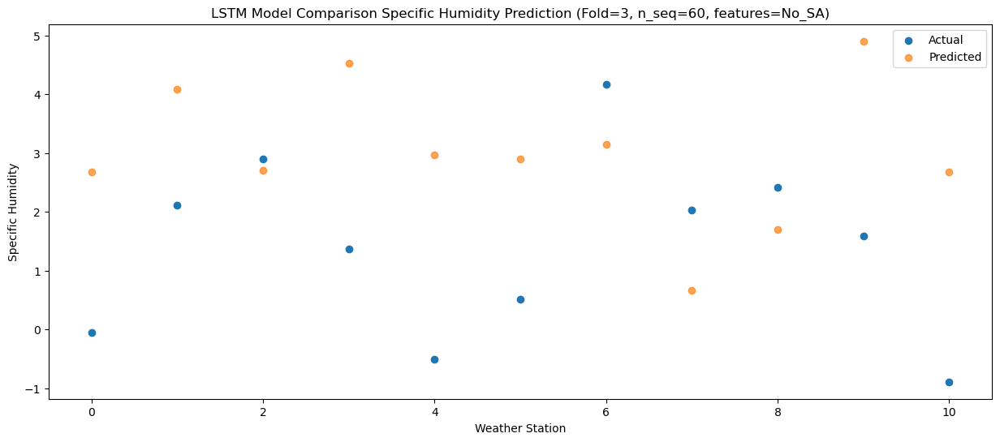

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44   2.796716
1                 1    3.05   4.196716
2                 2    4.42   2.816716
3                 3    1.24   4.646716
4                 4   -0.84   3.076716
5                 5    0.95   3.016716
6                 6    4.47   3.266716
7                 7    3.07   0.776716
8                 8    3.21   1.816716
9                 9    1.80   5.016716
10               10   -0.76   2.796716


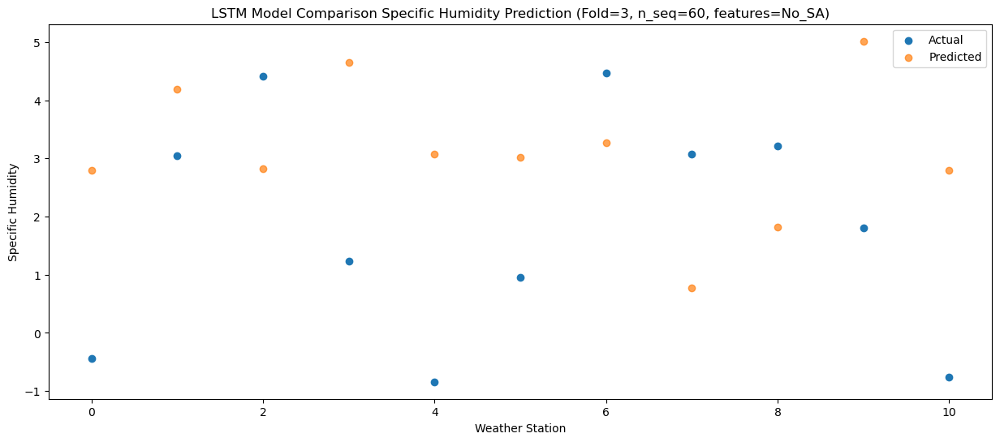

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55    4.09856
1                 1    3.92    5.49856
2                 2    4.62    4.11856
3                 3    2.78    5.94856
4                 4    0.39    4.37856
5                 5    2.26    4.31856
6                 6    5.10    4.56856
7                 7    2.22    2.07856
8                 8    3.59    3.11856
9                 9    4.04    6.31856
10               10    1.67    4.09856


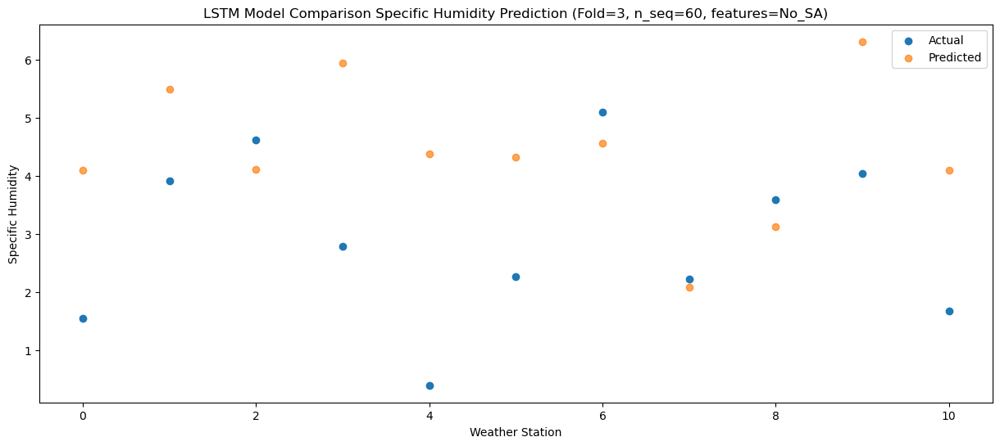

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00    6.67375
1                 1    8.33    8.07375
2                 2    5.56    6.69375
3                 3    5.69    8.52375
4                 4    3.57    6.95375
5                 5    4.86    6.89375
6                 6    7.26    7.14375
7                 7    3.76    4.65375
8                 8    5.18    5.69375
9                 9    4.56    8.89375
10               10    2.14    6.67375


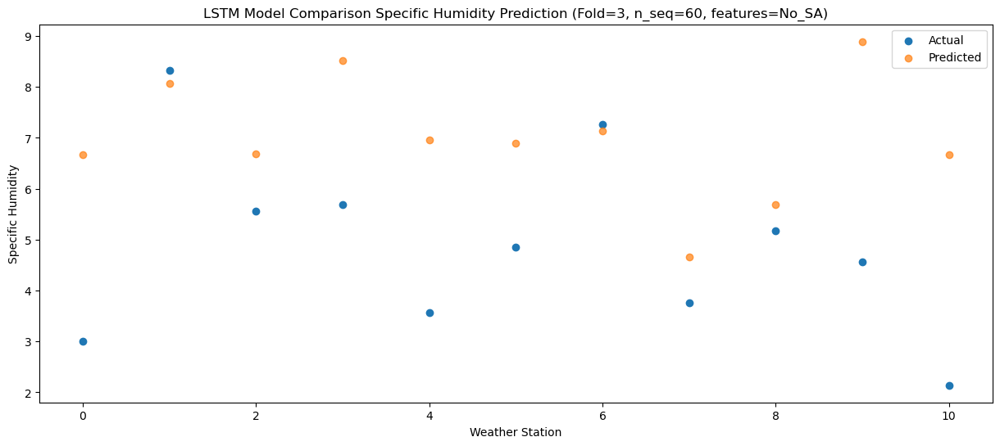

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27  10.643789
1                 1   10.97  12.043789
2                 2    6.33  10.663789
3                 3    7.71  12.493789
4                 4    5.70  10.923789
5                 5    7.02  10.863789
6                 6    7.49  11.113789
7                 7    4.26   8.623789
8                 8    5.24   9.663789
9                 9    8.26  12.863789
10               10    5.83  10.643789


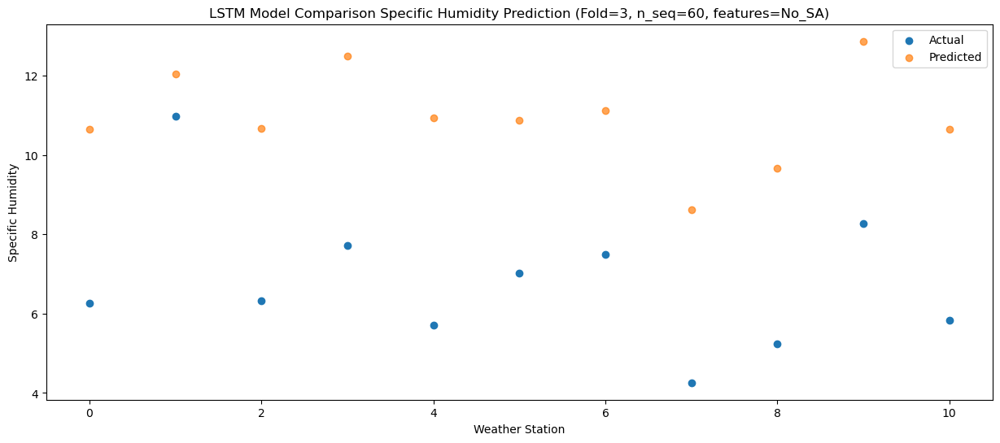

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22  12.770188
1                 1   13.24  14.170188
2                 2    7.43  12.790188
3                 3   11.36  14.620188
4                 4    9.47  13.050188
5                 5   11.53  12.990188
6                 6    8.33  13.240188
7                 7    5.23  10.750188
8                 8    6.08  11.790188
9                 9   13.11  14.990188
10               10    9.81  12.770188


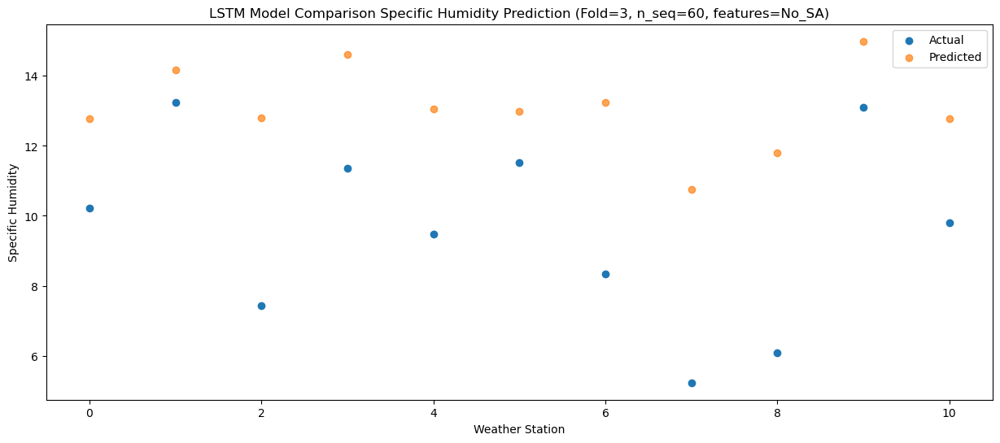

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32  11.676763
1                 1   13.48  13.076763
2                 2    8.50  11.696763
3                 3   10.81  13.526763
4                 4    9.86  11.956763
5                 5   10.65  11.896763
6                 6    9.98  12.146763
7                 7    7.81   9.656763
8                 8    7.35  10.696763
9                 9   10.54  13.896763
10               10    8.57  11.676763


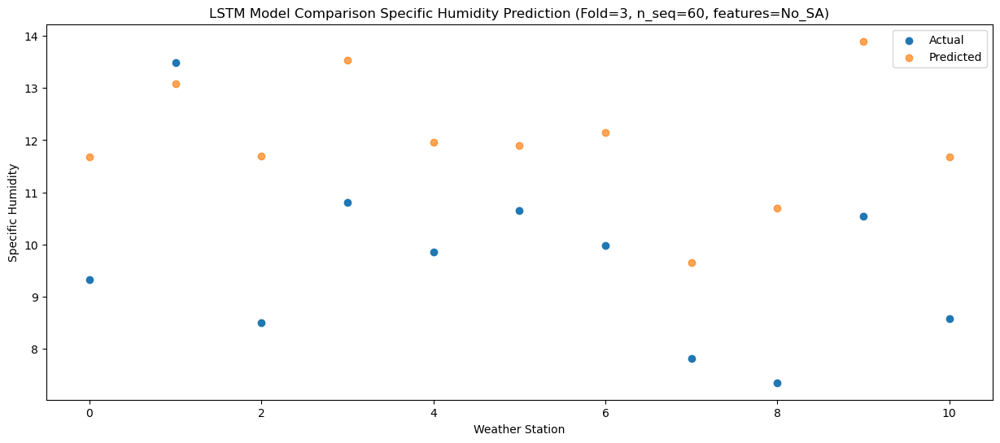

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   9.480872
1                 1    9.41  10.880872
2                 2    6.96   9.500872
3                 3    8.34  11.330872
4                 4    5.75   9.760872
5                 5    7.42   9.700872
6                 6    7.36   9.950872
7                 7    6.87   7.460872
8                 8    6.80   8.500872
9                 9    9.57  11.700872
10               10    6.88   9.480872


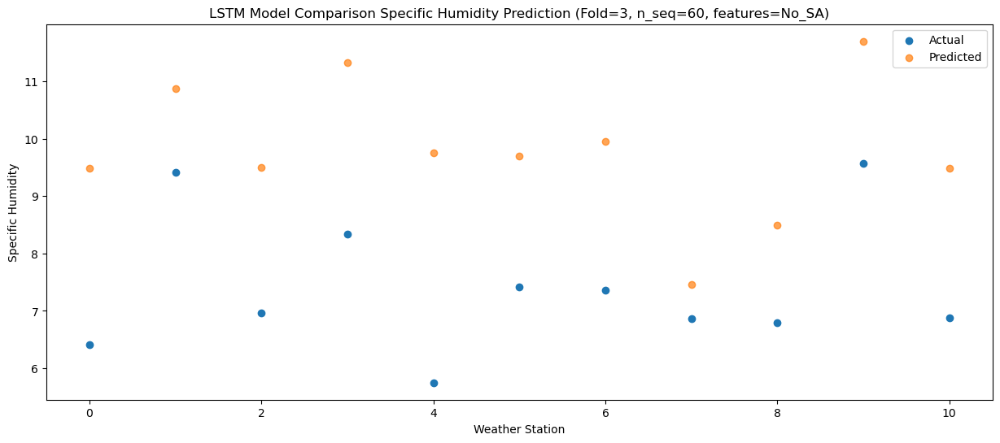

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   5.939585
1                 1    5.97   7.339585
2                 2    5.80   5.959585
3                 3    4.81   7.789585
4                 4    2.13   6.219585
5                 5    4.04   6.159585
6                 6    6.11   6.409585
7                 7    3.81   3.919585
8                 8    5.37   4.959585
9                 9    6.18   8.159585
10               10    3.61   5.939585


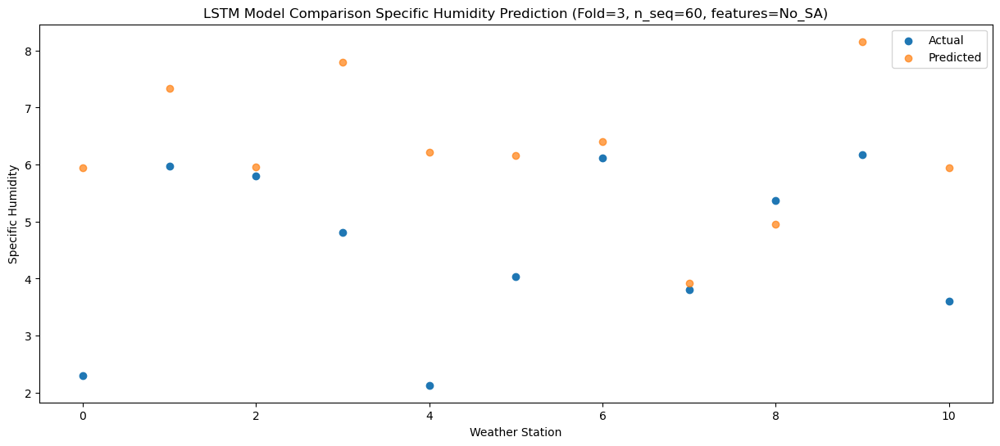

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93   2.962894
1                 1    3.09   4.362894
2                 2    3.69   2.982894
3                 3    1.42   4.812894
4                 4   -1.04   3.242894
5                 5    0.85   3.182894
6                 6    4.78   3.432894
7                 7    2.80   0.942894
8                 8    4.28   1.982894
9                 9    2.38   5.182894
10               10   -0.07   2.962894


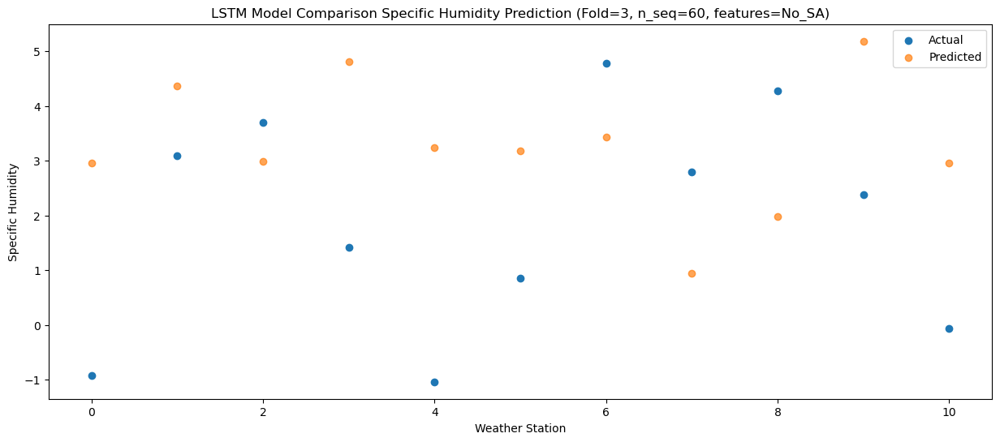

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94   2.595922
1                 1    2.27   3.995922
2                 2    3.92   2.615922
3                 3    1.44   4.445922
4                 4   -1.45   2.875922
5                 5    0.81   2.815922
6                 6    4.65   3.065922
7                 7    2.72   0.575922
8                 8    4.66   1.615922
9                 9    2.71   4.815922
10               10    0.31   2.595922


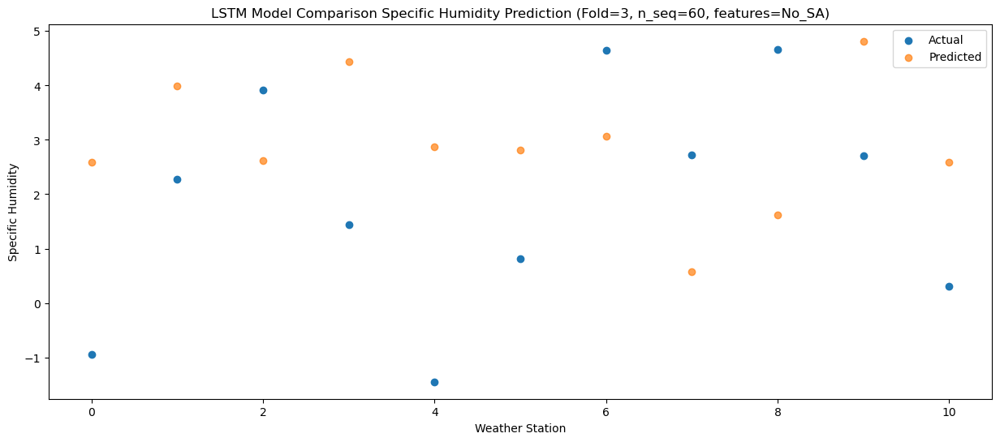

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59   1.748539
1                 1    0.96   3.148539
2                 2    4.46   1.768539
3                 3    0.70   3.598539
4                 4   -2.32   2.028539
5                 5   -0.07   1.968539
6                 6    4.59   2.218539
7                 7    3.26  -0.271461
8                 8    4.67   0.768539
9                 9    1.41   3.968539
10               10   -0.82   1.748539


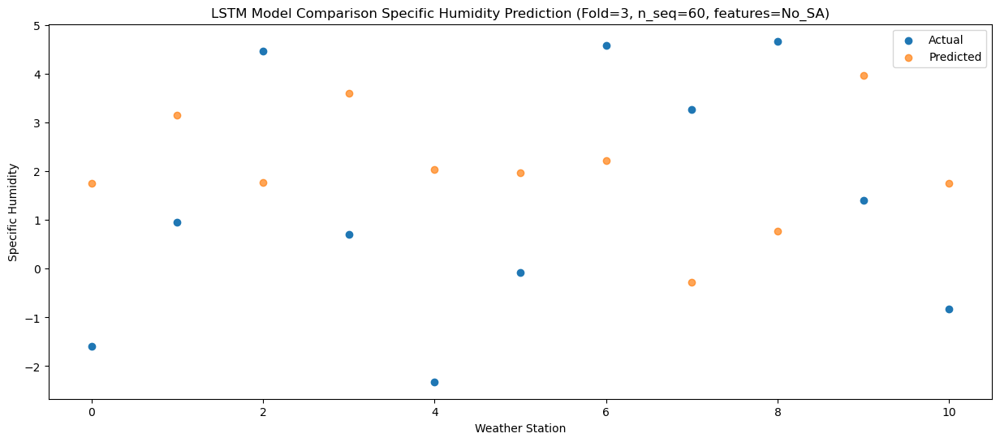

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53   2.129782
1                 1    2.38   3.529782
2                 2    4.63   2.149782
3                 3    1.02   3.979782
4                 4   -1.41   2.409782
5                 5    0.51   2.349782
6                 6    4.66   2.599782
7                 7    4.08   0.109782
8                 8    4.36   1.149782
9                 9    1.31   4.349782
10               10   -0.91   2.129782


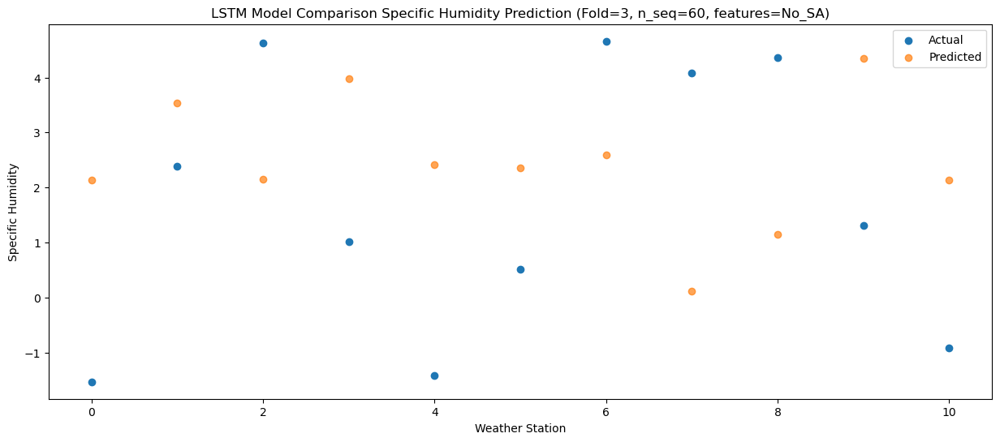

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03   3.361374
1                 1    3.80   4.761374
2                 2    4.34   3.381374
3                 3    1.98   5.211374
4                 4   -0.37   3.641374
5                 5    1.59   3.581374
6                 6    5.02   3.831374
7                 7    3.40   1.341374
8                 8    4.16   2.381374
9                 9    2.36   5.581374
10               10    0.14   3.361374


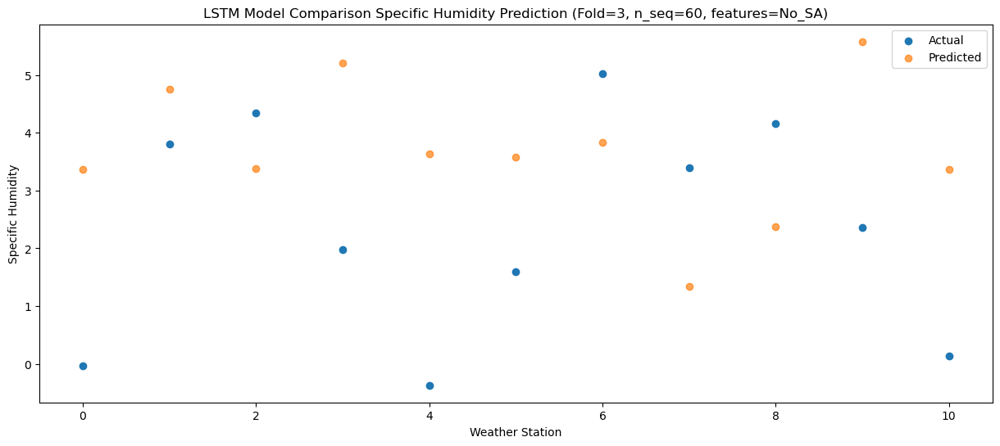

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   4.502699
1                 1    5.34   5.902699
2                 2    5.02   4.522699
3                 3    3.89   6.352699
4                 4    1.45   4.782699
5                 5    3.84   4.722699
6                 6    5.70   4.972699
7                 7    3.10   2.482699
8                 8    4.60   3.522699
9                 9    3.27   6.722699
10               10    1.74   4.502699


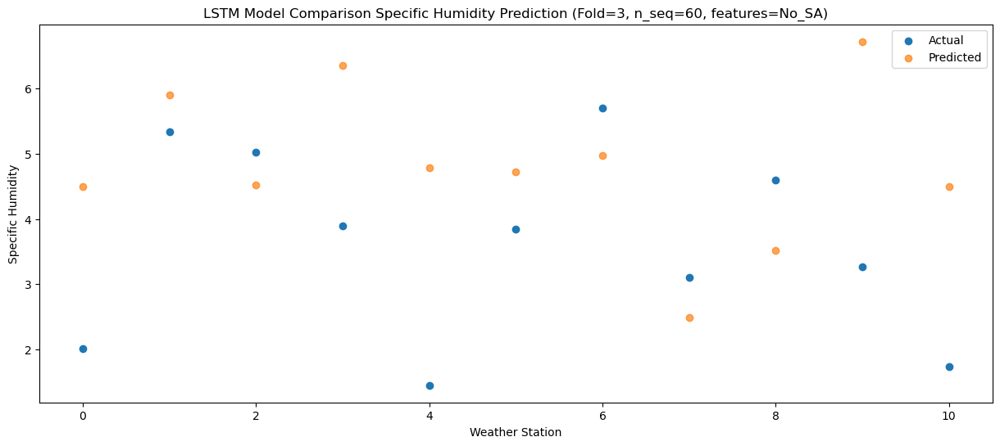

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   8.185694
1                 1    9.84   9.585694
2                 2    4.89   8.205694
3                 3    8.00  10.035694
4                 4    5.59   8.465694
5                 5    7.51   8.405694
6                 6    6.59   8.655694
7                 7    2.97   6.165694
8                 8    4.76   7.205694
9                 9    6.73  10.405694
10               10    5.37   8.185694


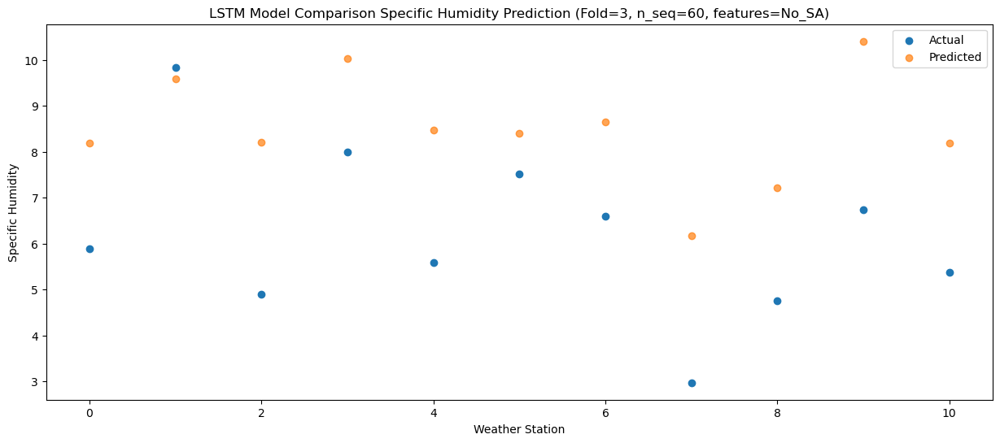

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61  10.663067
1                 1   12.12  12.063067
2                 2    6.16  10.683067
3                 3    9.80  12.513067
4                 4    7.56  10.943067
5                 5    9.33  10.883067
6                 6    8.88  11.133067
7                 7    4.37   8.643067
8                 8    5.91   9.683067
9                 9    9.60  12.883067
10               10    7.05  10.663067


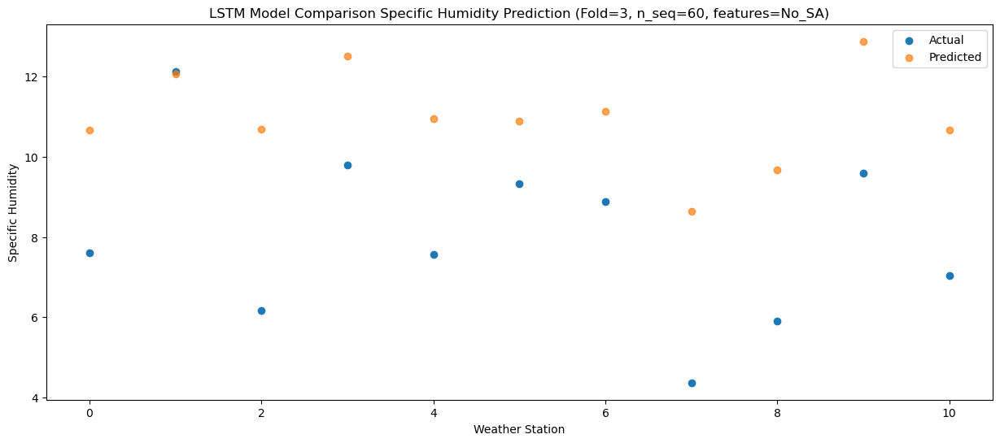

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47  11.573655
1                 1   12.61  12.973655
2                 2    8.14  11.593655
3                 3   10.70  13.423655
4                 4    9.13  11.853655
5                 5   10.52  11.793655
6                 6    8.93  12.043655
7                 7    5.40   9.553655
8                 8    7.49  10.593655
9                 9   12.77  13.793655
10               10    9.93  11.573655


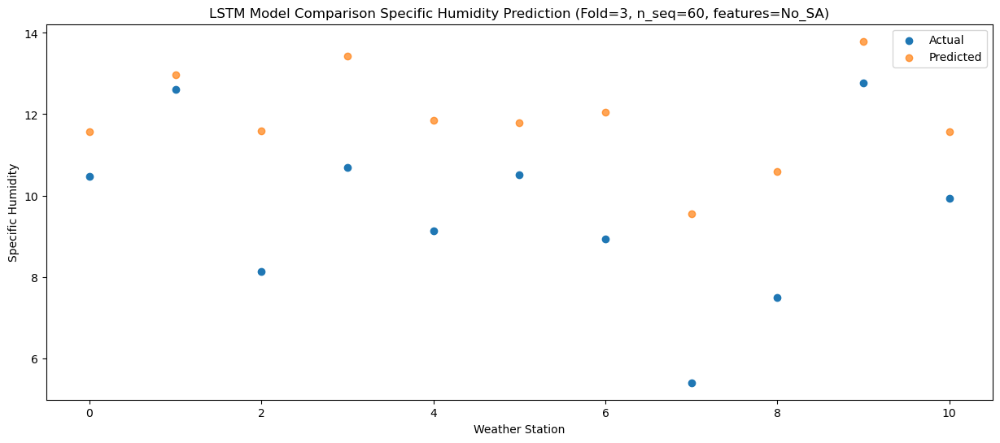

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03  11.210347
1                 1   11.87  12.610347
2                 2    6.45  11.230347
3                 3    9.38  13.060347
4                 4    8.65  11.490347
5                 5    9.96  11.430347
6                 6   10.39  11.680347
7                 7    6.22   9.190347
8                 8    6.76  10.230347
9                 9   11.42  13.430347
10               10    8.65  11.210347


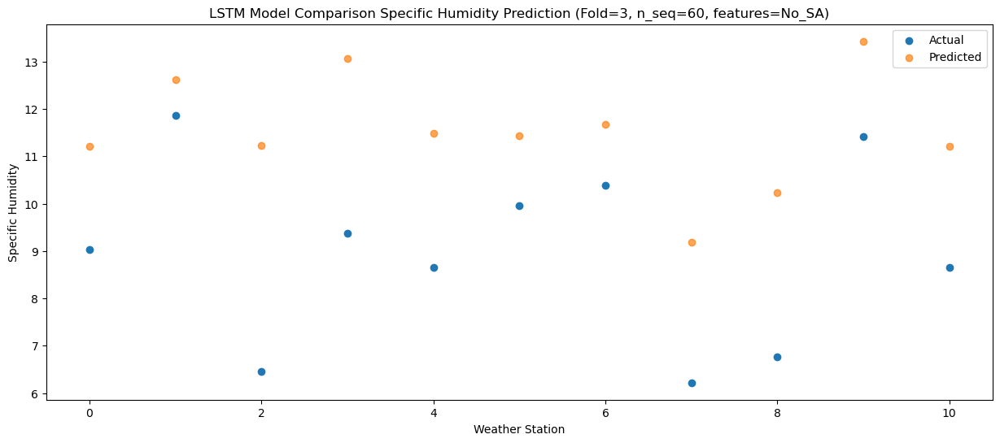

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32    9.46552
1                 1    8.88   10.86552
2                 2    6.72    9.48552
3                 3    7.84   11.31552
4                 4    5.64    9.74552
5                 5    7.34    9.68552
6                 6    7.97    9.93552
7                 7    4.50    7.44552
8                 8    6.44    8.48552
9                 9    8.06   11.68552
10               10    5.83    9.46552


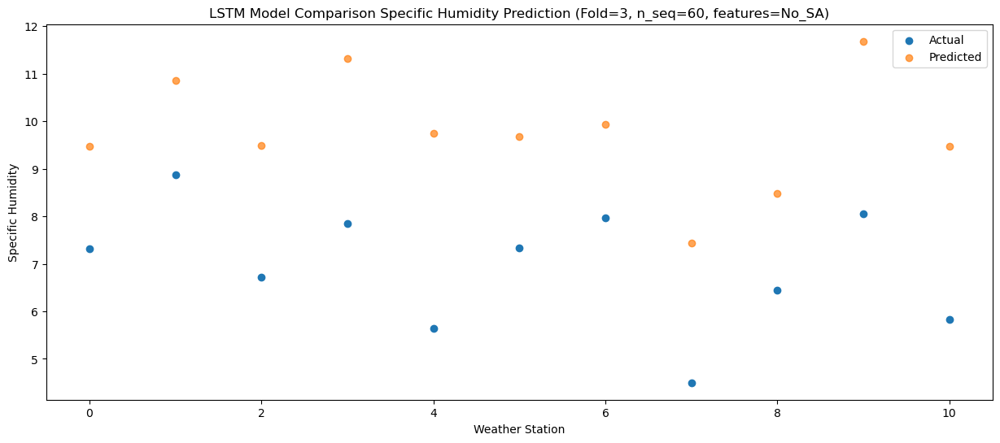

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50    5.20653
1                 1    4.65    6.60653
2                 2    5.61    5.22653
3                 3    4.09    7.05653
4                 4    1.28    5.48653
5                 5    3.47    5.42653
6                 6    6.21    5.67653
7                 7    3.45    3.18653
8                 8    4.85    4.22653
9                 9    4.96    7.42653
10               10    1.83    5.20653


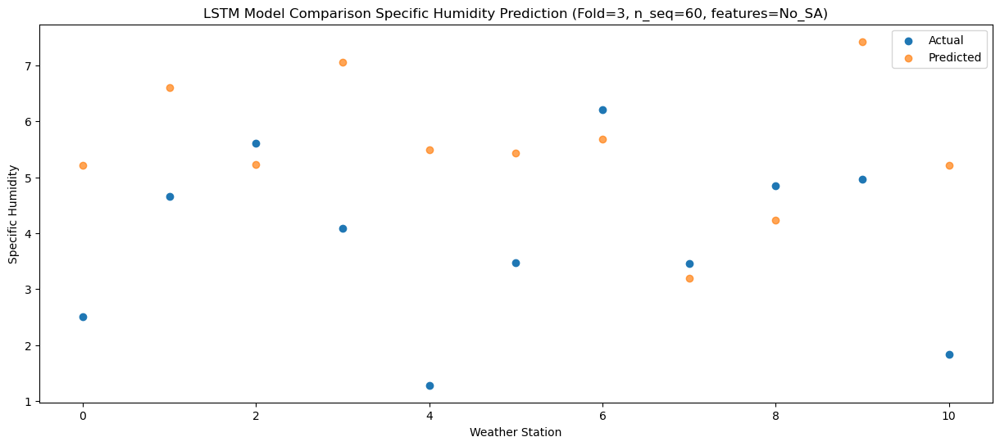

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

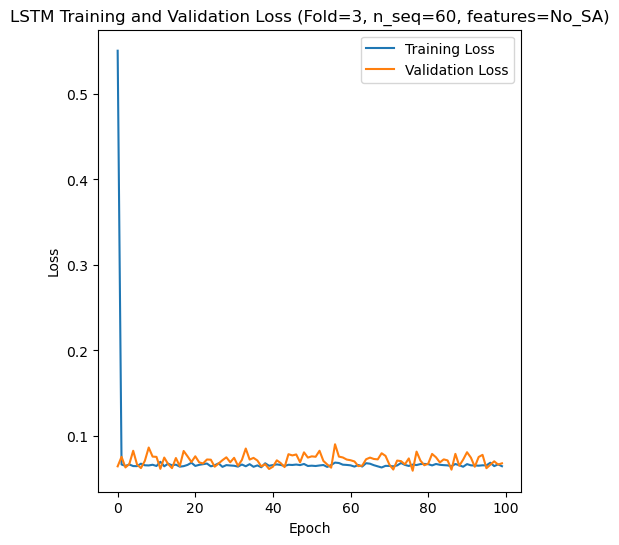

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 37s 179ms/step - loss: 0.5646 - accuracy: 0.2857 - mae: 0.5069 - rmse: 0.5646 - mape: 109.5786 - pearson: 0.6301 - val_loss: 0.0777 - val_accuracy: 0.7000 - val_mae: 0.0632 - val_rmse: 0.0777 - val_mape: 13.7427 - val_pearson: 0.7684
Epoch 2/100
84/84 [==============================] - 5s 60ms/step - loss: 0.0704 - accuracy: 0.5238 - mae: 0.0555 - rmse: 0.0704 - mape: 12.7243 - pearson: 0.7609 - val_loss: 0.0673 - val_accuracy: 0.0000e+00 - val_mae: 0.0543 - val_rmse: 0.0673 - val_mape: 12.4647 - val_pearson: 0.7511
Epoch 3/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0694 - accuracy: 0.4881 - mae: 0.0551 - rmse: 0.0694 - mape: 12.4821 - pearson: 0.764

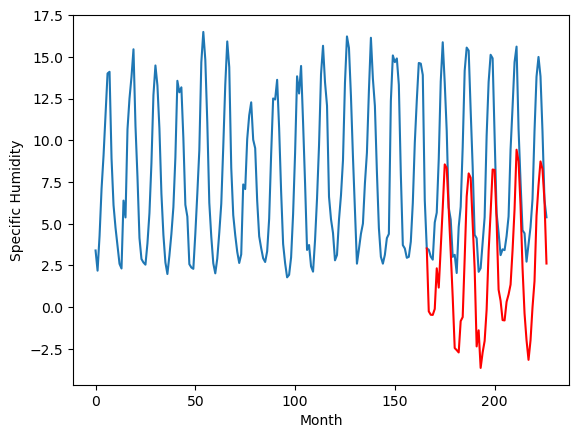

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.69		1.19
-1.74		-0.89		0.85
-3.30		-0.90		2.40
-2.46		-0.55		1.91
-1.08		1.89		2.97
0.13		0.74		0.61
0.78		3.11		2.33
4.11		5.51		1.40
5.85		8.12		2.27
6.09		7.90		1.81
5.51		5.44		-0.07
3.47		2.87		-0.60
0.41		0.16		-0.25
-4.33		-2.89		1.44
-3.98		-3.01		0.97
-1.99		-3.15		-1.16
-2.02		-1.27		0.75
-1.27		-1.03		0.24
0.06		2.49		2.43
4.35		6.19		1.84
5.56		7.58		2.02
5.95		7.32		1.37
5.15		4.60		-0.55
2.23		1.87		-0.36
-2.43		-2.79		-0.36
-0.69		-1.82		-1.13
-4.55		-4.08		0.47
-2.97		-3.15		-0.18
-1.44		-2.47		-1.03
-0.15		-0.58		-0.43
2.24		2.91		0.67
5.14		5.22		0.08
6.17		7.81		1.64
6.25		7.79		1.54
5.38		4.77		-0.61
0.60		0.61		0.01
0.77		-0.06		-0.83
-2.75		-1.21		1.54
-3.26		-1.23		2.03
-1.32		-0.12		1.20
-0.94		0.33		1.27
0.55		0.92		0.37
1.35		2.98		1.63
4.86		5.44		0.58
6.77		9.00		2.23
7.07		8.31		1.24
4.62		5.65		1.03
1.00		1.90		0.90
-1.30		-0.81		0.49
-2.39		-2.42		-0.0

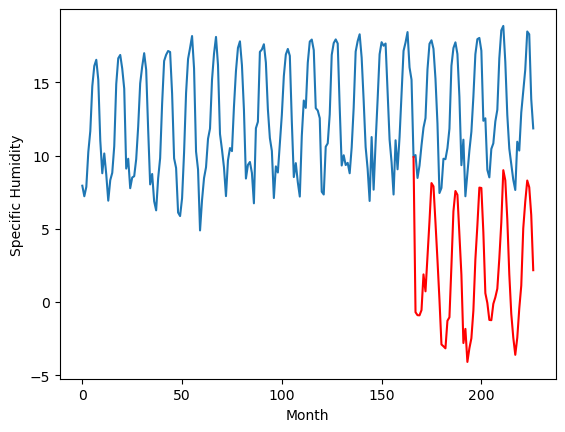

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		3.85		0.95
3.74		3.65		-0.09
3.60		3.64		0.04
3.41		3.99		0.58
6.96		6.43		-0.53
5.84		5.28		-0.56
8.08		7.65		-0.43
11.38		10.05		-1.33
14.31		12.66		-1.65
12.80		12.44		-0.36
10.75		9.98		-0.77
7.40		7.41		0.01
4.73		4.70		-0.03
2.35		1.65		-0.70
2.24		1.53		-0.71
2.12		1.39		-0.73
5.18		3.27		-1.91
5.43		3.51		-1.92
8.87		7.03		-1.84
13.11		10.73		-2.38
14.76		12.12		-2.64
14.77		11.86		-2.91
11.83		9.14		-2.69
9.05		6.41		-2.64
3.61		1.75		-1.86
6.56		2.72		-3.84
1.83		0.46		-1.37
2.68		1.39		-1.29
3.73		2.07		-1.66
6.18		3.96		-2.22
10.78		7.45		-3.33
13.16		9.76		-3.40
15.00		12.35		-2.65
14.82		12.33		-2.49
10.58		9.31		-1.27
5.62		5.15		-0.47
4.87		4.48		-0.39
4.33		3.33		-1.00
4.23		3.31		-0.92
4.90		4.42		-0.48
5.23		4.87		-0.36
6.07		5.46		-0.61
9.45		7.52		-1.93
13.02		9.98		-3.04
14.61		13.54		-1.07
13.03		12.85		-0.18
10.01		10.19		0.18
6.08		6.44		0.36
4.10		3.73		-0.37
2

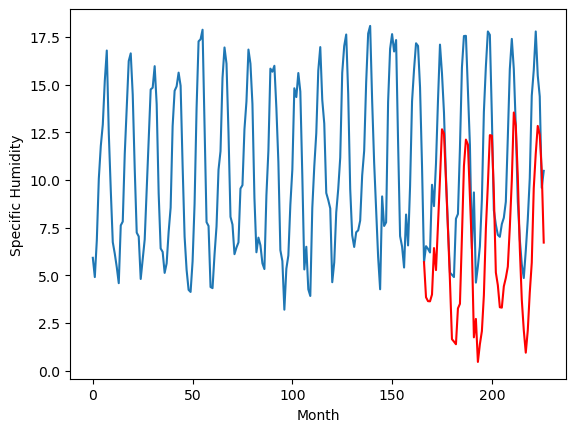

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		1.83		-1.37
2.20		1.63		-0.57
2.84		1.62		-1.22
2.22		1.97		-0.25
6.17		4.41		-1.76
5.77		3.26		-2.51
8.93		5.63		-3.30
11.09		8.03		-3.06
14.32		10.64		-3.68
11.73		10.42		-1.31
10.52		7.96		-2.56
5.95		5.39		-0.56
4.31		2.68		-1.63
1.71		-0.37		-2.08
1.60		-0.49		-2.09
1.28		-0.63		-1.91
3.94		1.25		-2.69
5.23		1.49		-3.74
9.23		5.01		-4.22
12.92		8.71		-4.21
13.49		10.10		-3.39
13.88		9.84		-4.04
9.87		7.12		-2.75
7.02		4.39		-2.63
3.40		-0.27		-3.67
5.26		0.70		-4.56
0.60		-1.56		-2.16
1.13		-0.63		-1.76
2.72		0.05		-2.67
6.23		1.94		-4.29
10.22		5.43		-4.79
11.99		7.74		-4.25
11.41		10.33		-1.08
12.42		10.31		-2.11
9.14		7.29		-1.85
4.68		3.13		-1.55
4.50		2.46		-2.04
2.92		1.31		-1.61
2.23		1.29		-0.94
2.59		2.40		-0.19
4.65		2.85		-1.80
5.33		3.44		-1.89
9.59		5.50		-4.09
13.53		7.96		-5.57
13.38		11.52		-1.86
11.28		10.83		-0.45
10.38		8.17		-2.21
6.66		4.42		-2.24
4.13		1.71		-

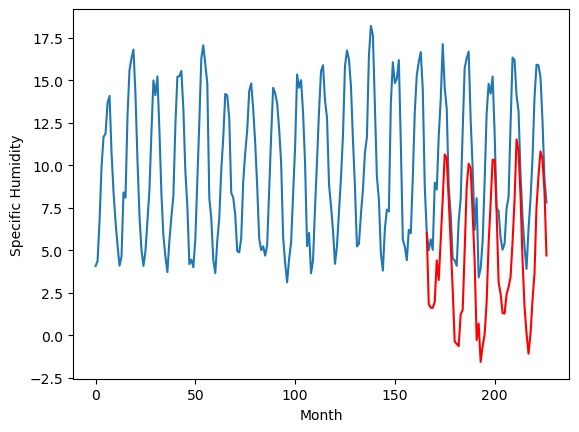

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		-0.01		-1.30
0.32		-0.21		-0.53
1.01		-0.22		-1.23
0.35		0.13		-0.22
4.25		2.57		-1.68
3.74		1.42		-2.32
6.98		3.79		-3.19
8.96		6.19		-2.77
12.11		8.80		-3.31
9.46		8.58		-0.88
8.57		6.12		-2.45
3.80		3.55		-0.25
2.44		0.84		-1.60
-0.13		-2.21		-2.08
-0.17		-2.33		-2.16
-0.62		-2.47		-1.85
1.96		-0.59		-2.55
3.32		-0.35		-3.67
7.61		3.17		-4.44
11.49		6.87		-4.62
11.87		8.26		-3.61
11.98		8.00		-3.98
8.08		5.28		-2.80
5.35		2.55		-2.80
1.74		-2.11		-3.85
3.15		-1.14		-4.29
-1.18		-3.40		-2.22
-0.74		-2.47		-1.73
0.78		-1.79		-2.57
4.46		0.10		-4.36
8.34		3.59		-4.75
10.02		5.90		-4.12
9.52		8.49		-1.03
10.69		8.47		-2.22
7.54		5.45		-2.09
3.08		1.29		-1.79
2.66		0.62		-2.04
1.07		-0.53		-1.60
0.32		-0.55		-0.87
0.72		0.56		-0.16
2.69		1.01		-1.68
3.54		1.60		-1.94
7.81		3.66		-4.15
11.29		6.12		-5.17
10.39		9.68		-0.71
9.01		8.99		-0.02
8.68		6.33		-2.35
5.02		2.58		-2.44
2.60		-0.13		

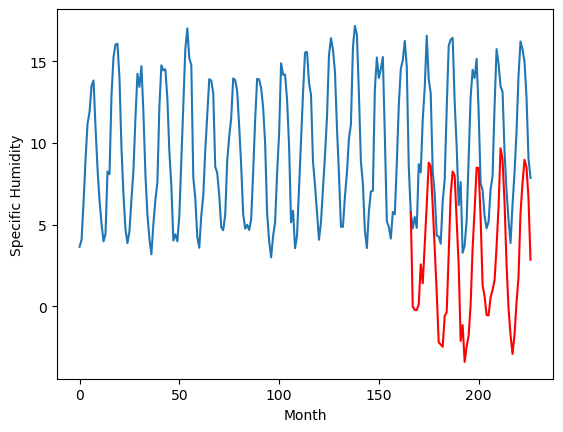

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		-0.44		-3.07
1.39		-0.64		-2.03
1.27		-0.65		-1.92
1.15		-0.30		-1.45
3.95		2.14		-1.81
3.20		0.99		-2.21
5.47		3.36		-2.11
7.18		5.76		-1.42
8.41		8.37		-0.04
7.10		8.15		1.05
6.91		5.69		-1.22
3.26		3.12		-0.14
2.80		0.41		-2.39
0.24		-2.64		-2.88
0.94		-2.76		-3.70
0.30		-2.90		-3.20
1.79		-1.02		-2.81
2.75		-0.78		-3.53
7.30		2.74		-4.56
9.60		6.44		-3.16
10.63		7.83		-2.80
10.35		7.57		-2.78
7.10		4.85		-2.25
4.05		2.12		-1.93
2.33		-2.54		-4.87
1.48		-1.57		-3.05
0.02		-3.83		-3.85
0.01		-2.90		-2.91
0.60		-2.22		-2.82
2.63		-0.33		-2.96
4.89		3.16		-1.73
7.74		5.47		-2.27
8.43		8.06		-0.37
10.42		8.04		-2.38
9.17		5.02		-4.15
5.66		0.86		-4.80
2.96		0.19		-2.77
2.32		-0.96		-3.28
0.77		-0.98		-1.75
0.89		0.13		-0.76
2.18		0.58		-1.60
2.15		1.17		-0.98
6.99		3.23		-3.76
10.85		5.69		-5.16
8.52		9.25		0.73
7.66		8.56		0.90
8.17		5.90		-2.27
6.04		2.15		-3.89
3.74		-0.56		-4.30
2.16

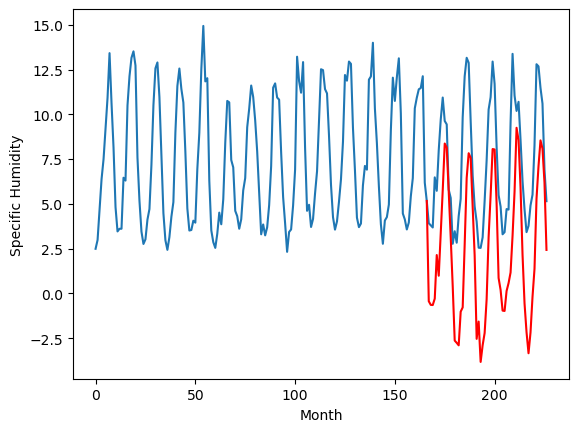

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.60		1.37
-2.90		-1.80		1.10
-3.06		-1.81		1.25
-2.48		-1.46		1.02
-0.29		0.98		1.27
-0.96		-0.17		0.79
2.16		2.20		0.04
5.99		4.60		-1.39
8.58		7.21		-1.37
8.79		6.99		-1.80
4.95		4.53		-0.42
2.30		1.96		-0.34
-0.53		-0.75		-0.22
-3.87		-3.80		0.07
-3.99		-3.92		0.07
-3.74		-4.06		-0.32
-2.03		-2.18		-0.15
-1.62		-1.94		-0.32
1.36		1.58		0.22
6.05		5.28		-0.77
7.65		6.67		-0.98
8.03		6.41		-1.62
4.45		3.69		-0.76
2.24		0.96		-1.28
-3.48		-3.70		-0.22
-1.62		-2.73		-1.11
-4.60		-4.99		-0.39
-3.28		-4.06		-0.78
-2.44		-3.38		-0.94
-1.38		-1.49		-0.11
2.63		2.00		-0.63
4.91		4.31		-0.60
8.07		6.90		-1.17
6.88		6.88		-0.00
3.33		3.86		0.53
-1.35		-0.30		1.05
-1.53		-0.97		0.56
-3.52		-2.12		1.40
-2.89		-2.14		0.75
-1.85		-1.03		0.82
-2.36		-0.58		1.78
-0.76		0.01		0.77
1.46		2.07		0.61
4.51		4.53		0.02
7.90		8.09		0.19
7.44		7.40		-0.04
3.99		4.74		0.75
0.08		0.99		0.91
-2.87		-1.72		1.

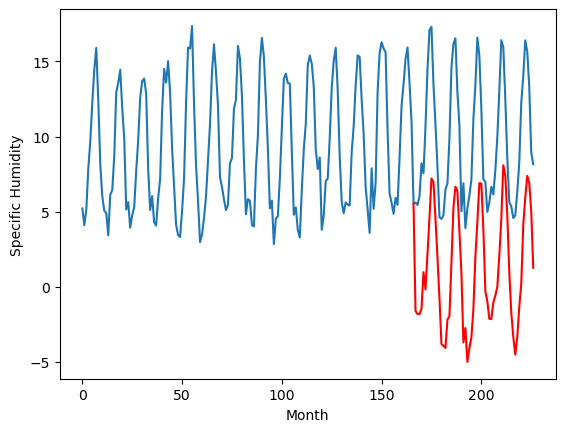

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		1.13		-0.68
1.54		0.93		-0.61
1.30		0.92		-0.38
1.07		1.27		0.20
3.62		3.71		0.09
3.94		2.56		-1.38
7.32		4.93		-2.39
10.93		7.33		-3.60
12.98		9.94		-3.04
10.33		9.72		-0.61
8.73		7.26		-1.47
4.18		4.69		0.51
2.51		1.98		-0.53
0.58		-1.07		-1.65
0.43		-1.19		-1.62
-0.20		-1.33		-1.13
2.17		0.55		-1.62
3.09		0.79		-2.30
6.25		4.31		-1.94
10.85		8.01		-2.84
11.80		9.40		-2.40
11.54		9.14		-2.40
8.28		6.42		-1.86
6.19		3.69		-2.50
1.50		-0.97		-2.47
2.97		-0.00		-2.97
-0.23		-2.26		-2.03
0.28		-1.33		-1.61
1.79		-0.65		-2.44
3.58		1.24		-2.34
8.29		4.73		-3.56
10.65		7.04		-3.61
11.45		9.63		-1.82
11.92		9.61		-2.31
8.11		6.59		-1.52
3.45		2.43		-1.02
2.09		1.76		-0.33
1.22		0.61		-0.61
1.50		0.59		-0.91
1.31		1.70		0.39
2.07		2.15		0.08
2.97		2.74		-0.23
7.36		4.80		-2.56
9.92		7.26		-2.66
12.71		10.82		-1.89
12.99		10.13		-2.86
8.79		7.47		-1.32
5.18		3.72		-1.46
2.15		1.01		-1.14
1.34	

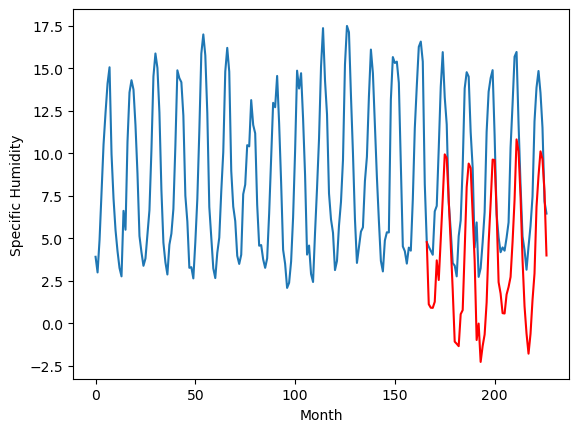

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		-0.17		-0.57
0.57		-0.37		-0.94
0.20		-0.38		-0.58
-0.20		-0.03		0.17
1.72		2.41		0.69
2.00		1.26		-0.74
5.15		3.63		-1.52
7.89		6.03		-1.86
11.11		8.64		-2.47
9.44		8.42		-1.02
6.52		5.96		-0.56
3.14		3.39		0.25
1.46		0.68		-0.78
-0.14		-2.37		-2.23
-0.49		-2.49		-2.00
-1.06		-2.63		-1.57
0.88		-0.75		-1.63
2.21		-0.51		-2.72
4.50		3.01		-1.49
9.56		6.71		-2.85
10.82		8.10		-2.72
10.96		7.84		-3.12
7.48		5.12		-2.36
6.33		2.39		-3.94
0.56		-2.27		-2.83
1.27		-1.30		-2.57
-1.11		-3.56		-2.45
-0.53		-2.63		-2.10
0.78		-1.95		-2.73
2.27		-0.06		-2.33
6.29		3.43		-2.86
7.73		5.74		-1.99
10.47		8.33		-2.14
10.11		8.31		-1.80
7.45		5.29		-2.16
2.12		1.13		-0.99
1.08		0.46		-0.62
0.12		-0.69		-0.81
0.74		-0.71		-1.45
0.34		0.40		0.06
0.69		0.85		0.16
2.14		1.44		-0.70
4.39		3.50		-0.89
6.35		5.96		-0.39
10.65		9.52		-1.13
10.11		8.83		-1.28
7.31		6.17		-1.14
3.98		2.42		-1.56
0.91		-0.29		-1.

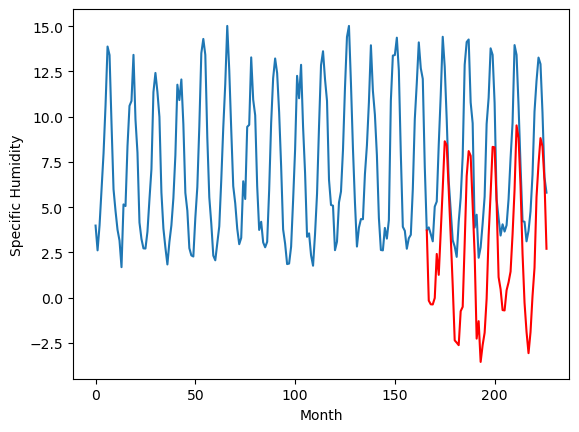

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		-0.11		-1.06
1.12		-0.31		-1.43
0.64		-0.32		-0.96
0.37		0.03		-0.34
2.42		2.47		0.05
3.01		1.32		-1.69
6.73		3.69		-3.04
9.21		6.09		-3.12
12.77		8.70		-4.07
10.58		8.48		-2.10
7.80		6.02		-1.78
3.64		3.45		-0.19
2.55		0.74		-1.81
0.64		-2.31		-2.95
0.32		-2.43		-2.75
-0.32		-2.57		-2.25
2.05		-0.69		-2.74
3.36		-0.45		-3.81
5.98		3.07		-2.91
10.73		6.77		-3.96
12.13		8.16		-3.97
12.38		7.90		-4.48
8.35		5.18		-3.17
6.48		2.45		-4.03
1.19		-2.21		-3.40
1.73		-1.24		-2.97
-0.51		-3.50		-2.99
0.19		-2.57		-2.76
1.71		-1.89		-3.60
3.01		-0.00		-3.01
7.08		3.49		-3.59
9.32		5.80		-3.52
11.96		8.39		-3.57
11.19		8.37		-2.82
7.82		5.35		-2.47
3.06		1.19		-1.87
1.69		0.52		-1.17
0.58		-0.63		-1.21
1.10		-0.65		-1.75
0.87		0.46		-0.41
1.48		0.91		-0.57
2.99		1.50		-1.49
5.77		3.56		-2.21
7.41		6.02		-1.39
12.11		9.58		-2.53
11.98		8.89		-3.09
8.20		6.23		-1.97
4.76		2.48		-2.28
1.37		-0.23		-

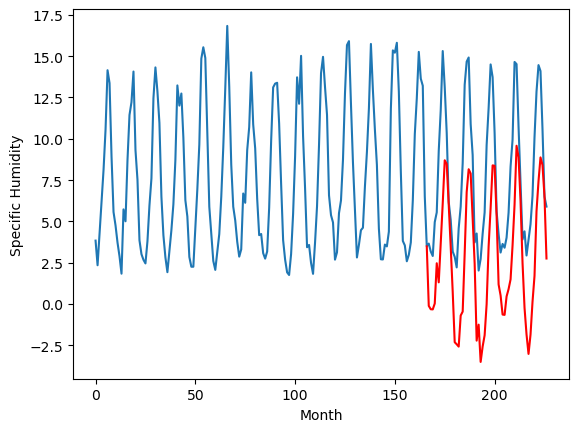

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		-0.25		-0.40
0.30		-0.45		-0.75
-0.04		-0.46		-0.42
-0.39		-0.11		0.28
1.18		2.33		1.15
1.02		1.18		0.16
3.64		3.55		-0.09
6.83		5.95		-0.88
9.75		8.56		-1.19
8.33		8.34		0.01
6.19		5.88		-0.31
3.15		3.31		0.16
1.22		0.60		-0.62
-0.11		-2.45		-2.34
-0.49		-2.57		-2.08
-1.06		-2.71		-1.65
0.23		-0.83		-1.06
1.90		-0.59		-2.49
3.50		2.93		-0.57
8.51		6.63		-1.88
9.78		8.02		-1.76
10.65		7.76		-2.89
6.89		5.04		-1.85
5.88		2.31		-3.57
0.64		-2.35		-2.99
0.60		-1.38		-1.98
-1.14		-3.64		-2.50
-0.69		-2.71		-2.02
0.46		-2.03		-2.49
1.45		-0.14		-1.59
4.91		3.35		-1.56
6.82		5.66		-1.16
8.55		8.25		-0.30
9.01		8.23		-0.78
7.02		5.21		-1.81
2.20		1.05		-1.15
1.48		0.38		-1.10
0.03		-0.77		-0.80
0.65		-0.79		-1.44
-0.10		0.32		0.42
0.11		0.77		0.66
1.81		1.36		-0.45
2.71		3.42		0.71
5.95		5.88		-0.07
9.57		9.44		-0.13
8.77		8.75		-0.02
7.06		6.09		-0.97
4.00		2.34		-1.66
0.56		-0.37		-0.93
1.0

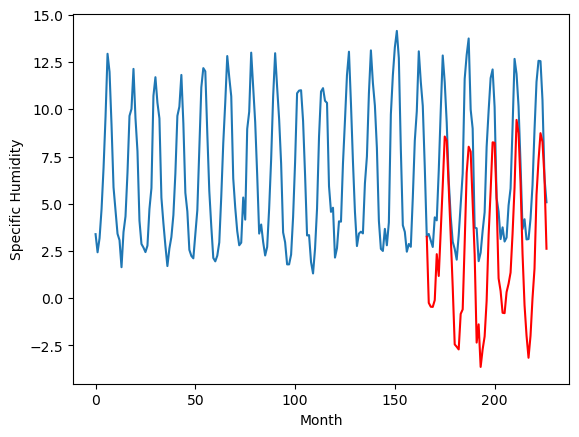

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95  -0.249201
1                 1   -1.88  -0.689201
2                 2    2.90   3.850799
3                 3    3.20   1.830799
4                 4    1.29  -0.009201
5                 5    2.63  -0.439201
6                 6   -2.97  -1.599201
7                 7    1.81   1.130799
8                 8    0.40  -0.169201
9                 9    0.95  -0.109201
10               10    0.15  -0.249201


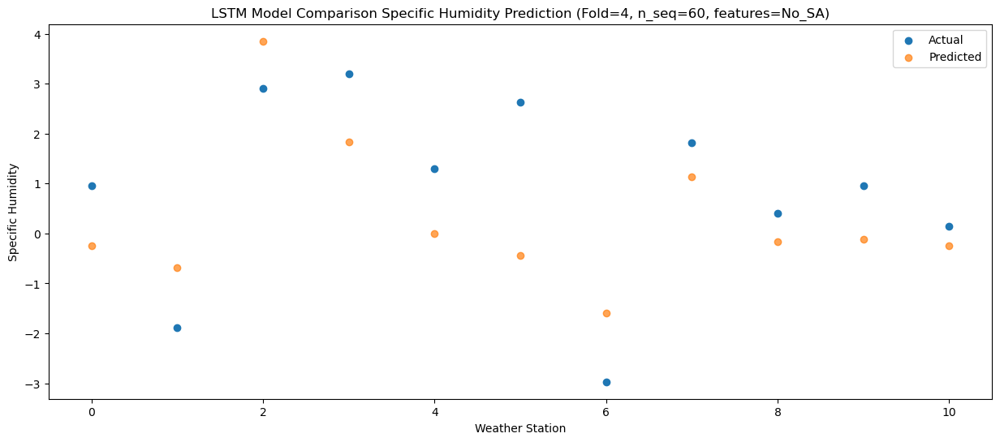

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88  -0.452744
1                 1   -1.74  -0.892744
2                 2    3.74   3.647256
3                 3    2.20   1.627256
4                 4    0.32  -0.212744
5                 5    1.39  -0.642744
6                 6   -2.90  -1.802744
7                 7    1.54   0.927256
8                 8    0.57  -0.372744
9                 9    1.12  -0.312744
10               10    0.30  -0.452744


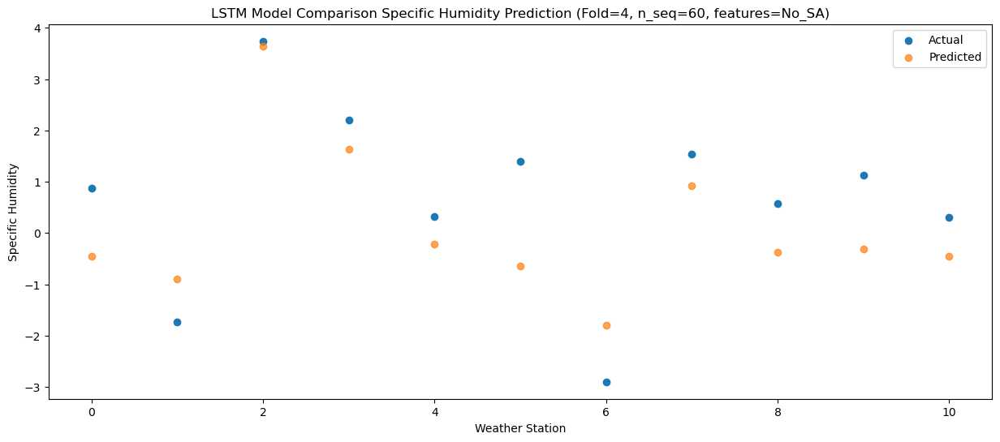

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46  -0.461443
1                 1   -3.30  -0.901443
2                 2    3.60   3.638557
3                 3    2.84   1.618557
4                 4    1.01  -0.221443
5                 5    1.27  -0.651443
6                 6   -3.06  -1.811443
7                 7    1.30   0.918557
8                 8    0.20  -0.381443
9                 9    0.64  -0.321443
10               10   -0.04  -0.461443


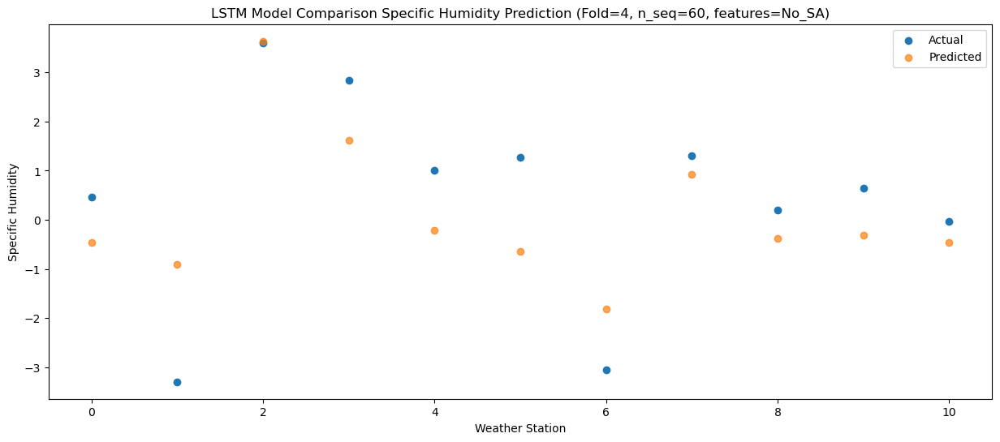

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28  -0.105152
1                 1   -2.46  -0.545152
2                 2    3.41   3.994848
3                 3    2.22   1.974848
4                 4    0.35   0.134848
5                 5    1.15  -0.295152
6                 6   -2.48  -1.455152
7                 7    1.07   1.274848
8                 8   -0.20  -0.025152
9                 9    0.37   0.034848
10               10   -0.39  -0.105152


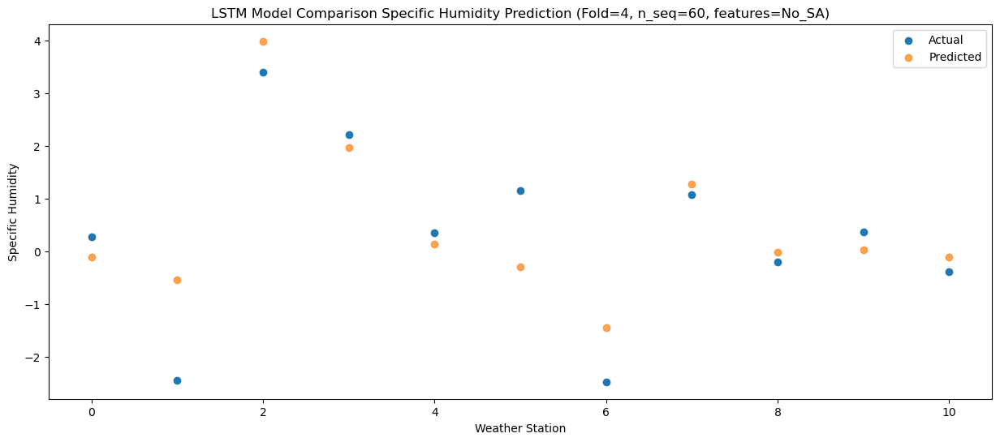

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   2.331107
1                 1   -1.08   1.891107
2                 2    6.96   6.431107
3                 3    6.17   4.411107
4                 4    4.25   2.571107
5                 5    3.95   2.141107
6                 6   -0.29   0.981107
7                 7    3.62   3.711107
8                 8    1.72   2.411107
9                 9    2.42   2.471107
10               10    1.18   2.331107


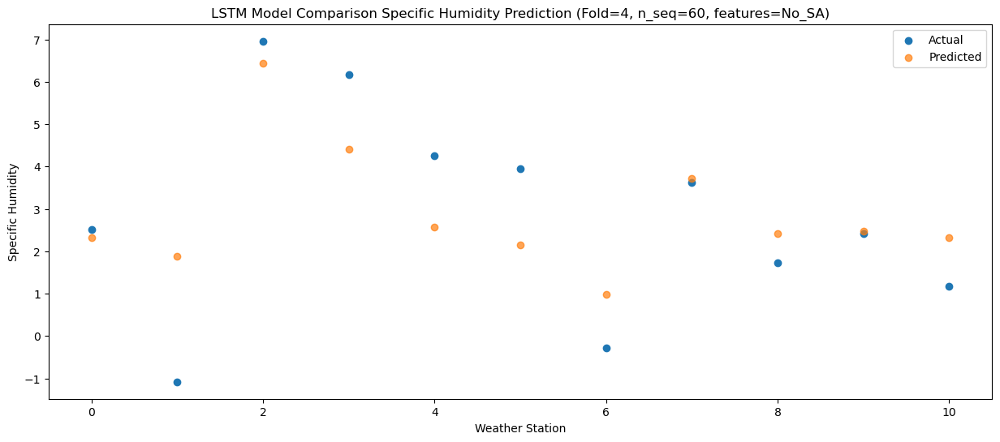

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   1.176143
1                 1    0.13   0.736143
2                 2    5.84   5.276143
3                 3    5.77   3.256143
4                 4    3.74   1.416143
5                 5    3.20   0.986143
6                 6   -0.96  -0.173857
7                 7    3.94   2.556143
8                 8    2.00   1.256143
9                 9    3.01   1.316143
10               10    1.02   1.176143


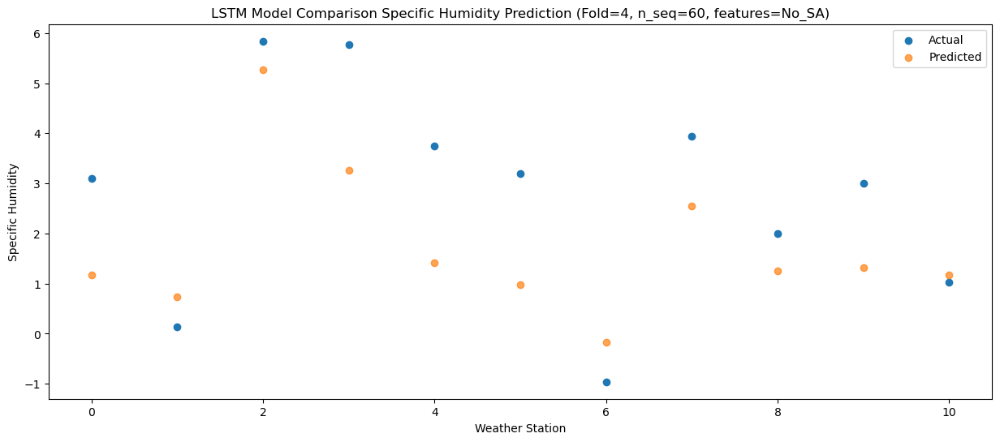

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   3.554512
1                 1    0.78   3.114512
2                 2    8.08   7.654512
3                 3    8.93   5.634512
4                 4    6.98   3.794512
5                 5    5.47   3.364512
6                 6    2.16   2.204512
7                 7    7.32   4.934512
8                 8    5.15   3.634512
9                 9    6.73   3.694512
10               10    3.64   3.554512


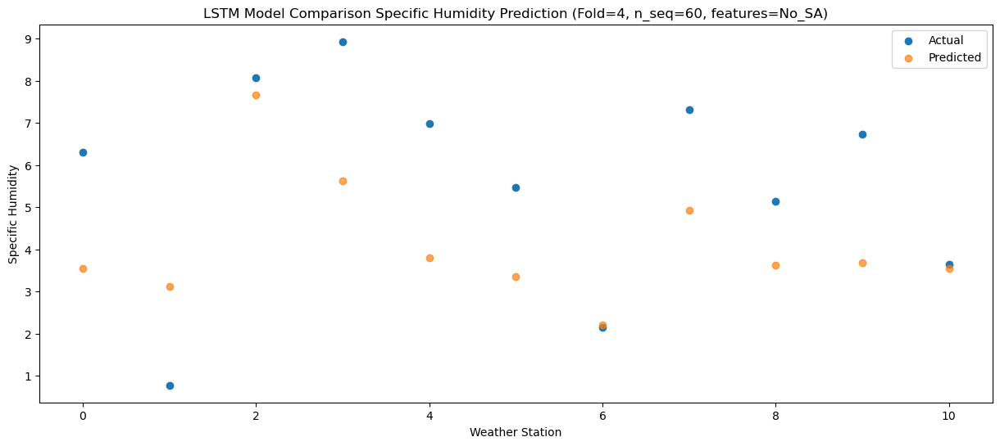

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   5.954036
1                 1    4.11   5.514036
2                 2   11.38  10.054036
3                 3   11.09   8.034036
4                 4    8.96   6.194036
5                 5    7.18   5.764036
6                 6    5.99   4.604036
7                 7   10.93   7.334036
8                 8    7.89   6.034036
9                 9    9.21   6.094036
10               10    6.83   5.954036


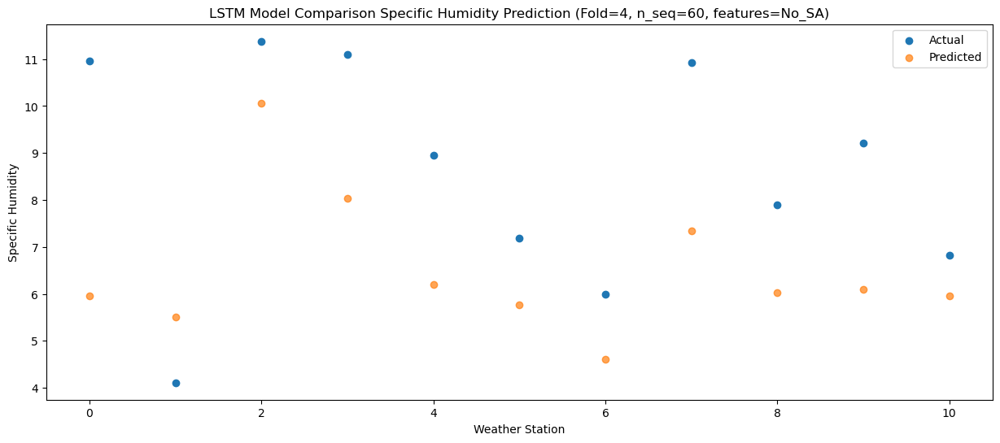

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31    8.56037
1                 1    5.85    8.12037
2                 2   14.31   12.66037
3                 3   14.32   10.64037
4                 4   12.11    8.80037
5                 5    8.41    8.37037
6                 6    8.58    7.21037
7                 7   12.98    9.94037
8                 8   11.11    8.64037
9                 9   12.77    8.70037
10               10    9.75    8.56037


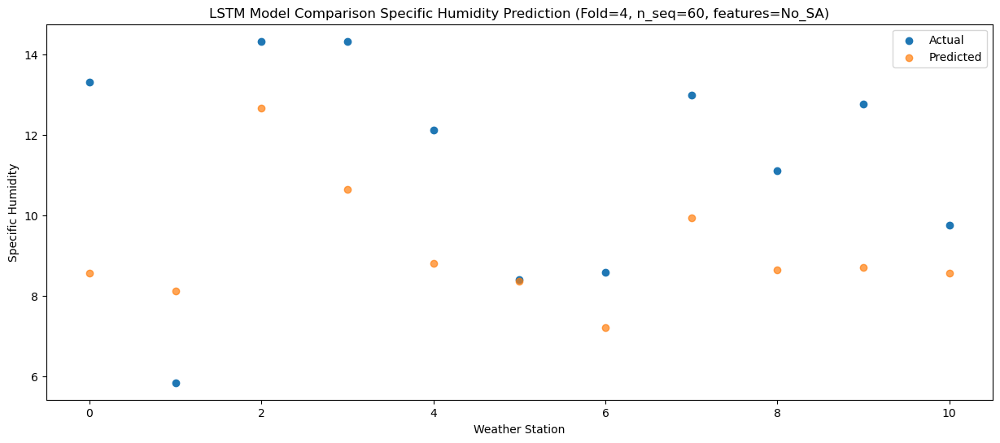

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88   8.336912
1                 1    6.09   7.896912
2                 2   12.80  12.436912
3                 3   11.73  10.416912
4                 4    9.46   8.576912
5                 5    7.10   8.146912
6                 6    8.79   6.986912
7                 7   10.33   9.716912
8                 8    9.44   8.416912
9                 9   10.58   8.476912
10               10    8.33   8.336912


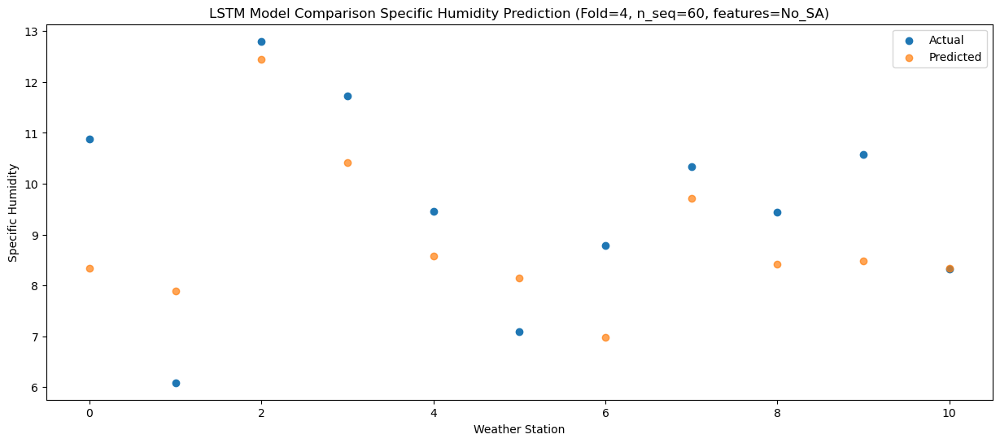

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   5.875087
1                 1    5.51   5.435087
2                 2   10.75   9.975087
3                 3   10.52   7.955087
4                 4    8.57   6.115087
5                 5    6.91   5.685087
6                 6    4.95   4.525087
7                 7    8.73   7.255087
8                 8    6.52   5.955087
9                 9    7.80   6.015087
10               10    6.19   5.875087


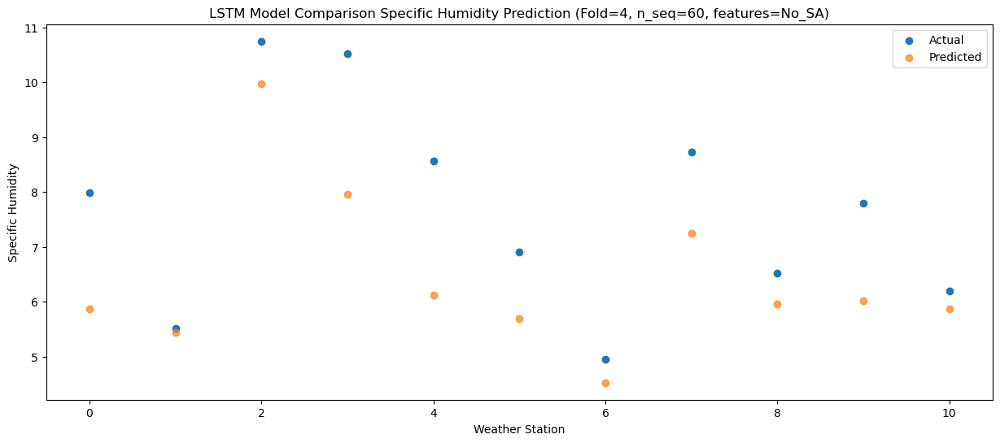

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   3.314337
1                 1    3.47   2.874337
2                 2    7.40   7.414337
3                 3    5.95   5.394337
4                 4    3.80   3.554337
5                 5    3.26   3.124337
6                 6    2.30   1.964337
7                 7    4.18   4.694337
8                 8    3.14   3.394337
9                 9    3.64   3.454337
10               10    3.15   3.314337


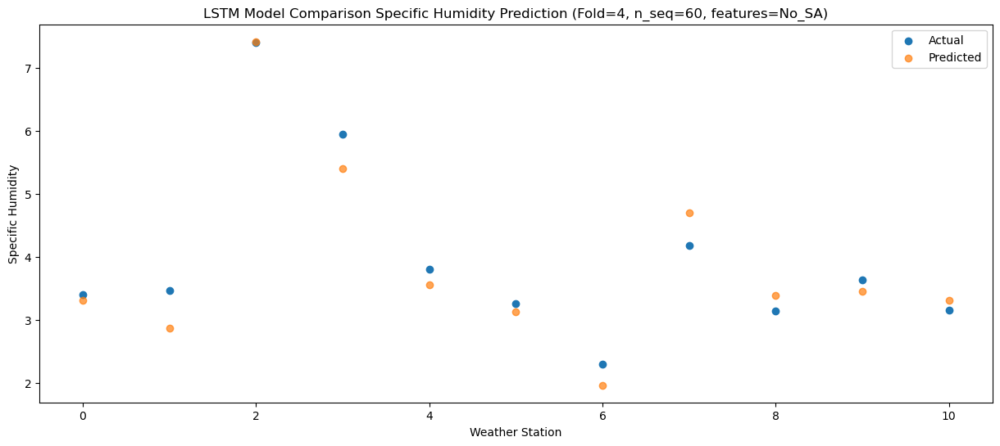

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   0.600054
1                 1    0.41   0.160054
2                 2    4.73   4.700054
3                 3    4.31   2.680054
4                 4    2.44   0.840054
5                 5    2.80   0.410054
6                 6   -0.53  -0.749946
7                 7    2.51   1.980054
8                 8    1.46   0.680054
9                 9    2.55   0.740054
10               10    1.22   0.600054


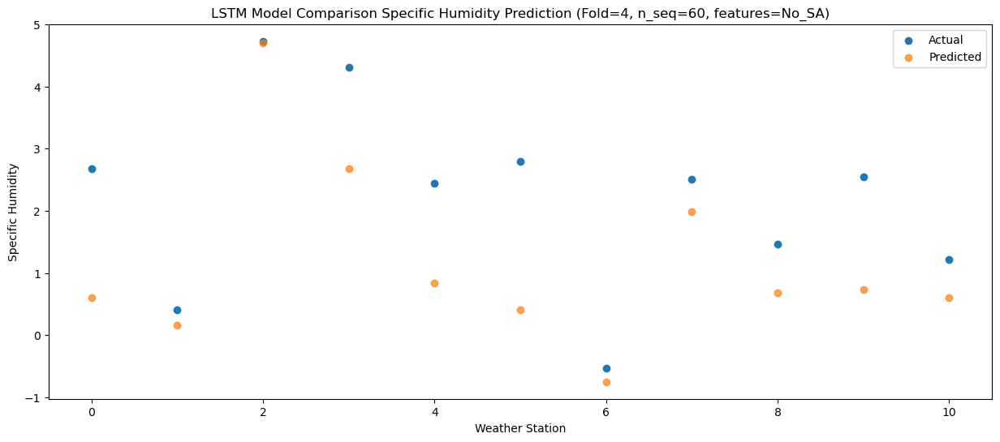

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45  -2.446736
1                 1   -4.33  -2.886736
2                 2    2.35   1.653264
3                 3    1.71  -0.366736
4                 4   -0.13  -2.206736
5                 5    0.24  -2.636736
6                 6   -3.87  -3.796736
7                 7    0.58  -1.066736
8                 8   -0.14  -2.366736
9                 9    0.64  -2.306736
10               10   -0.11  -2.446736


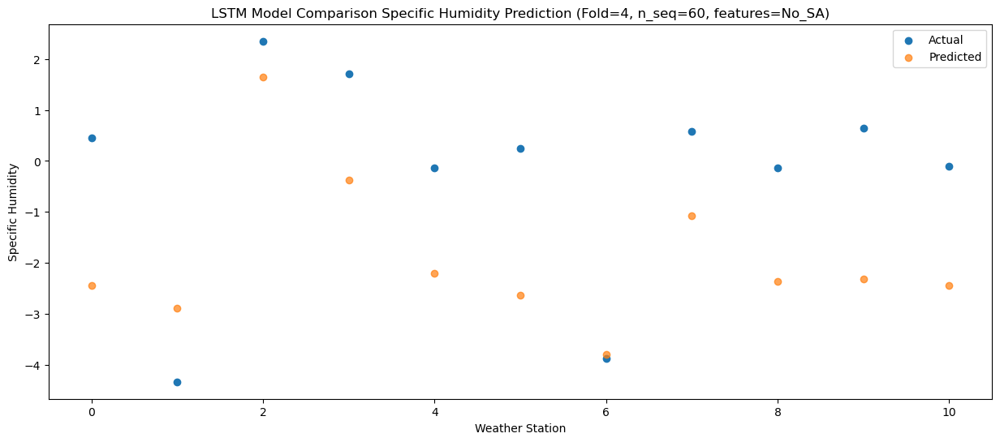

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57  -2.572624
1                 1   -3.98  -3.012624
2                 2    2.24   1.527376
3                 3    1.60  -0.492624
4                 4   -0.17  -2.332624
5                 5    0.94  -2.762624
6                 6   -3.99  -3.922624
7                 7    0.43  -1.192624
8                 8   -0.49  -2.492624
9                 9    0.32  -2.432624
10               10   -0.49  -2.572624


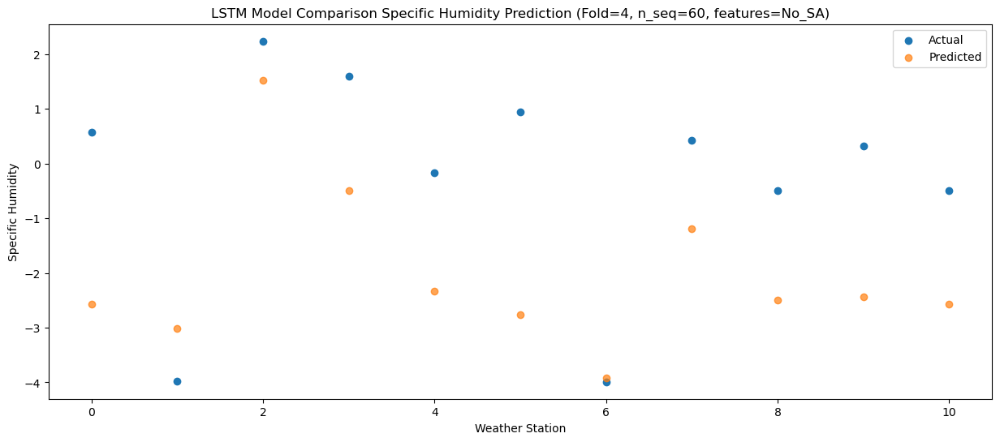

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -2.712714
1                 1   -1.99  -3.152714
2                 2    2.12   1.387286
3                 3    1.28  -0.632714
4                 4   -0.62  -2.472714
5                 5    0.30  -2.902714
6                 6   -3.74  -4.062714
7                 7   -0.20  -1.332714
8                 8   -1.06  -2.632714
9                 9   -0.32  -2.572714
10               10   -1.06  -2.712714


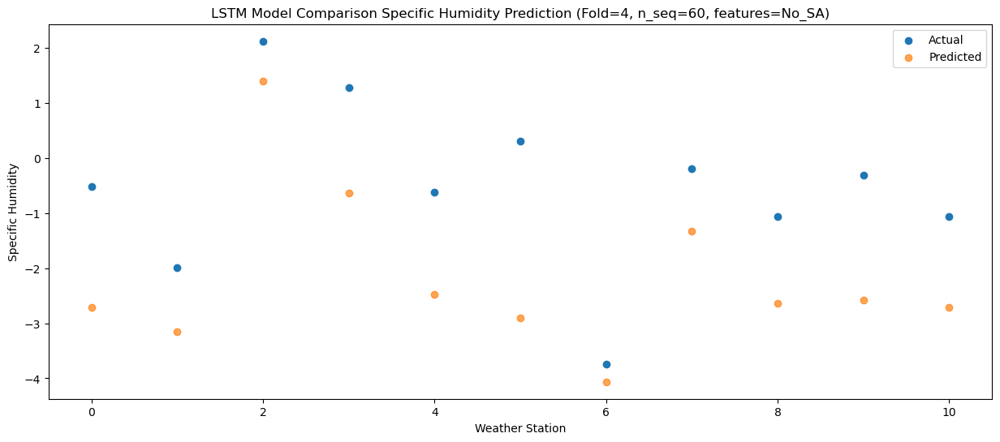

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24  -0.831906
1                 1   -2.02  -1.271906
2                 2    5.18   3.268094
3                 3    3.94   1.248094
4                 4    1.96  -0.591906
5                 5    1.79  -1.021906
6                 6   -2.03  -2.181906
7                 7    2.17   0.548094
8                 8    0.88  -0.751906
9                 9    2.05  -0.691906
10               10    0.23  -0.831906


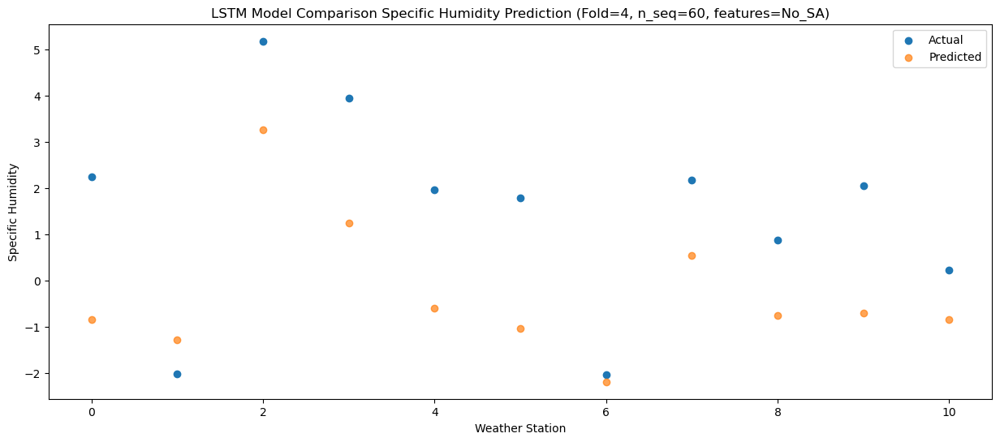

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45  -0.594208
1                 1   -1.27  -1.034208
2                 2    5.43   3.505792
3                 3    5.23   1.485792
4                 4    3.32  -0.354208
5                 5    2.75  -0.784208
6                 6   -1.62  -1.944208
7                 7    3.09   0.785792
8                 8    2.21  -0.514208
9                 9    3.36  -0.454208
10               10    1.90  -0.594208


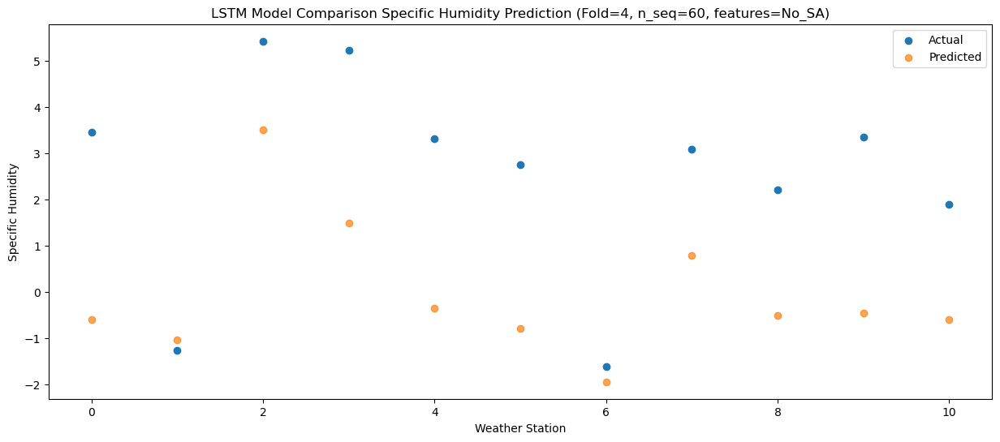

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01     2.9264
1                 1    0.06     2.4864
2                 2    8.87     7.0264
3                 3    9.23     5.0064
4                 4    7.61     3.1664
5                 5    7.30     2.7364
6                 6    1.36     1.5764
7                 7    6.25     4.3064
8                 8    4.50     3.0064
9                 9    5.98     3.0664
10               10    3.50     2.9264


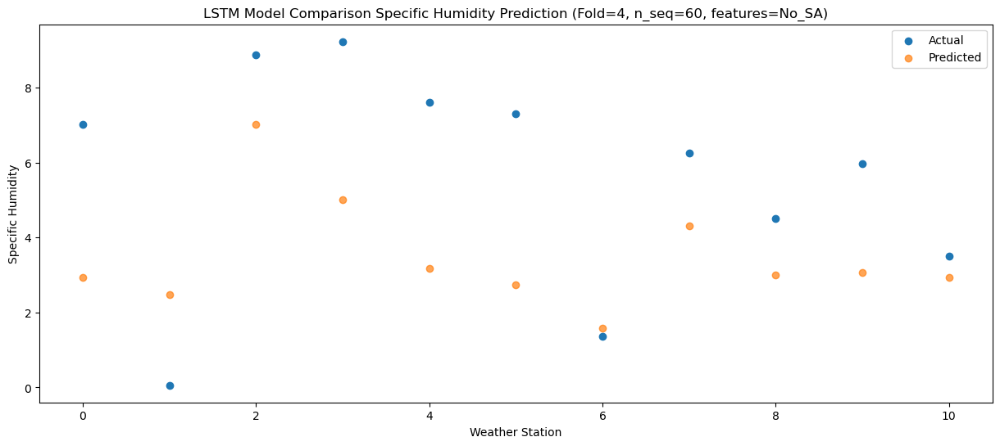

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   6.633652
1                 1    4.35   6.193652
2                 2   13.11  10.733652
3                 3   12.92   8.713652
4                 4   11.49   6.873652
5                 5    9.60   6.443652
6                 6    6.05   5.283652
7                 7   10.85   8.013652
8                 8    9.56   6.713652
9                 9   10.73   6.773652
10               10    8.51   6.633652


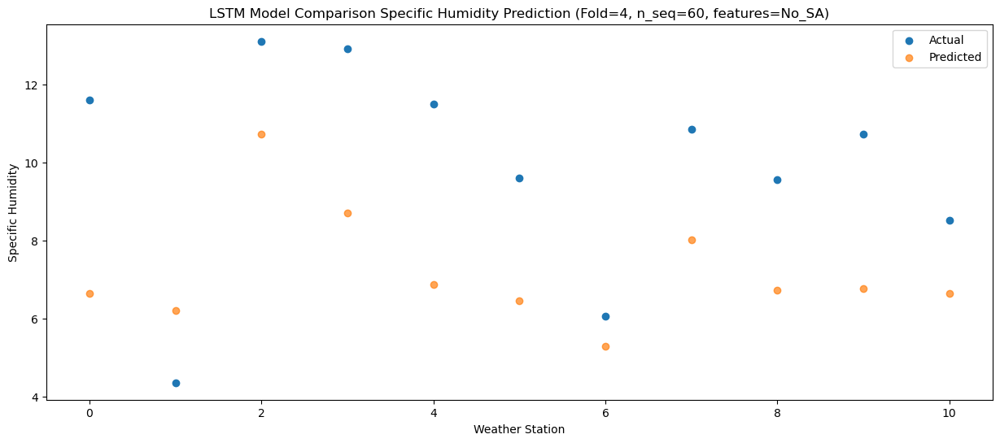

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99   8.019189
1                 1    5.56   7.579189
2                 2   14.76  12.119189
3                 3   13.49  10.099189
4                 4   11.87   8.259189
5                 5   10.63   7.829189
6                 6    7.65   6.669189
7                 7   11.80   9.399189
8                 8   10.82   8.099189
9                 9   12.13   8.159189
10               10    9.78   8.019189


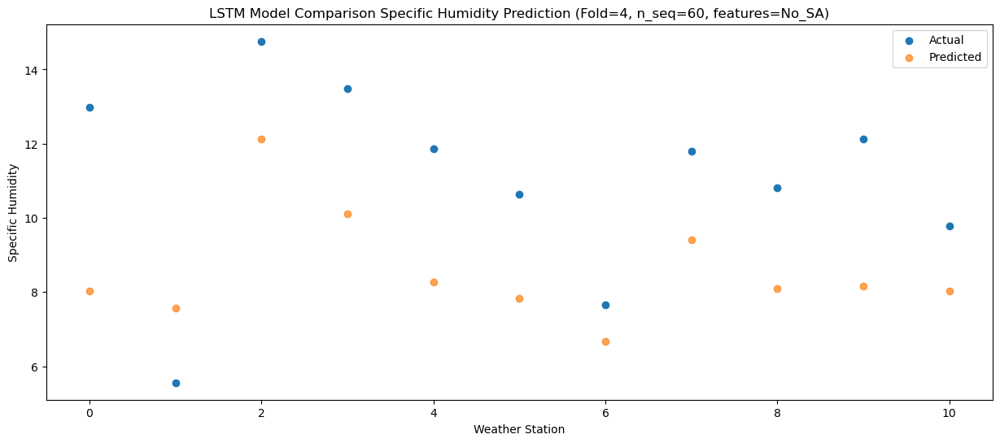

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81   7.759378
1                 1    5.95   7.319378
2                 2   14.77  11.859378
3                 3   13.88   9.839378
4                 4   11.98   7.999378
5                 5   10.35   7.569378
6                 6    8.03   6.409378
7                 7   11.54   9.139378
8                 8   10.96   7.839378
9                 9   12.38   7.899378
10               10   10.65   7.759378


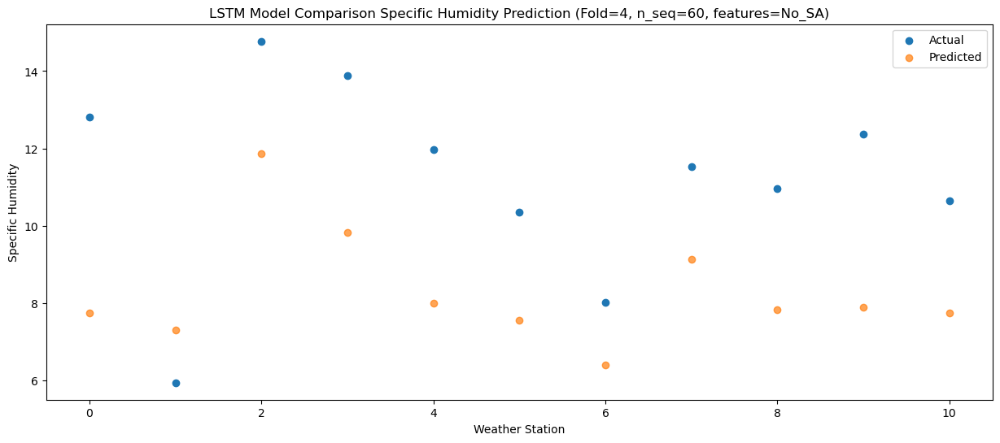

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23    5.04002
1                 1    5.15    4.60002
2                 2   11.83    9.14002
3                 3    9.87    7.12002
4                 4    8.08    5.28002
5                 5    7.10    4.85002
6                 6    4.45    3.69002
7                 7    8.28    6.42002
8                 8    7.48    5.12002
9                 9    8.35    5.18002
10               10    6.89    5.04002


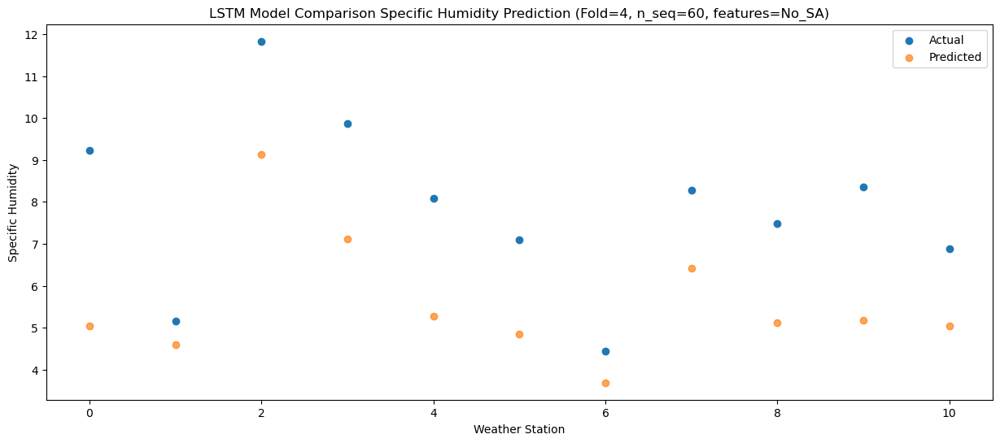

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86    2.30656
1                 1    2.23    1.86656
2                 2    9.05    6.40656
3                 3    7.02    4.38656
4                 4    5.35    2.54656
5                 5    4.05    2.11656
6                 6    2.24    0.95656
7                 7    6.19    3.68656
8                 8    6.33    2.38656
9                 9    6.48    2.44656
10               10    5.88    2.30656


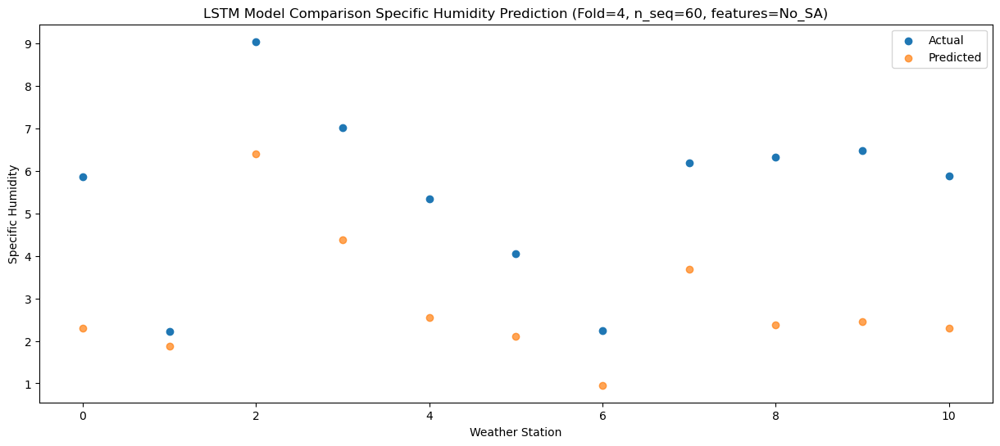

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77  -2.351133
1                 1   -2.43  -2.791133
2                 2    3.61   1.748867
3                 3    3.40  -0.271133
4                 4    1.74  -2.111133
5                 5    2.33  -2.541133
6                 6   -3.48  -3.701133
7                 7    1.50  -0.971133
8                 8    0.56  -2.271133
9                 9    1.19  -2.211133
10               10    0.64  -2.351133


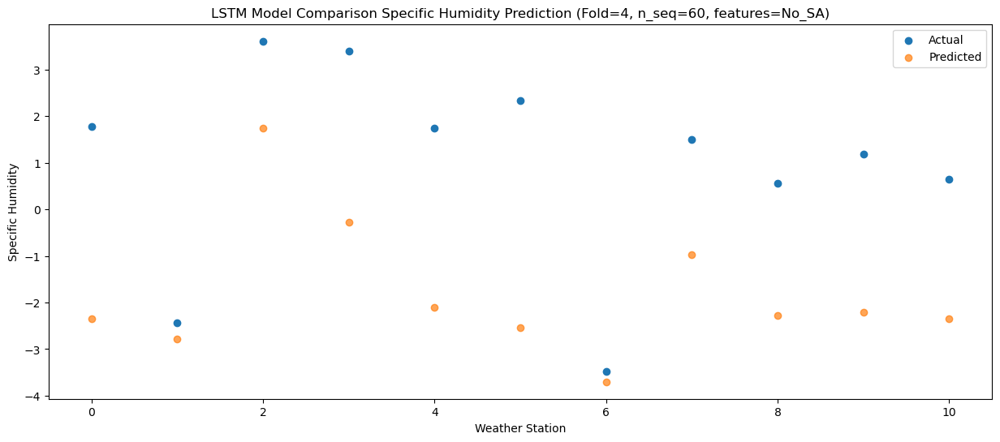

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56  -1.384959
1                 1   -0.69  -1.824959
2                 2    6.56   2.715041
3                 3    5.26   0.695041
4                 4    3.15  -1.144959
5                 5    1.48  -1.574959
6                 6   -1.62  -2.734959
7                 7    2.97  -0.004959
8                 8    1.27  -1.304959
9                 9    1.73  -1.244959
10               10    0.60  -1.384959


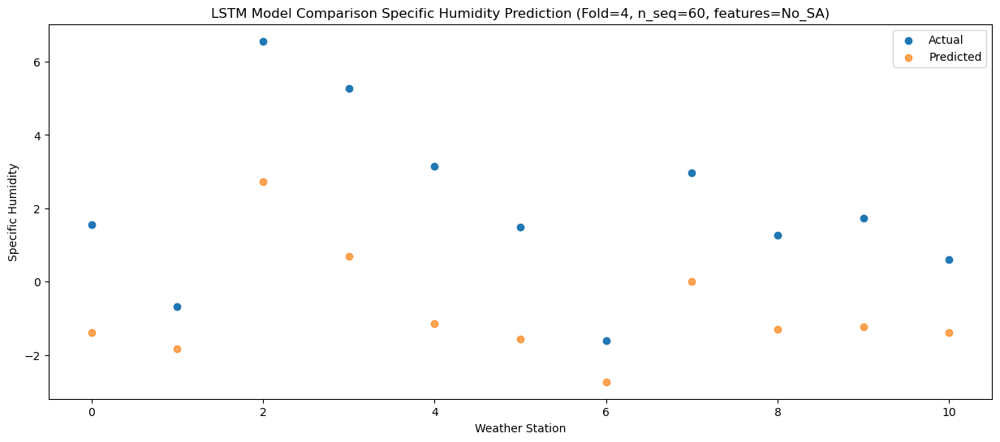

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -3.639401
1                 1   -4.55  -4.079401
2                 2    1.83   0.460599
3                 3    0.60  -1.559401
4                 4   -1.18  -3.399401
5                 5    0.02  -3.829401
6                 6   -4.60  -4.989401
7                 7   -0.23  -2.259401
8                 8   -1.11  -3.559401
9                 9   -0.51  -3.499401
10               10   -1.14  -3.639401


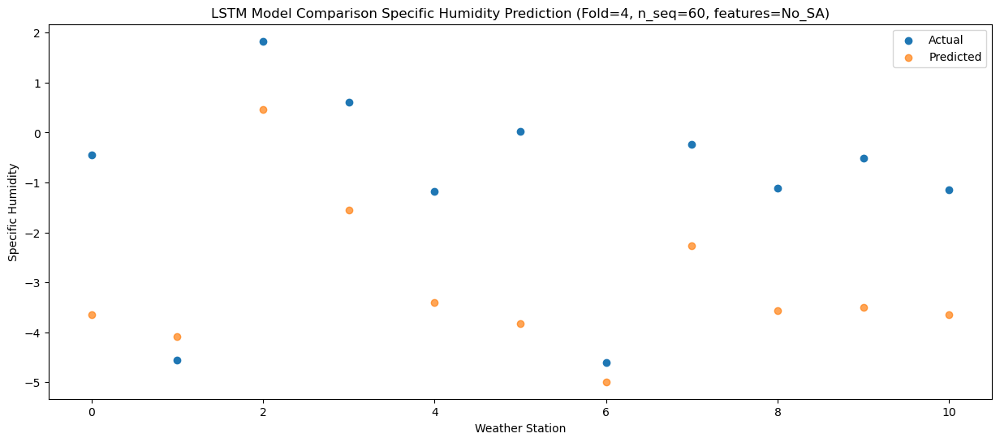

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23  -2.709788
1                 1   -2.97  -3.149788
2                 2    2.68   1.390212
3                 3    1.13  -0.629788
4                 4   -0.74  -2.469788
5                 5    0.01  -2.899788
6                 6   -3.28  -4.059788
7                 7    0.28  -1.329788
8                 8   -0.53  -2.629788
9                 9    0.19  -2.569788
10               10   -0.69  -2.709788


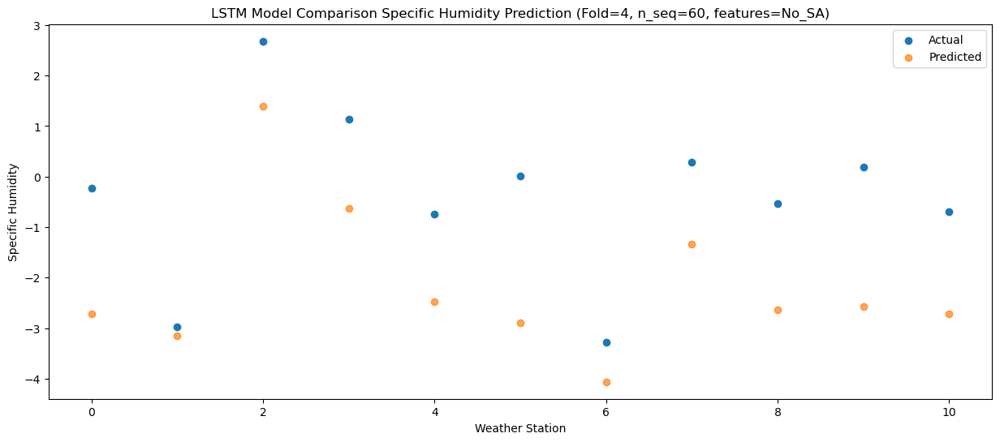

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33  -2.025294
1                 1   -1.44  -2.465294
2                 2    3.73   2.074706
3                 3    2.72   0.054706
4                 4    0.78  -1.785294
5                 5    0.60  -2.215294
6                 6   -2.44  -3.375294
7                 7    1.79  -0.645294
8                 8    0.78  -1.945294
9                 9    1.71  -1.885294
10               10    0.46  -2.025294


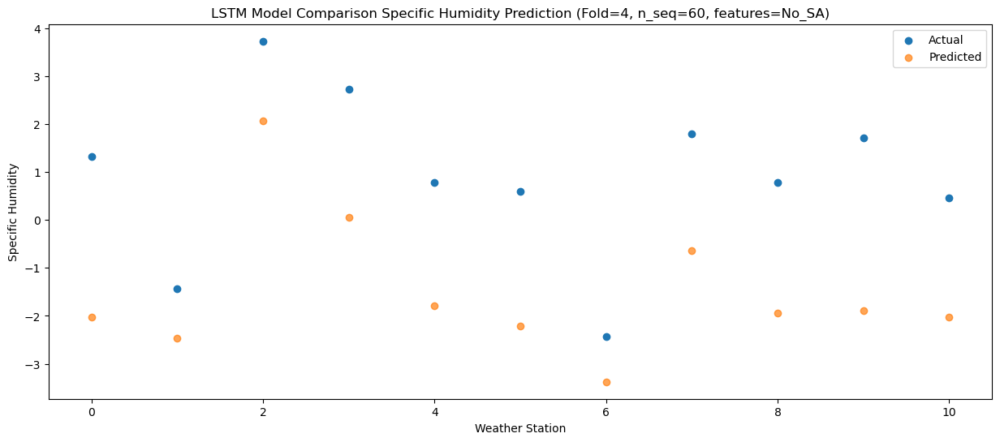

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82  -0.144902
1                 1   -0.15  -0.584902
2                 2    6.18   3.955098
3                 3    6.23   1.935098
4                 4    4.46   0.095098
5                 5    2.63  -0.334902
6                 6   -1.38  -1.494902
7                 7    3.58   1.235098
8                 8    2.27  -0.064902
9                 9    3.01  -0.004902
10               10    1.45  -0.144902


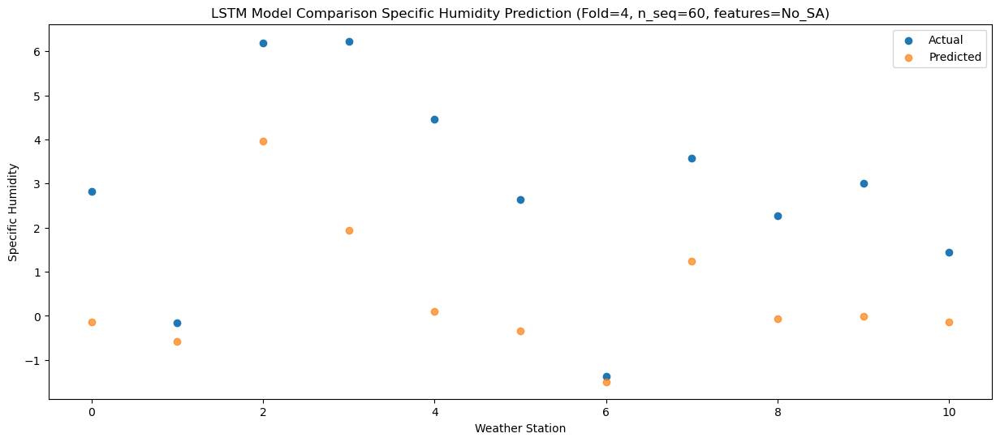

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70    3.35022
1                 1    2.24    2.91022
2                 2   10.78    7.45022
3                 3   10.22    5.43022
4                 4    8.34    3.59022
5                 5    4.89    3.16022
6                 6    2.63    2.00022
7                 7    8.29    4.73022
8                 8    6.29    3.43022
9                 9    7.08    3.49022
10               10    4.91    3.35022


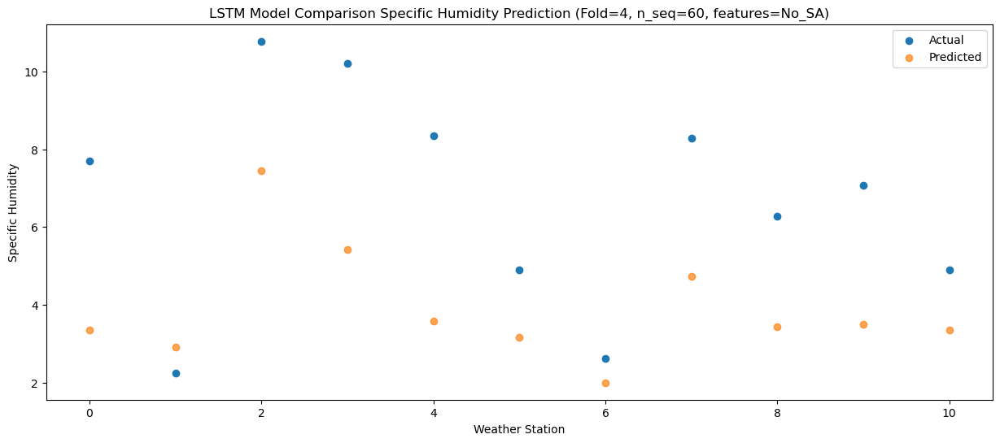

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   5.661567
1                 1    5.14   5.221567
2                 2   13.16   9.761567
3                 3   11.99   7.741567
4                 4   10.02   5.901567
5                 5    7.74   5.471567
6                 6    4.91   4.311567
7                 7   10.65   7.041567
8                 8    7.73   5.741567
9                 9    9.32   5.801567
10               10    6.82   5.661567


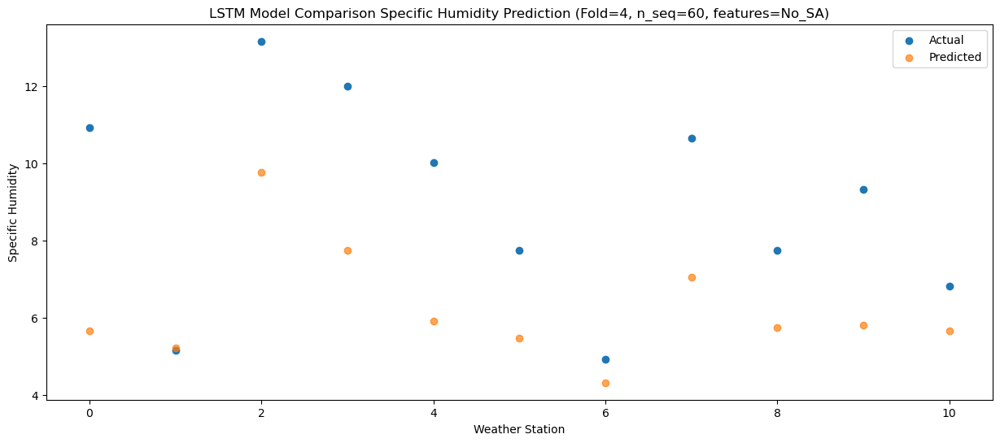

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56   8.253089
1                 1    6.17   7.813089
2                 2   15.00  12.353089
3                 3   11.41  10.333089
4                 4    9.52   8.493089
5                 5    8.43   8.063089
6                 6    8.07   6.903089
7                 7   11.45   9.633089
8                 8   10.47   8.333089
9                 9   11.96   8.393089
10               10    8.55   8.253089


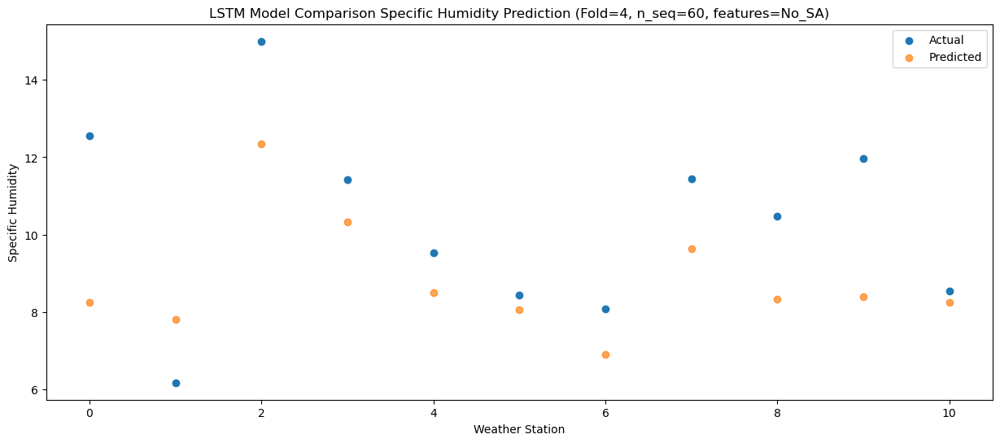

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35   8.227485
1                 1    6.25   7.787485
2                 2   14.82  12.327485
3                 3   12.42  10.307485
4                 4   10.69   8.467485
5                 5   10.42   8.037485
6                 6    6.88   6.877485
7                 7   11.92   9.607485
8                 8   10.11   8.307485
9                 9   11.19   8.367485
10               10    9.01   8.227485


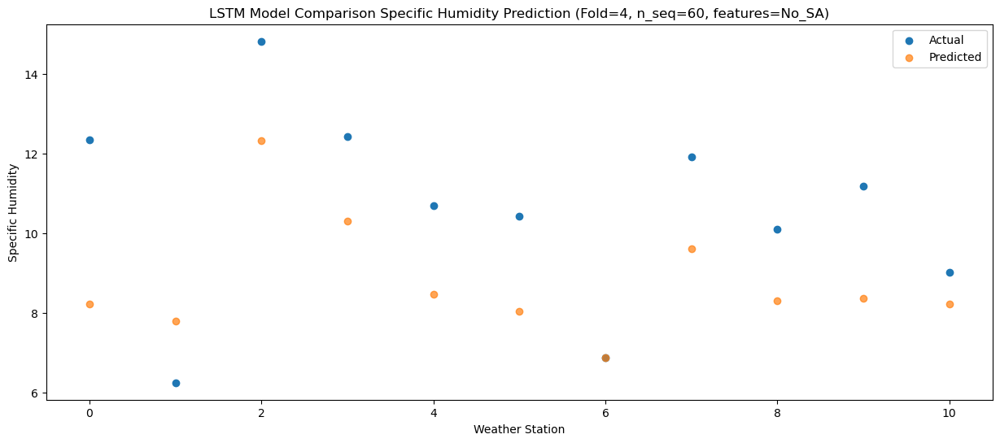

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65    5.20515
1                 1    5.38    4.76515
2                 2   10.58    9.30515
3                 3    9.14    7.28515
4                 4    7.54    5.44515
5                 5    9.17    5.01515
6                 6    3.33    3.85515
7                 7    8.11    6.58515
8                 8    7.45    5.28515
9                 9    7.82    5.34515
10               10    7.02    5.20515


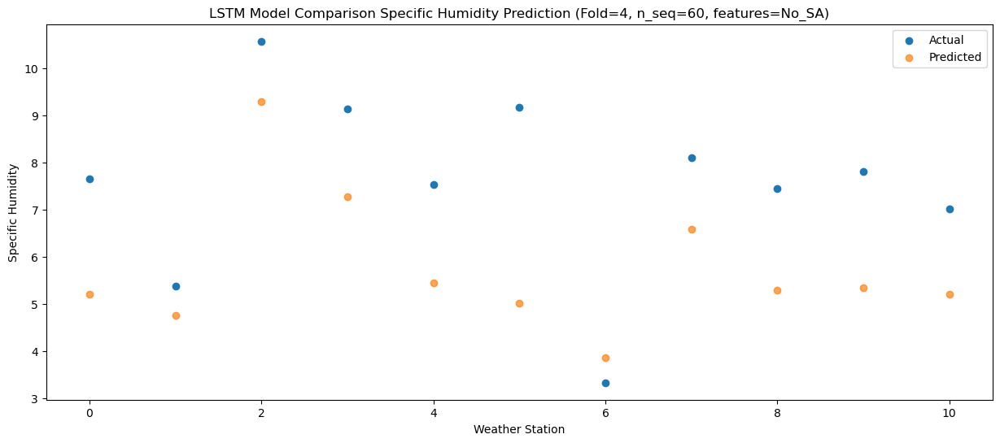

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   1.049113
1                 1    0.60   0.609113
2                 2    5.62   5.149113
3                 3    4.68   3.129113
4                 4    3.08   1.289113
5                 5    5.66   0.859113
6                 6   -1.35  -0.300887
7                 7    3.45   2.429113
8                 8    2.12   1.129113
9                 9    3.06   1.189113
10               10    2.20   1.049113


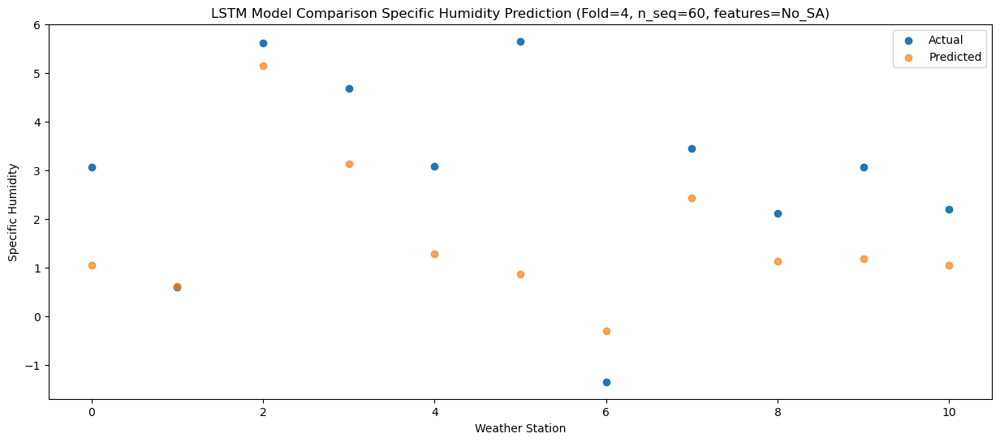

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   0.382215
1                 1    0.77  -0.057785
2                 2    4.87   4.482215
3                 3    4.50   2.462215
4                 4    2.66   0.622215
5                 5    2.96   0.192215
6                 6   -1.53  -0.967785
7                 7    2.09   1.762215
8                 8    1.08   0.462215
9                 9    1.69   0.522215
10               10    1.48   0.382215


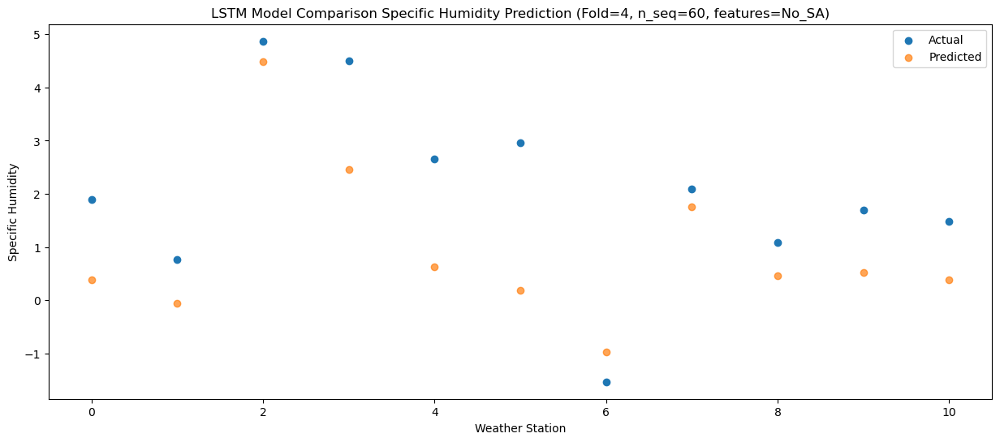

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55  -0.773336
1                 1   -2.75  -1.213336
2                 2    4.33   3.326664
3                 3    2.92   1.306664
4                 4    1.07  -0.533336
5                 5    2.32  -0.963336
6                 6   -3.52  -2.123336
7                 7    1.22   0.606664
8                 8    0.12  -0.693336
9                 9    0.58  -0.633336
10               10    0.03  -0.773336


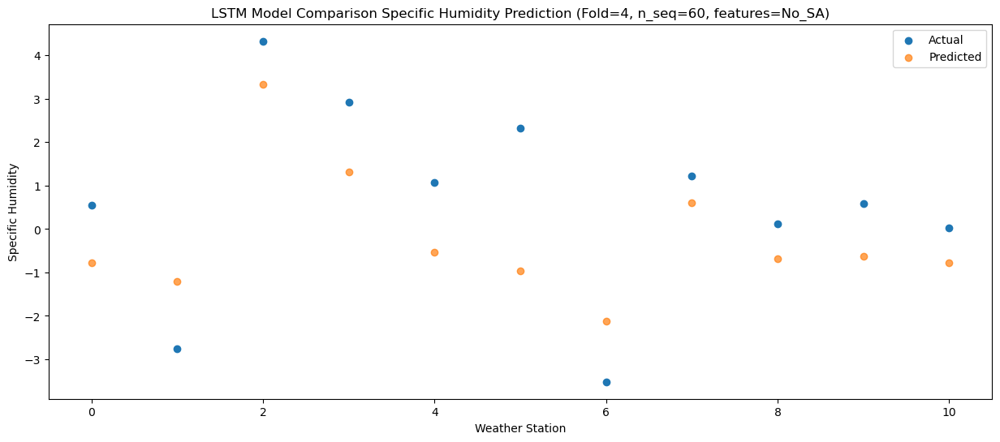

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90  -0.793178
1                 1   -3.26  -1.233178
2                 2    4.23   3.306822
3                 3    2.23   1.286822
4                 4    0.32  -0.553178
5                 5    0.77  -0.983178
6                 6   -2.89  -2.143178
7                 7    1.50   0.586822
8                 8    0.74  -0.713178
9                 9    1.10  -0.653178
10               10    0.65  -0.793178


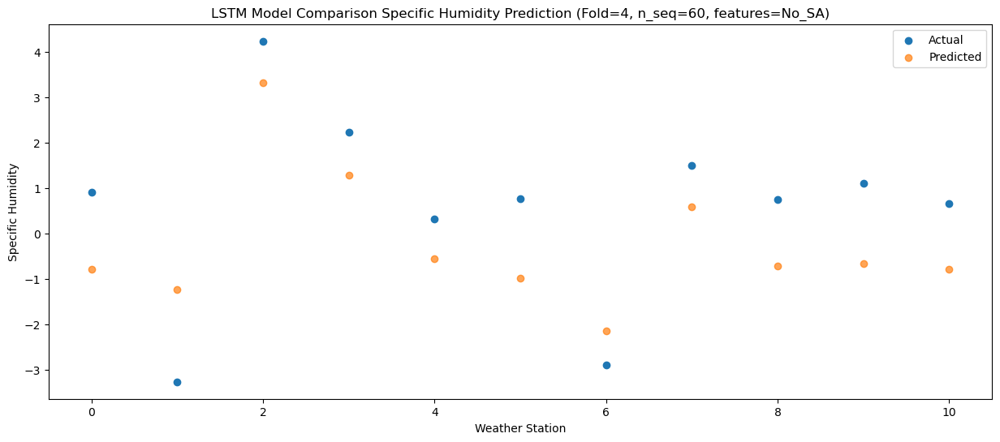

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85   0.322949
1                 1   -1.32  -0.117051
2                 2    4.90   4.422949
3                 3    2.59   2.402949
4                 4    0.72   0.562949
5                 5    0.89   0.132949
6                 6   -1.85  -1.027051
7                 7    1.31   1.702949
8                 8    0.34   0.402949
9                 9    0.87   0.462949
10               10   -0.10   0.322949


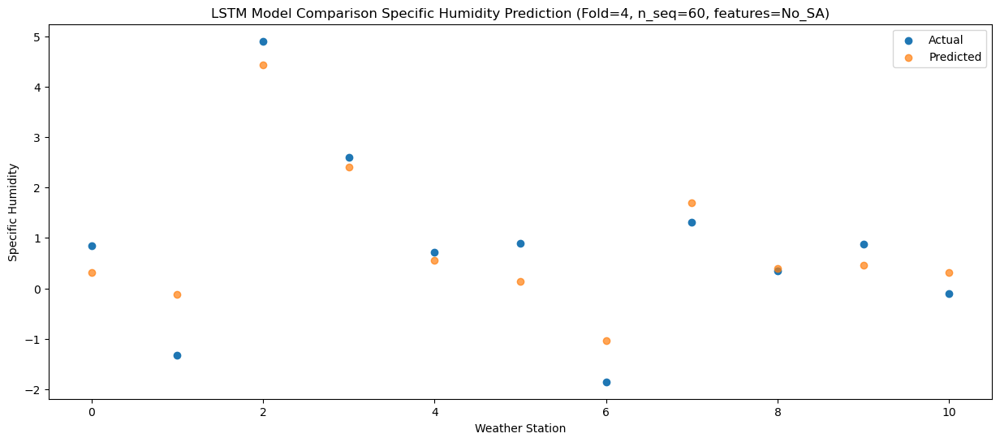

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   0.765135
1                 1   -0.94   0.325135
2                 2    5.23   4.865135
3                 3    4.65   2.845135
4                 4    2.69   1.005135
5                 5    2.18   0.575135
6                 6   -2.36  -0.584865
7                 7    2.07   2.145135
8                 8    0.69   0.845135
9                 9    1.48   0.905135
10               10    0.11   0.765135


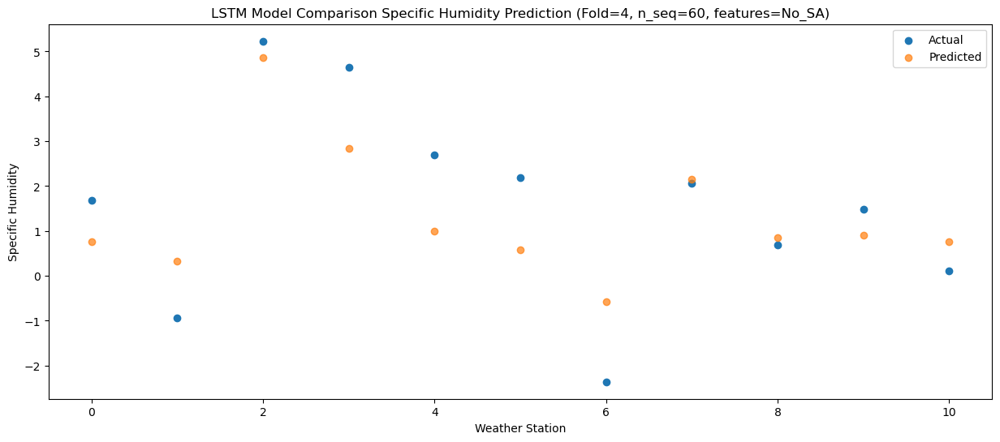

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   1.355781
1                 1    0.55   0.915781
2                 2    6.07   5.455781
3                 3    5.33   3.435781
4                 4    3.54   1.595781
5                 5    2.15   1.165781
6                 6   -0.76   0.005781
7                 7    2.97   2.735781
8                 8    2.14   1.435781
9                 9    2.99   1.495781
10               10    1.81   1.355781


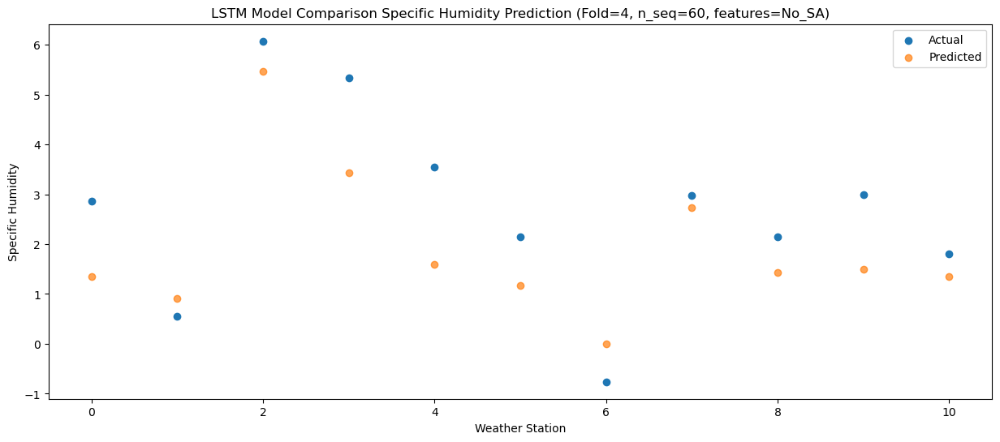

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   3.416168
1                 1    1.35   2.976168
2                 2    9.45   7.516168
3                 3    9.59   5.496168
4                 4    7.81   3.656168
5                 5    6.99   3.226168
6                 6    1.46   2.066168
7                 7    7.36   4.796168
8                 8    4.39   3.496168
9                 9    5.77   3.556168
10               10    2.71   3.416168


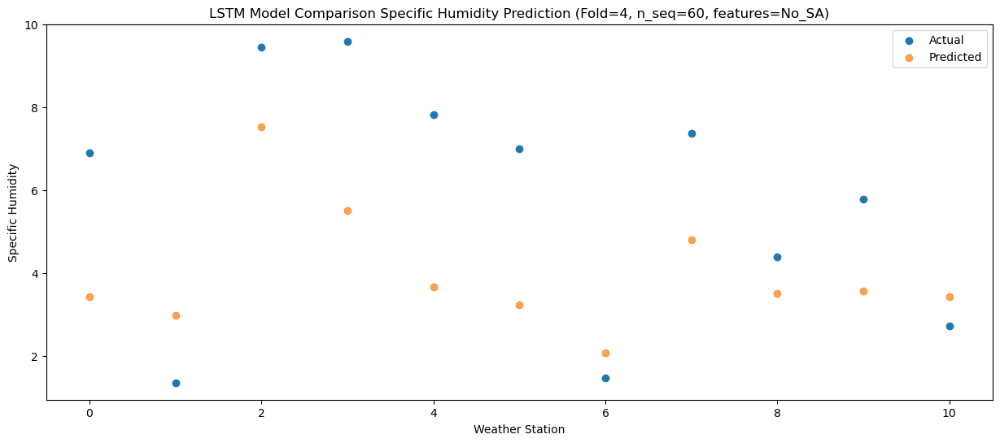

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43   5.881679
1                 1    4.86   5.441679
2                 2   13.02   9.981679
3                 3   13.53   7.961679
4                 4   11.29   6.121679
5                 5   10.85   5.691679
6                 6    4.51   4.531679
7                 7    9.92   7.261679
8                 8    6.35   5.961679
9                 9    7.41   6.021679
10               10    5.95   5.881679


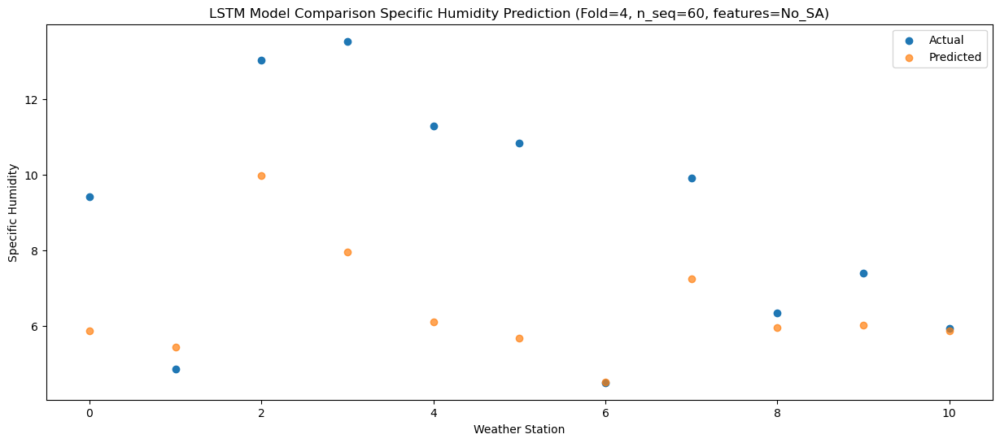

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12   9.439911
1                 1    6.77   8.999911
2                 2   14.61  13.539911
3                 3   13.38  11.519911
4                 4   10.39   9.679911
5                 5    8.52   9.249911
6                 6    7.90   8.089911
7                 7   12.71  10.819911
8                 8   10.65   9.519911
9                 9   12.11   9.579911
10               10    9.57   9.439911


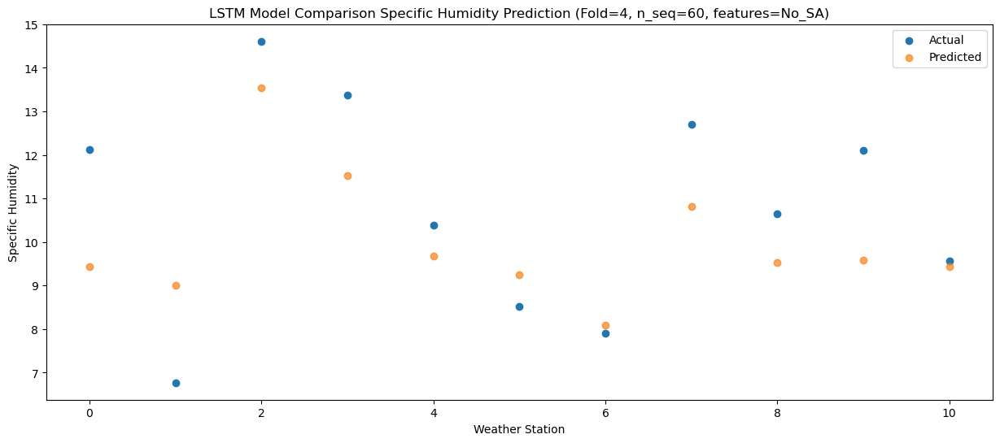

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05   8.748941
1                 1    7.07   8.308941
2                 2   13.03  12.848941
3                 3   11.28  10.828941
4                 4    9.01   8.988941
5                 5    7.66   8.558941
6                 6    7.44   7.398941
7                 7   12.99  10.128941
8                 8   10.11   8.828941
9                 9   11.98   8.888941
10               10    8.77   8.748941


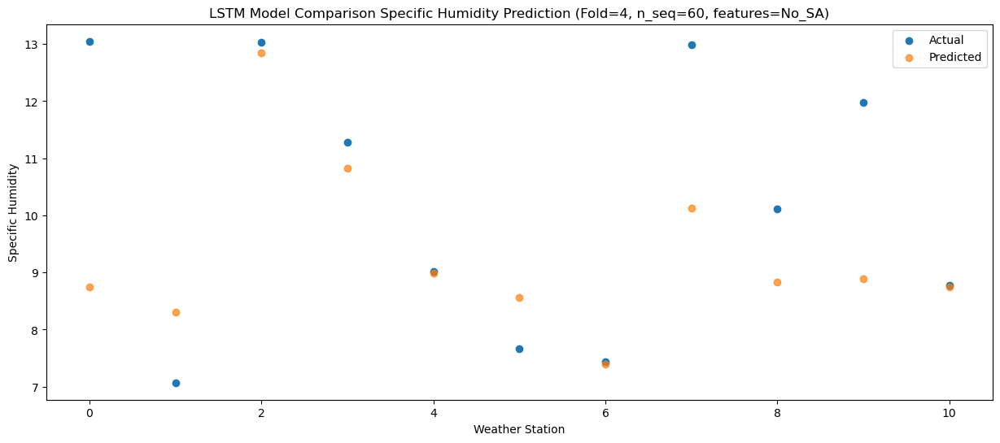

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13    6.09456
1                 1    4.62    5.65456
2                 2   10.01   10.19456
3                 3   10.38    8.17456
4                 4    8.68    6.33456
5                 5    8.17    5.90456
6                 6    3.99    4.74456
7                 7    8.79    7.47456
8                 8    7.31    6.17456
9                 9    8.20    6.23456
10               10    7.06    6.09456


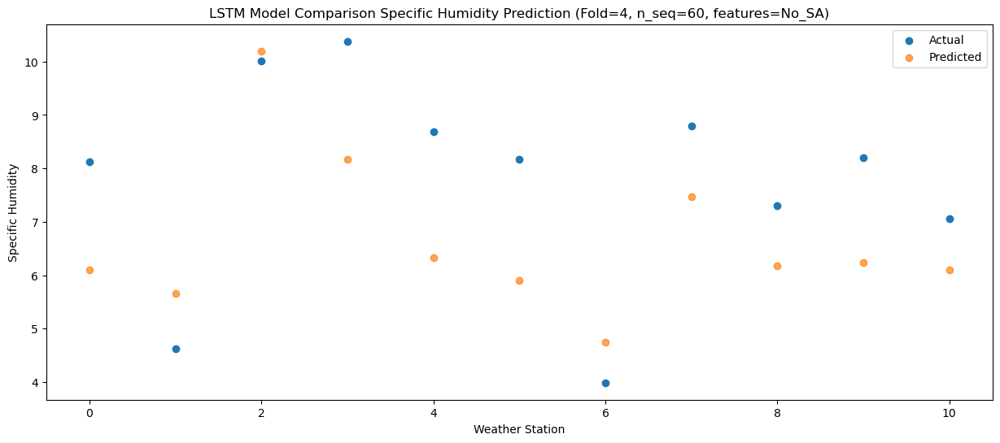

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   2.343015
1                 1    1.00   1.903015
2                 2    6.08   6.443015
3                 3    6.66   4.423015
4                 4    5.02   2.583015
5                 5    6.04   2.153015
6                 6    0.08   0.993015
7                 7    5.18   3.723015
8                 8    3.98   2.423015
9                 9    4.76   2.483015
10               10    4.00   2.343015


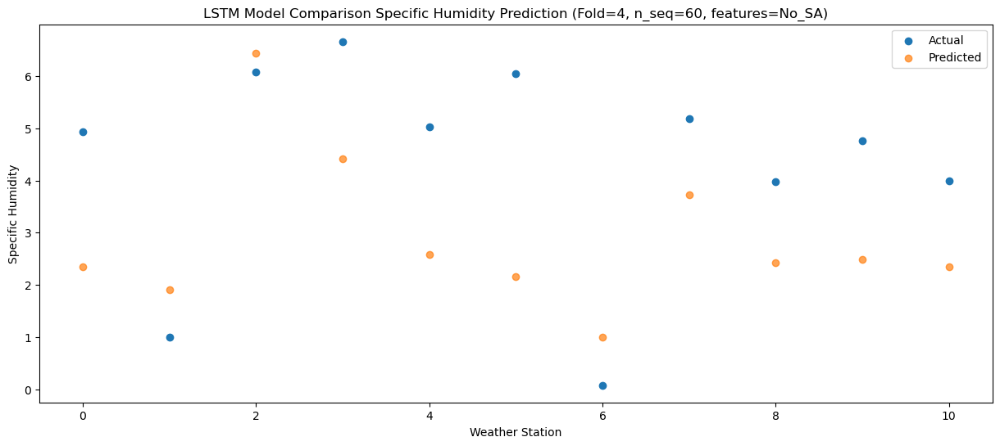

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04  -0.368361
1                 1   -1.30  -0.808361
2                 2    4.10   3.731639
3                 3    4.13   1.711639
4                 4    2.60  -0.128361
5                 5    3.74  -0.558361
6                 6   -2.87  -1.718361
7                 7    2.15   1.011639
8                 8    0.91  -0.288361
9                 9    1.37  -0.228361
10               10    0.56  -0.368361


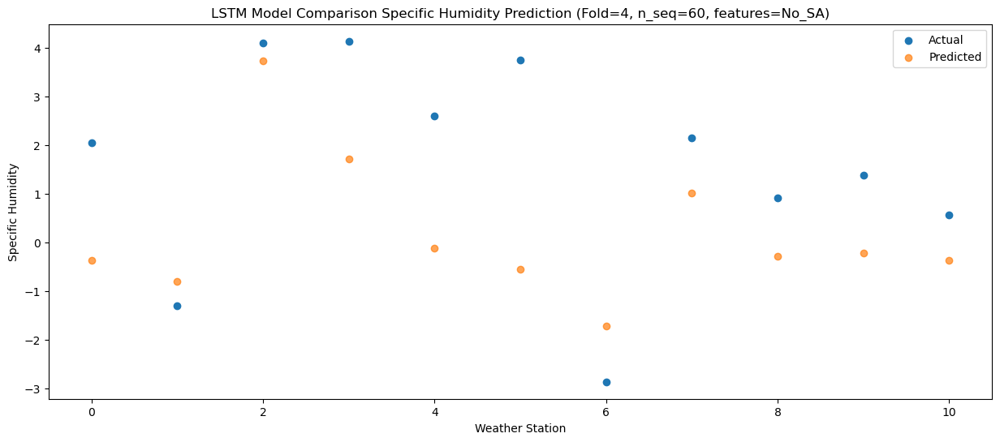

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86  -1.977306
1                 1   -2.39  -2.417306
2                 2    2.79   2.122694
3                 3    2.38   0.102694
4                 4    0.84  -1.737306
5                 5    2.16  -2.167306
6                 6   -3.15  -3.327306
7                 7    1.34  -0.597306
8                 8    0.88  -1.897306
9                 9    1.86  -1.837306
10               10    1.08  -1.977306


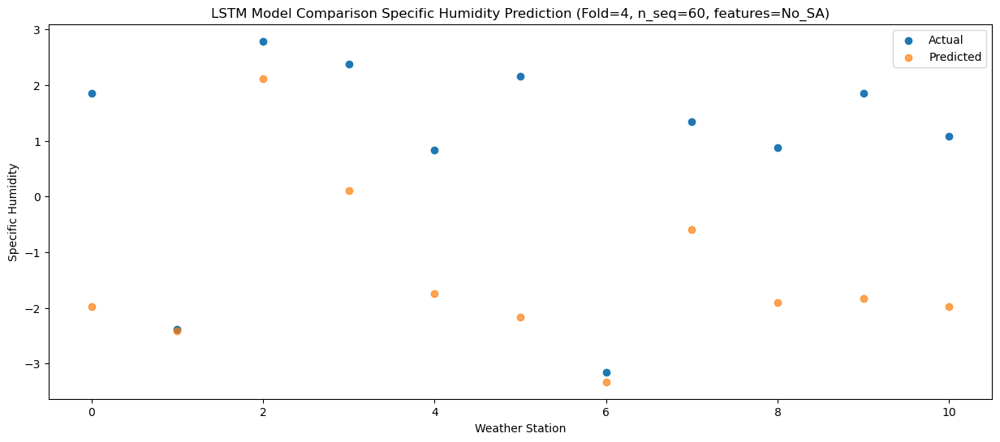

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16   -3.15477
1                 1   -3.43   -3.59477
2                 2    2.07    0.94523
3                 3    1.10   -1.07477
4                 4   -0.58   -2.91477
5                 5    0.89   -3.34477
6                 6   -3.93   -4.50477
7                 7    0.19   -1.77477
8                 8   -0.20   -3.07477
9                 9    0.40   -3.01477
10               10    0.01   -3.15477


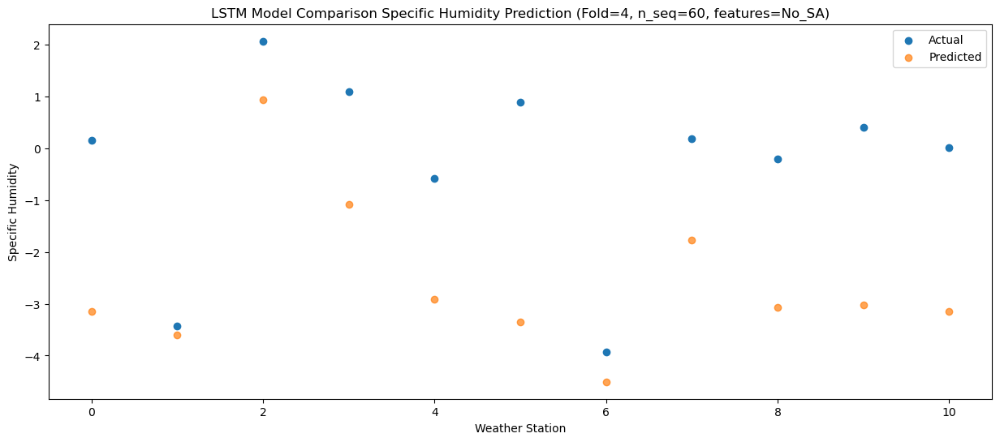

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17  -1.988285
1                 1   -4.12  -2.428285
2                 2    3.50   2.111715
3                 3    3.44   0.091715
4                 4    1.77  -1.748285
5                 5    1.24  -2.178285
6                 6   -3.75  -3.338285
7                 7    1.55  -0.608285
8                 8    0.38  -1.908285
9                 9    1.32  -1.848285
10               10    0.03  -1.988285


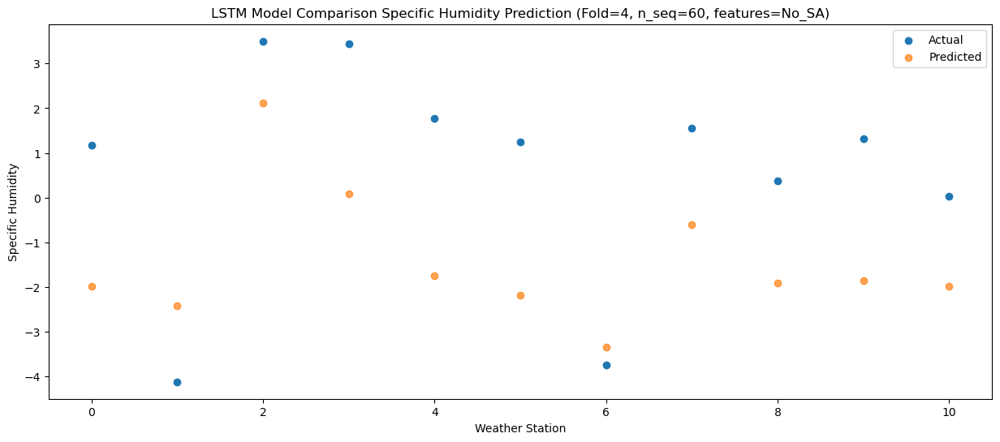

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23  -0.003328
1                 1   -0.83  -0.443328
2                 2    5.13   4.096672
3                 3    5.23   2.076672
4                 4    3.72   0.236672
5                 5    2.38  -0.193328
6                 6   -2.18  -1.353328
7                 7    2.76   1.376672
8                 8    1.45   0.076672
9                 9    2.29   0.136672
10               10    1.10  -0.003328


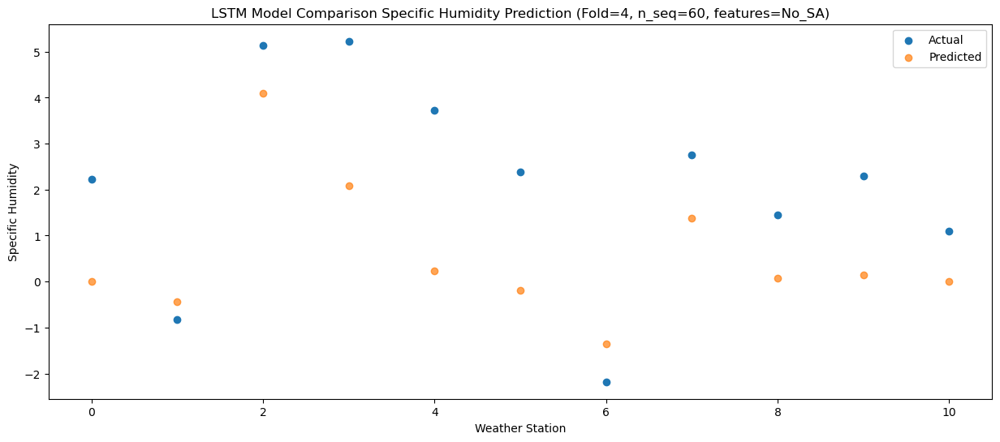

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   1.563876
1                 1   -1.43   1.123876
2                 2    7.31   5.663876
3                 3    7.60   3.643876
4                 4    6.22   1.803876
5                 5    2.98   1.373876
6                 6   -0.26   0.213876
7                 7    4.49   2.943876
8                 8    3.48   1.643876
9                 9    4.01   1.703876
10               10    2.88   1.563876


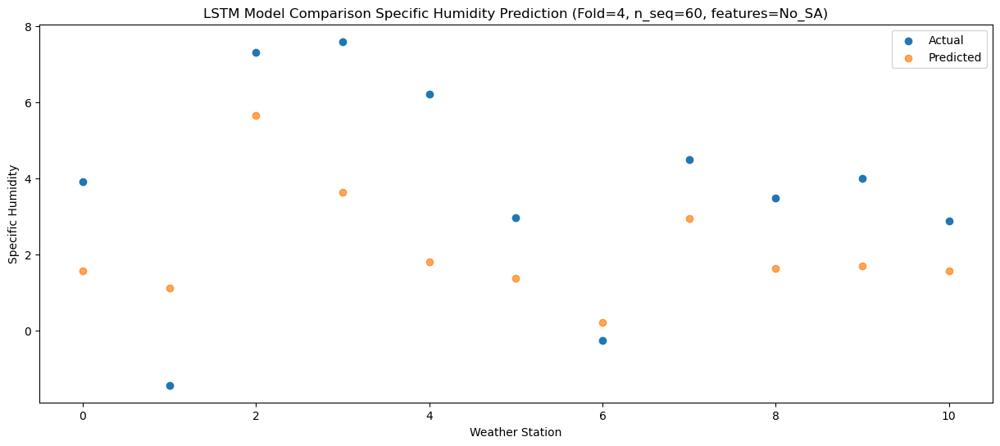

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   5.470392
1                 1    1.16   5.030392
2                 2   11.63   9.570392
3                 3   11.17   7.550392
4                 4    9.65   5.710392
5                 5    5.74   5.280392
6                 6    3.74   4.120392
7                 7    8.91   6.850392
8                 8    6.97   5.550392
9                 9    7.55   5.610392
10               10    5.80   5.470392


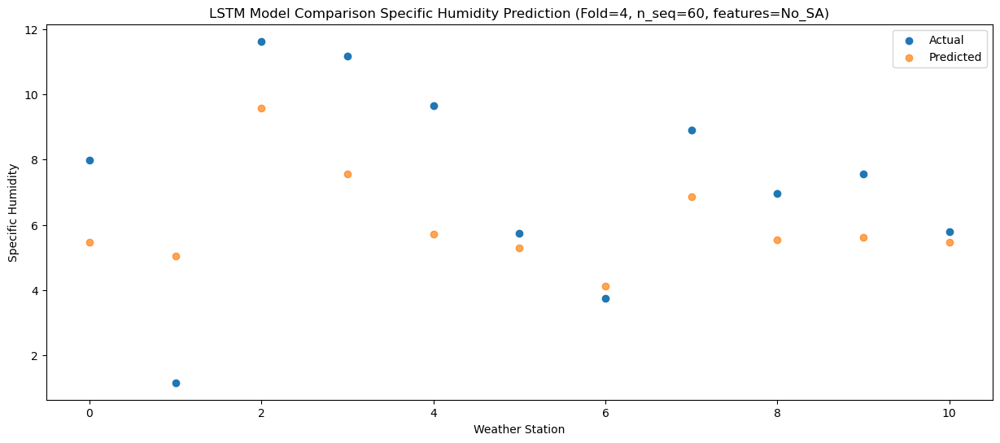

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24   7.289954
1                 1    2.62   6.849954
2                 2   12.97  11.389954
3                 3   13.11   9.369954
4                 4   11.76   7.529954
5                 5   10.27   7.099954
6                 6    5.50   5.939954
7                 7   10.89   8.669954
8                 8    8.66   7.369954
9                 9   10.31   7.429954
10               10    8.35   7.289954


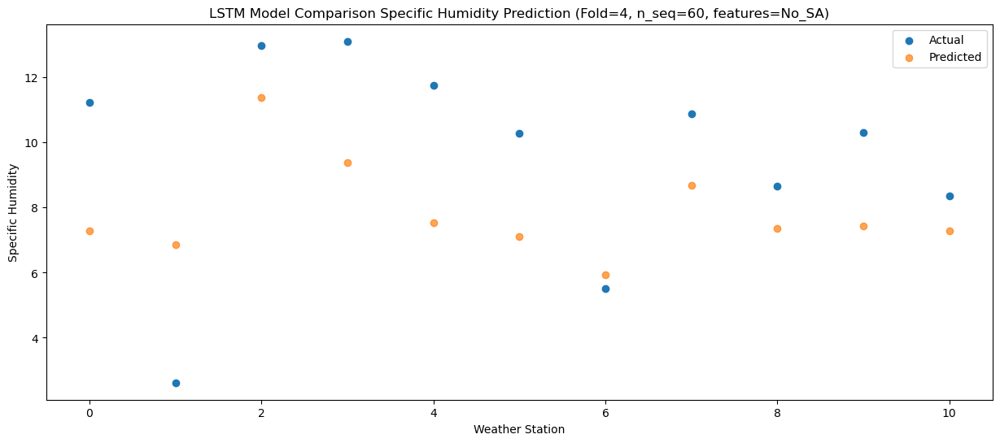

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43   8.735688
1                 1    4.08   8.295688
2                 2   15.00  12.835688
3                 3   13.07  10.815688
4                 4   11.29   8.975688
5                 5   10.15   8.545688
6                 6    7.89   7.385688
7                 7   11.87  10.115688
8                 8    9.96   8.815688
9                 9   11.92   8.875688
10               10    9.47   8.735688


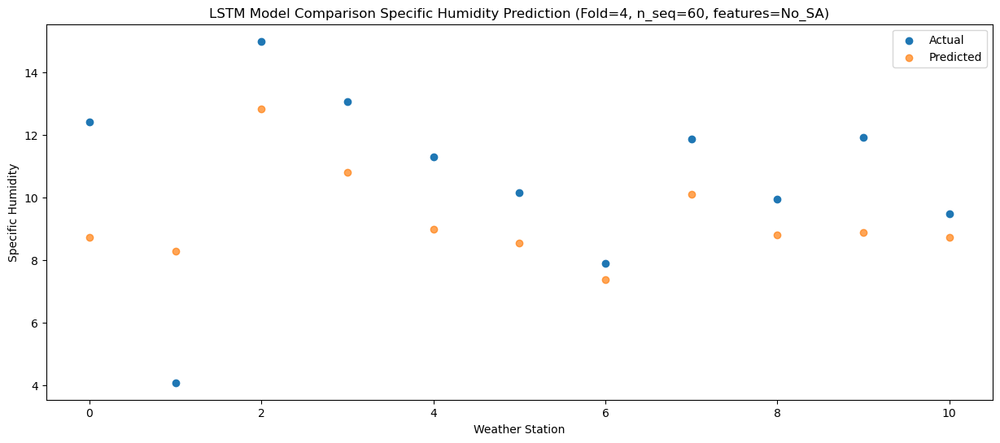

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27   8.274759
1                 1    6.69   7.834759
2                 2   12.69  12.374759
3                 3   12.36  10.354759
4                 4   10.52   8.514759
5                 5    8.95   8.084759
6                 6    7.15   6.924759
7                 7   10.58   9.654759
8                 8    9.60   8.354759
9                 9   11.56   8.414759
10               10    9.45   8.274759


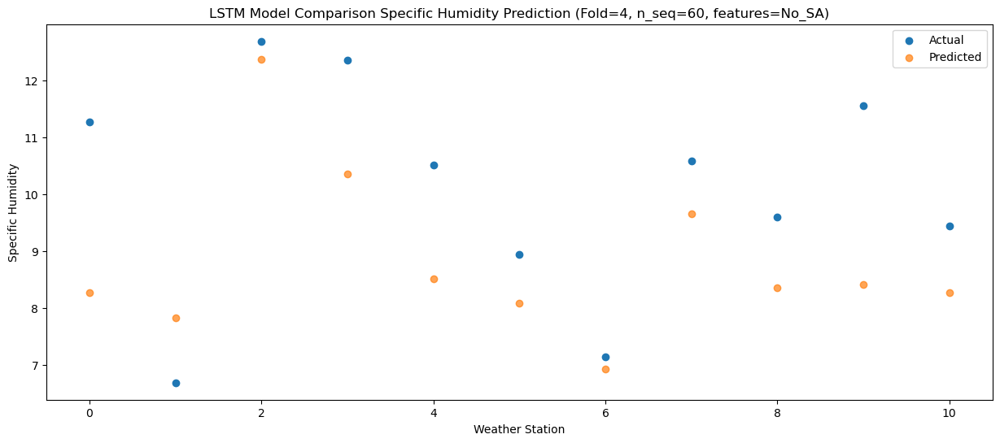

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   6.381024
1                 1    6.50   5.941024
2                 2   11.59  10.481024
3                 3    9.83   8.461024
4                 4    8.36   6.621024
5                 5    8.07   6.191024
6                 6    4.83   5.031024
7                 7    8.54   7.761024
8                 8    6.92   6.461024
9                 9    8.06   6.521024
10               10    7.38   6.381024


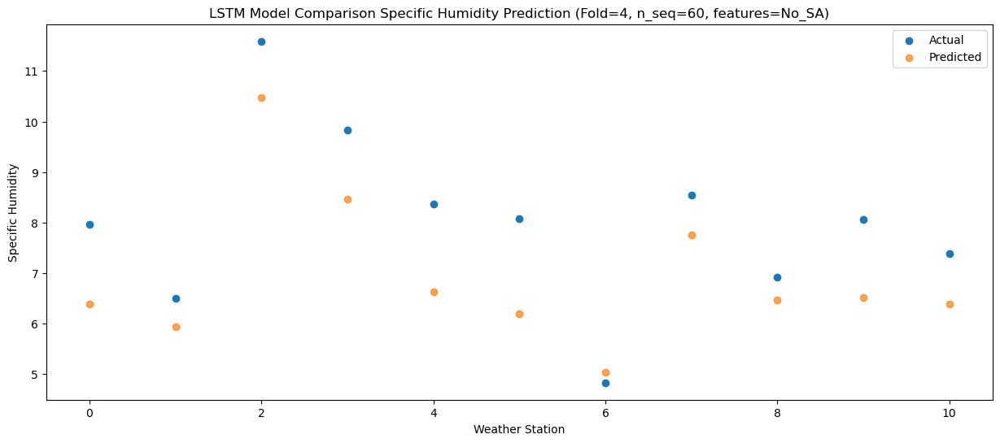

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   2.617496
1                 1    2.08   2.177496
2                 2    6.80   6.717496
3                 3    6.37   4.697496
4                 4    4.62   2.857496
5                 5    4.38   2.427496
6                 6    0.43   1.267496
7                 7    4.22   3.997496
8                 8    3.34   2.697496
9                 9    3.96   2.757496
10               10    3.27   2.617496


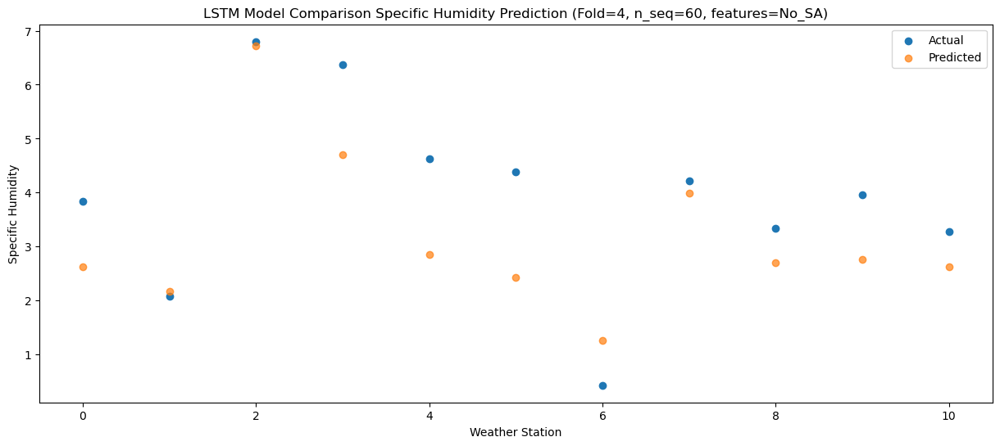

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

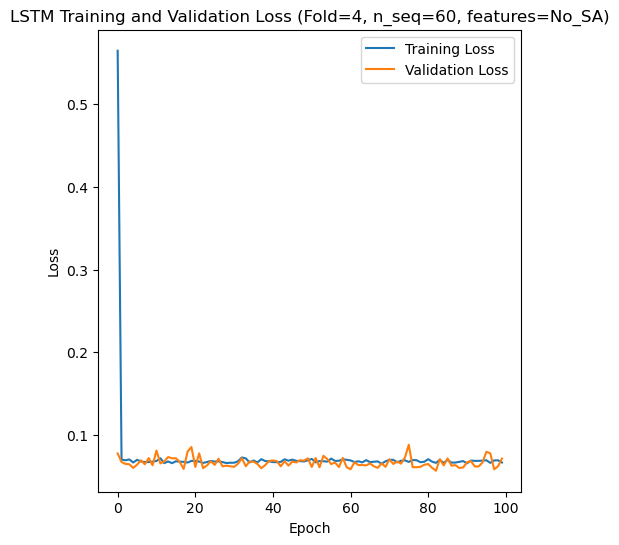

[[1.7049438571530815], [1.8538150696300901], [1.8040153745999654], [2.4404213941545536], [2.232364062473914]]
[[array(1.70494386)], [array(1.85381507)], [array(1.80401537)], [array(2.44042139)], [array(2.23236406)]]
[[1.3390669284230106], [1.4519076995937665], [1.4964460054354634], [2.147472475435473], [1.8522689311528069]]
[[1.2354079422003996], [1.3871270826670297], [1.434583598413112], [2.2613007816773587], [2.487491371006388]]
[[0.8493789646807353], [0.8263324139901128], [0.8243999443292195], [0.5403606938623868], [0.7524769941750636]]
[[array(0.18735713)], [array(0.3385659)], [array(0.17437134)], [array(0.34586885)], [array(1.83507009)]]
[[array(0.8901983)], [array(0.84717012)], [array(0.85298609)], [array(0.73188053)], [array(0.87268399)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[-0.30152117 -0.48637778 -0.29376242 ...  8.27475945  6.38102404
  2.61749641]
Accuracy Results:
RMSE for each fold:
[[1.7049438571530815], [1.8538150696300901], [1.8040153745999654], [2.4404213941545536], [2

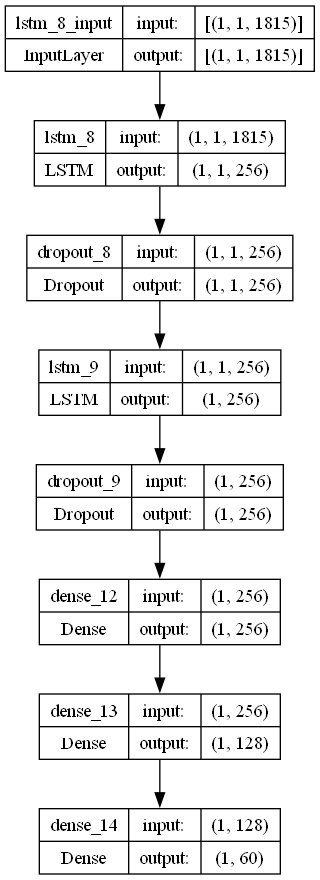

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.05240465728663423
    optimizer = Adam(learning_rate = lr)
    activation_function = 'relu'
    lstm_units = 256
    dropout_rate = 0.45234894910170736

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)